# Translational mapping

In this notebook we explicitely model the link between the regulatory and structural embeddings of the U2OS cells and evaluate their generalizability.

---


## 0. Enviromental setup

We first load the required packages and define a number of helper functions.

In [85]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import torch
from torch import nn
from torch.optim import Adam
import sys
from tqdm.notebook import tqdm
from yellowbrick.cluster.elbow import kelbow_visualizer
from yellowbrick.cluster import KElbowVisualizer
from torch.utils.data import DataLoader
import matplotlib as mpl

sys.path.append("../../..")

from src.utils.notebooks.translation.analysis import *
from src.data.datasets import IndexedTensorDataset
from src.utils.basic.io import get_genesets_from_gmt_file


seed = 1234

device = "cuda:0"

%load_ext nb_black

The nb_black extension is already loaded. To reload it, use:
  %reload_ext nb_black


<IPython.core.display.Javascript object>

In [86]:
def get_struct_nn_mean_translation_dict(img_embs, node_embs):
    nn_pred_dict = {}
    struct_nn = NearestNeighbors(n_neighbors=2)
    struct_samples = np.array(list(img_embs.index))
    struct_nn.fit(np.array(img_embs))

    reg_nn = NearestNeighbors(n_neighbors=len(node_embs))
    reg_samples = np.array(list(node_embs.index))
    reg_nn.fit(np.array(node_embs))

    for target in struct_samples:
        struct_pred_input = np.array(img_embs.loc[target]).reshape(1, -1)
        struct_1nn = struct_samples[
            struct_nn.kneighbors(struct_pred_input, return_distance=False)[0]
        ]
        reg_pred_input = np.array(node_embs.loc[struct_1nn[1]]).reshape(1, -1)
        reg_nns = reg_samples[
            reg_nn.kneighbors(reg_pred_input, return_distance=False)[0]
        ]
        nn_pred_dict[target] = reg_nns
    return nn_pred_dict

<IPython.core.display.Javascript object>

In [87]:
def get_topk_acc_from_nn_dict(nn_dict, ks=[1, 3, 5, 10, 20, 50]):
    idc = []
    topk_dict = {}
    for target, nns in nn_dict.items():
        idc.append(target)
        for k in ks:
            if "top-{}".format(k) not in topk_dict:
                topk_dict["top-{}".format(k)] = []
            topk_dict["top-{}".format(k)].append(int(target in list(nns)[:k]))
    topk_result = pd.DataFrame(topk_dict, index=idc)
    return topk_result

<IPython.core.display.Javascript object>

In [88]:
def get_knn_hit_data(nn_dict):
    idc = []
    hits = []
    for k, v in nn_dict.items():
        idc.append(k)
        hits.append(np.where(v == k)[0])
    hit_results = pd.DataFrame(np.array(hits), columns=["knn_hit"], index=idc)
    return hit_results

<IPython.core.display.Javascript object>

In [89]:
def get_struct_nn_centroid_translation_dict(img_embs, node_embs):
    nn_pred_dict = {}
    struct_nn = NearestNeighbors(n_neighbors=2)
    struct_samples = list(img_embs.index)
    struct_samples = np.array([cl_label.split("_")[0] for cl_label in struct_samples])

    reg_nn = NearestNeighbors(n_neighbors=len(node_embs))
    reg_samples = np.array(list(node_embs.index))
    reg_nn.fit(np.array(node_embs))

    for target in np.unique(struct_samples):
        struct_nn.fit(np.array(img_embs.loc[struct_samples != target]))
        struct_pred_input = np.array(img_embs.loc[struct_samples == target])
        struct_1nn = struct_samples[
            struct_nn.kneighbors(struct_pred_input, return_distance=False)[:, 1]
        ]
        reg_pred_input = np.array(node_embs.loc[struct_1nn]).mean(axis=0).reshape(1, -1)
        reg_nns = reg_samples[reg_nn.kneighbors(reg_pred_input, return_distance=False)][
            0
        ]
        nn_pred_dict[target] = reg_nns
    return nn_pred_dict

<IPython.core.display.Javascript object>

---

## 1. Read in data

Next, we read in the different data sets that we will use for the modelling and evaluation of the translational mappings. The first data set includes the regulatory embeddings of the 244 genes that are part of the inferred interactome.

In [90]:
node_embs = pd.read_csv(
    "../../../data/ppi/embedding/node_embeddings_cv_1024_2gexrecon_1graphrecon_mask_loss_newnodeset.csv",
    index_col=0,
)
# node_embs = pd.DataFrame(
#     MinMaxScaler().fit_transform(node_embs),
#     columns=node_embs.columns,
#     index=node_embs.index,
# )
node_embs.head()

,0,1,2,3,4,5,6,7,8,9,...,1014,1015,1016,1017,1018,1019,1020,1021,1022,1023
PTN,-0.050479,0.054797,-0.015378,-0.015343,-0.008623,0.000151,-0.035899,0.011545,0.030637,-0.013076,...,0.004624,-0.046947,-0.070591,-0.040428,0.018375,-0.107694,-0.038917,0.049235,-0.039051,0.050241
KLK6,-0.023457,0.001821,0.007106,-0.036119,-0.021491,-0.051559,0.067674,0.022940,-0.053504,0.072685,...,0.017700,-0.109262,0.031683,0.002146,-0.034882,-0.022786,0.033981,-0.004519,-0.008651,0.037519
AURKB,0.015745,-0.076722,0.021819,-0.055831,0.079664,-0.001736,0.016053,-0.118869,0.010838,-0.104266,...,0.027252,0.100420,-0.072616,0.029620,0.004772,0.022450,0.012306,-0.060133,-0.000407,-0.122674
TRAF2,0.051286,-0.212608,-0.030670,0.041259,0.052205,0.084639,-0.105833,-0.017255,0.034831,-0.138295,...,-0.026359,-0.000625,-0.022953,0.123224,-0.040207,0.059544,-0.010211,-0.027338,-0.083649,0.022465
TNNC1,0.038636,-0.004121,-0.046151,-0.006015,0.027739,-0.006754,-0.003629,-0.014672,-0.030954,0.033080,...,0.016145,0.009754,0.000561,0.015493,0.010287,0.009452,0.006919,0.015925,-0.007209,0.009354


<IPython.core.display.Javascript object>

After having loaded the regulatory embeddings, we will now load the structural embeddings defined by the embeddings of the images held-out during the different folds of the cross-validation. In particular we load a version, where in addition to the structural embeddings the corresponding gene labels are given indicating the respective experimental condition the encoded cell images come from as well as a cluster label. The latter was obtained by clustering the structural embeddings for each held-out fold individually using 4-means clustering on euclidean distances to capture the frequently observed multimodal distribution of the cell states in the different overexpression settings.

In [91]:
img_embs = pd.read_hdf(
    "../../../data/experiments/image_embeddings/specificity_target_emb_cv_strat/final_1024/all_test_latents_k3.h5"
)

<IPython.core.display.Javascript object>

Finally, we also load a number of pathway database information that we will use later for validation.

In [92]:
kegg_gs_dict = get_genesets_from_gmt_file(
    "../../../data/other/genesets/c2.cp.kegg.v7.5.1.symbols.gmt"
)
pid_gs_dict = get_genesets_from_gmt_file(
    "../../../data/other/genesets/c2.cp.pid.v7.5.1.symbols.gmt"
)
wiki_gs_dict = get_genesets_from_gmt_file(
    "../../../data/other/genesets/c2.cp.wikipathways.v7.5.1.symbols.gmt"
)
bc_gs_dict = get_genesets_from_gmt_file(
    "../../../data/other/genesets/c2.cp.biocarta.v7.5.1.symbols.gmt"
)
h_gs_dict = get_genesets_from_gmt_file(
    "../../../data/other/genesets/h.all.v7.4.symbols.gmt"
)

<IPython.core.display.Javascript object>

We aim to establish the translational mapping on three different levels defining the level of pooling in the structural space. First, we describe the structural embedding for given overexpression condition the mean of the embeddings for all cells from the corresponding condition. Second, each overexpression condition is described in the structural space by the means of the four different clusters identified using 4-means. This aims to better capture the multimodal cell state distribution induced by the overexpression settings. Finally, we compare the previous two approaches to the setting where we do not pool cells but describe each overexpression by the overall distribution of all structural embeddings of cells from the corresponding condition. All three approaches have certain advantages and disadvantages. To this end, assume a condition that gives rise to highly variable cell state population that spans the large parts of structural space as e.g. seen for the BRAF overexpression condition. An inferred map would thus map from large parts of the structural space to the corresponding regulatory embedding of BRAF. Such a mapping would be unspecific, prone to noise and subject to high variance which is unlikely to capture the causal links between the two spaces. To obtain more specific embeddings which is less affected by the noise in the single-cell embeddings, we propose to pool those and represent the structural phenotype of cells in the different conditions by the mean of the structural embeddings of the corresponding cells or the means of the four identified clusters. Note that this however, will drastically reduce the sample size that is available to infer the translational map. The effects of those different characteristics will described in the corresponding sections.

In [93]:
img_node_embs_dict = {}
shared_targets = set(node_embs.index).intersection(np.unique(img_embs.labels))
for i in range(4):
    filtered_img_embs = img_embs.loc[img_embs.fold == "fold_{}".format(i)]
    filtered_img_embs = filtered_img_embs.loc[
        filtered_img_embs.labels.isin(shared_targets)
    ]
    filtered_node_embs = node_embs.loc[filtered_img_embs.labels]
    labels = np.array(filtered_img_embs.labels)
    filtered_img_embs = filtered_img_embs._get_numeric_data()
    img_node_embs_dict["fold{}".format(i)] = (
        filtered_img_embs,
        filtered_node_embs,
        labels,
    )

<IPython.core.display.Javascript object>

In [94]:
cl_img_node_embs_dict = {}
shared_targets = set(node_embs.index).intersection(np.unique(img_embs.labels))
for i in range(4):
    filtered_img_embs = img_embs.loc[img_embs.fold == "fold_{}".format(i)]
    mean_img_embs = filtered_img_embs.groupby("cluster").median()
    labels = []
    for idx in list(mean_img_embs.index):
        labels.append(idx.split("_")[0])
    mean_img_embs["labels"] = np.array(labels)
    filtered_img_embs = mean_img_embs.loc[mean_img_embs.labels.isin(shared_targets)]
    filtered_node_embs = node_embs.loc[filtered_img_embs.labels]
    labels = filtered_img_embs.iloc[:, -1]
    filtered_img_embs = filtered_img_embs.iloc[:, :-1]
    cl_img_node_embs_dict["fold{}".format(i)] = (
        filtered_img_embs,
        filtered_node_embs,
        np.array(labels),
    )

<IPython.core.display.Javascript object>

In [95]:
mean_img_node_embs_dict = {}
shared_targets = set(node_embs.index).intersection(np.unique(img_embs.labels))
for i in range(4):
    filtered_img_embs = img_embs.loc[img_embs.fold == "fold_{}".format(i)]
    mean_img_embs = filtered_img_embs.groupby("labels").mean()
    mean_img_embs["labels"] = np.array(mean_img_embs.index)
    filtered_img_embs = mean_img_embs.loc[mean_img_embs.labels.isin(shared_targets)]
    filtered_node_embs = node_embs.loc[filtered_img_embs.labels]
    filtered_img_embs = filtered_img_embs.iloc[:, :-1]
    mean_img_node_embs_dict["fold{}".format(i)] = filtered_img_embs, filtered_node_embs

<IPython.core.display.Javascript object>

---

---

## 2. Translational analyses


We will now built translational maps in order to show that we can add additional value by translating to the regulatory space. To this end, we will compare the performance of different model and prediction approaches:

1. As a baseline we will consider the inference purely based on the structural space. To this end, we compute the nearest neighbor for each target in the structural space and evaluate its local neighborhood in the regulatory space.
2. A simple linear and non-linear model will be fit using the corresponding structural and regulatory embeddings.

We use both the population means as well as the cluster centroid data to establish the mapping. In the later case the prediction is given by the mean embedding of the translated regulatory embeddings.

All models are assessed using the top-k accuracy metric in a leave-one-condition out scheme.

---

### 2.1. Structural NN mean translation

As discussed earlier we will start by identifying the nearest neighbor for each of the 39 target genes covered in both the regulatory and structural space. We then look at the neighborhood of the corresponding gene in the regulatory space and assess the top-k accuracy of the prediction.

In [96]:
img_embs_fold0, node_embs_fold0 = mean_img_node_embs_dict["fold0"]

<IPython.core.display.Javascript object>

In [97]:
struct_nn_mean_pred_dict = get_struct_nn_mean_translation_dict(
    img_embs_fold0, node_embs
)

<IPython.core.display.Javascript object>

In [142]:
struct_nn_mean_pred_dict["MYD88"][:50]

array(['RHOA', 'BCR', 'LGALS1', 'HRAS', 'AKT1S1', 'PIK3R2', 'CDK14',
       'PDGFRB', 'HSPA1B', 'PAK2', 'AXL', 'S100A2', 'MAGEA1', 'FKBP4',
       'LDOC1', 'BRAF', 'PRAME', 'MAP3K9', 'THRA', 'MAGED1', 'MAPK7',
       'MYL2', 'CDC42', 'CDC42EP1', 'KRT8', 'ELK1', 'MAP3K2', 'NEFL',
       'NCAM1', 'MDC1', 'HSPB1', 'SREBF1', 'EPB41L3', 'RELB', 'MAP3K5',
       'NDN', 'TSC2', 'DSP', 'RPS6KB1', 'KRT18', 'MYH9', 'CLU', 'MYL9',
       'ARMCX2', 'TUBB2B', 'NCOR2', 'S100A14', 'MAPK8', 'TNNT1', 'TUBB6'],
      dtype='<U8')

<IPython.core.display.Javascript object>

In [99]:
struct_nn_mean_topk = get_topk_acc_from_nn_dict(struct_nn_mean_pred_dict)
struct_nn_mean_topk.describe()

,top-1,top-3,top-5,top-10,top-20,top-50
count,39.0,39.000000,39.000000,39.000000,39.000000,39.000000
mean,0.0,0.051282,0.076923,0.128205,0.256410,0.589744
std,0.0,0.223456,0.269953,0.338688,0.442359,0.498310
min,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.0,0.000000,0.000000,0.000000,0.000000,1.000000
75%,0.0,0.000000,0.000000,0.000000,0.500000,1.000000
max,0.0,1.000000,1.000000,1.000000,1.000000,1.000000


<IPython.core.display.Javascript object>

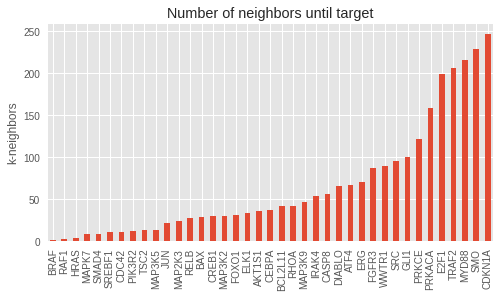

<IPython.core.display.Javascript object>

In [100]:
mpl.style.use("ggplot")
struct_nn_mean_khits = get_knn_hit_data(struct_nn_mean_pred_dict)
ax = struct_nn_mean_khits.knn_hit.sort_values().plot(kind="bar", figsize=[8, 4])
ax.set_ylabel("k-neighbors")
ax.set_title("Number of neighbors until target")
plt.show()

---

### 2.2. Linear mean translation

As a second setup, we will train a linear model in a leave-one-target out setting for 1000 epochs.

In [101]:
nn = NearestNeighbors(n_neighbors=len(node_embs)).fit(np.array(node_embs))
nn_clf = CustomKNNClassifier(
    clf=nn, samples=np.array(list(node_embs.index)), ks=[1, 3, 5, 10, 20, 50]
)

<IPython.core.display.Javascript object>

---

In [102]:
data_dicts = get_logo_data_dicts(
    data=img_embs_fold0,
    labels=node_embs_fold0,
    val_size=0,
    group_labels=np.array(list(node_embs_fold0.index)),
    batch_size=32,
    balanced=False,
    scale_x=False,
    scale_y=False,
)

<IPython.core.display.Javascript object>

  0%|          | 0/39 [00:00<?, ?it/s]

AKT1S1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 7.086053129138523e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0016147634014487267
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


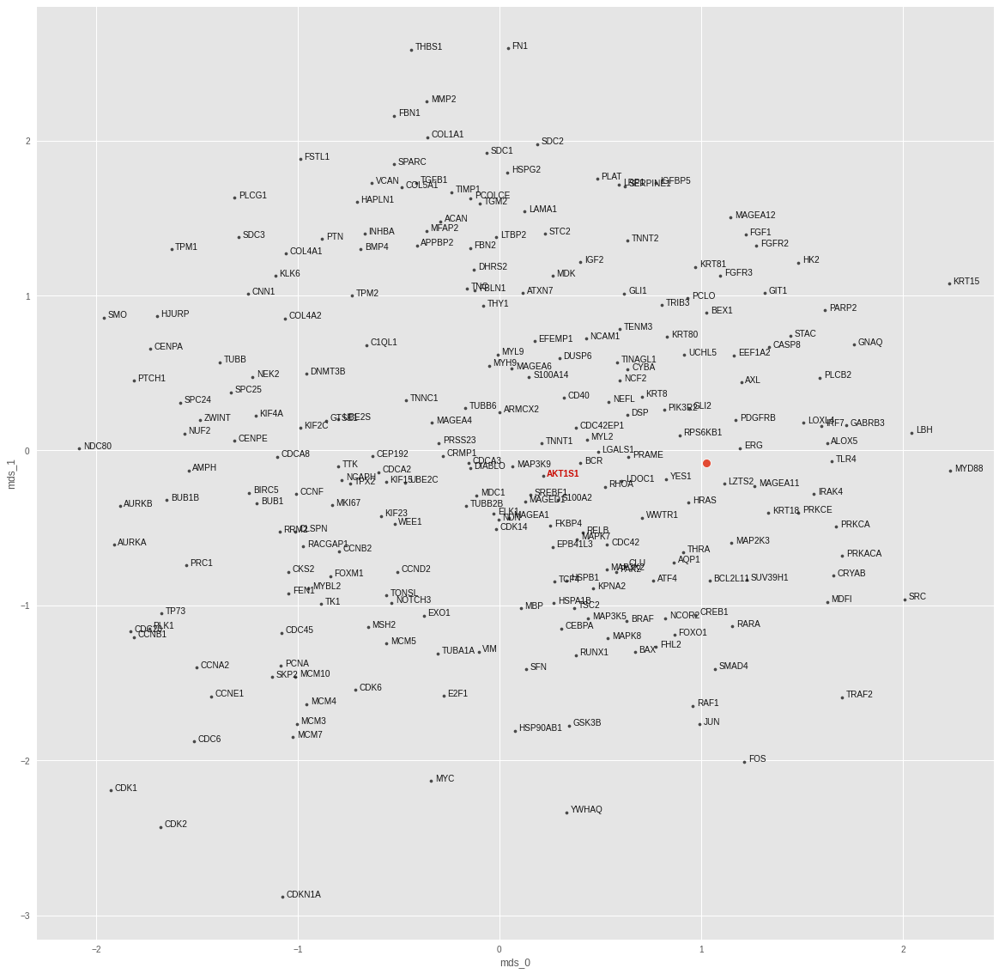

ATF4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 7.67398592678977e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0013633363414555788
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


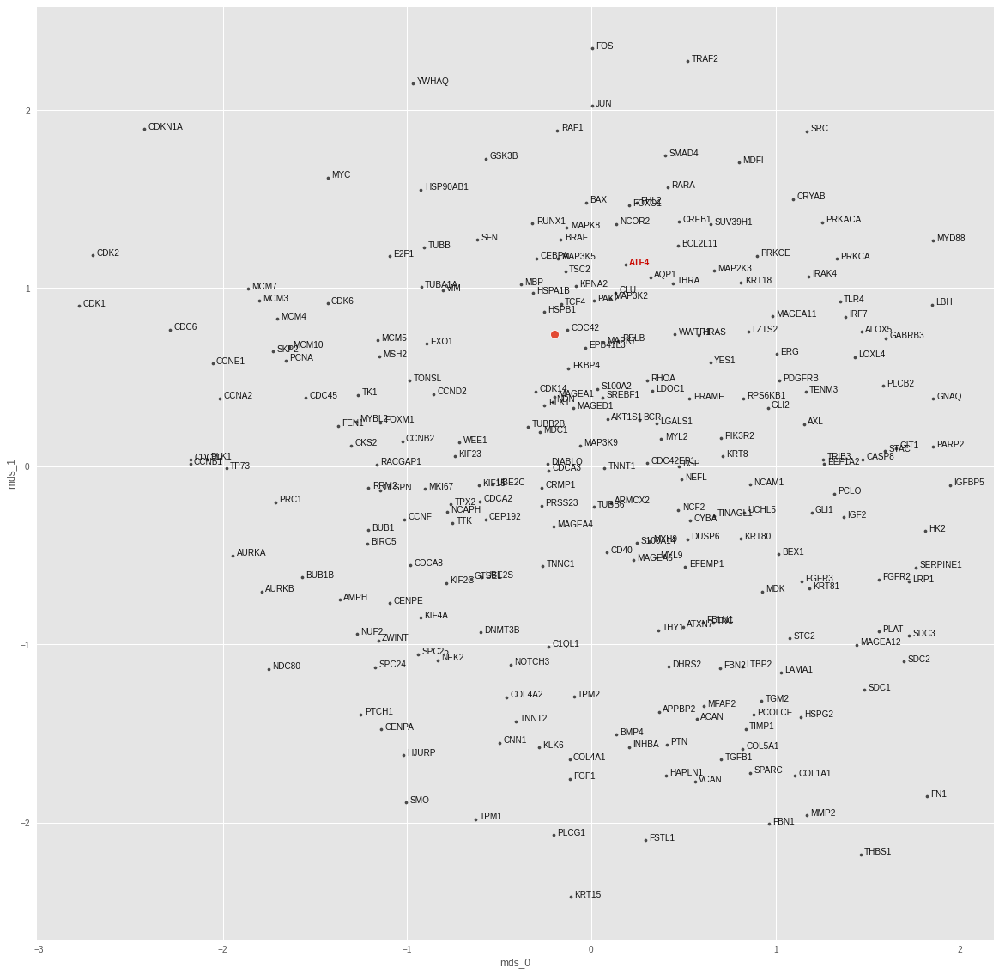

BAX
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 4.462700656547799e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0038100227247923613
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


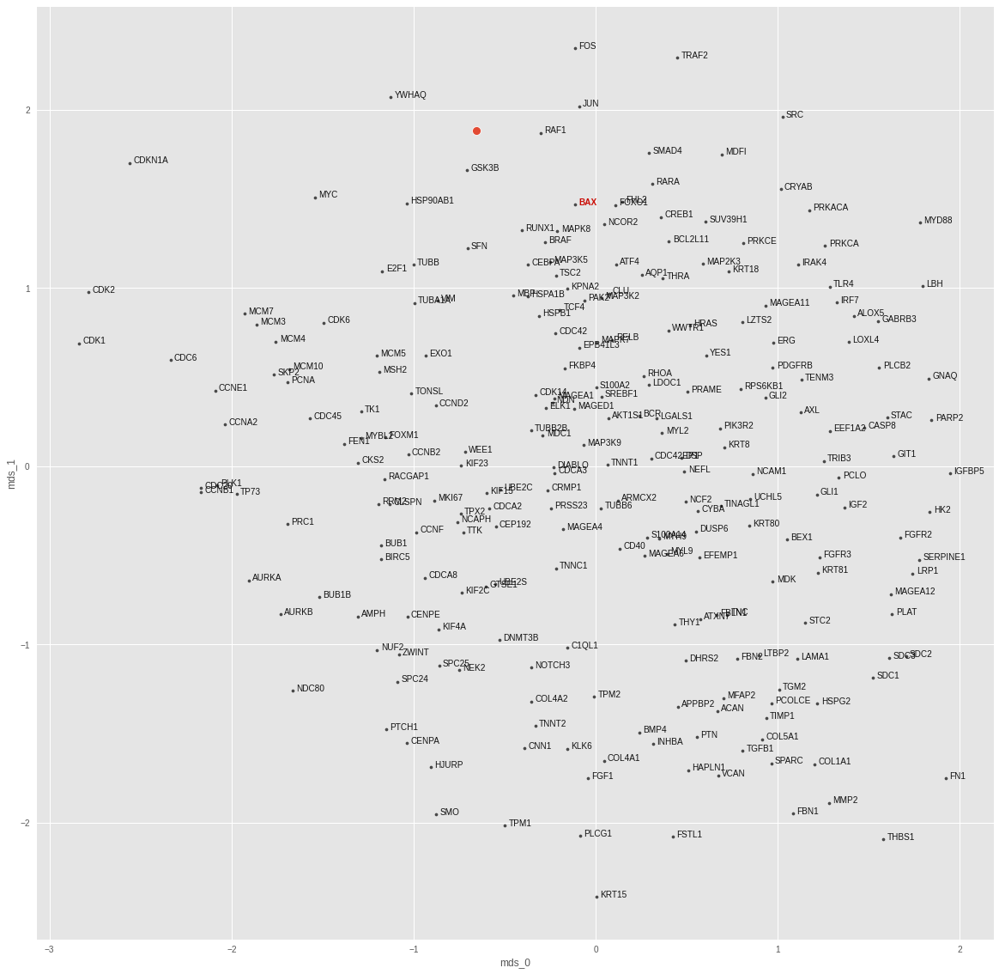

BCL2L11
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 7.025299189416201e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.005282914731651545
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


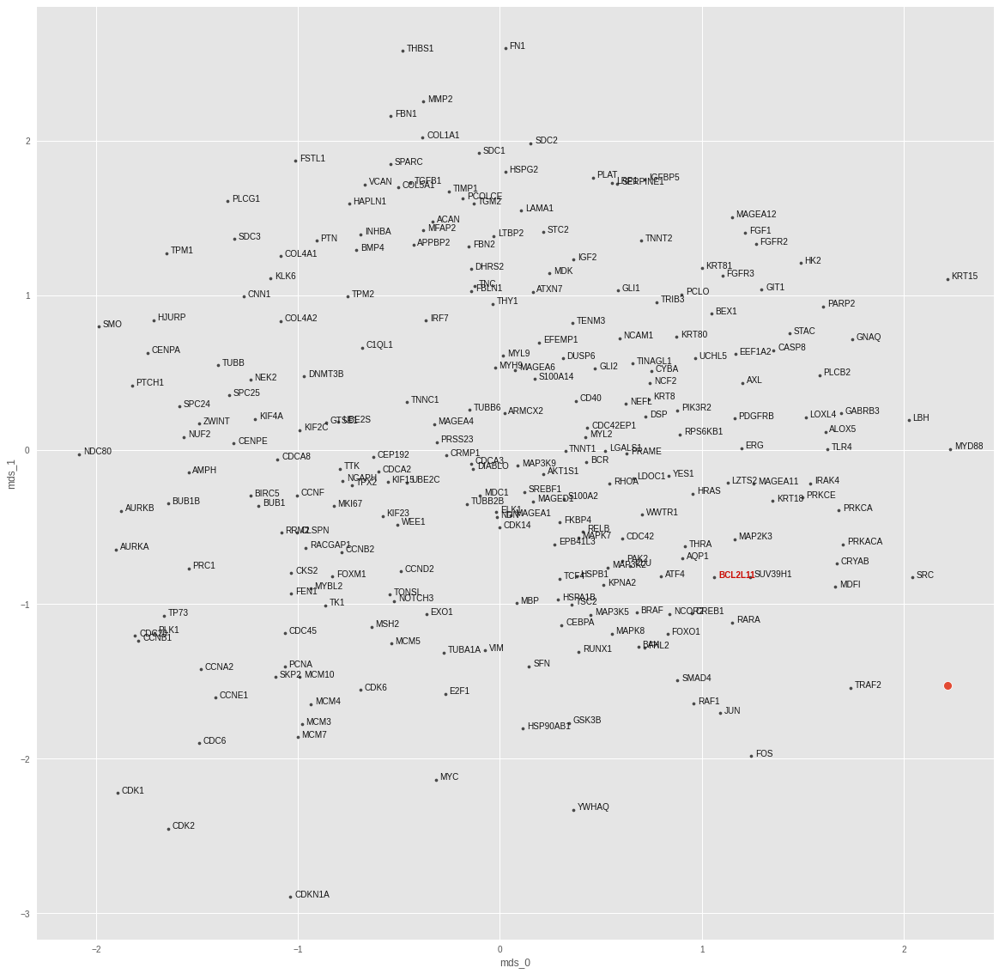

BRAF
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 5.442200161173547e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0014187645865604281
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


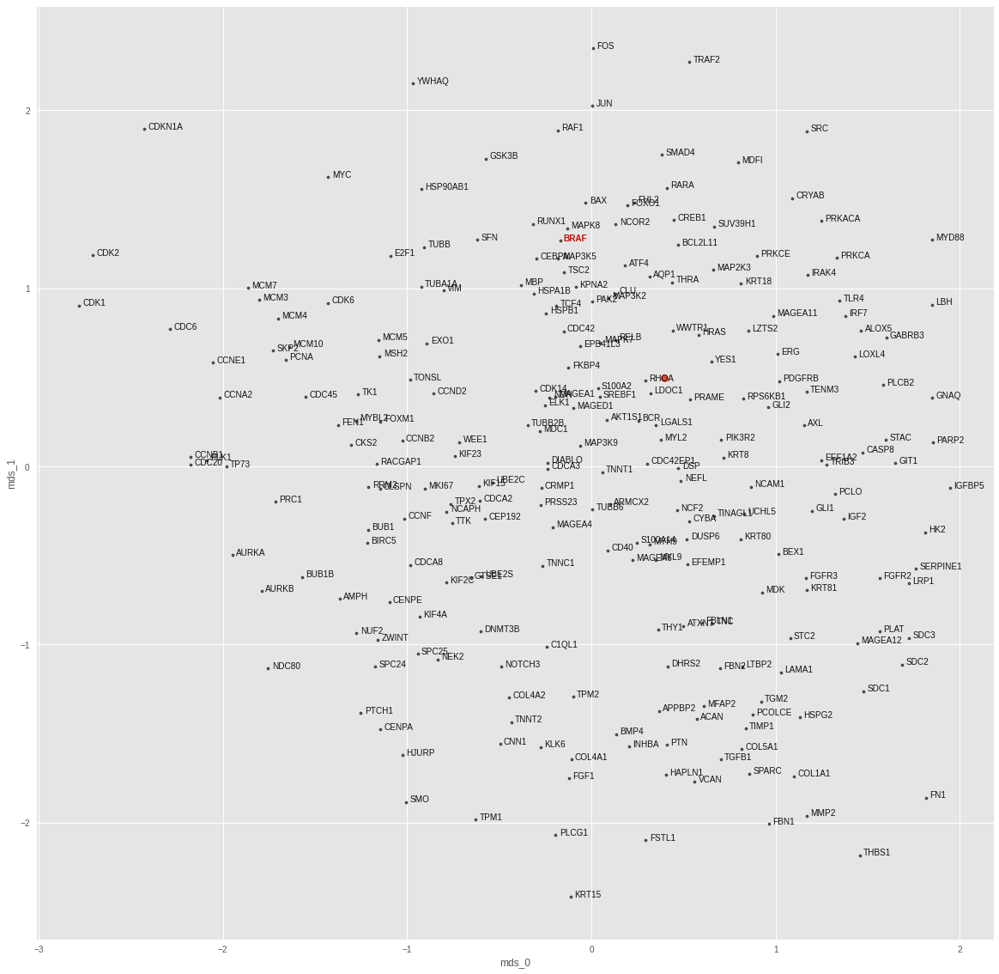

CASP8
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00013315572026553318
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.012393366545438766
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


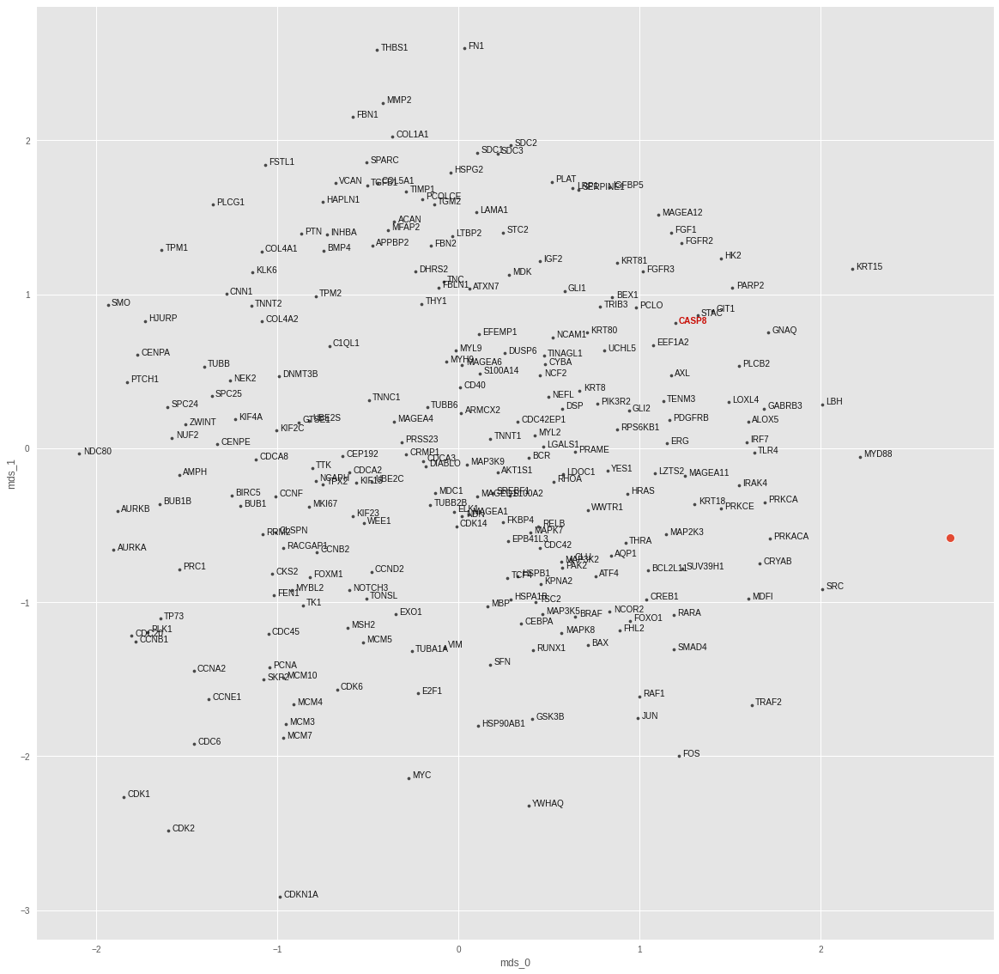

CDC42
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 5.2769591045369835e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.006017003208398819
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


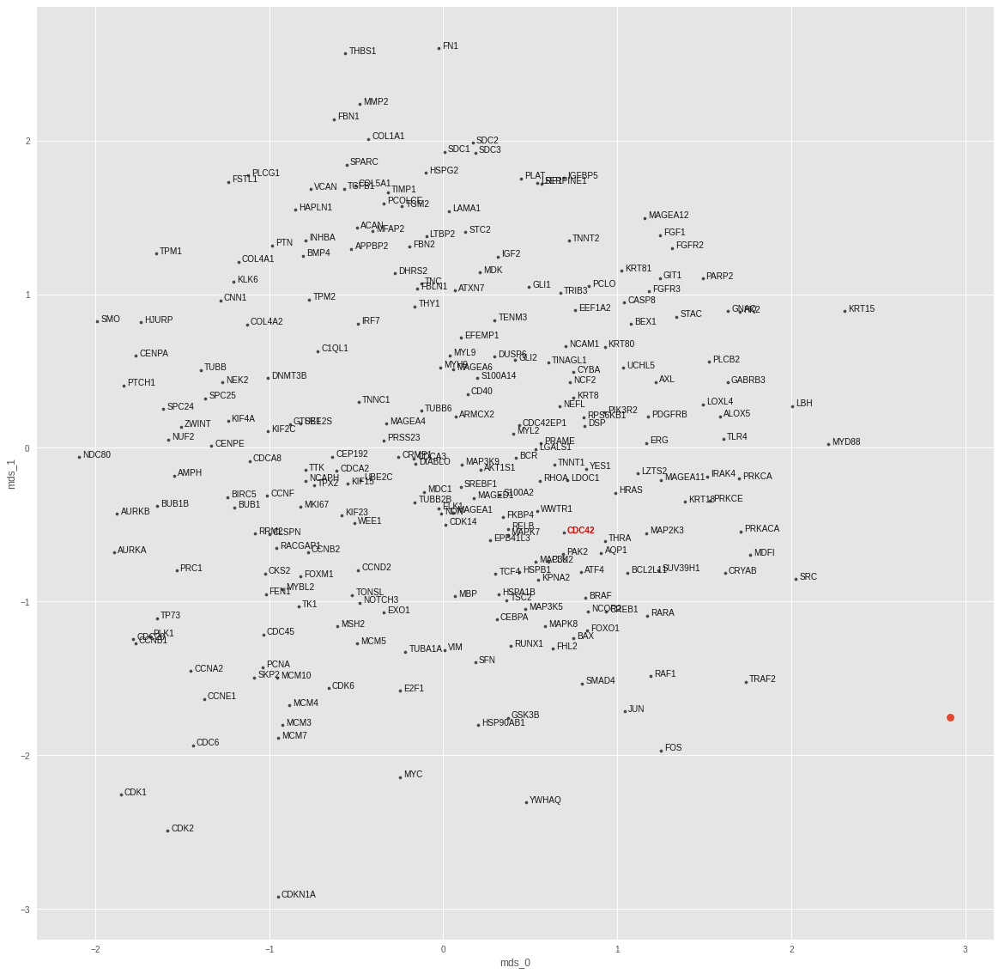

CDKN1A
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 5.678751518931485e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0211171917617321
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


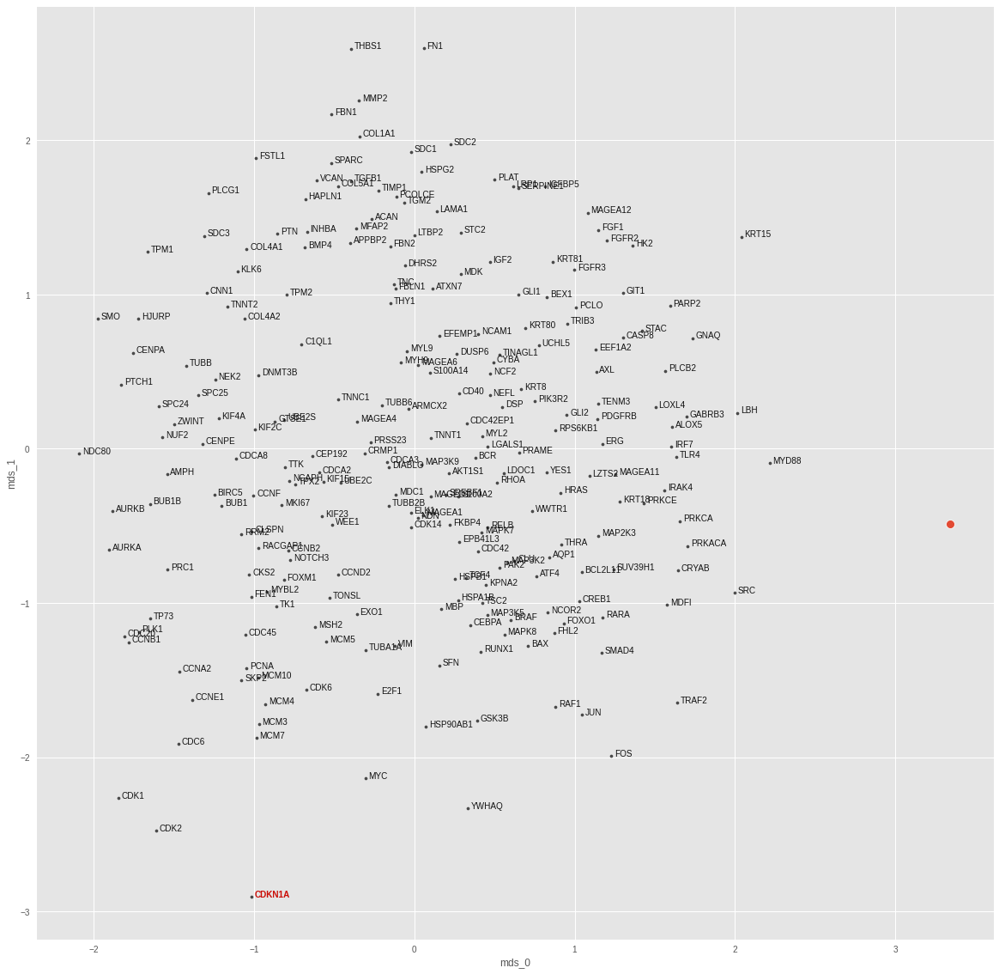

CEBPA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 6.619954231274805e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004120353143662214
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


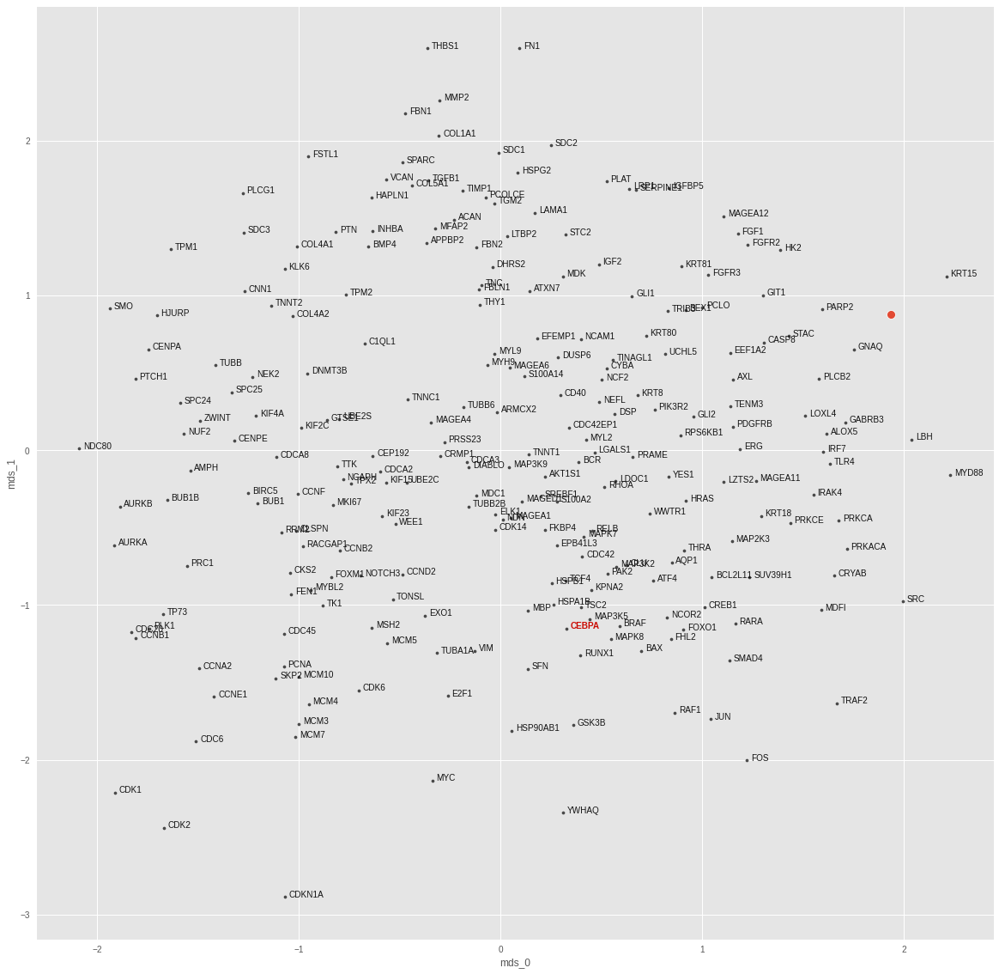

CREB1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 7.41544172342401e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0037309948820620775
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


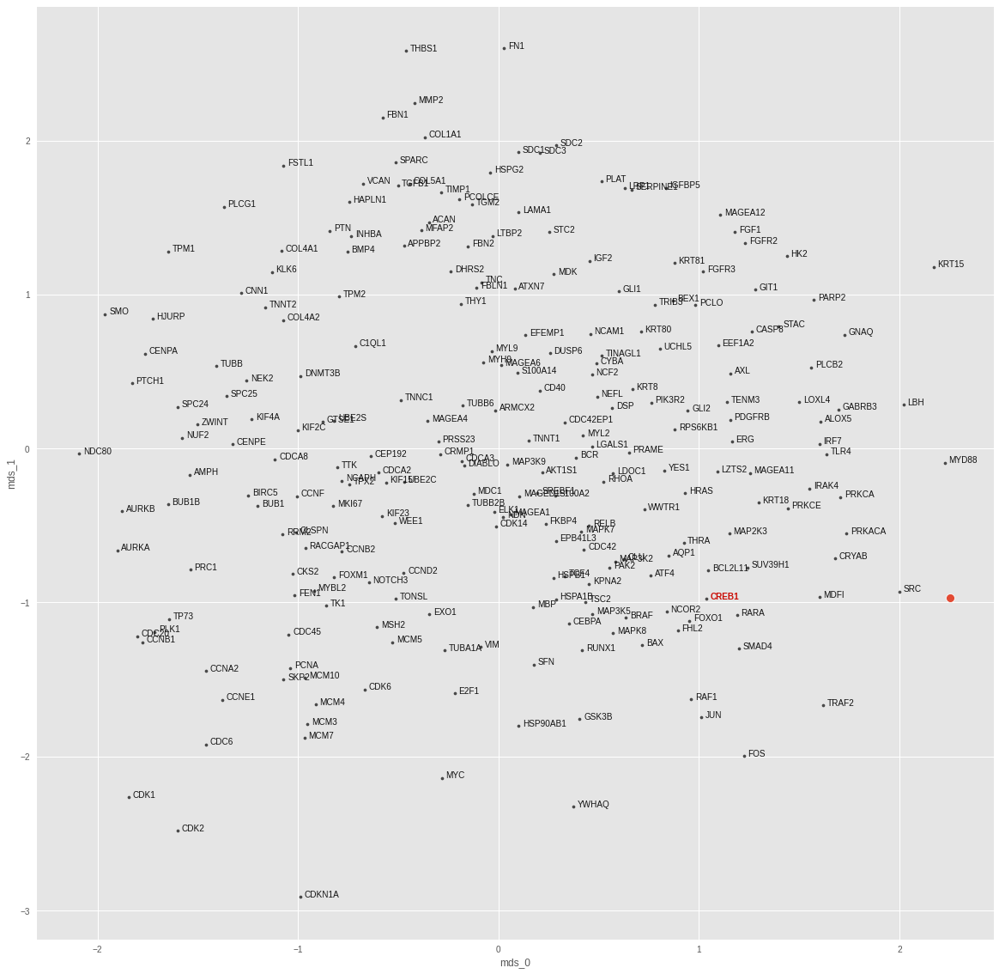

DIABLO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 6.55053395588e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.003834315575659275
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


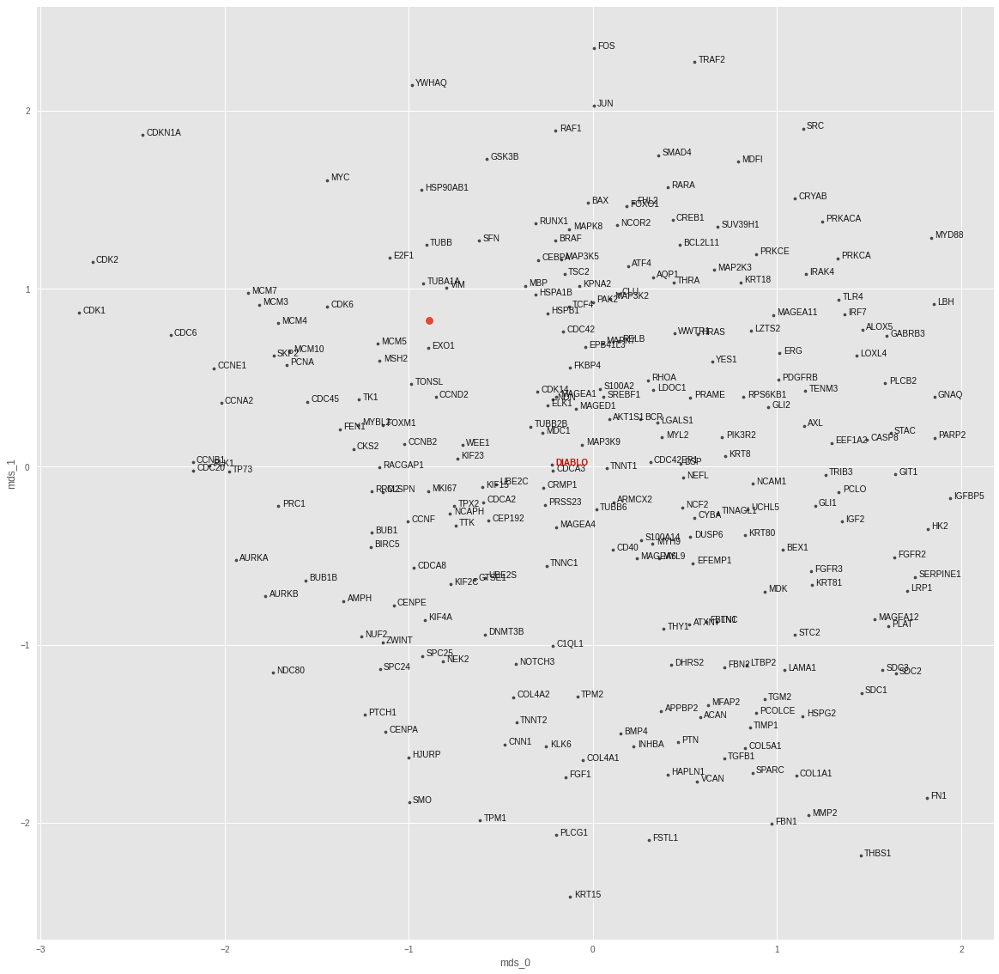

E2F1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 6.994605849429622e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.011300122365355492
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


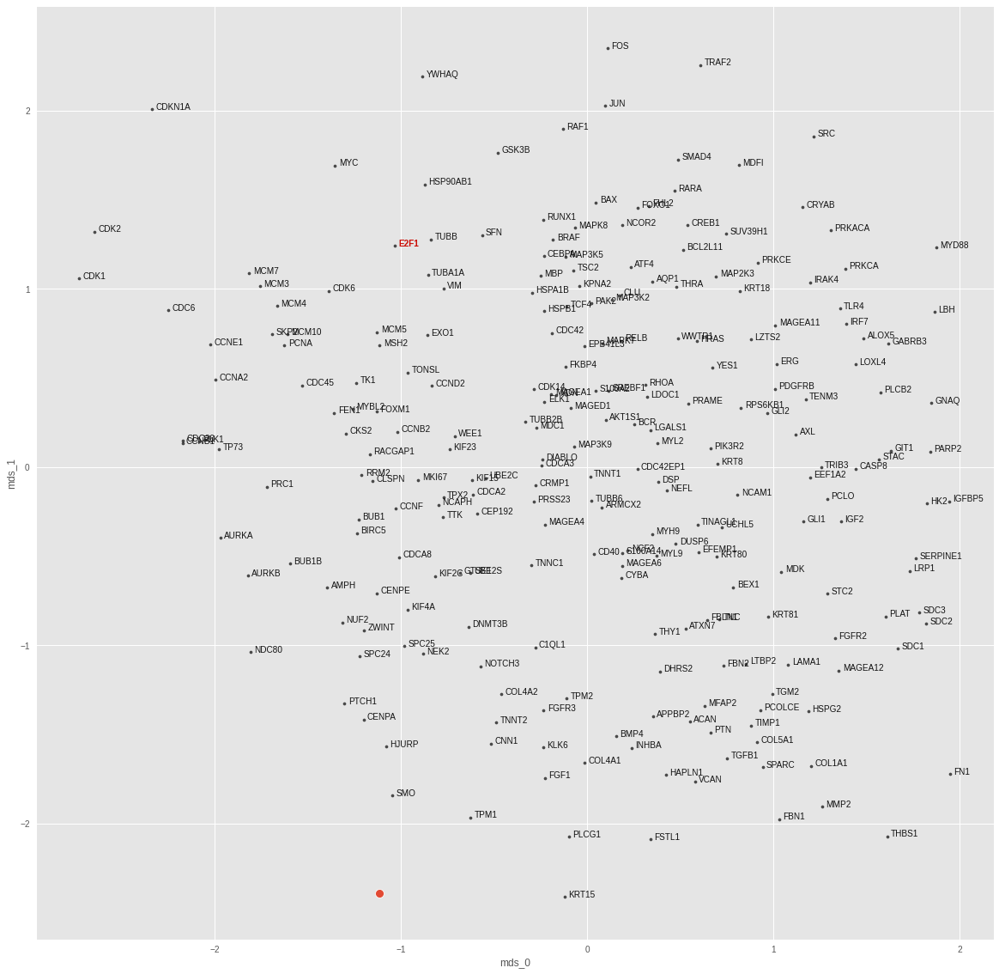

ELK1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 7.044600926364135e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004629735369235277
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


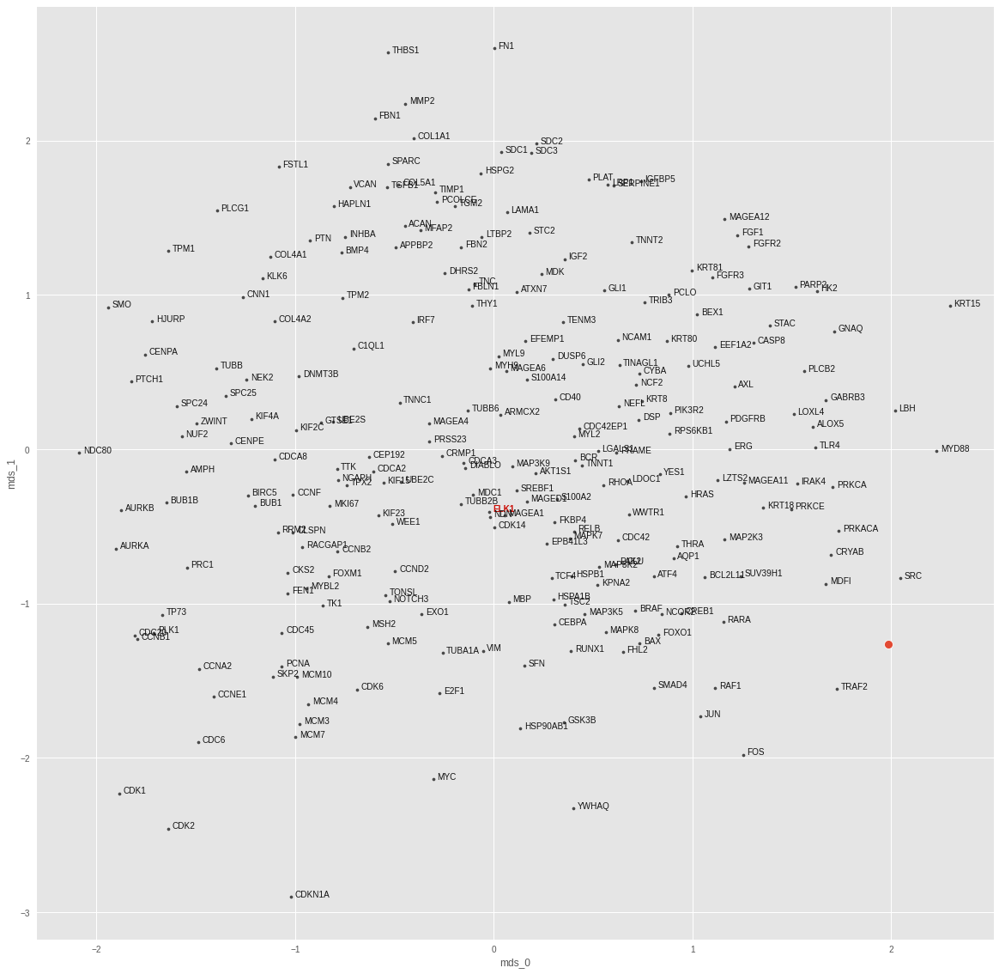

ERG
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 6.0369637810110456e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004916372708976269
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


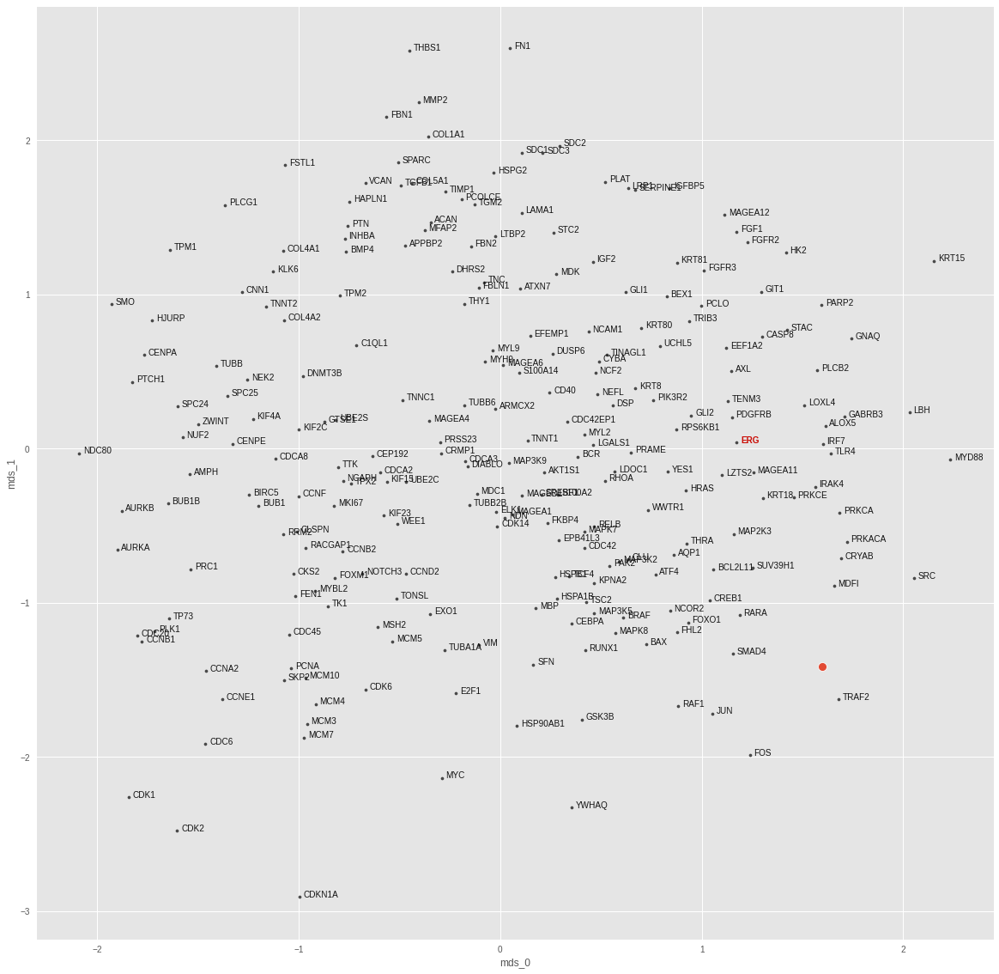

FGFR3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 6.6930177701196e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.002529092598706484
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


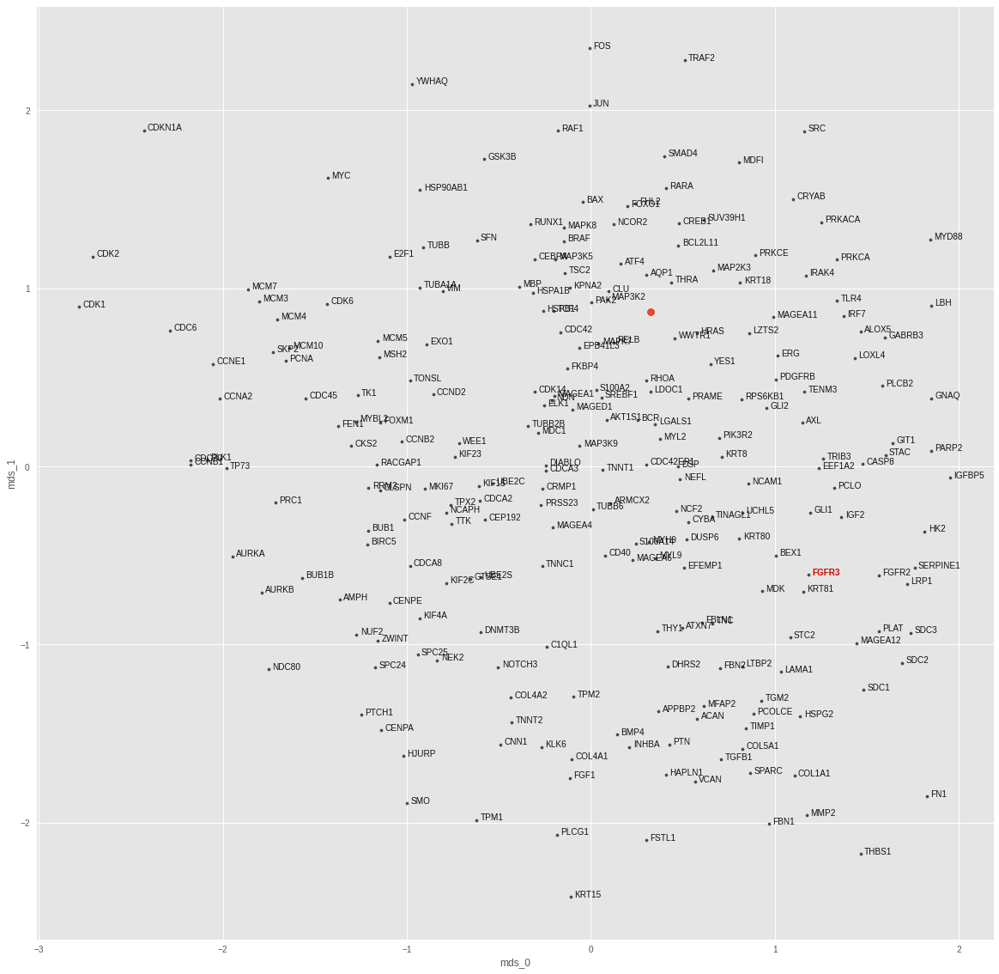

FOXO1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 7.988674291195103e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0025112356524914503
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


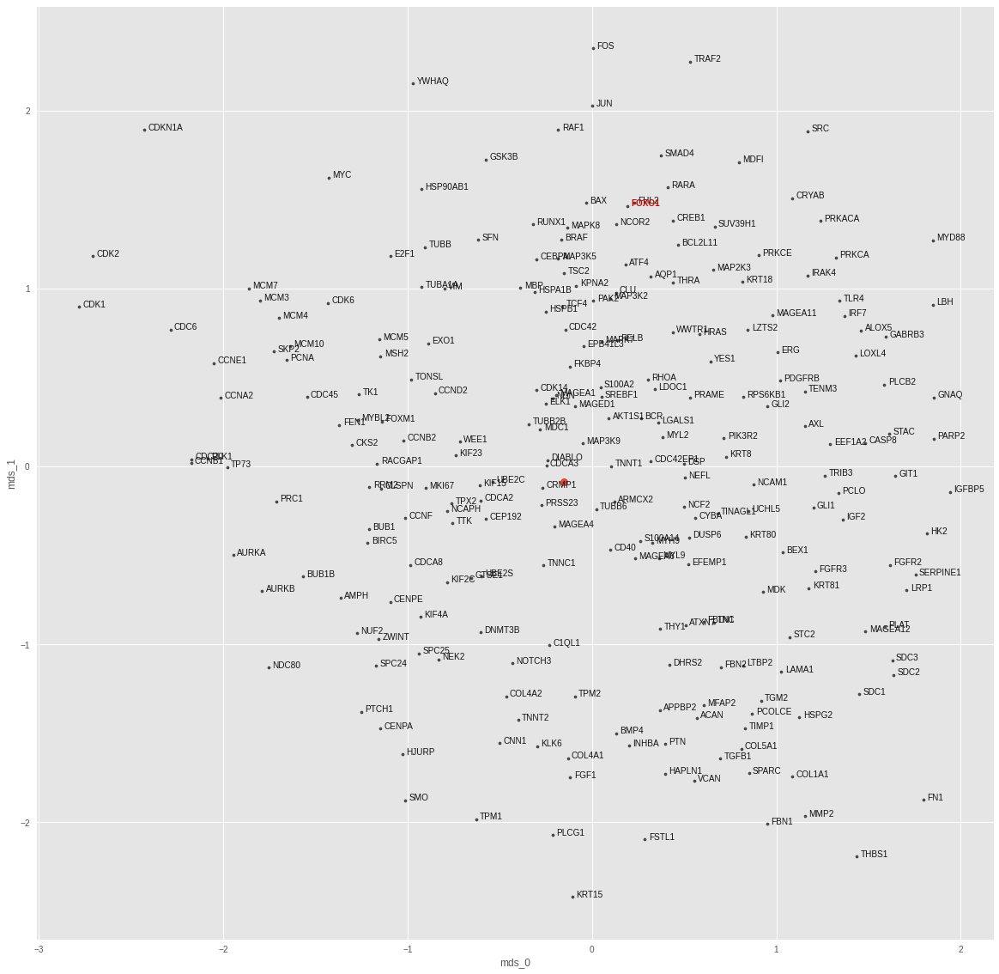

GLI1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 6.44676735024213e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0031001712195575237
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


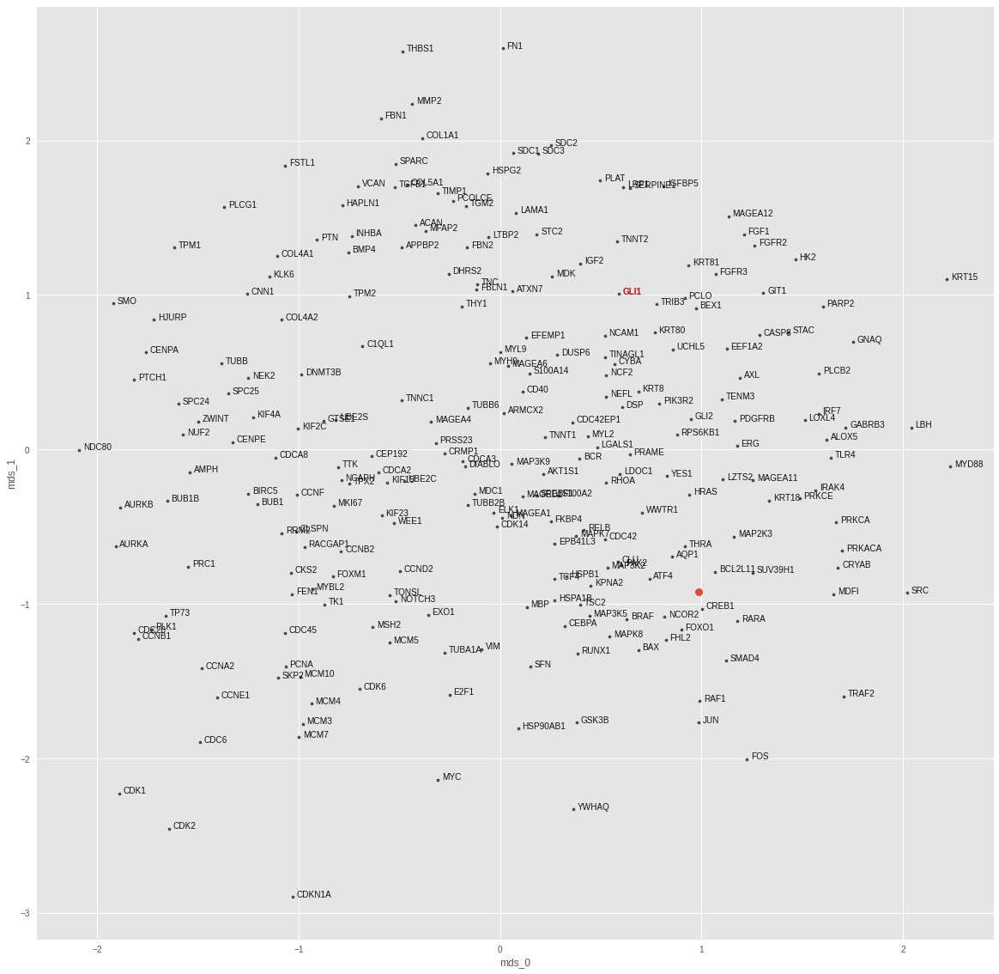

HRAS
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 6.924783768849203e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.010733780451118946
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


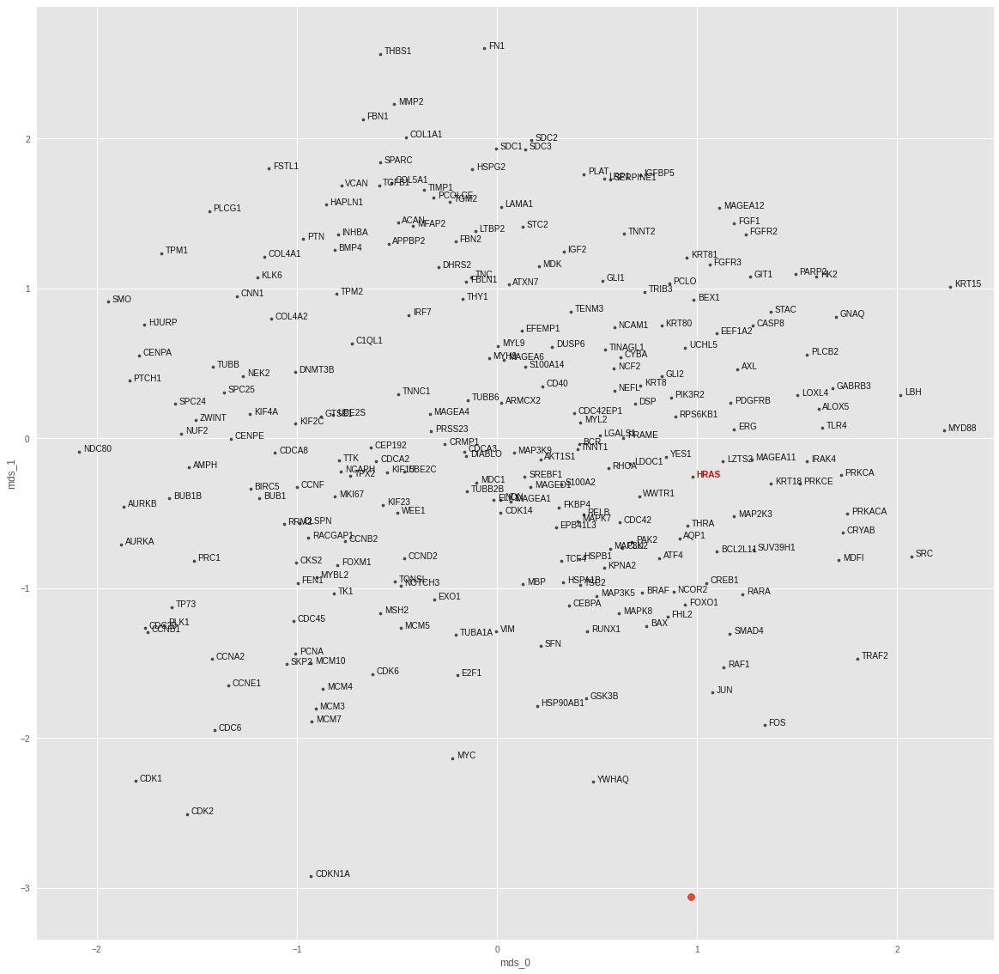

IRAK4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 9.056082528427636e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0021758265793323517
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


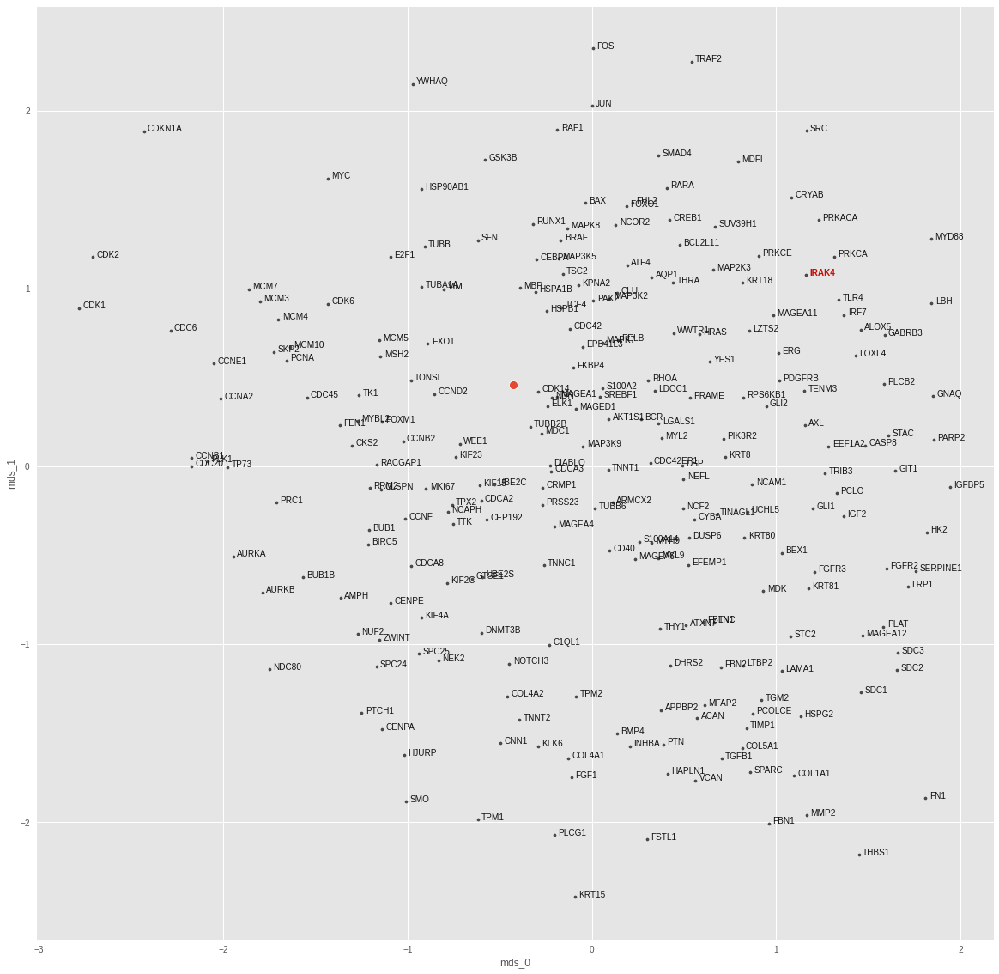

JUN
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 6.122794844773843e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.016337662935256958
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


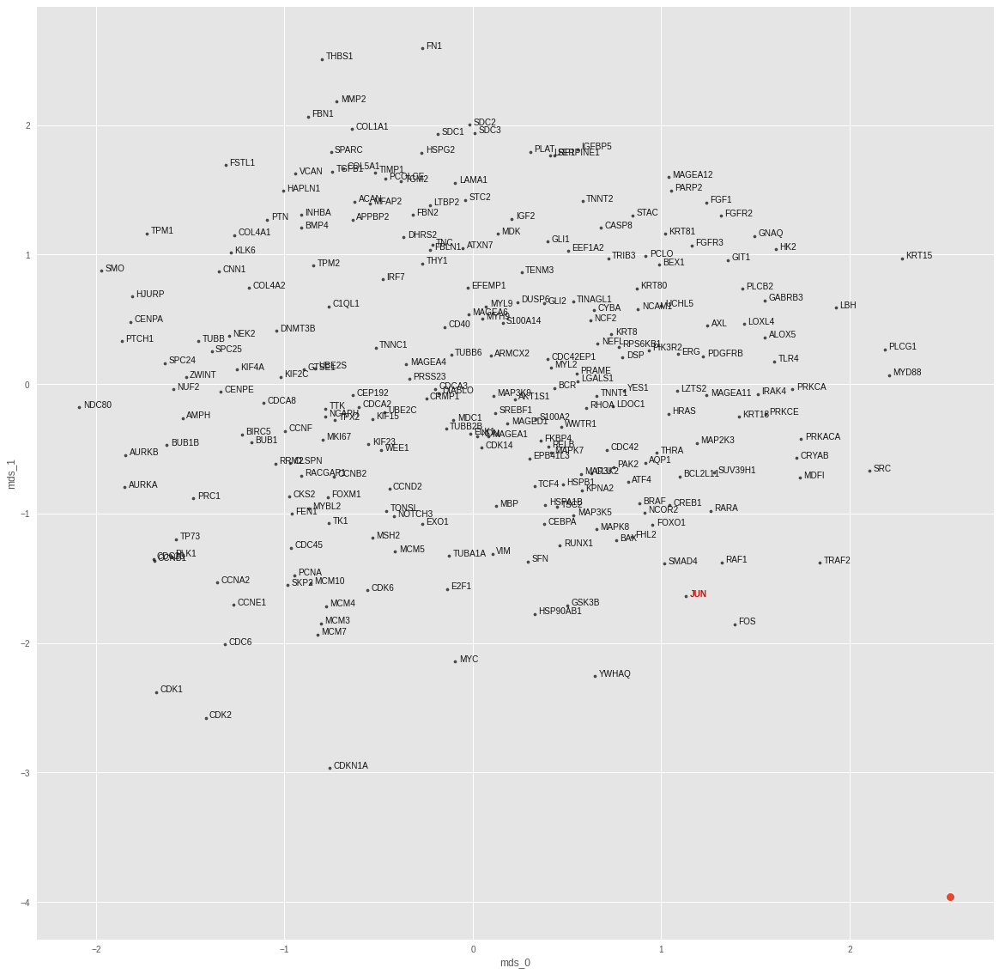

MAP2K3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 6.400059474368678e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.00863527599722147
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


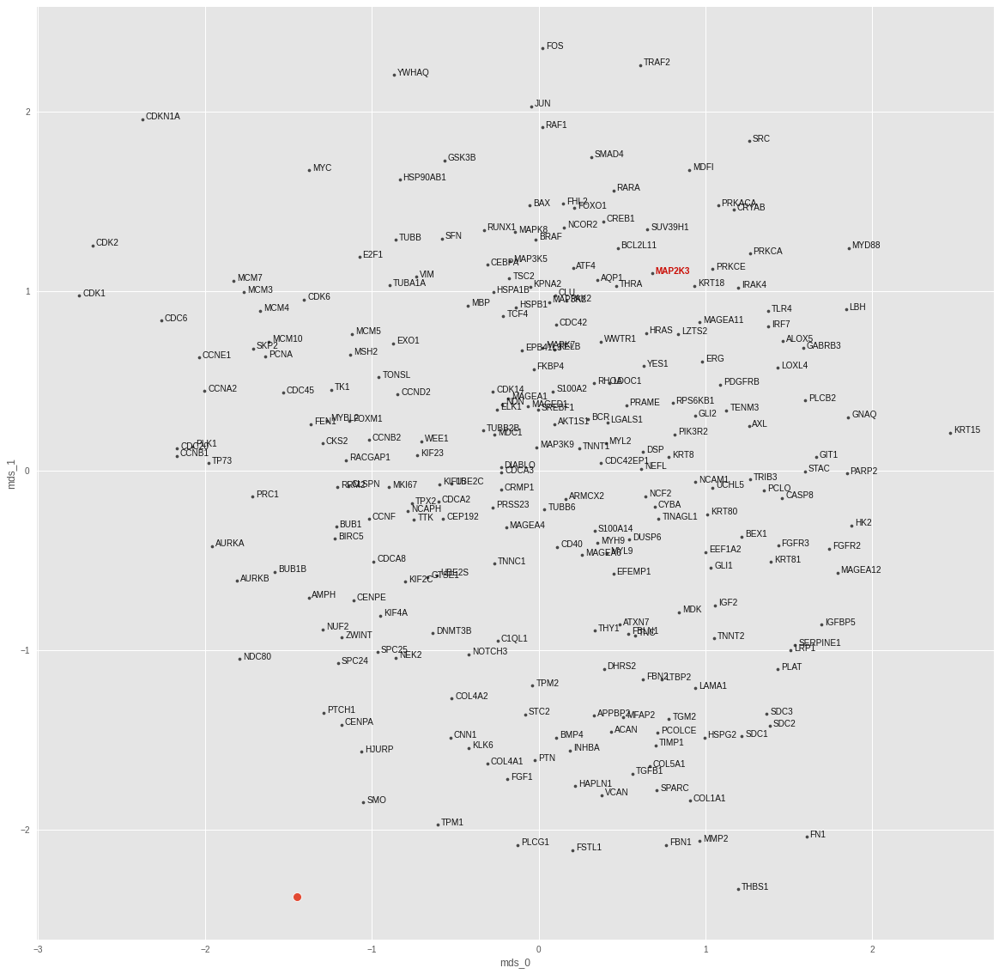

MAP3K2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 5.953835582323862e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0025275100488215685
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


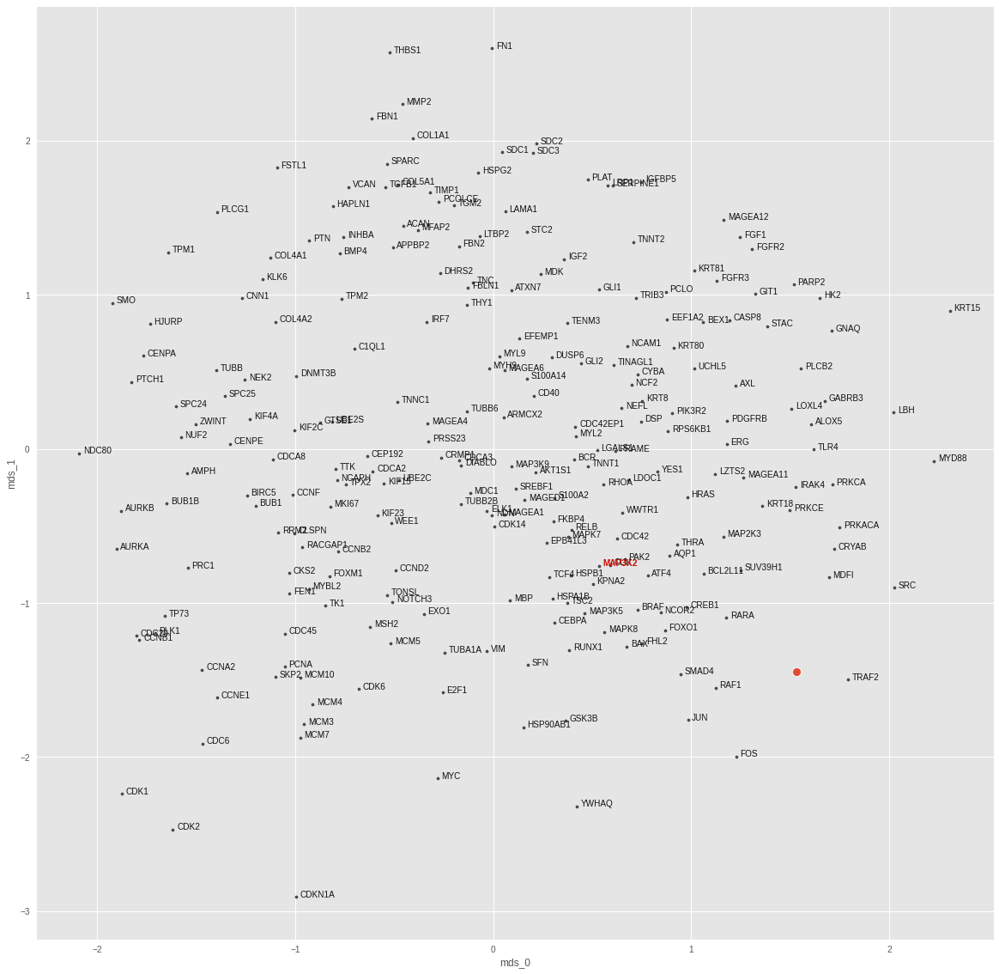

MAP3K5
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 5.530769091197535e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.001385053968988359
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


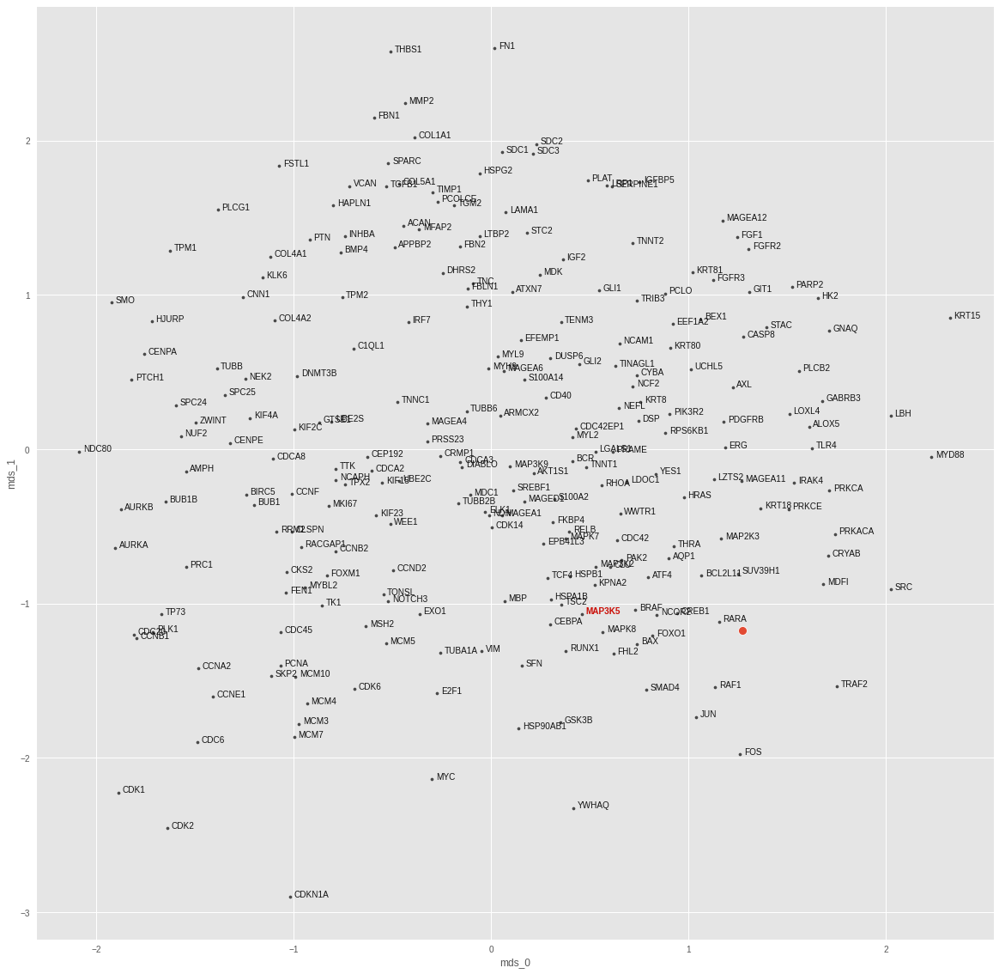

MAP3K9
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 6.495886114671042e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.005452452693134546
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


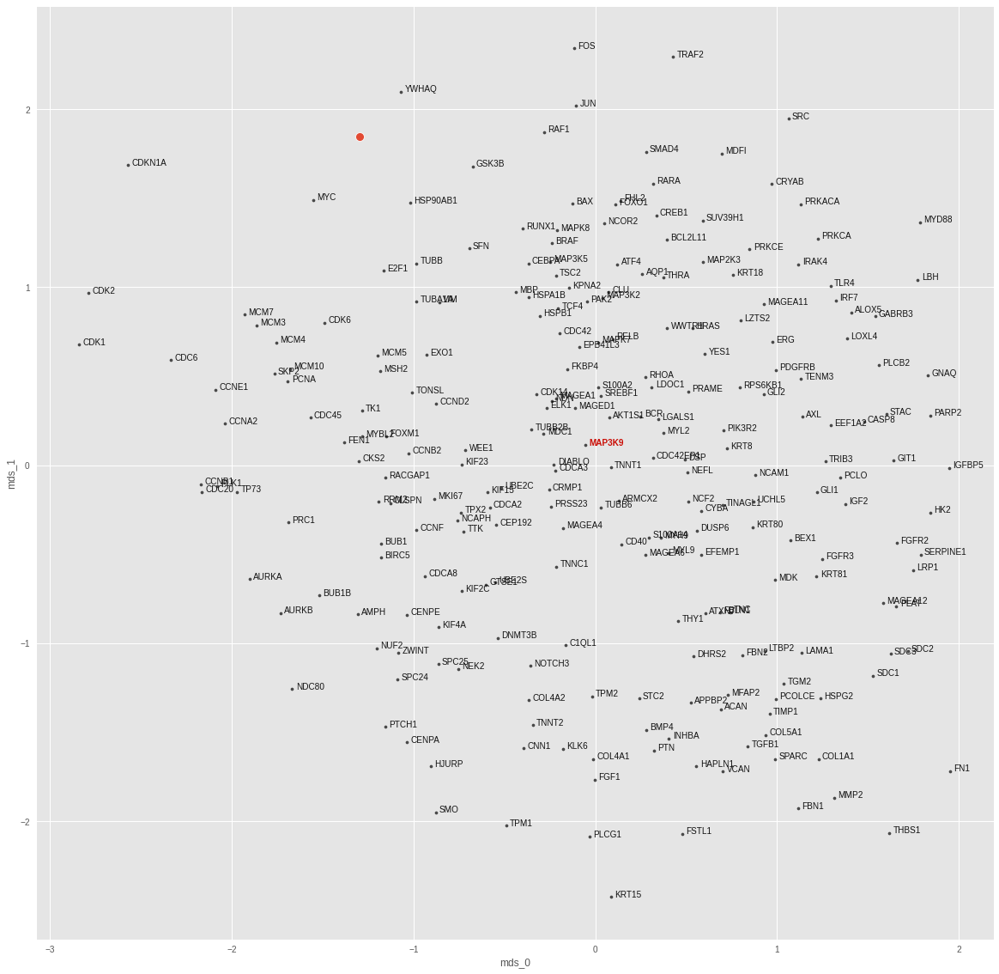

MAPK7
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 8.771659562817628e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0013994479086250067
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


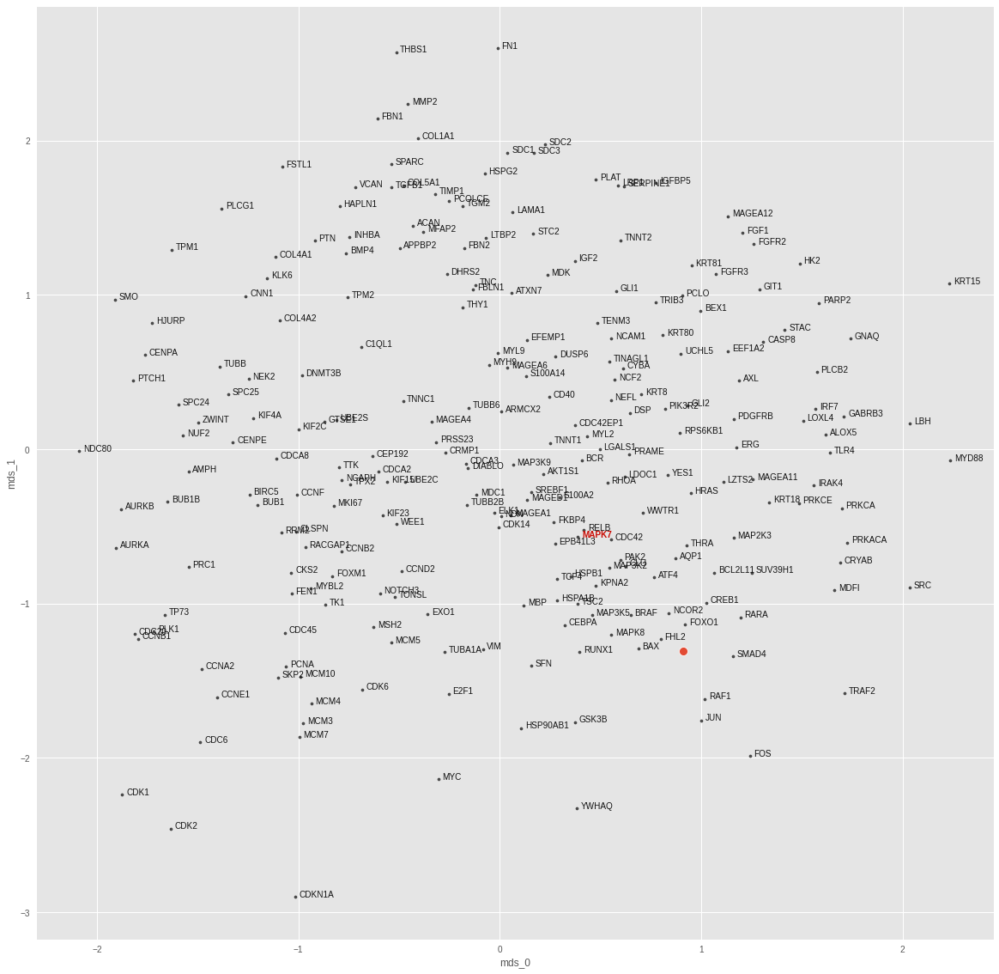

MYD88
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 3.886756856349836e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.005325329955667257
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


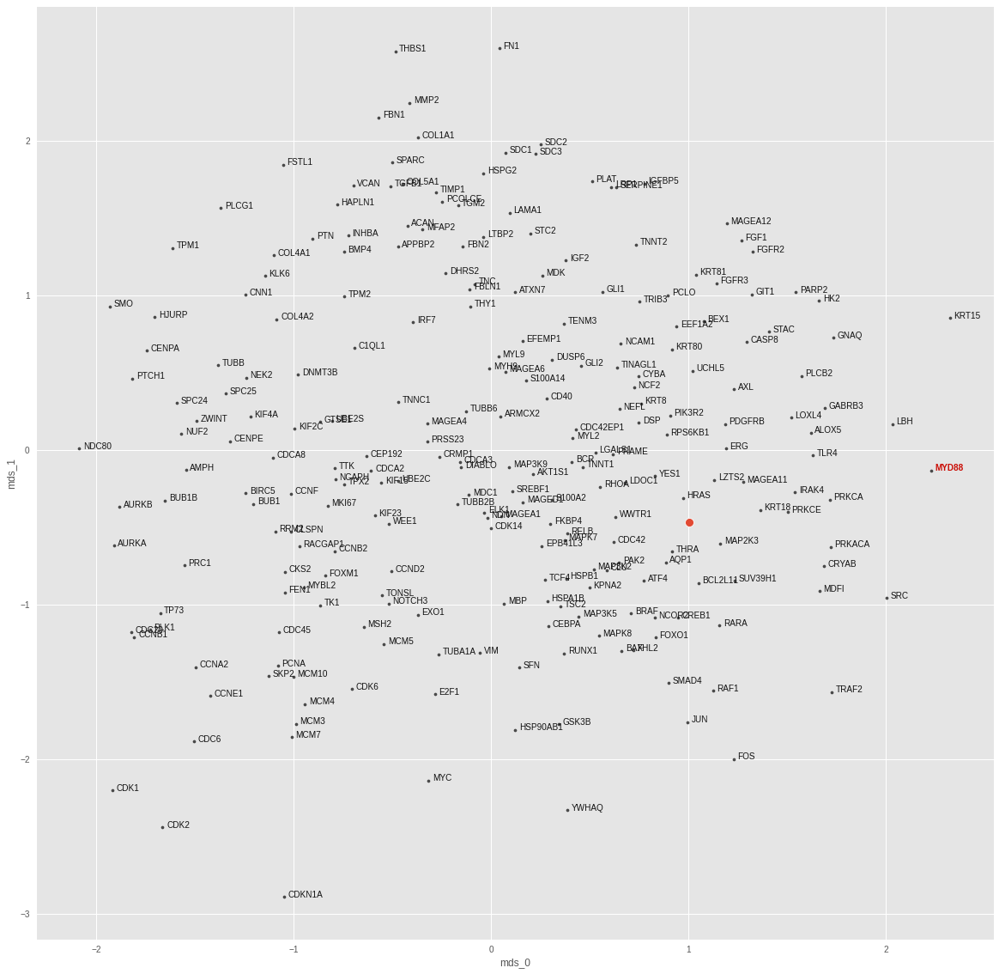

PIK3R2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 4.530937210227804e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0010481984354555607
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


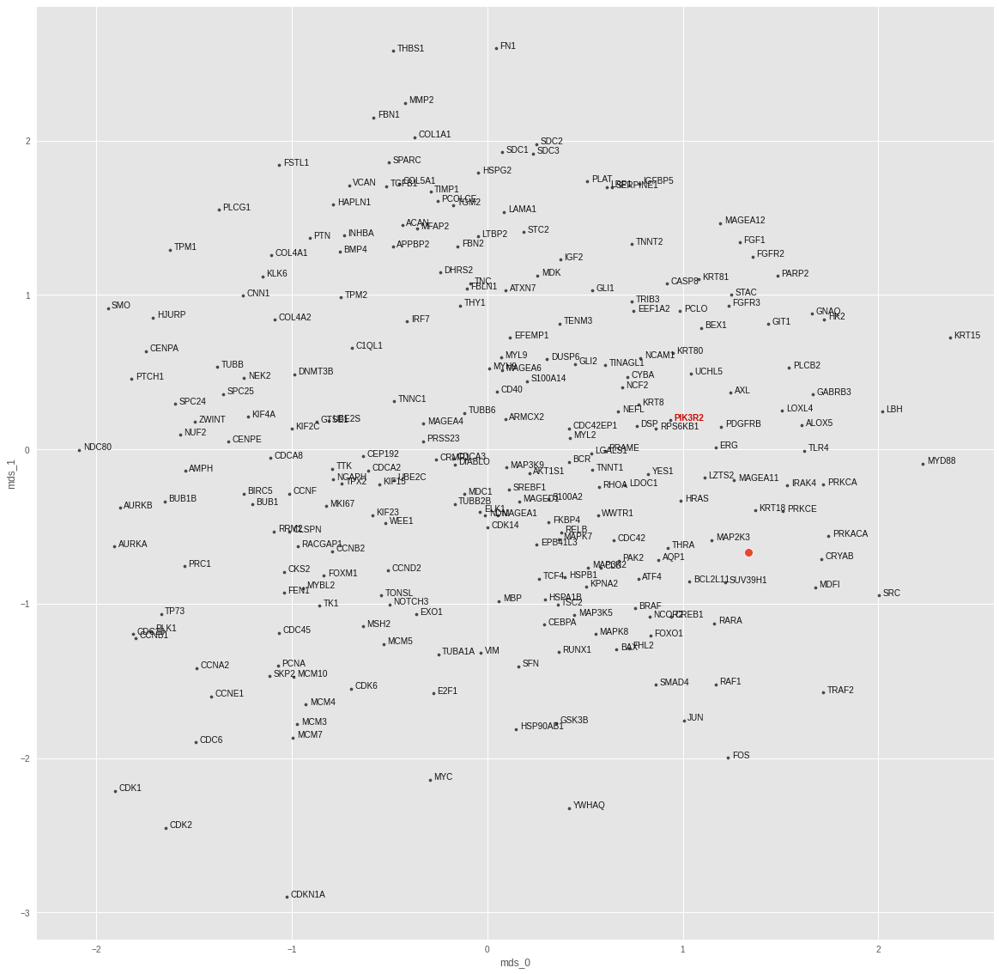

PRKACA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 3.891309231556462e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.008690694347023964
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


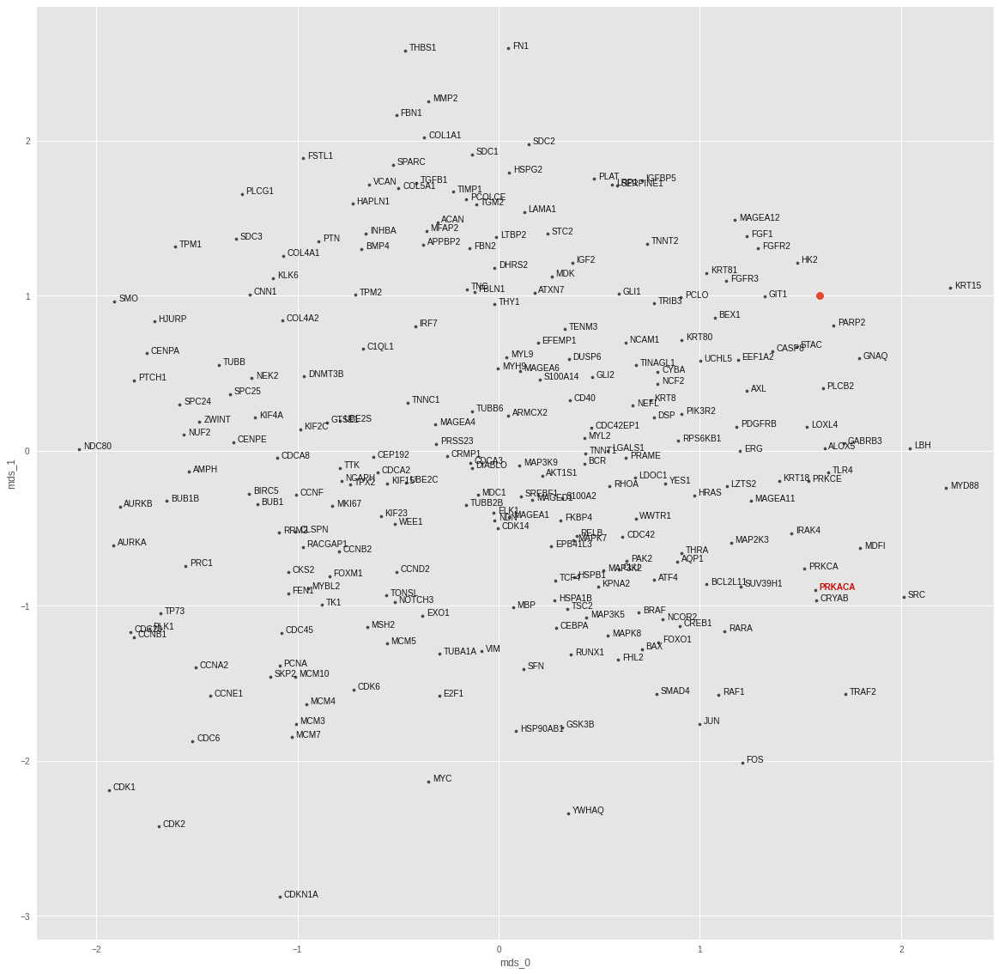

PRKCE
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 3.563040847534706e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.002894180826842785
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


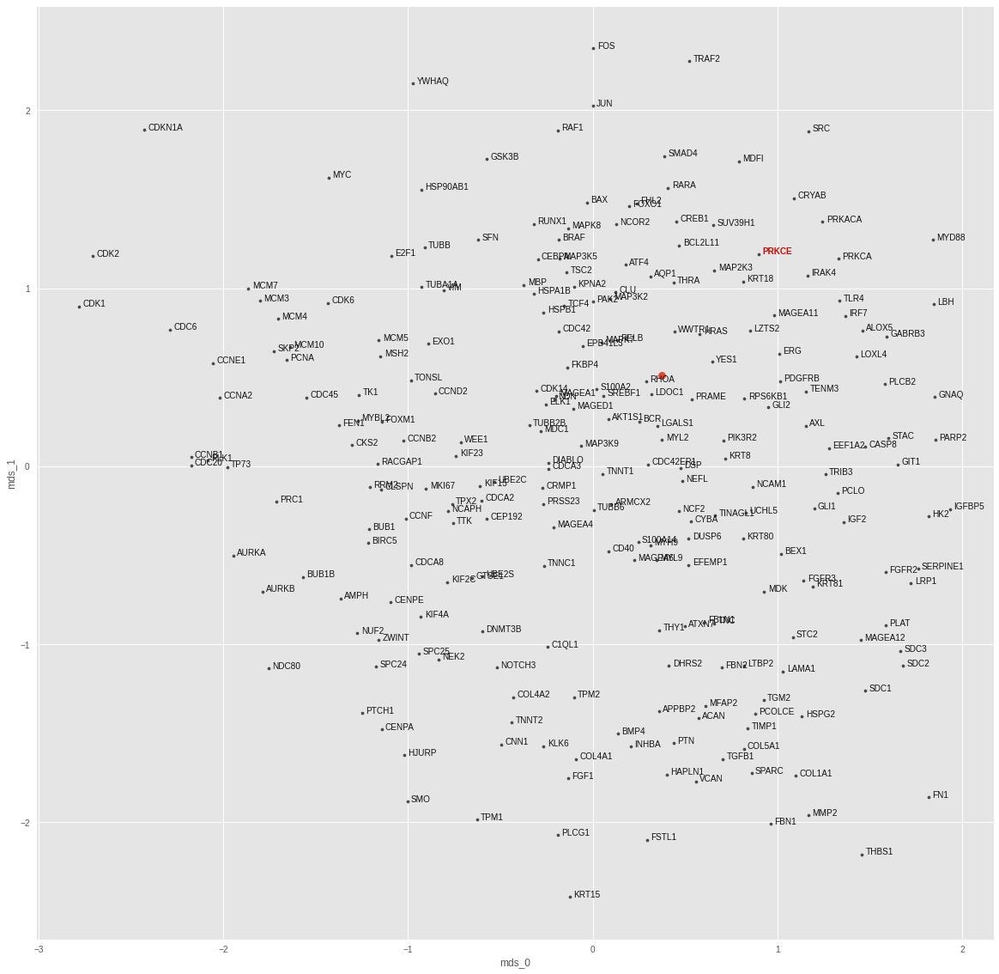

RAF1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 7.230550200849968e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0031882869079709053
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


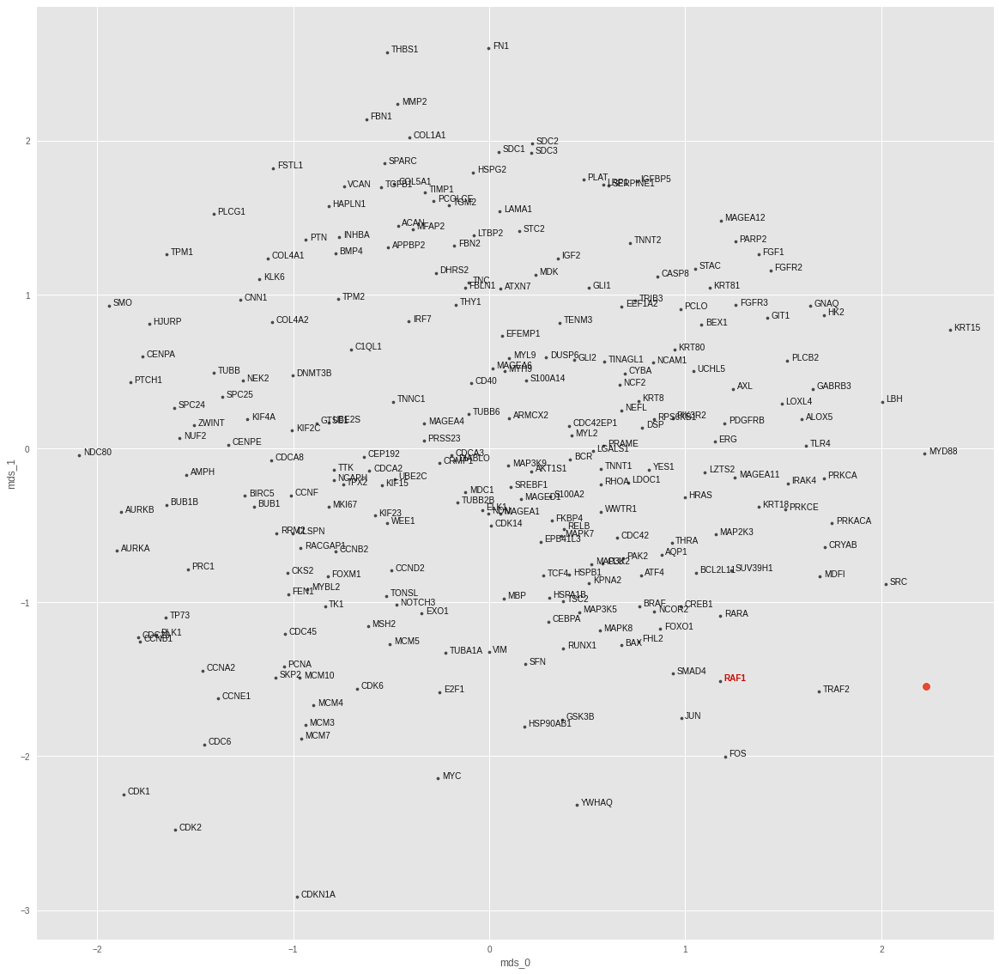

RELB
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 5.626788774143757e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0023037134669721127
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


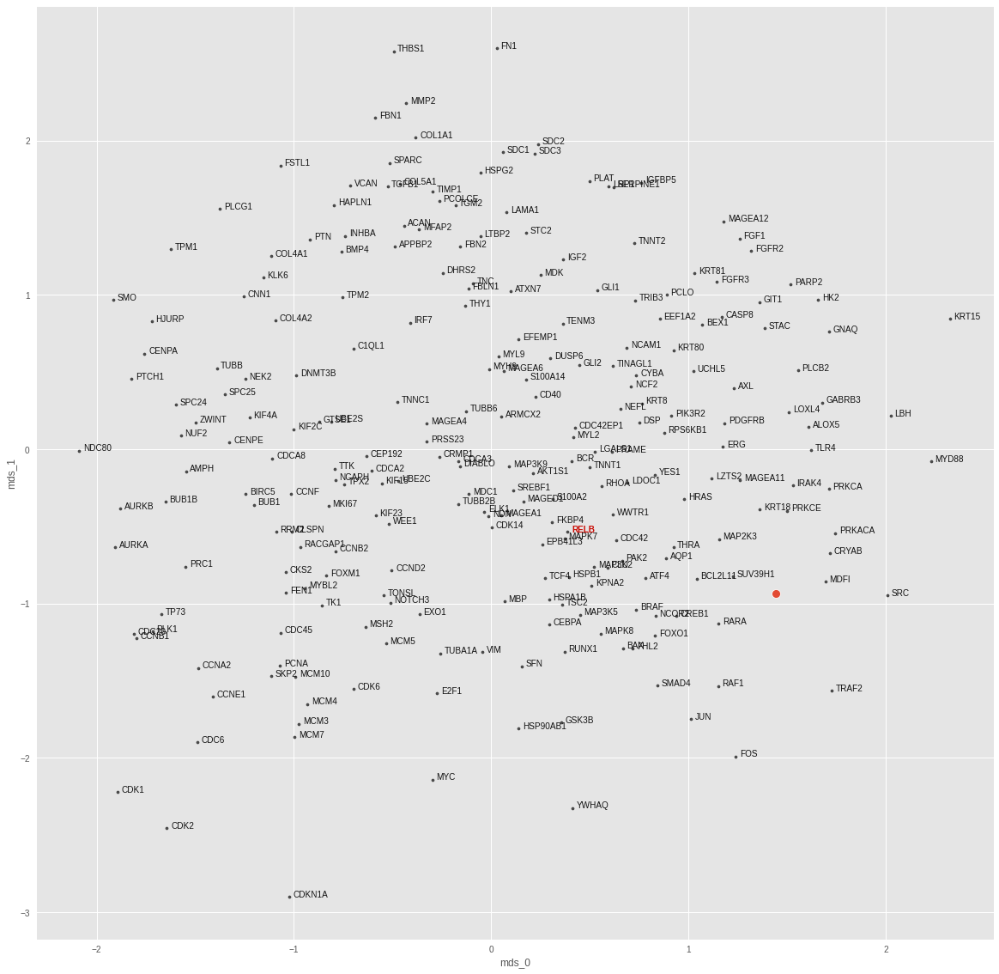

RHOA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 5.770317894578176e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.002083438215777278
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


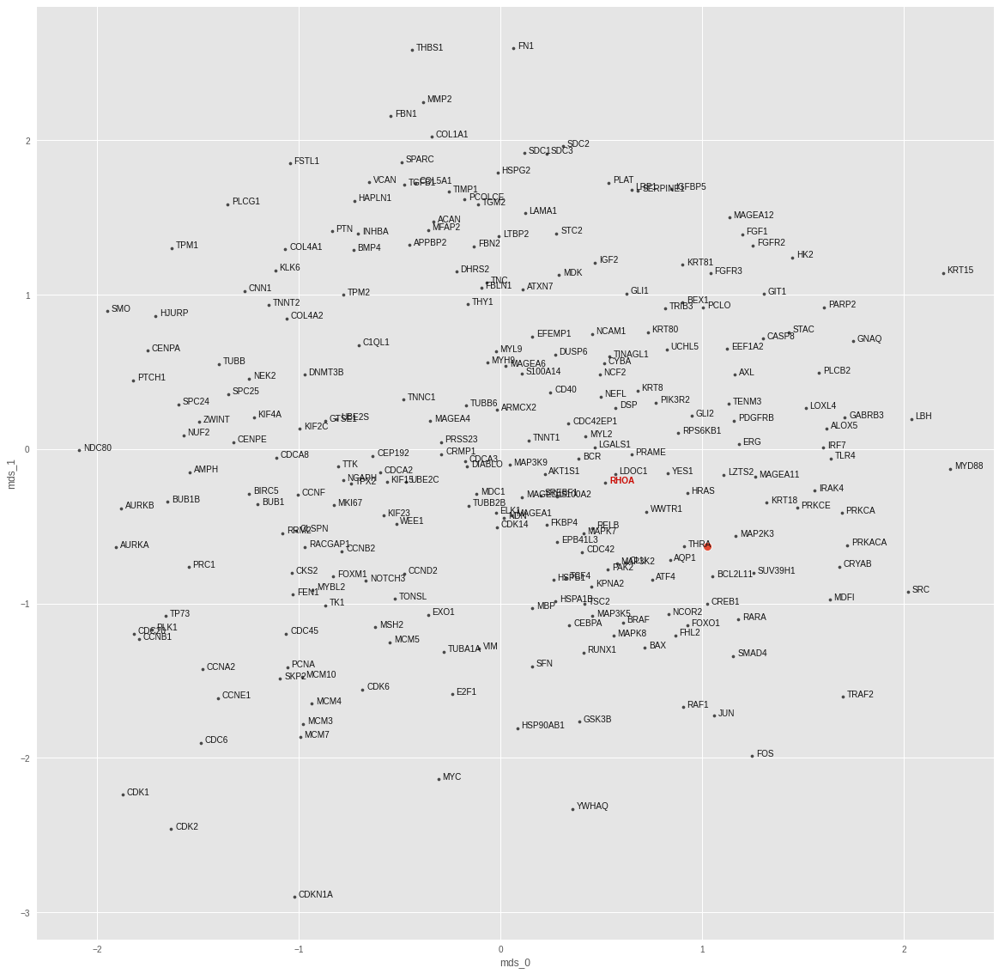

SMAD4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 5.8919006397972175e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0034599746577441692
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


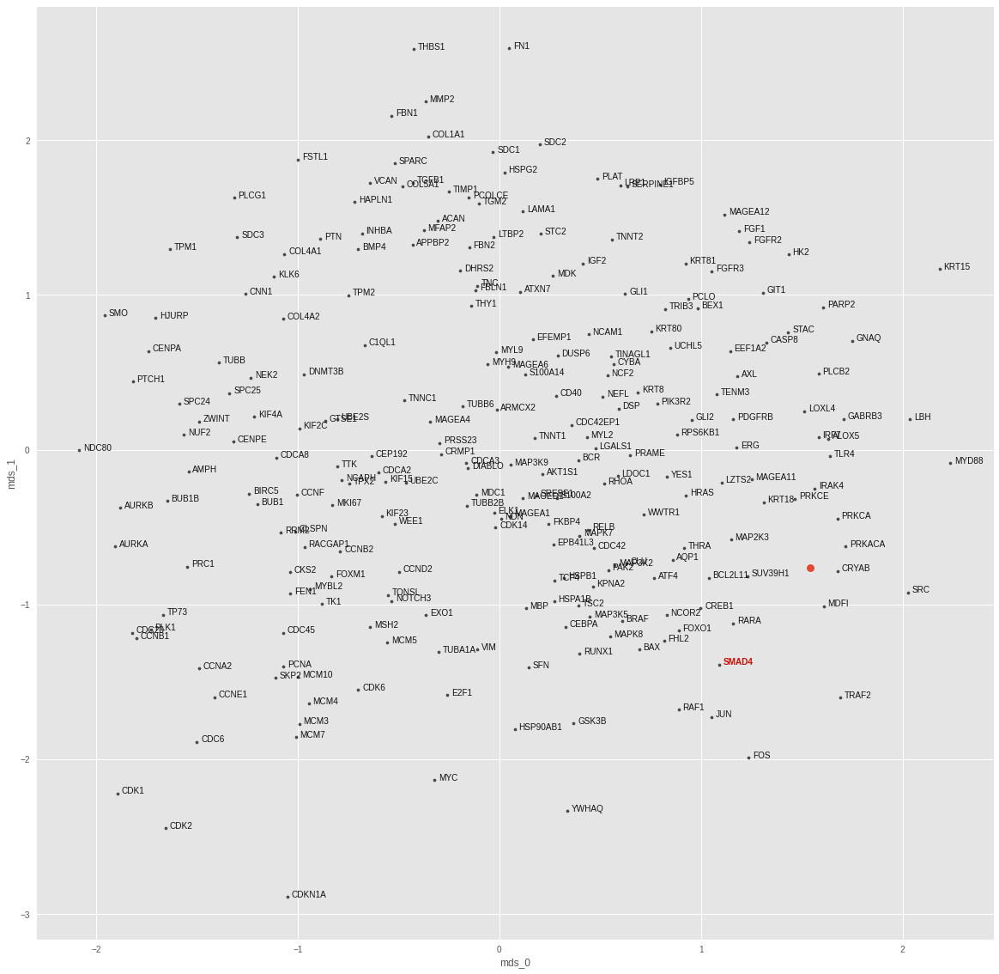

SMO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 5.5569427786394954e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.005148912779986858
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


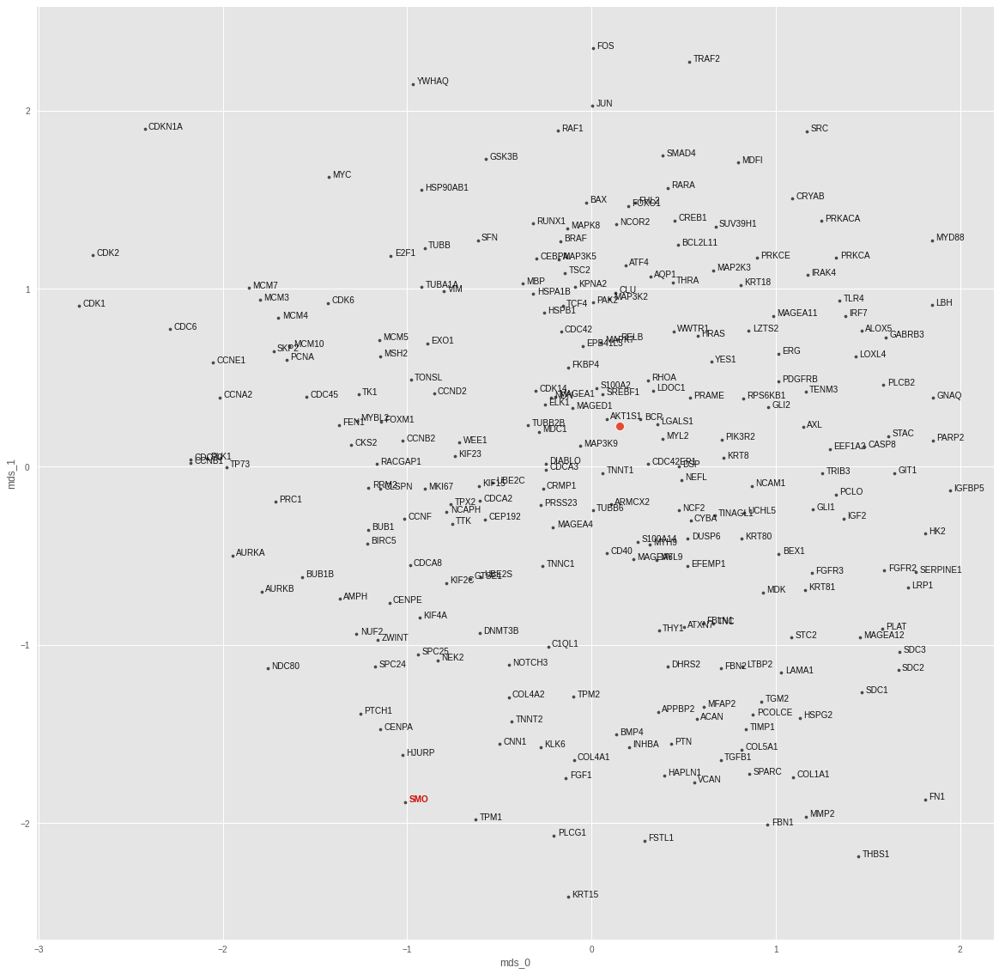

SRC
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 6.44308793677115e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004134763032197952
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


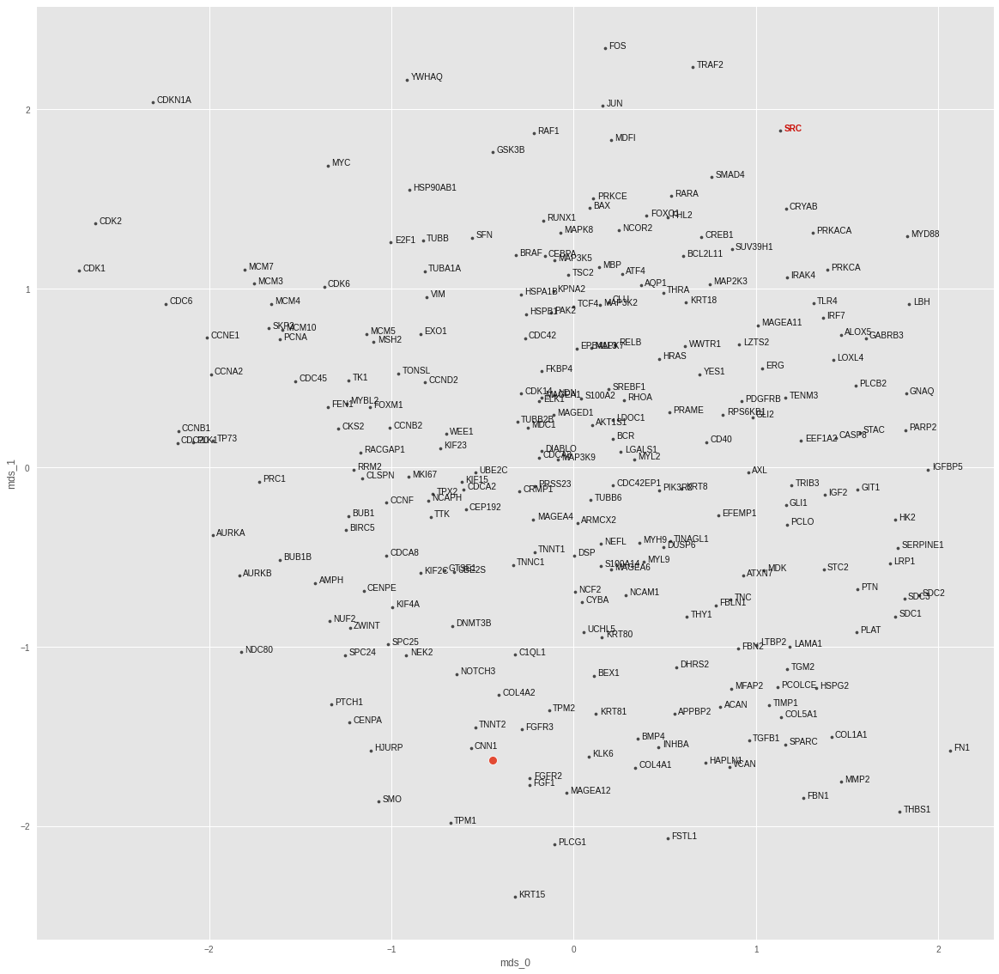

SREBF1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 5.763306092519901e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.001552235335111618
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


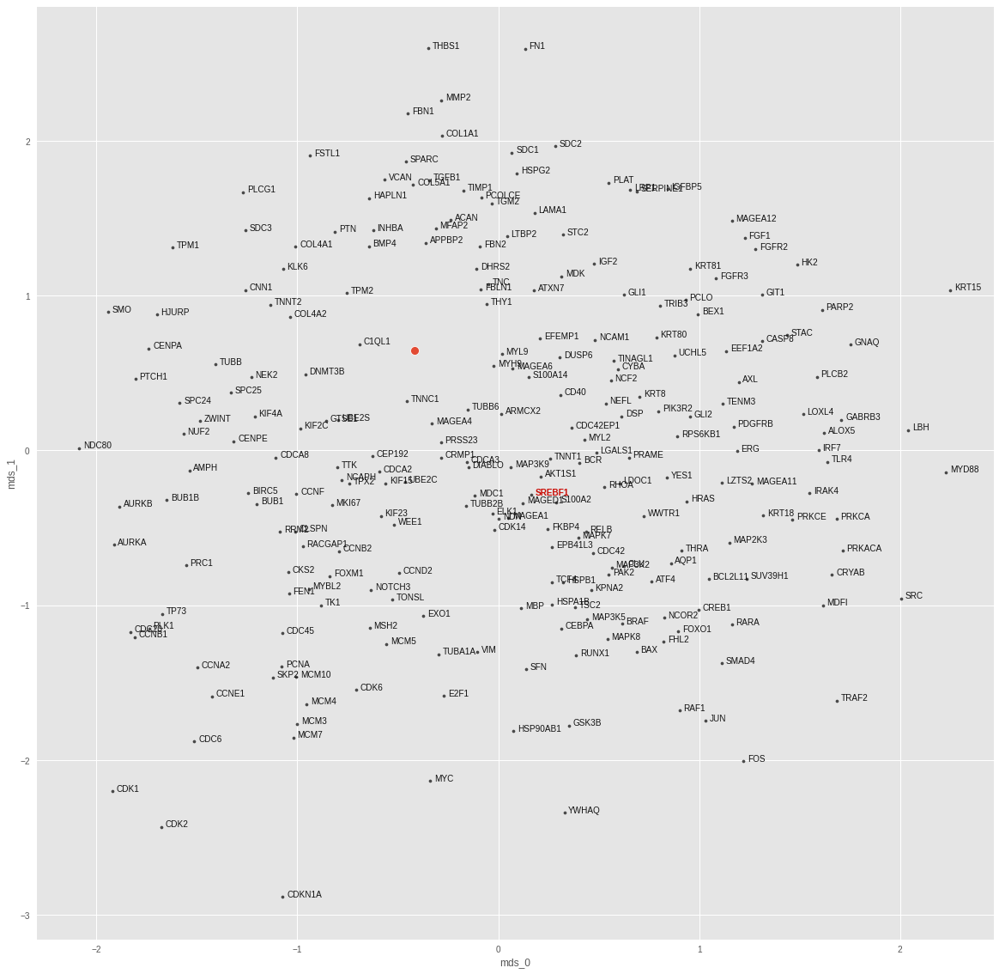

TRAF2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 6.347941560211199e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.006823578849434853
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


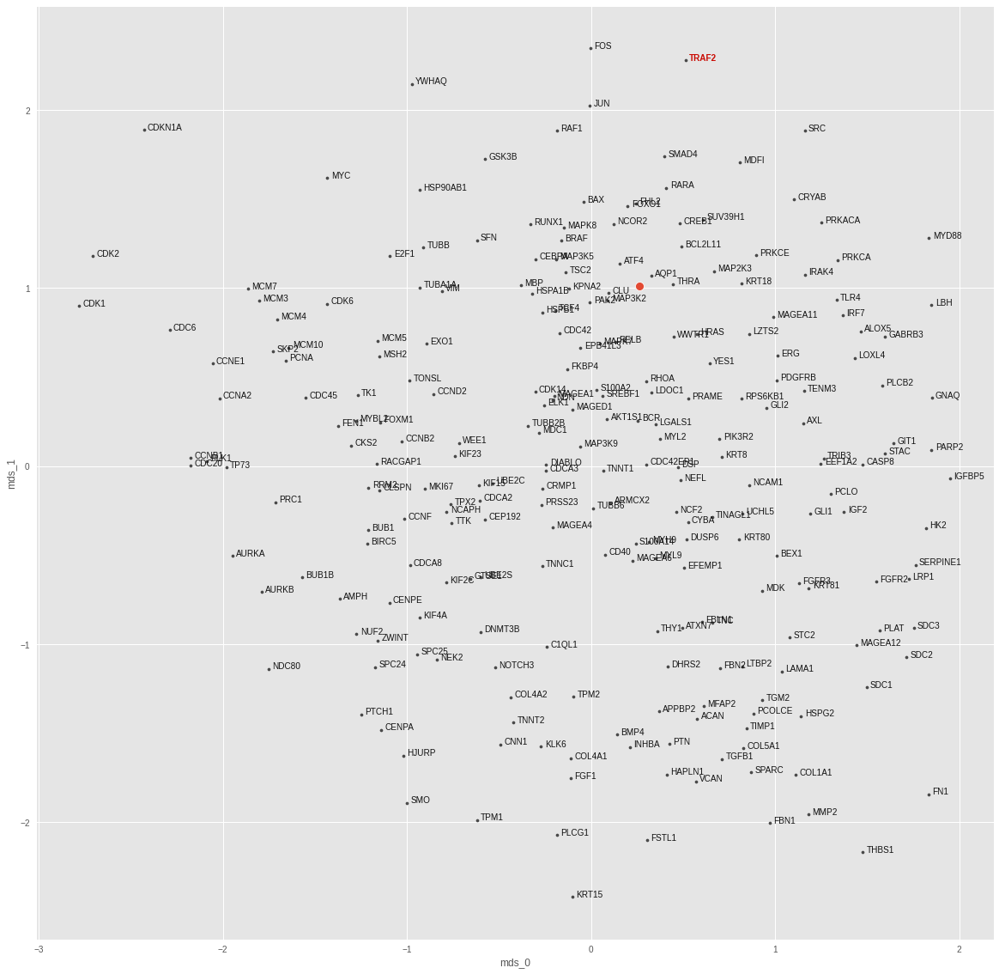

TSC2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 8.459491073153913e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.006470874883234501
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


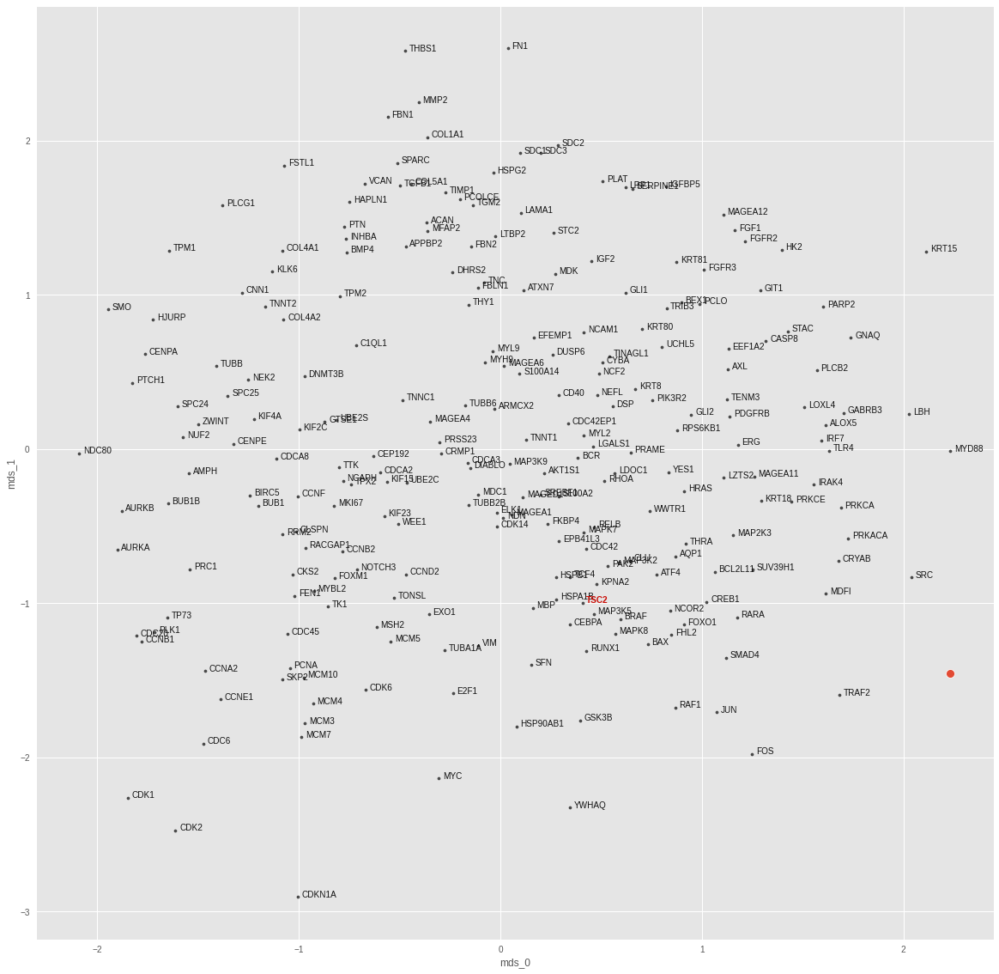

WWTR1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 6.227638292138611e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.006535591557621956
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


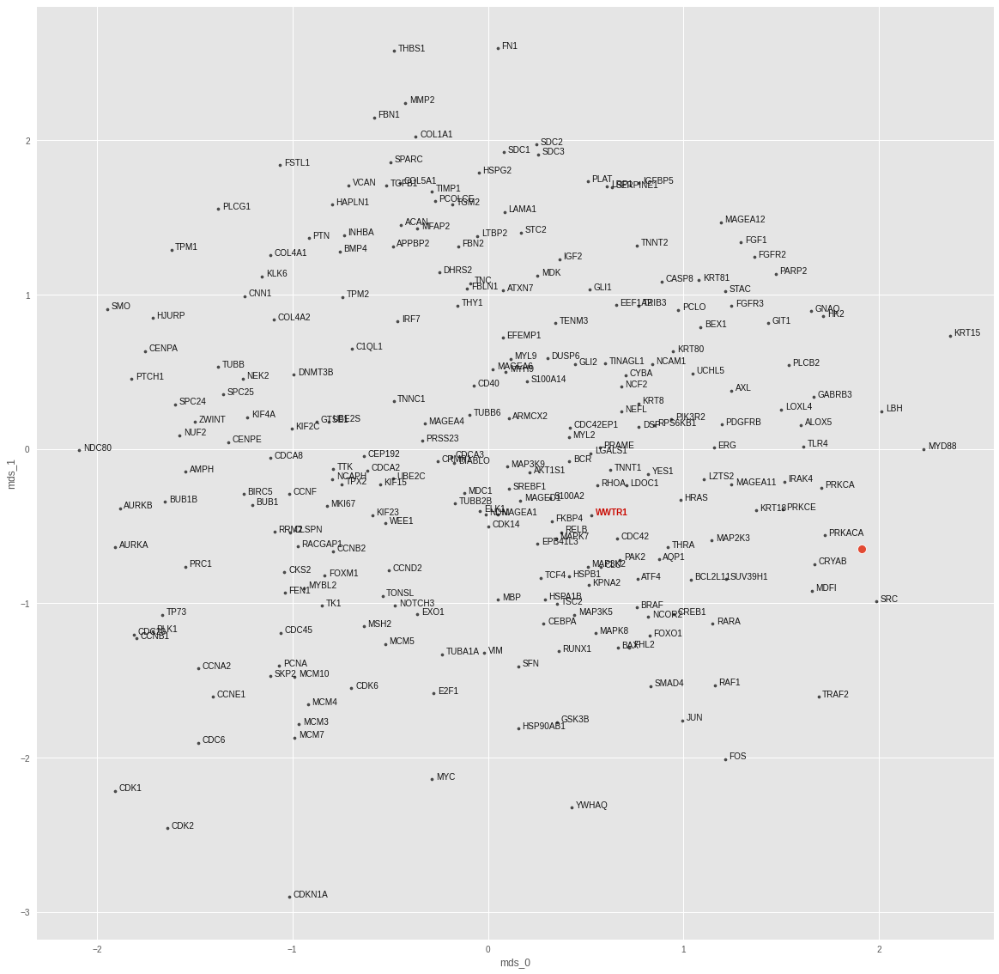

<IPython.core.display.Javascript object>

In [103]:
target_topk_accs = {}
mean_lin_nns = {}
for i in tqdm(range(len(data_dicts))):
    data_dict = data_dicts[i]
    model = torch.nn.Sequential(
        torch.nn.Linear(1024, 1024),
    )
    optimizer = Adam(model.parameters(), lr=1e-3)
    criterion = torch.nn.MSELoss()
    target = sorted(list(shared_targets))[i]
    print(target)
    fitted_model, topk_acc, _, mean_knns = train_model_topk_acc(
        model=model,
        data_dict=data_dict,
        optimizer=optimizer,
        criterion=criterion,
        n_epochs=1000,
        early_stopping=1000,
        nn_clf=nn_clf,
        log_epochs=False,
        use_val_data=False,
    )
    target_topk_accs[target] = topk_acc
    mean_lin_nns[target] = mean_knns[0]
    fig, ax, _ = plot_translation(
        fitted_model.to("cpu"),
        data_dict["test"].dataset,
        node_embs,
        figsize=[20, 20],
        crop=False,
        highlight_target=target,
        pred_size=100,
        reg_size=10,
    )
    ax.get_legend().remove()
    plt.show()
    plt.close()

In [104]:
mean_lin_topk_df = pd.DataFrame(target_topk_accs).transpose()
mean_lin_topk_df.loc[mean_lin_topk_df.loc[:, 50] > 0].sort_values(
    [1, 3, 5, 10, 20, 50], ascending=False
)

,1,3,5,10,20,50
RAF1,0.0,1.0,1.0,1.0,1.0,1.0
SREBF1,0.0,1.0,1.0,1.0,1.0,1.0
CDC42,0.0,0.0,1.0,1.0,1.0,1.0
MAP3K2,0.0,0.0,1.0,1.0,1.0,1.0
MAP3K5,0.0,0.0,0.0,1.0,1.0,1.0
MAPK7,0.0,0.0,0.0,1.0,1.0,1.0
PIK3R2,0.0,0.0,0.0,1.0,1.0,1.0
AKT1S1,0.0,0.0,0.0,0.0,1.0,1.0
BCL2L11,0.0,0.0,0.0,0.0,1.0,1.0
CREB1,0.0,0.0,0.0,0.0,1.0,1.0


<IPython.core.display.Javascript object>

In [105]:
mean_lin_topk_df.describe()

,1,3,5,10,20,50
count,39.0,39.000000,39.000000,39.000000,39.000000,39.000000
mean,0.0,0.051282,0.102564,0.179487,0.256410,0.435897
std,0.0,0.223456,0.307355,0.388776,0.442359,0.502356
min,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.0,0.000000,0.000000,0.000000,0.500000,1.000000
max,0.0,1.000000,1.000000,1.000000,1.000000,1.000000


<IPython.core.display.Javascript object>

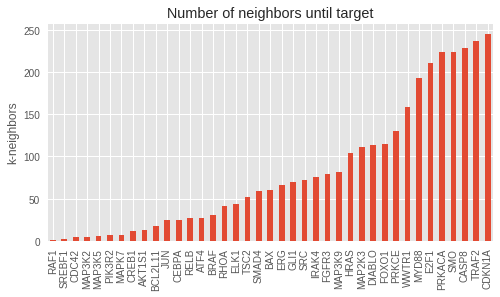

<IPython.core.display.Javascript object>

In [106]:
mpl.style.use("ggplot")
mean_lin_khits = get_knn_hit_data(mean_lin_nns)
ax = mean_lin_khits.knn_hit.sort_values().plot(kind="bar", figsize=[8, 4])
ax.set_ylabel("k-neighbors")
ax.set_title("Number of neighbors until target")
plt.show()

In [107]:
mean_5nn_dict = get_mean_knn_dict(img_embs_fold0, k=10)
mean_5nn_dict["CDC42"]

['BRAF',
 'MAP3K2',
 'PRKCE',
 'RHOA',
 'ELK1',
 'MYD88',
 'TRAF2',
 'SRC',
 'MAP3K9',
 'PRKACA']

<IPython.core.display.Javascript object>

In [108]:
mean_lin_nns["CDC42"]

array(['MDFI', 'PRKCE', 'HSP90AB1', 'KRT18', 'CDC42', 'LDOC1', 'KRT15',
       'UCHL5', 'TNNT1', 'DSP', 'FKBP4', 'BRAF', 'CDC42EP1', 'HK2', 'VIM',
       'NCF2', 'RAF1', 'CYBA', 'KRT80', 'MAGED1', 'NEFL', 'HSPB1',
       'S100A2', 'KPNA2', 'LGALS1', 'KRT8', 'PAK2', 'MAP3K9', 'PIK3R2',
       'HSPA1B', 'BEX1', 'MAGEA12', 'BCR', 'S100A14', 'KRT81', 'YWHAQ',
       'HRAS', 'AQP1', 'TINAGL1', 'RHOA', 'CDK14', 'MCM5', 'MAP3K5',
       'MAPK8', 'MYH9', 'TRAF2', 'TPM1', 'MAGEA6', 'CLU', 'FGFR3', 'MDC1',
       'TPM2', 'AKT1S1', 'ATF4', 'TCF4', 'MAGEA1', 'MAPK7', 'EPB41L3',
       'MAP3K2', 'CNN1', 'MYL9', 'SFN', 'ARMCX2', 'MYL2', 'CRMP1',
       'DIABLO', 'AXL', 'CDCA3', 'TUBB6', 'ELK1', 'DUSP6', 'TUBB',
       'MAP2K3', 'MAGEA4', 'CD40', 'NCAM1', 'TUBB2B', 'FGFR2', 'WEE1',
       'NCOR2', 'TUBA1A', 'TNNT2', 'TONSL', 'PRAME', 'LZTS2', 'RELB',
       'PDGFRB', 'EFEMP1', 'FGF1', 'THRA', 'ATXN7', 'MYC', 'TK1', 'CCND2',
       'EXO1', 'CEBPA', 'TTK', 'NDN', 'CDK6', 'UBE2C', 'JUN', 'BAX',
       '

<IPython.core.display.Javascript object>

---

### 2.3. Nonlinear mean prediction

We do apply the same scheme using a simple 3-layer nonlinear network.

  0%|          | 0/39 [00:00<?, ?it/s]

AKT1S1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 8.679877869087105e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0012237471528351307
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


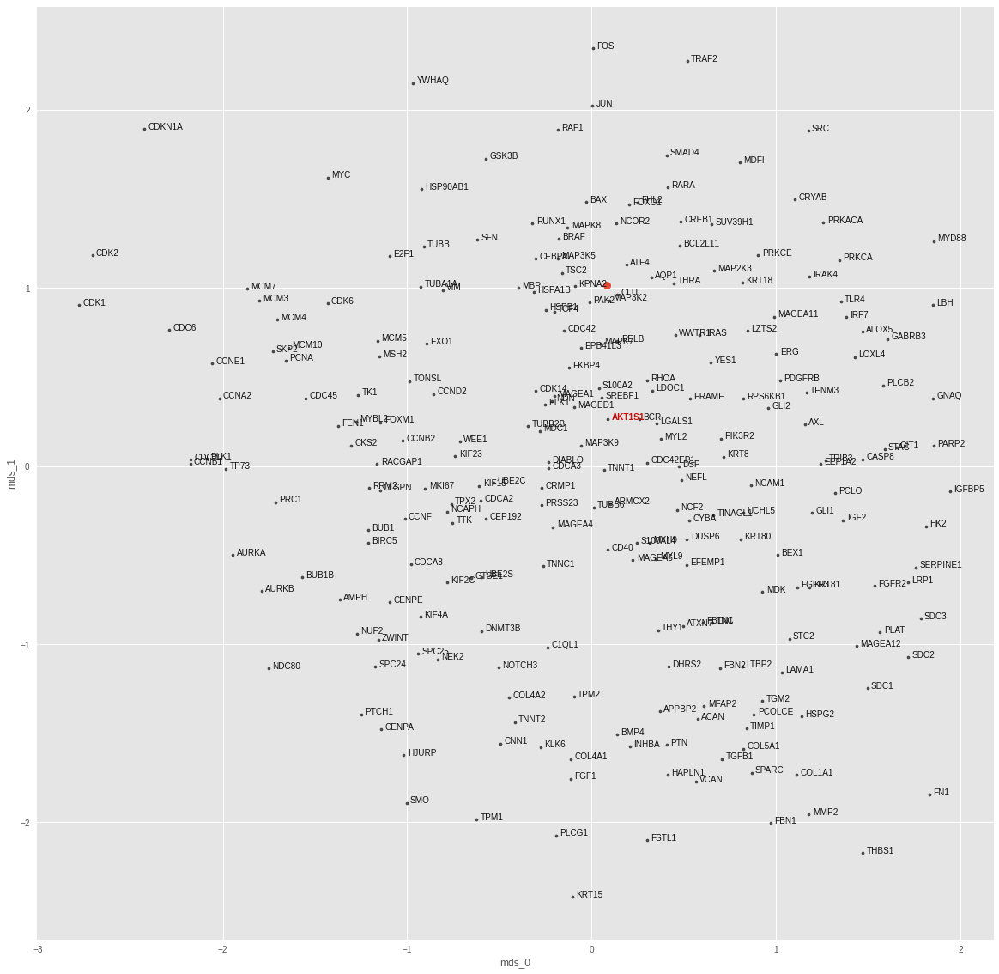

ATF4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.0888269717892591e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.001693372498266399
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


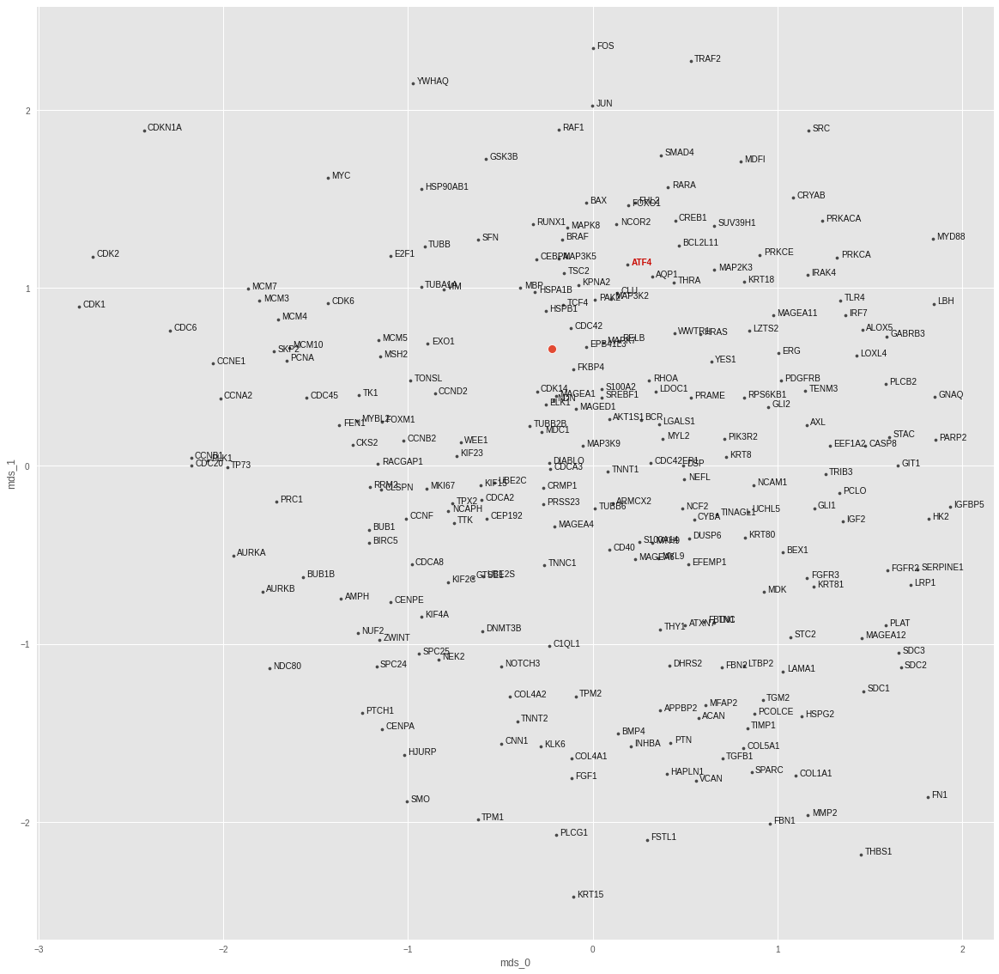

BAX
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.1964415486880553e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.002269068267196417
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


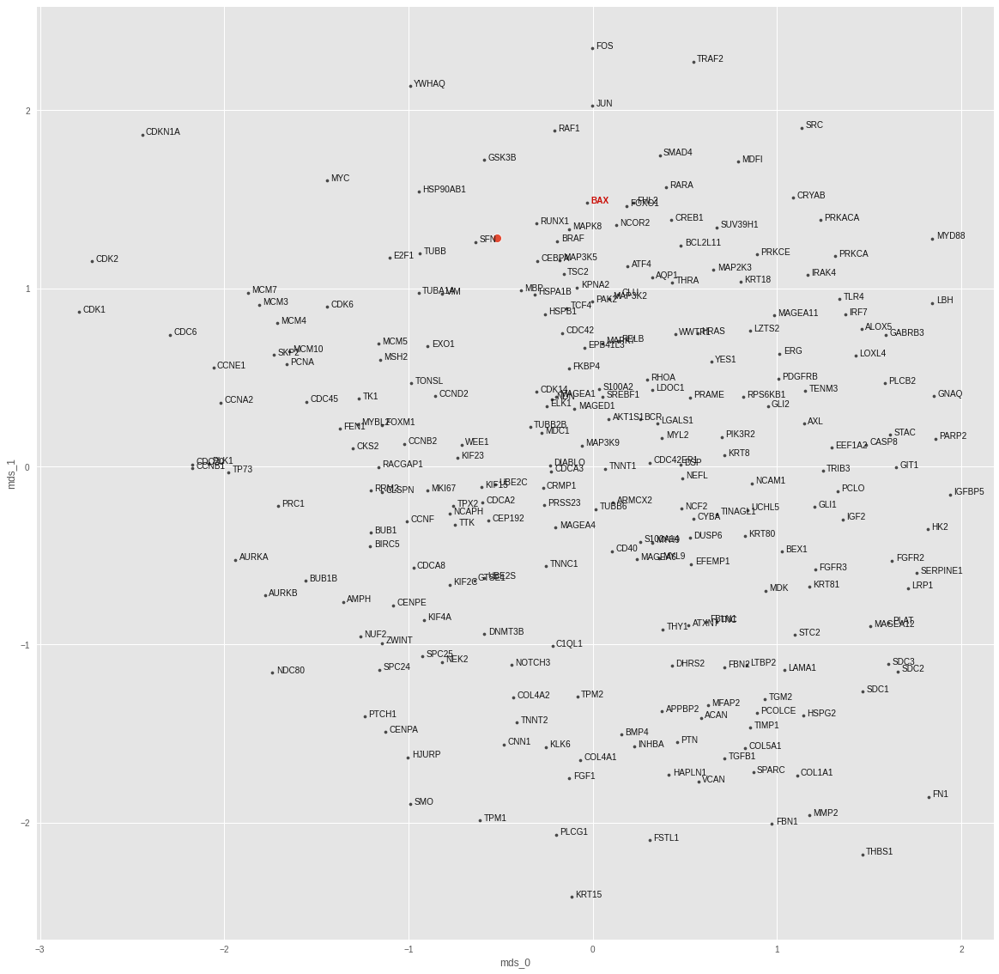

BCL2L11
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.1745760066093537e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.00299006886780262
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


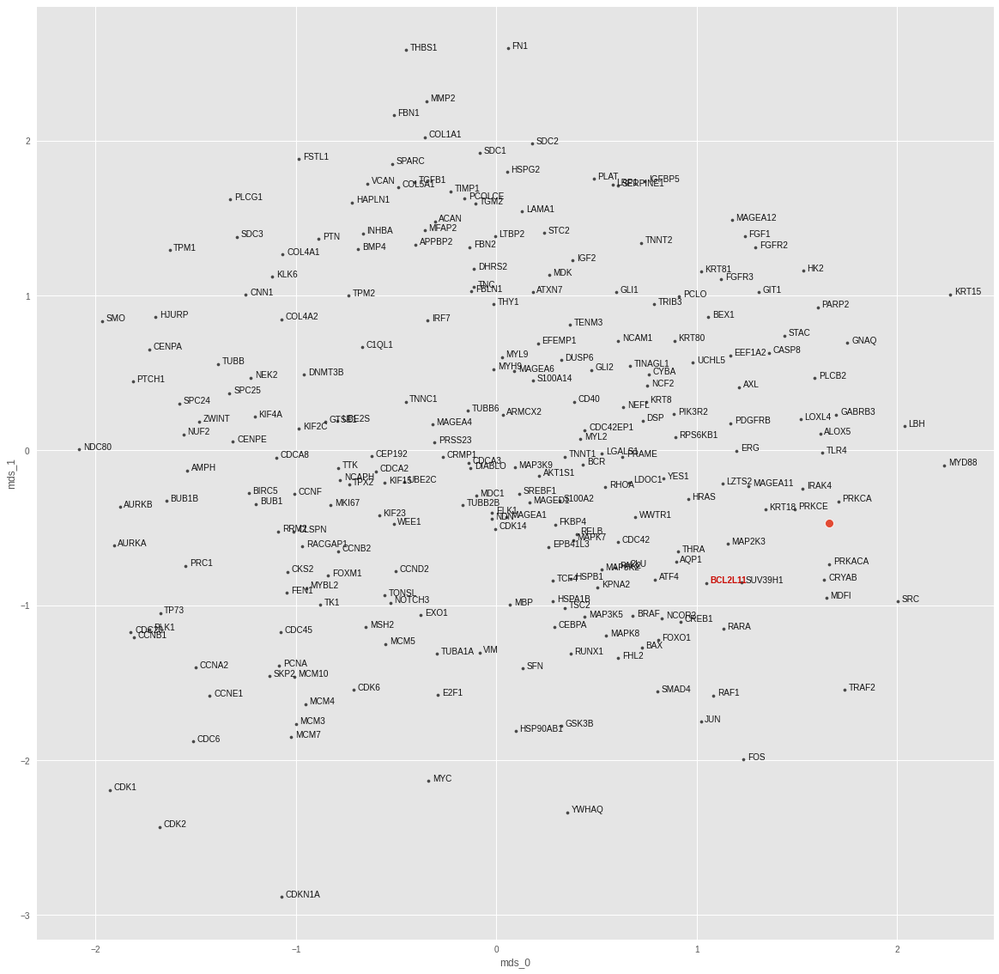

BRAF
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 9.324640084167569e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0005780997453257442
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


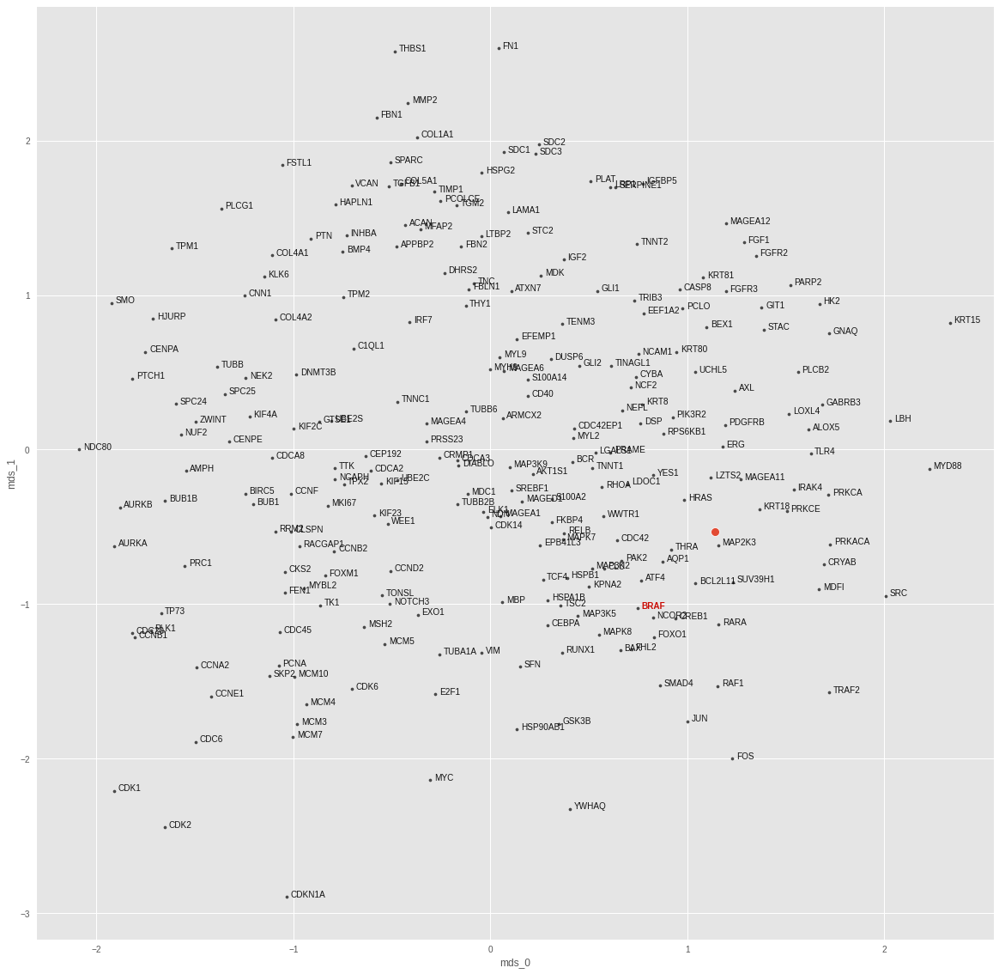

CASP8
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 9.962311411838623e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.006692611146718264
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


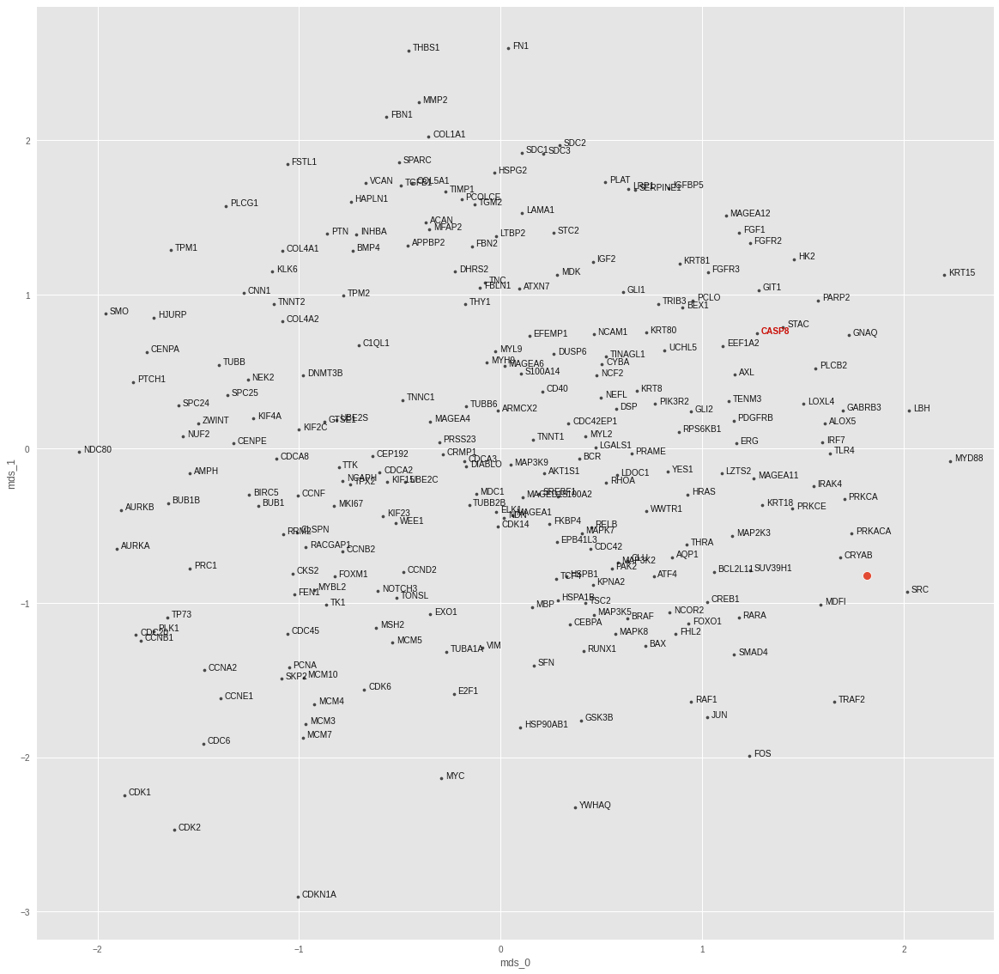

CDC42
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.3878408672577568e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0009576663142070174
test top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


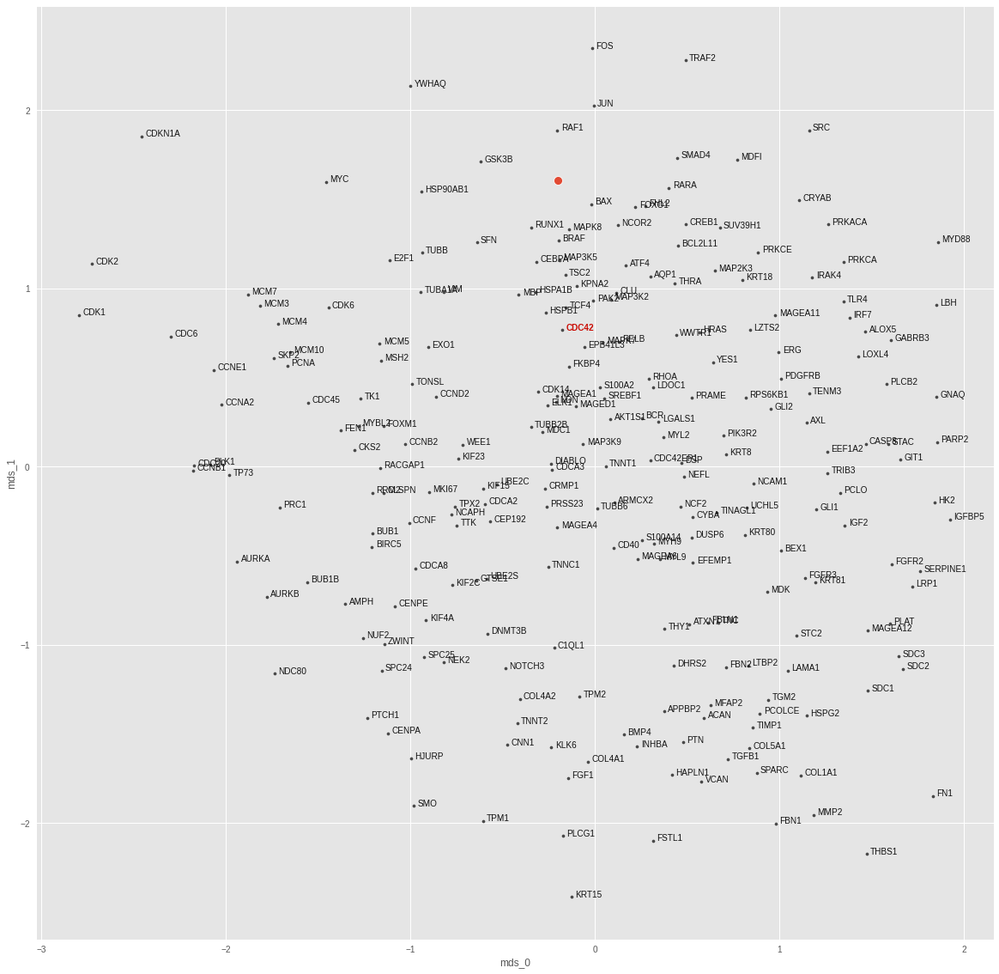

CDKN1A
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.2606484101764324e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.012379676103591919
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


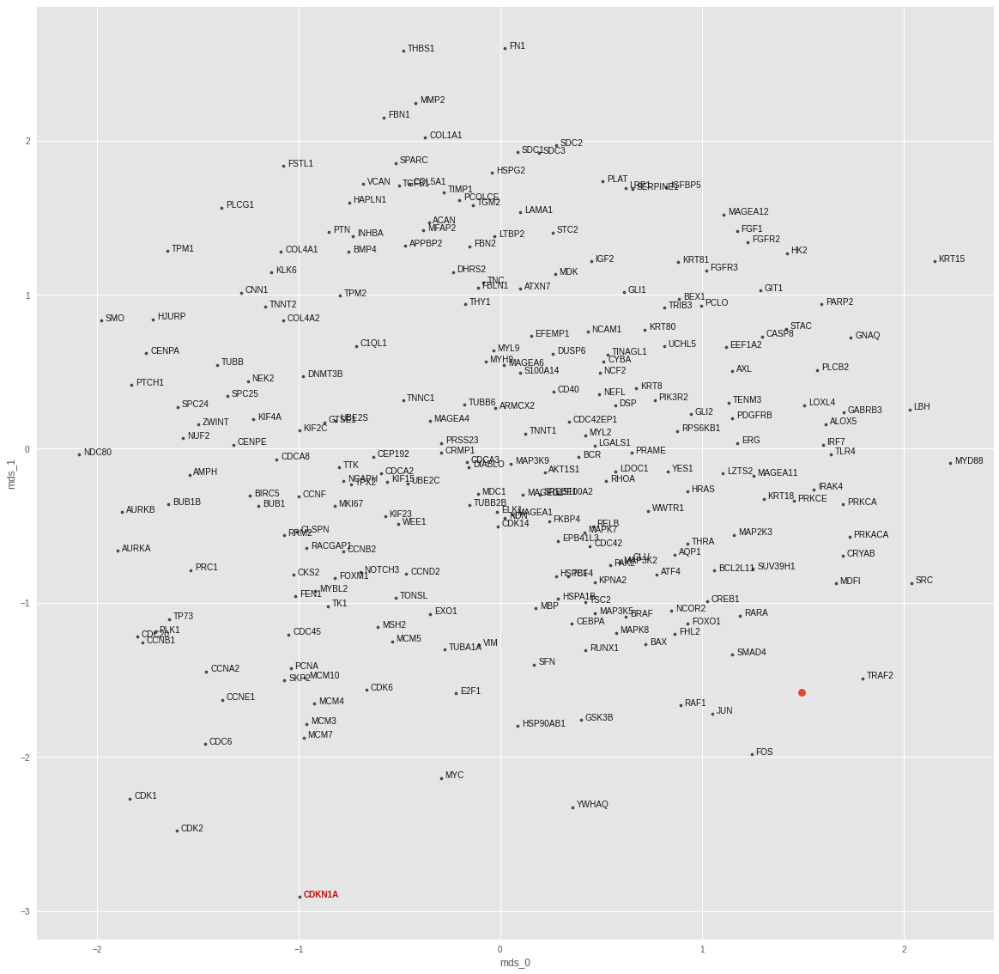

CEBPA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 9.232104084252282e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.002738793846219778
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


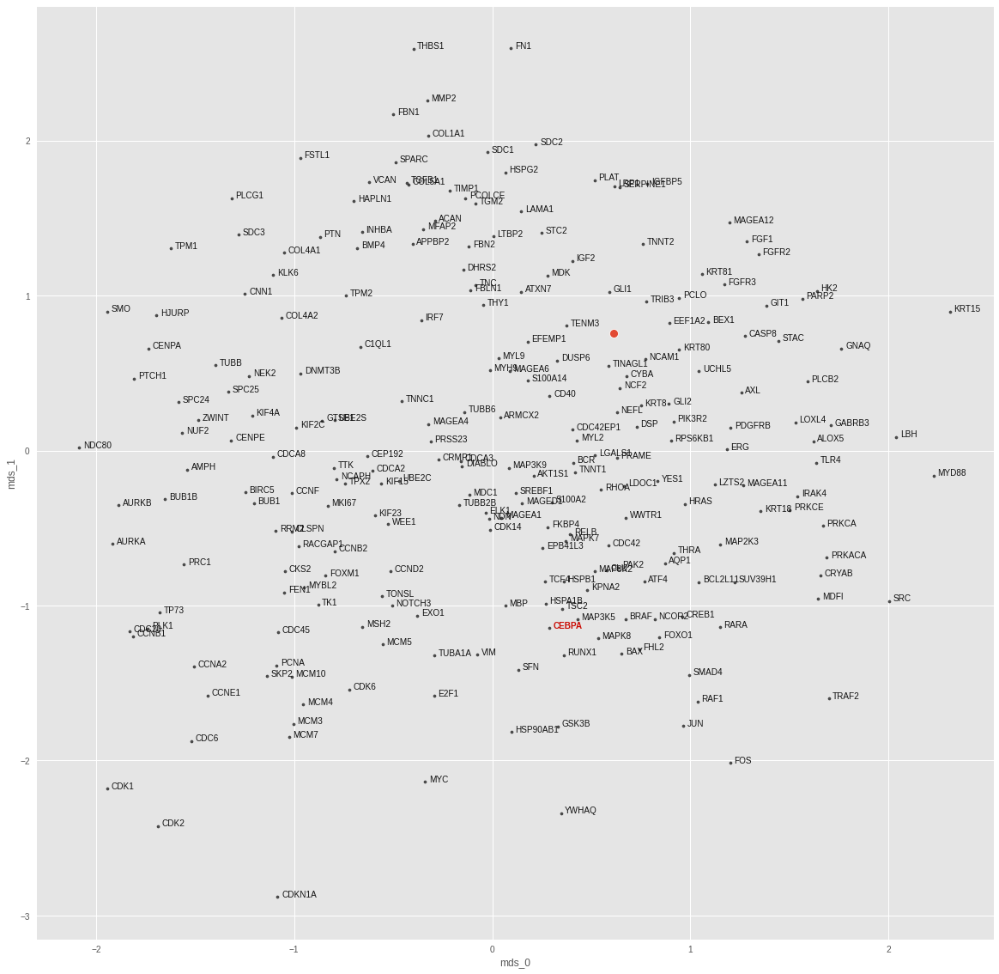

CREB1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.0143222293903052e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.002374434843659401
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


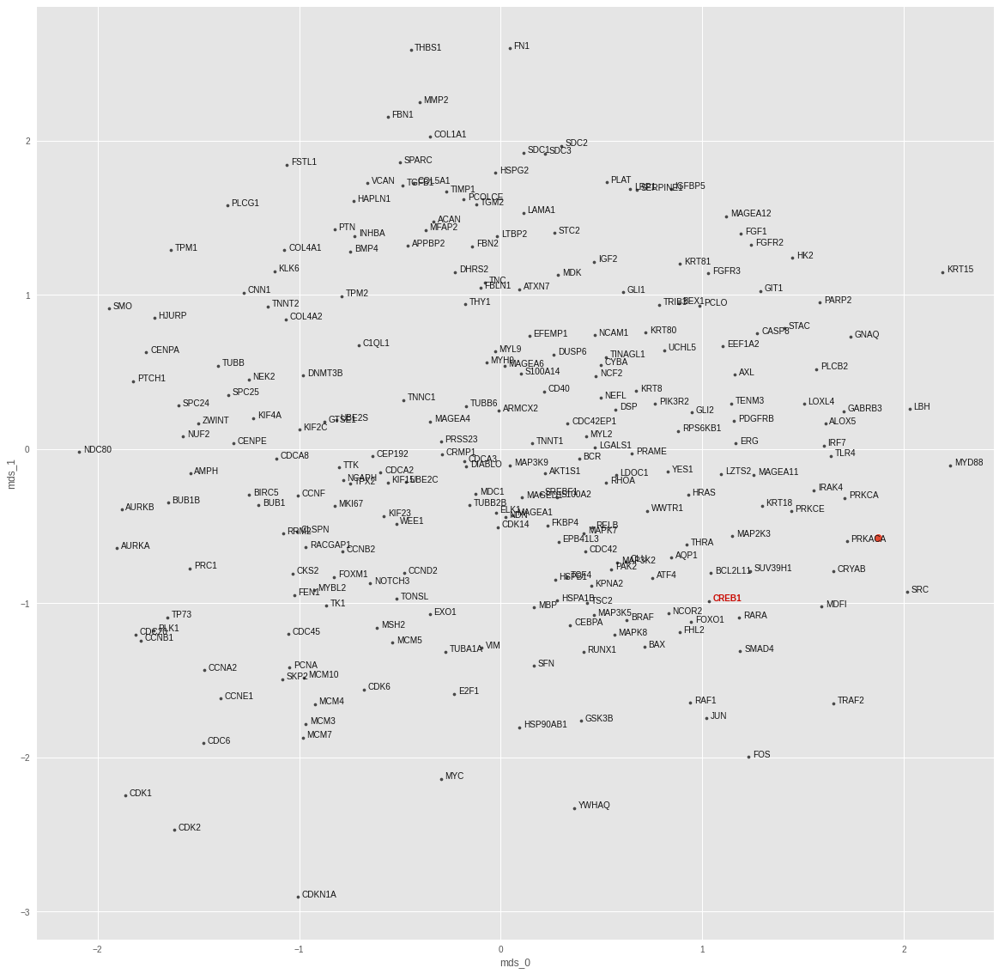

DIABLO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 9.59617921125755e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.002560021821409464
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


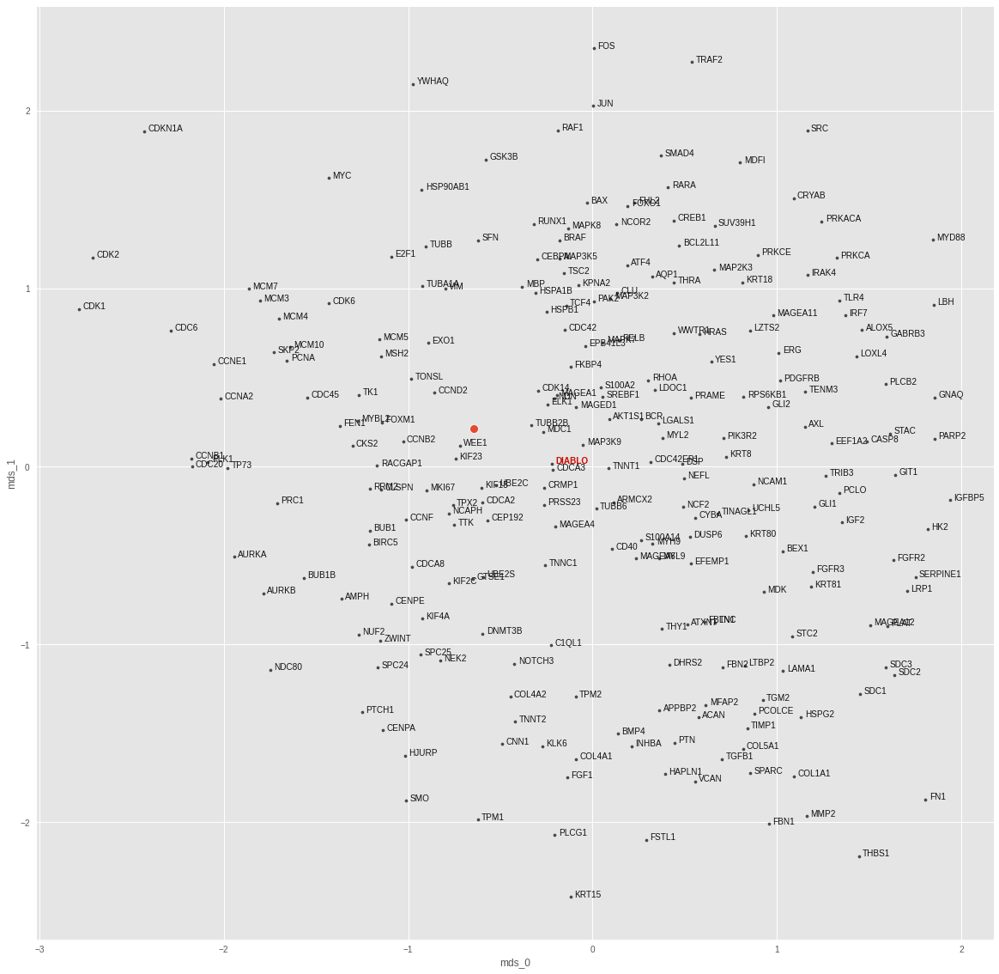

E2F1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.1555613953437148e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0075015053153038025
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


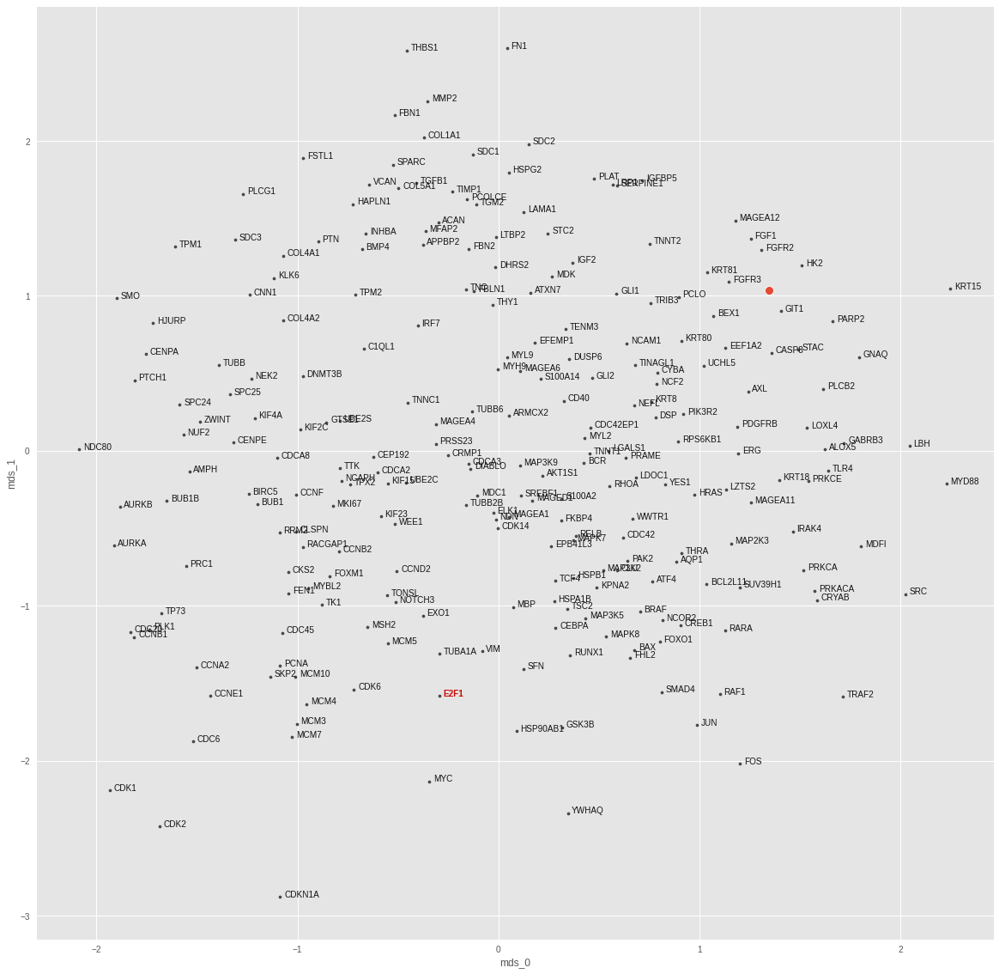

ELK1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.0851207195484772e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0016407959628850222
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


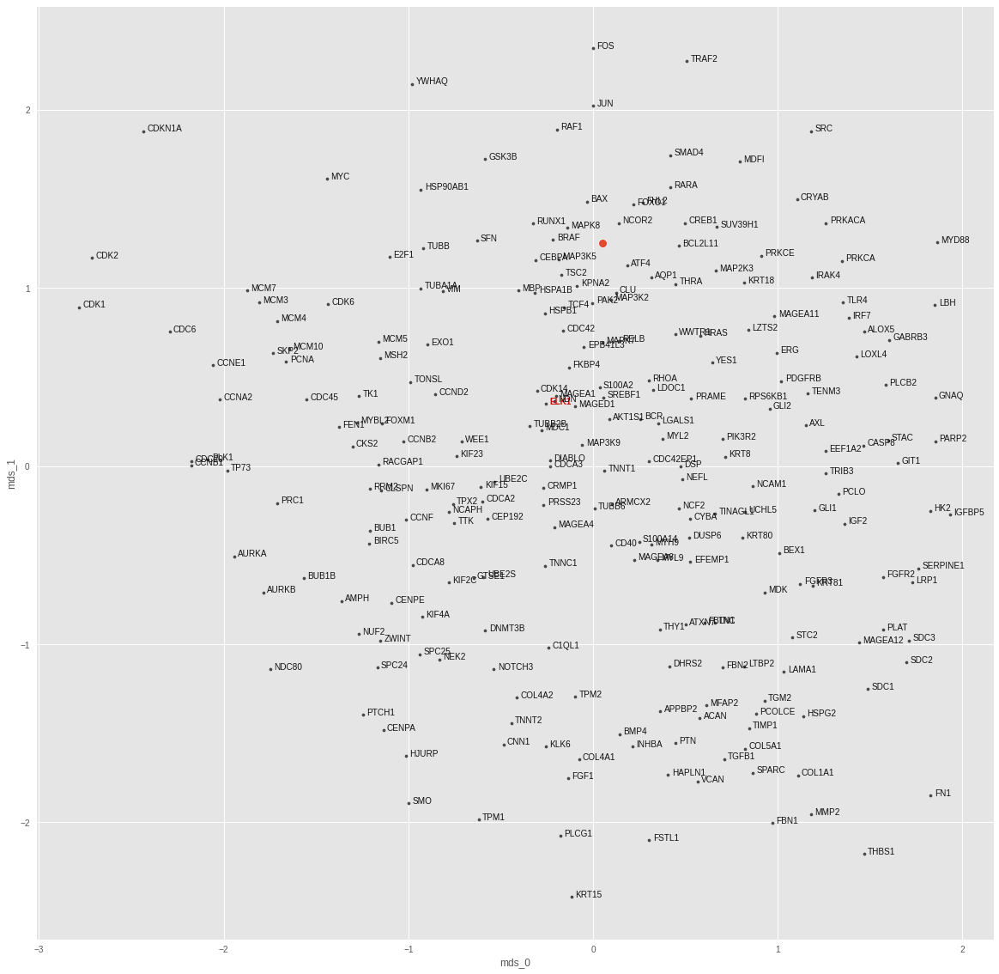

ERG
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.0075678251029642e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.005440615117549896
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


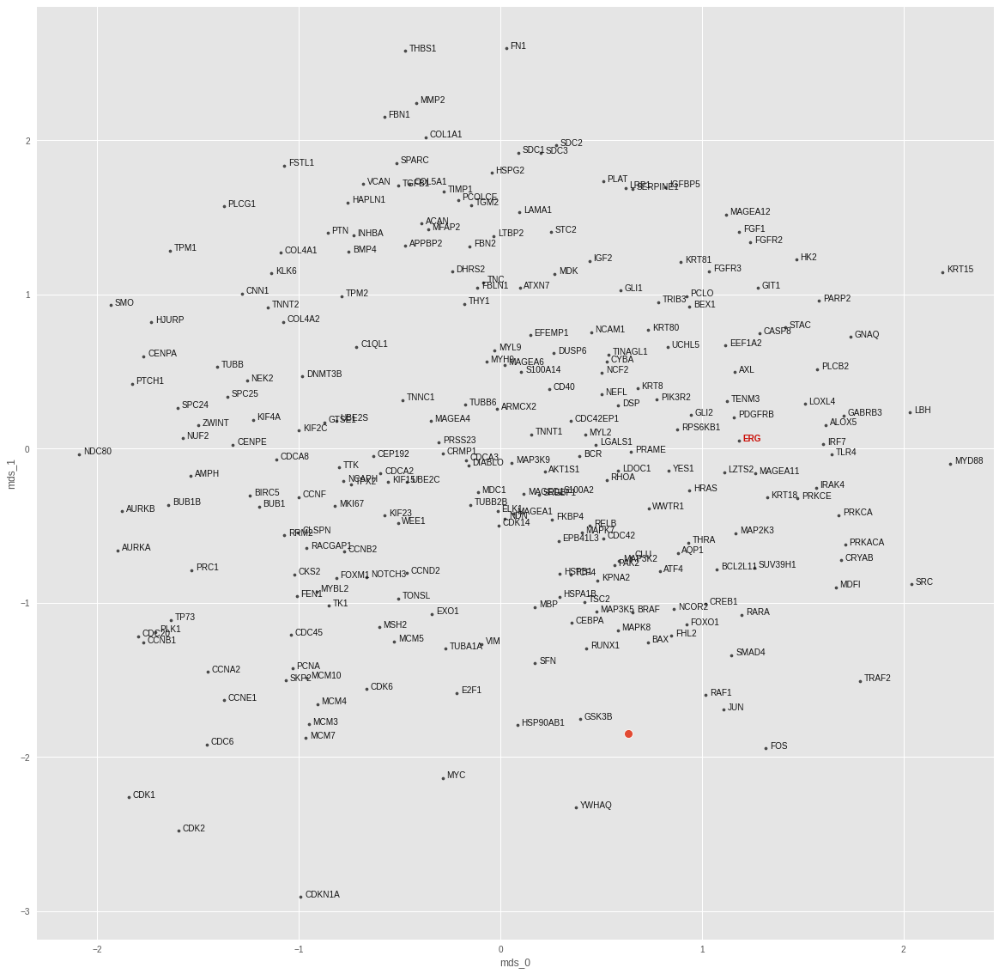

FGFR3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 8.9960259611201e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.003521532751619816
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


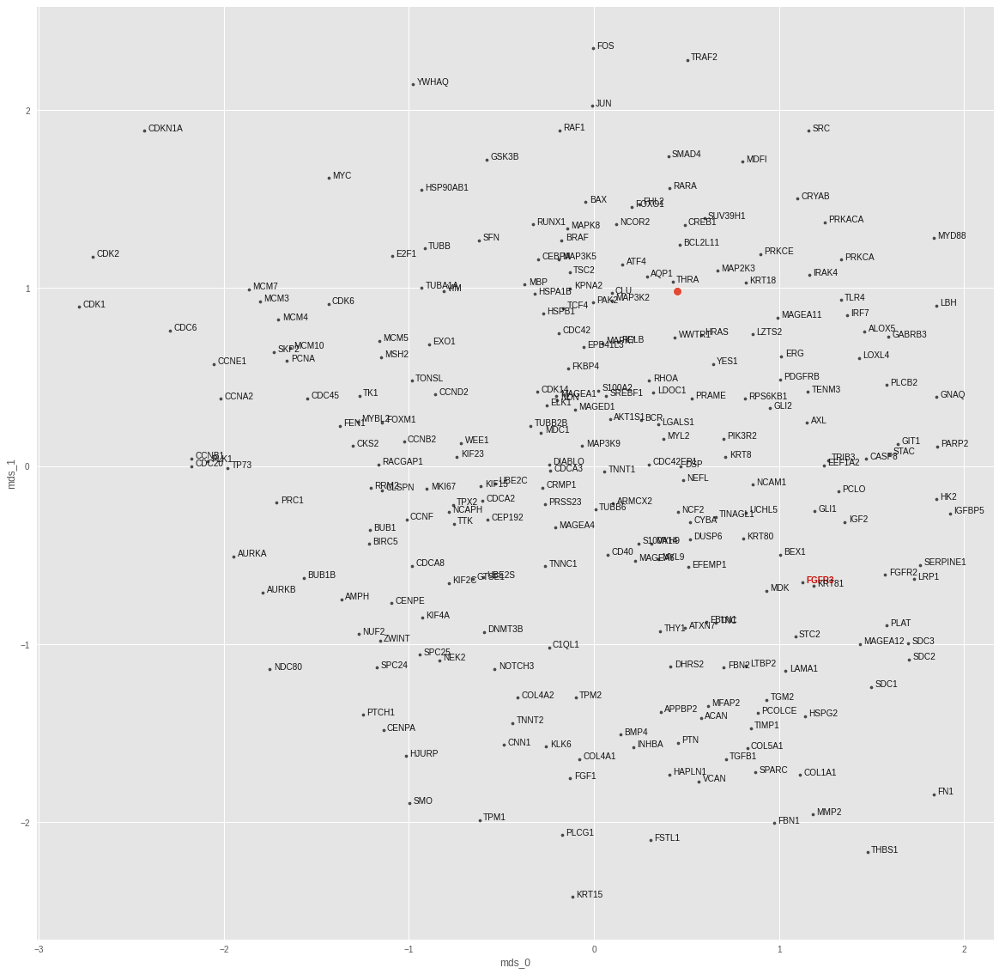

FOXO1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 9.806315598612663e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0018759053200483322
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


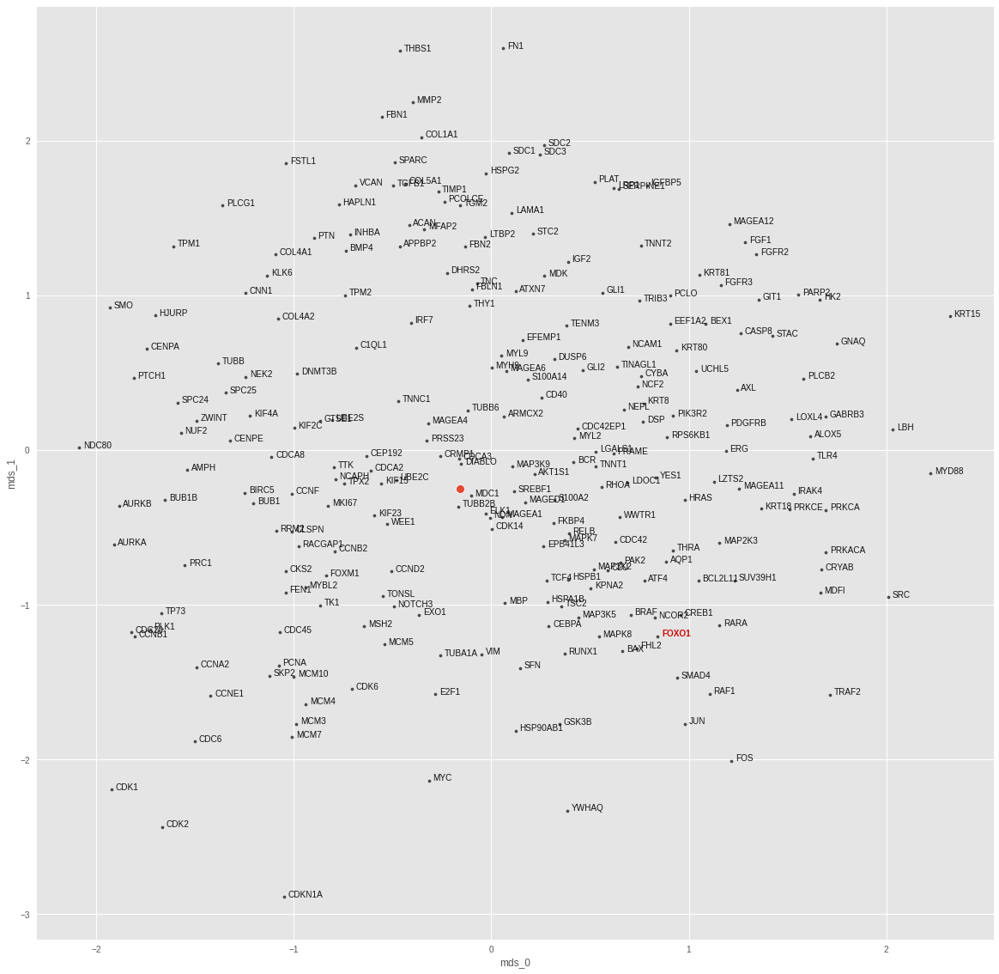

GLI1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.0096885872419654e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0033965716138482094
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


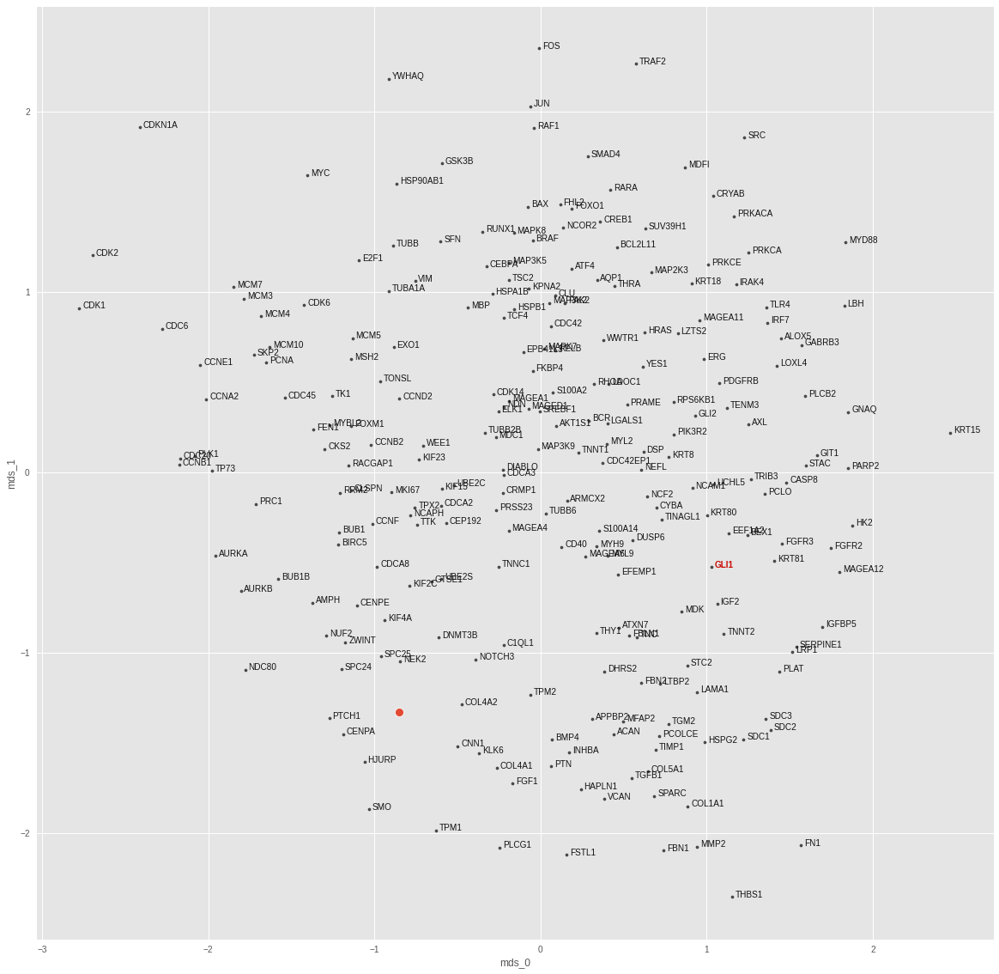

HRAS
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.1280595859524941e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.005791989620774984
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


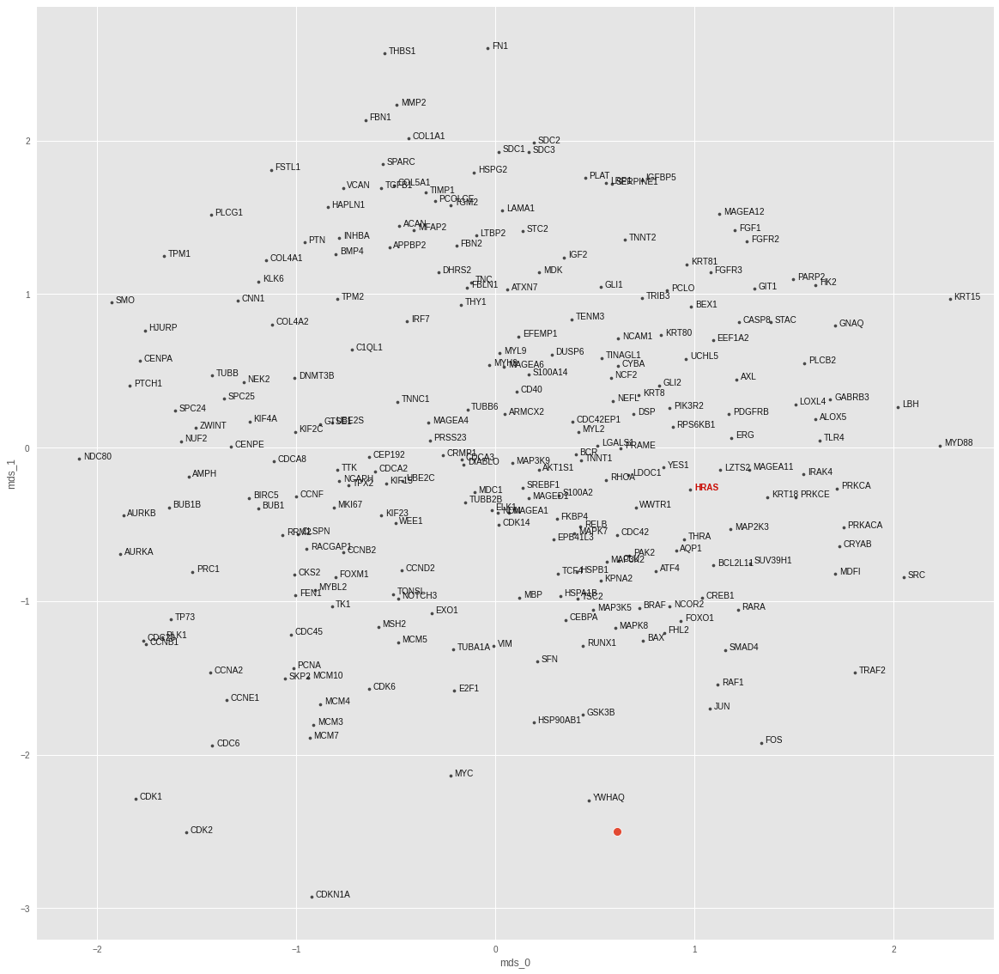

IRAK4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 8.650778167257636e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0026320600882172585
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


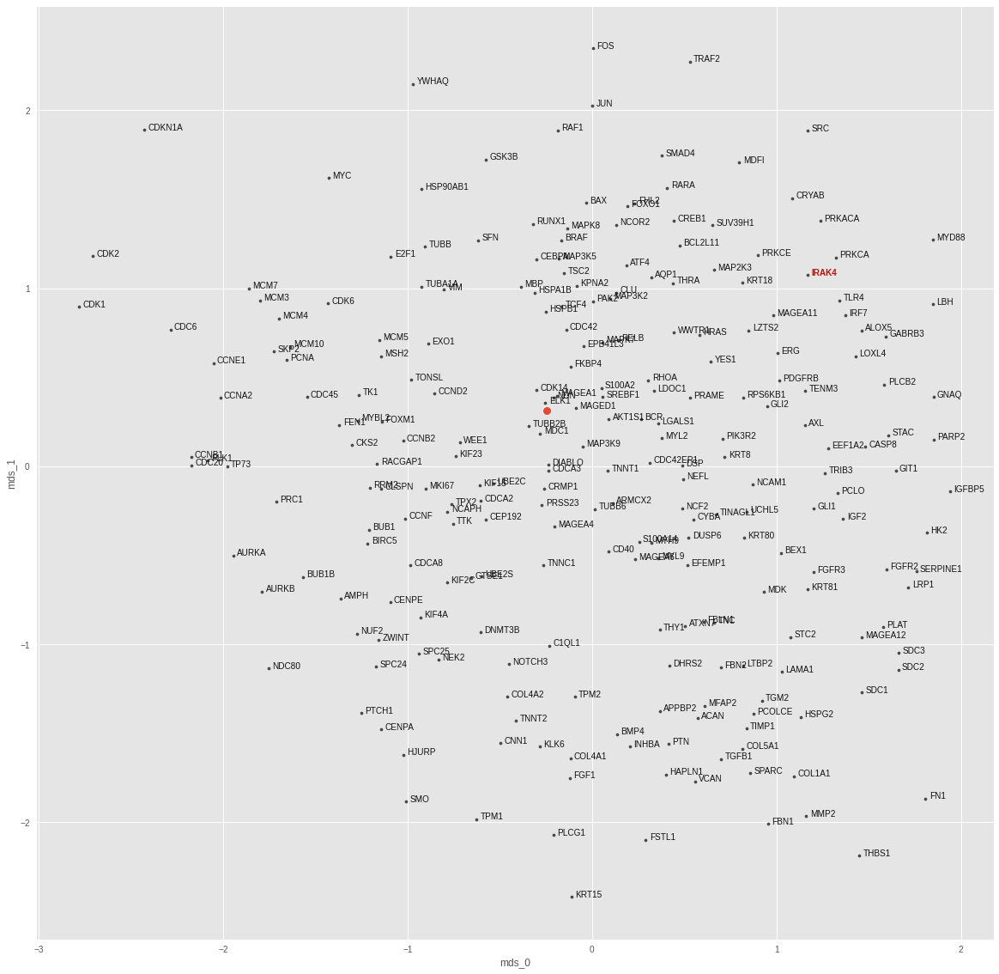

JUN
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.1690015729695198e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0034548582043498755
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


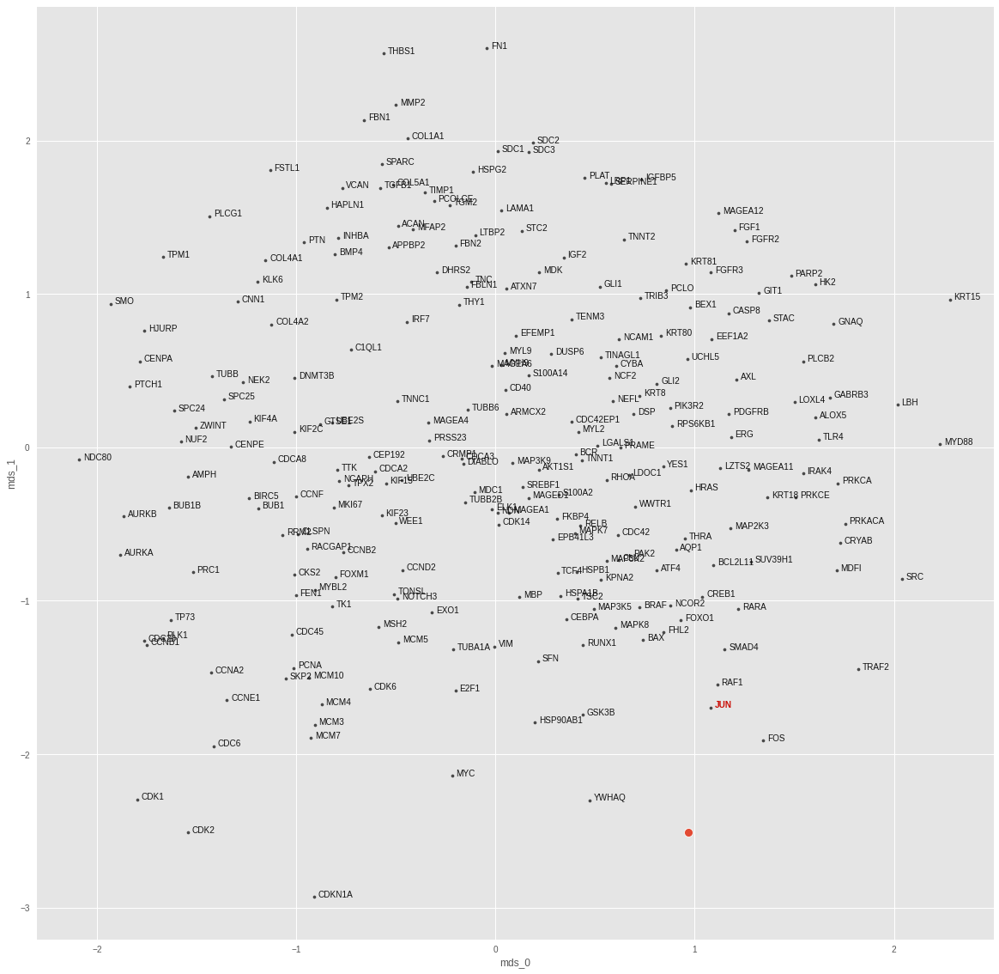

MAP2K3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.1670759333451554e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.006409432739019394
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


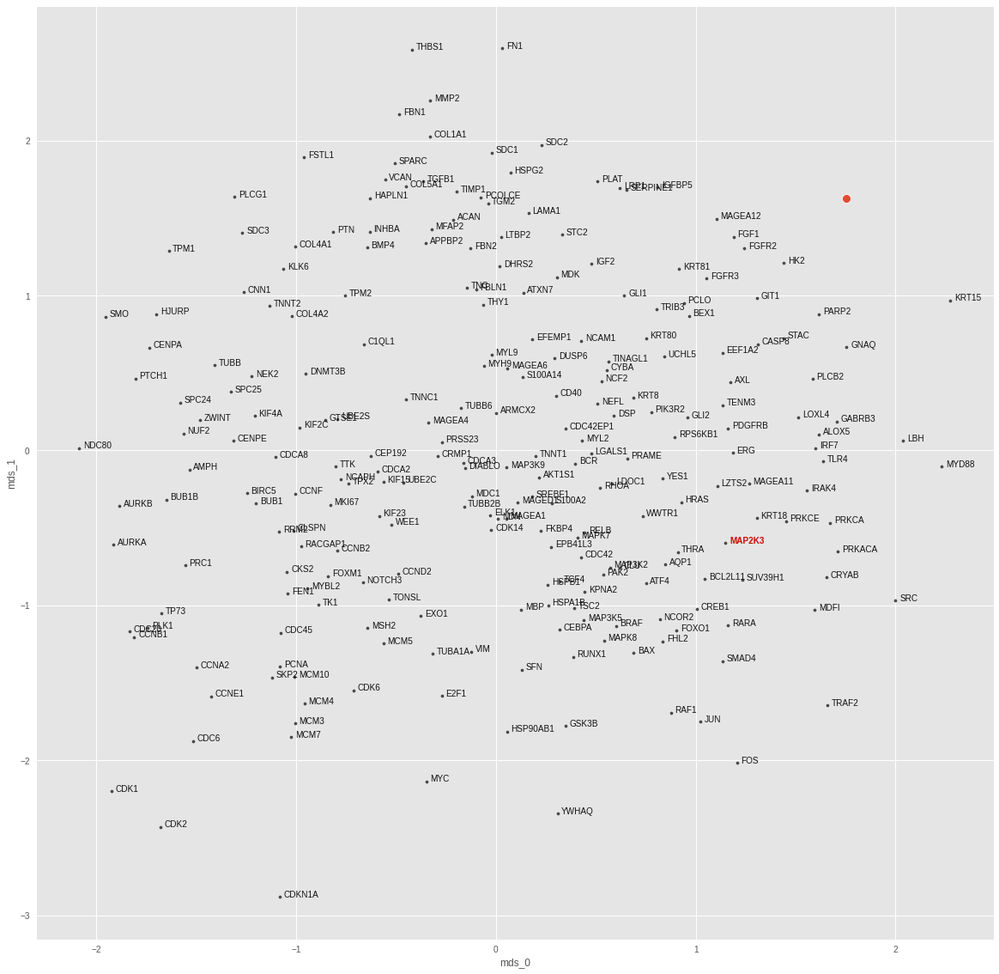

MAP3K2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.222560025613156e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0012874662643298507
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


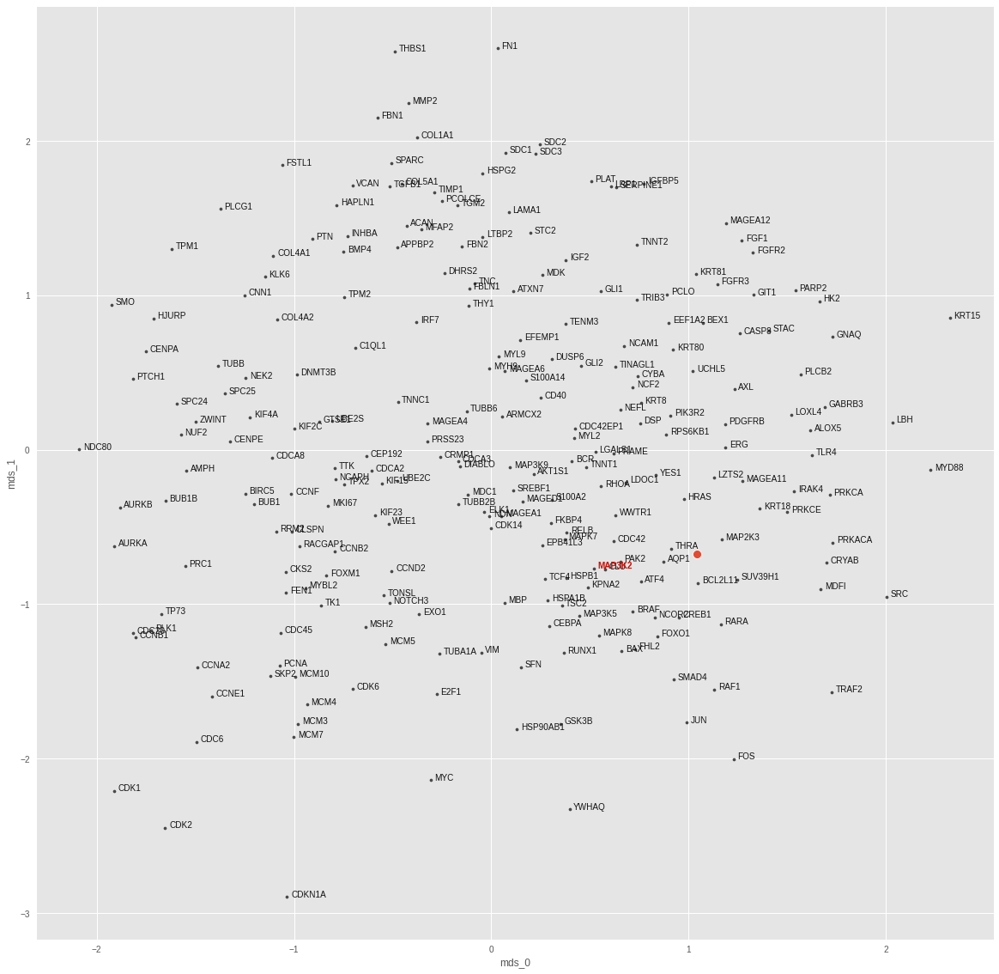

MAP3K5
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 9.436493512207801e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0017999215051531792
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


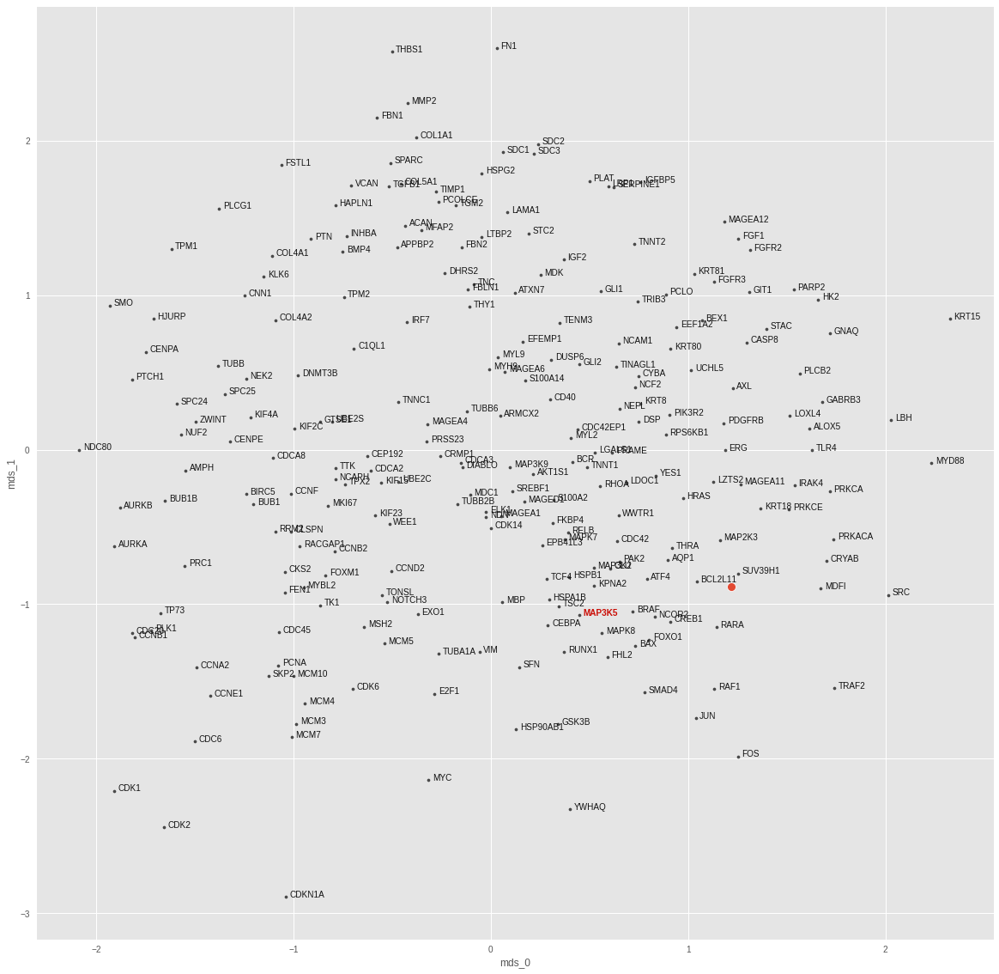

MAP3K9
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.2677811881937822e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0034527205862104893
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


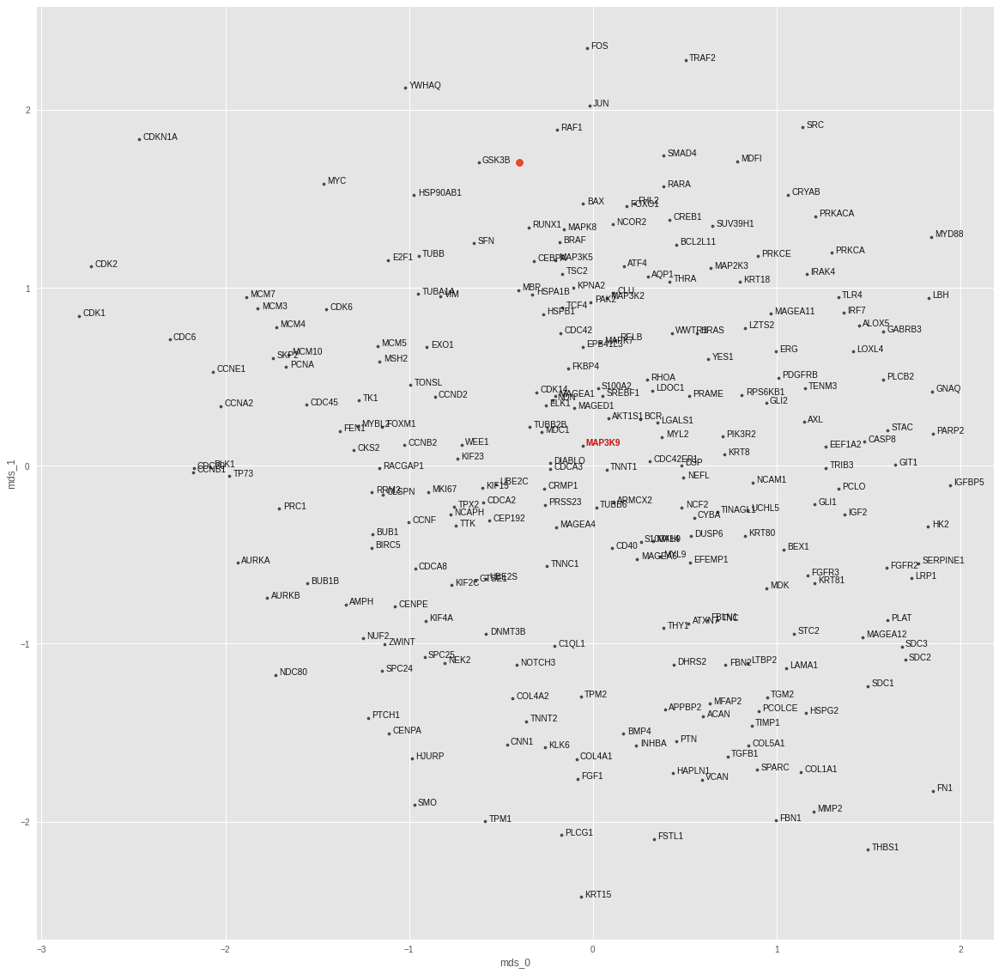

MAPK7
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 8.939815254387596e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.001218554680235684
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


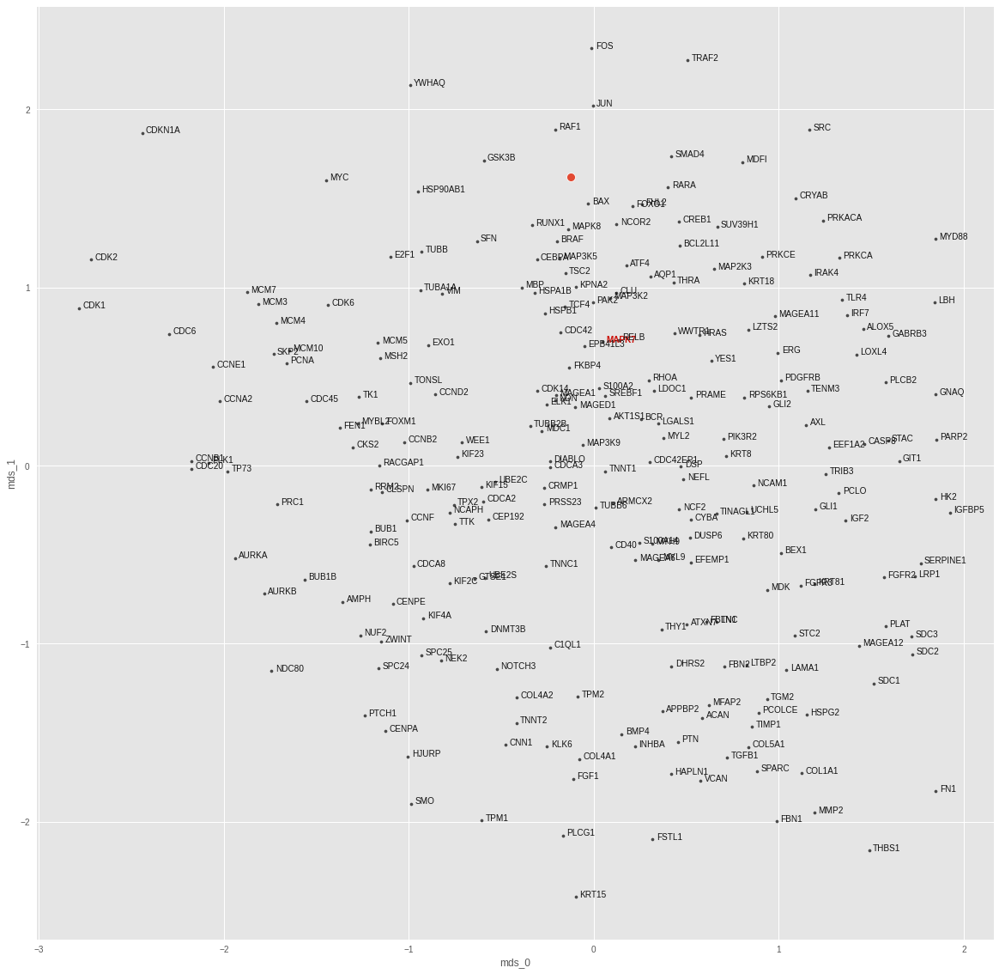

MYD88
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.0738649387732086e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.005063035991042852
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


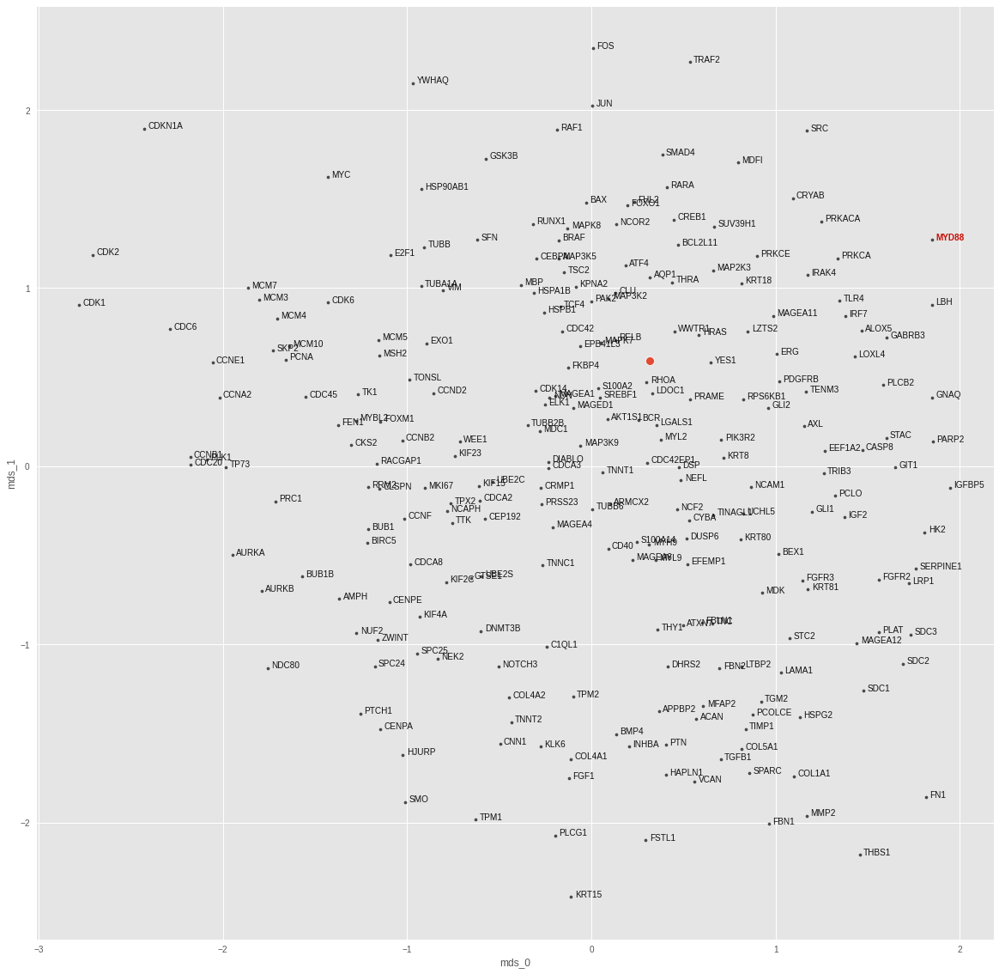

PIK3R2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 9.480185398340262e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.001473958371207118
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


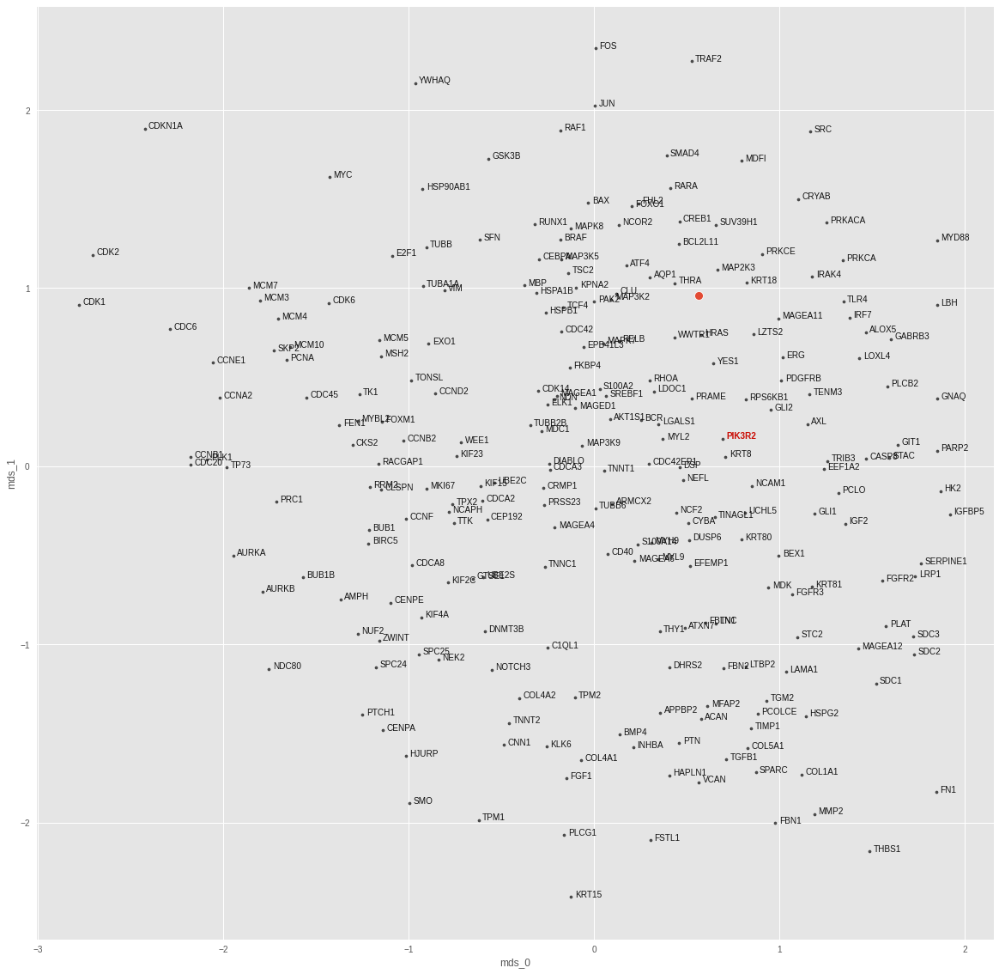

PRKACA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 9.381199764615494e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.005818203557282686
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


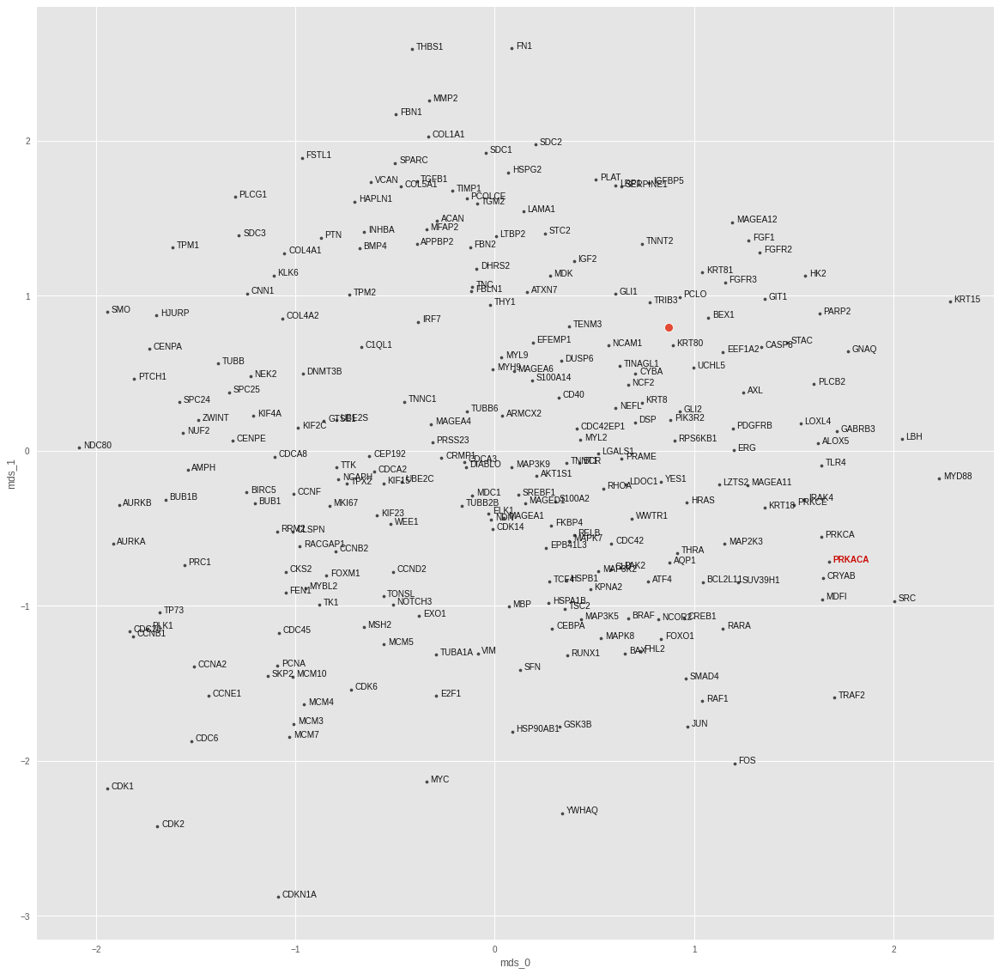

PRKCE
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 8.924978733136269e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.002132959896698594
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


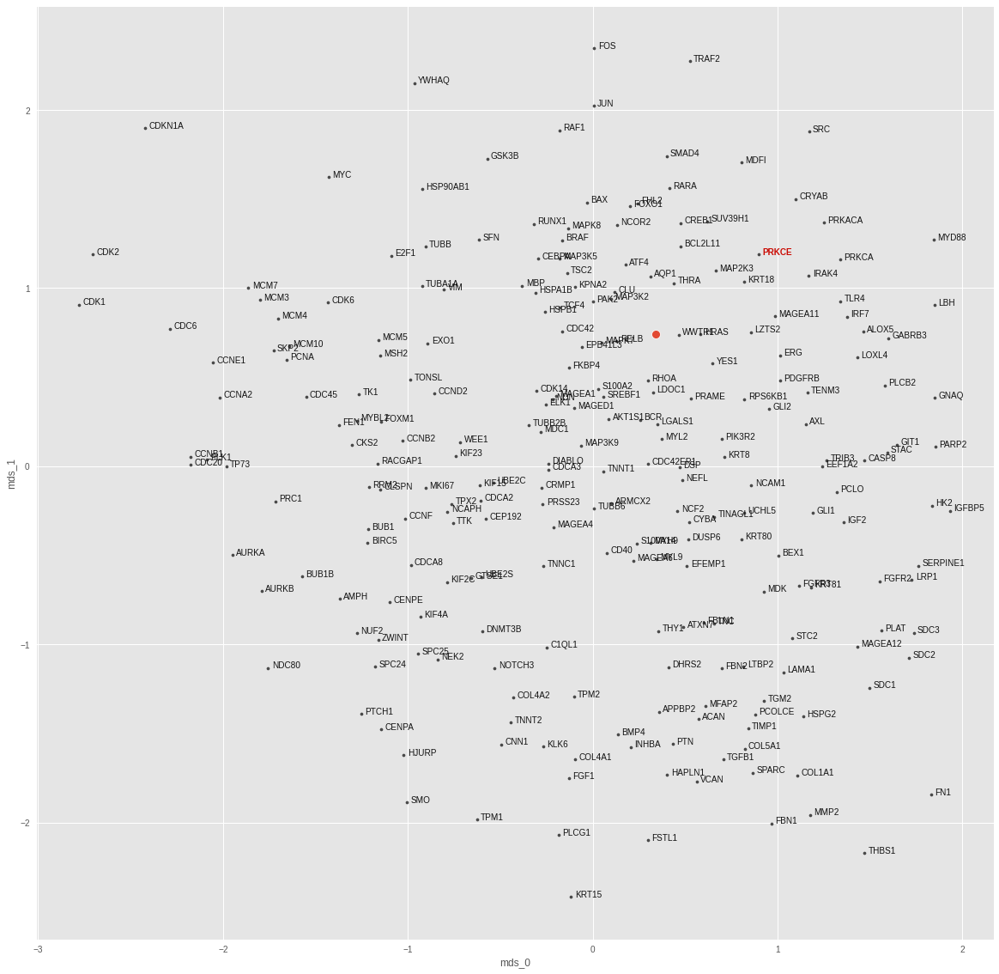

RAF1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 8.403005483016482e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0016002010088413954
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


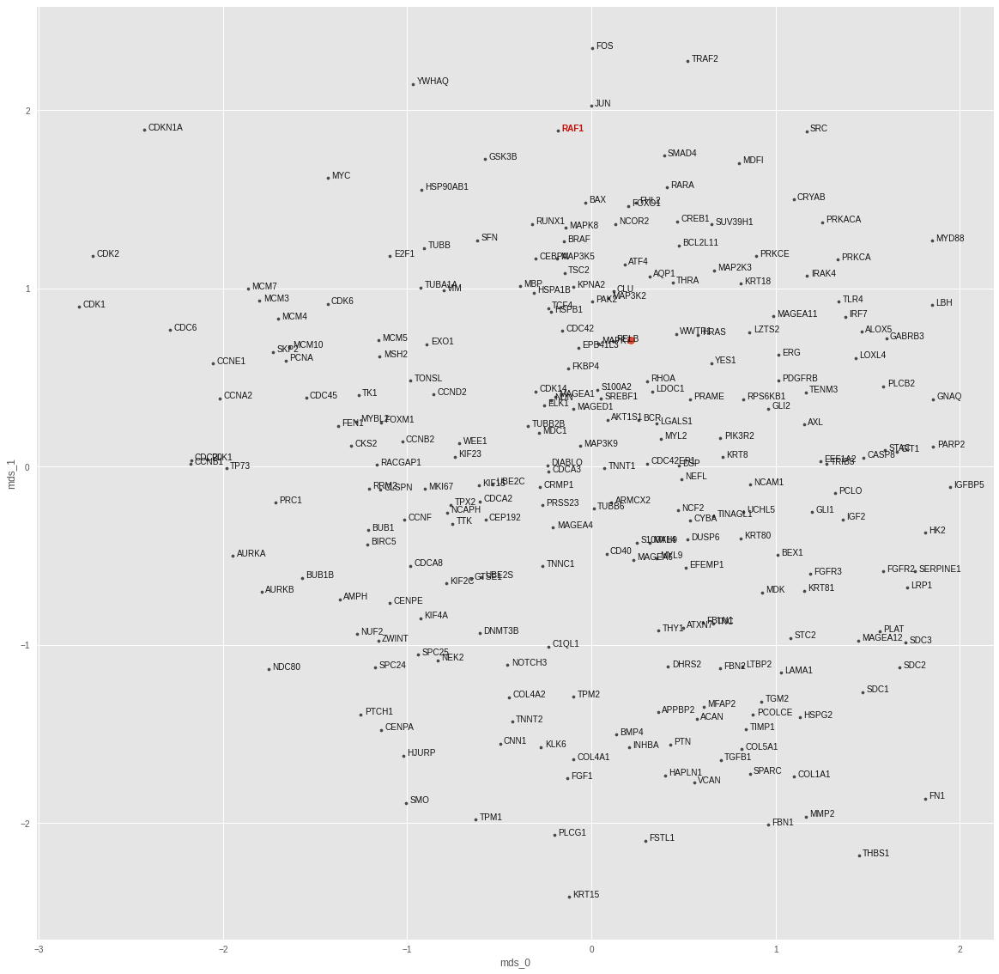

RELB
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 8.716183401702438e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.002038848353549838
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


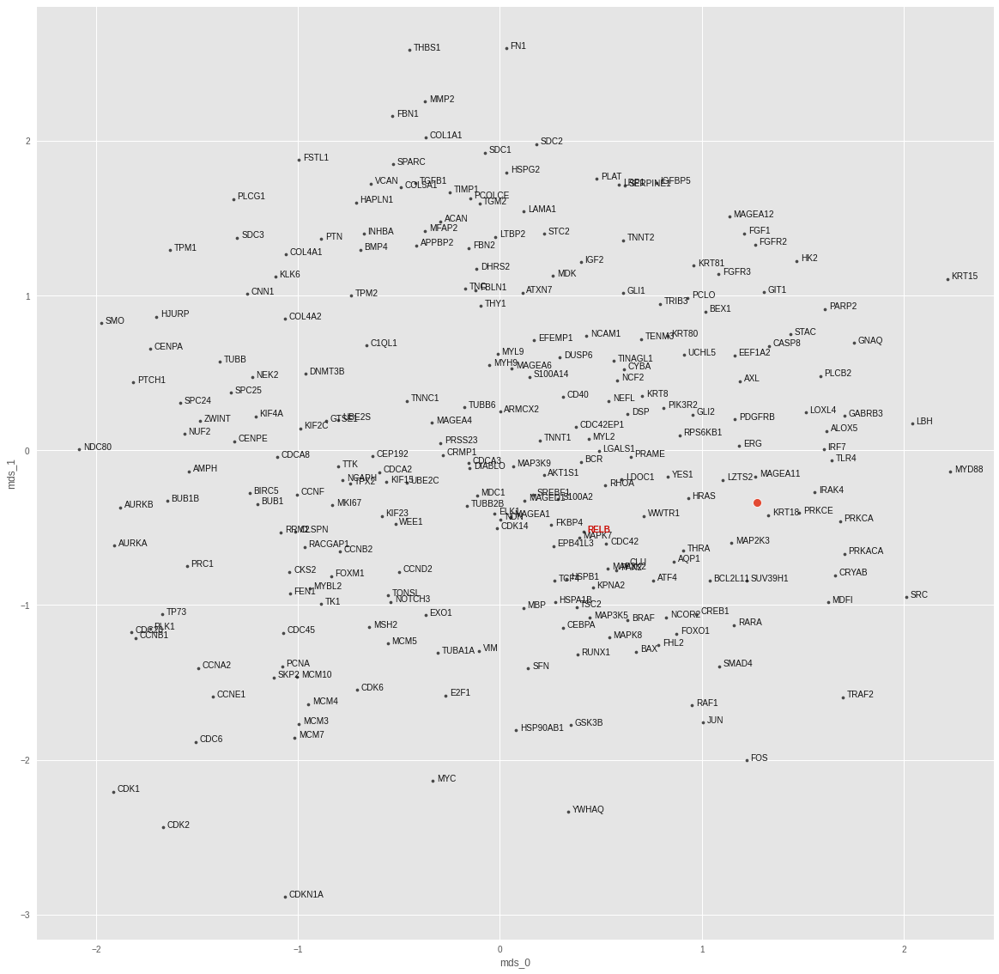

RHOA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 8.558403542816737e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0013952725566923618
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


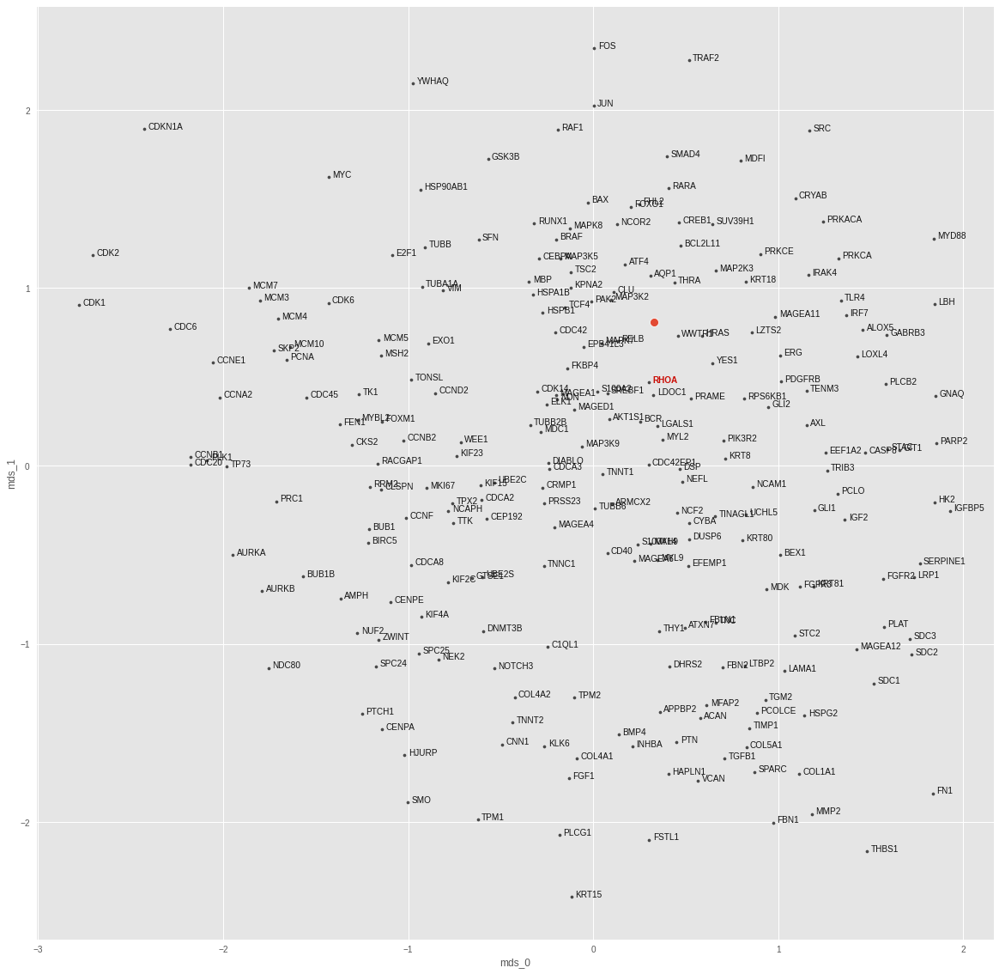

SMAD4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.019554283151305e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0025746298488229513
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


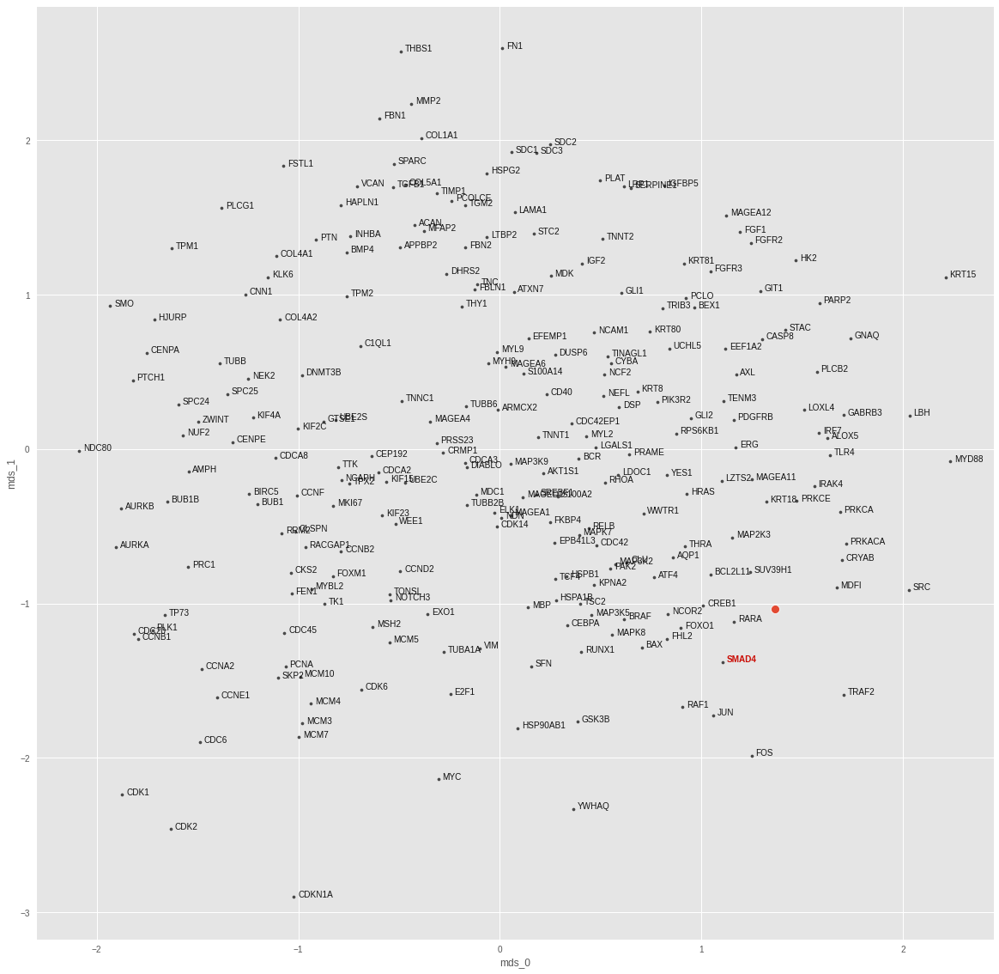

SMO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 9.101899506372559e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004579587839543819
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


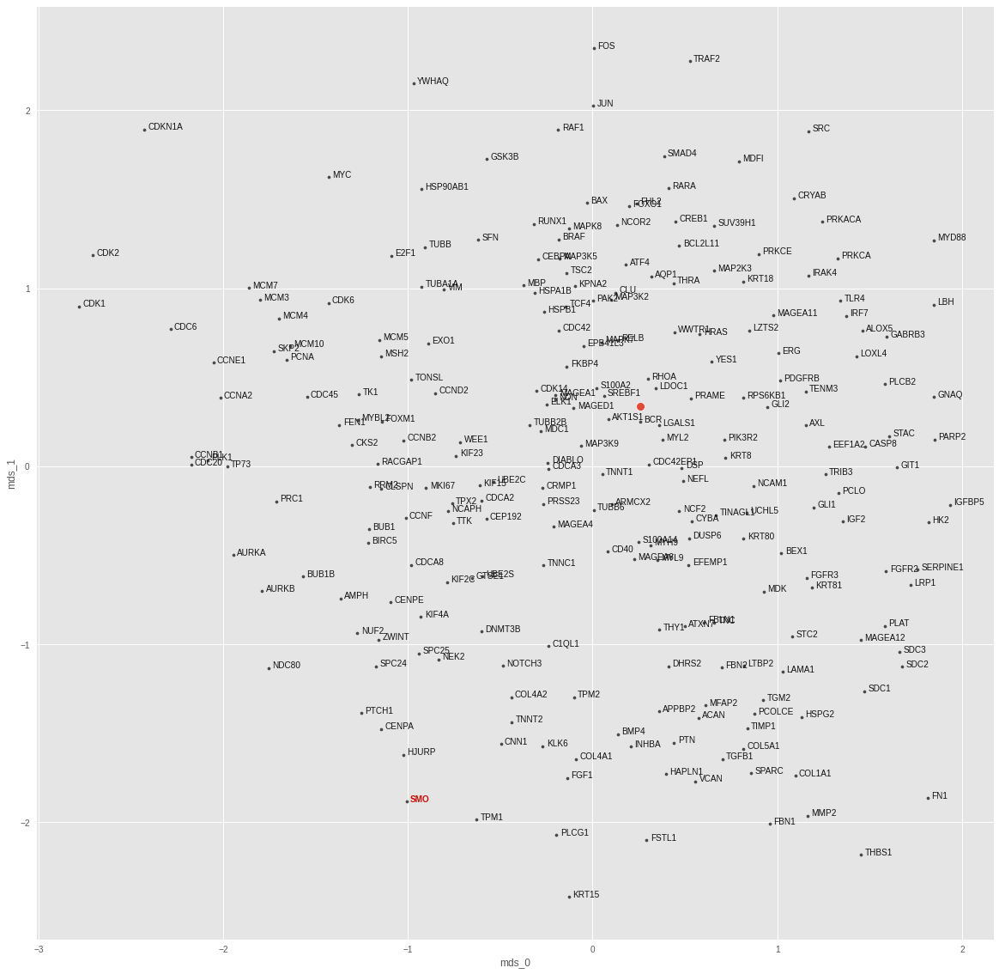

SRC
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 9.704512625543622e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004302496090531349
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


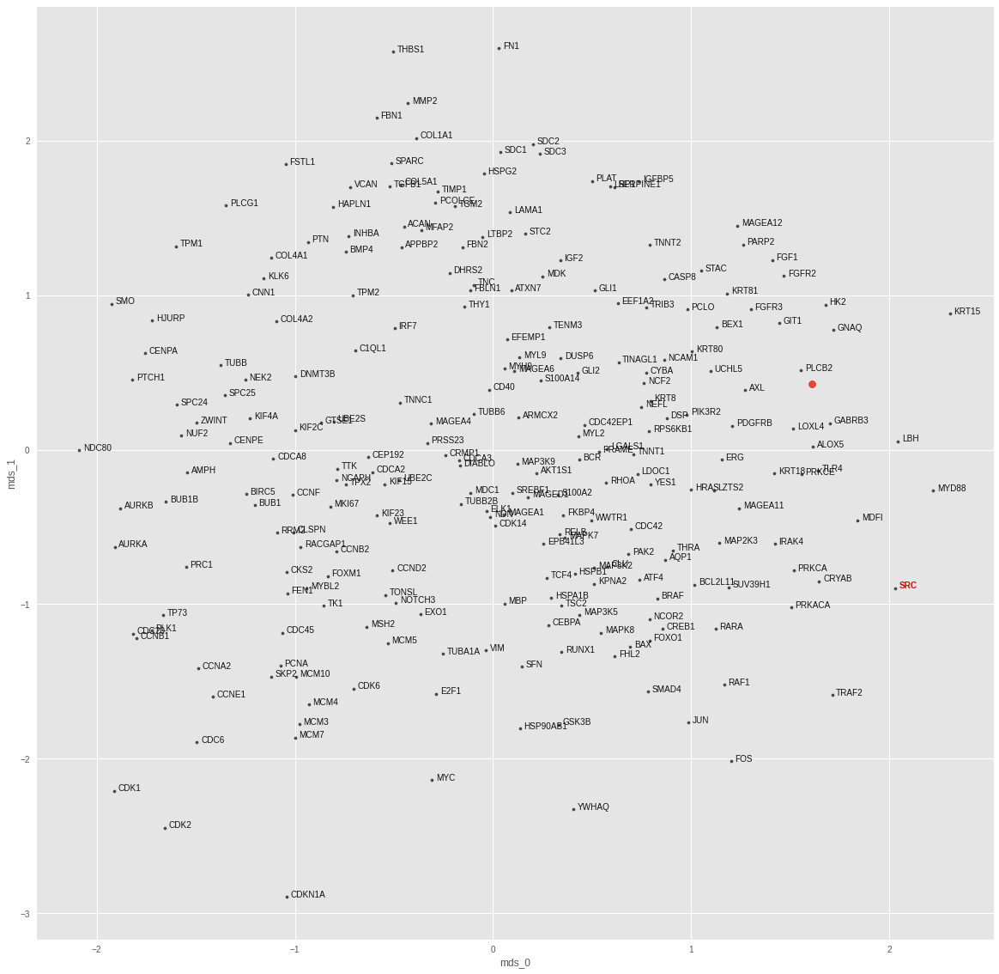

SREBF1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 8.565423525540513e-07
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0009026391198858619
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


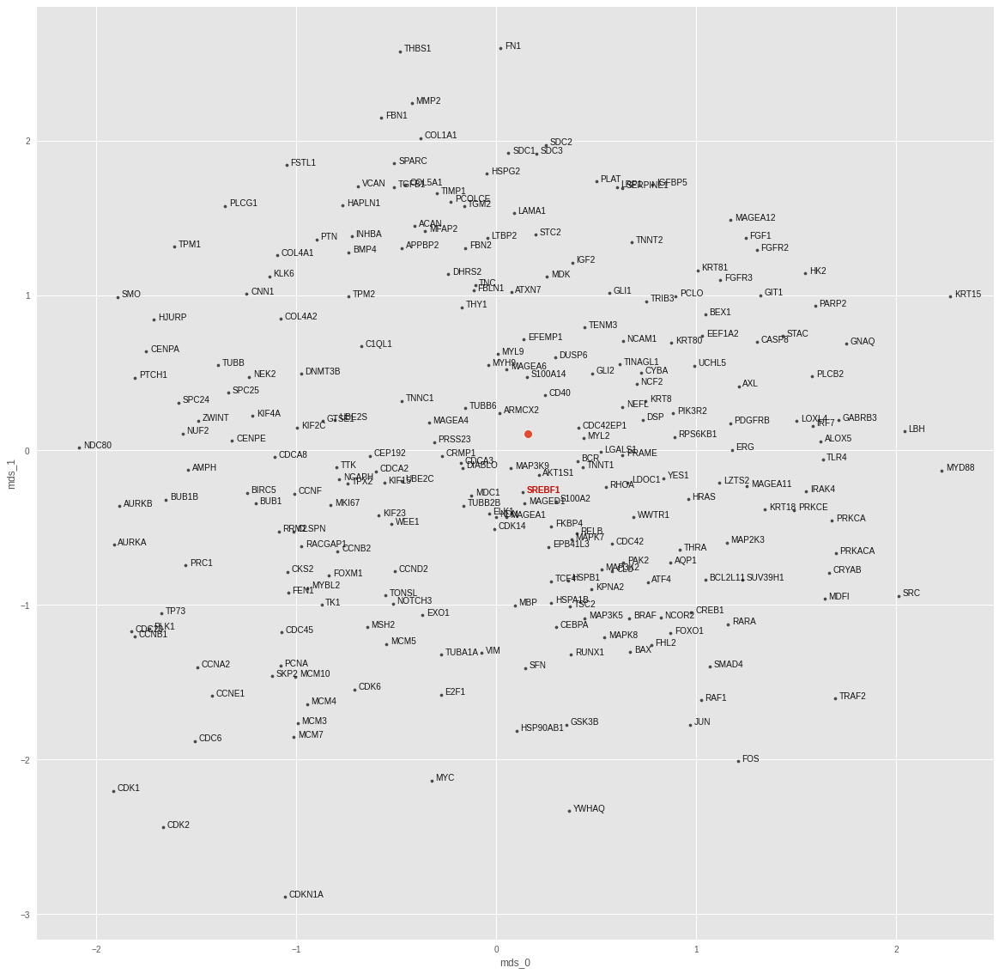

TRAF2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.067800900799691e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.005356466863304377
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


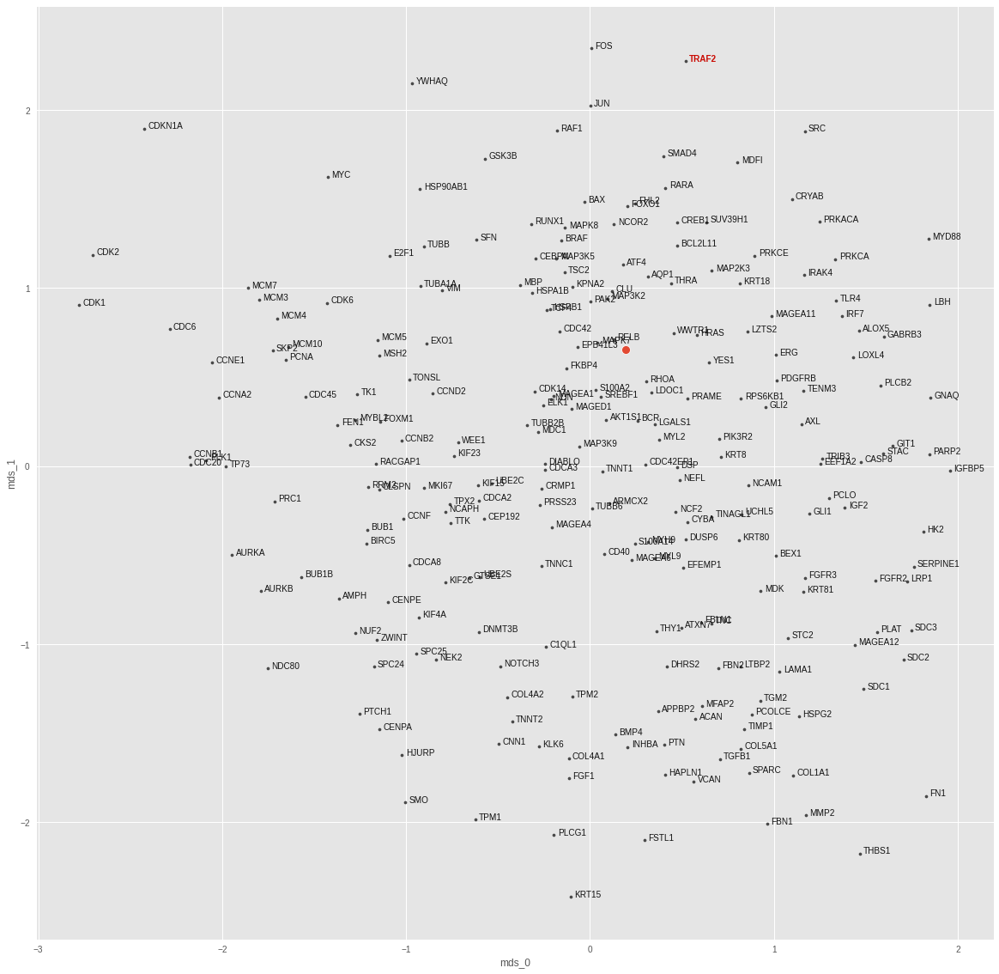

TSC2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.1962682435751049e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.003103014314547181
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


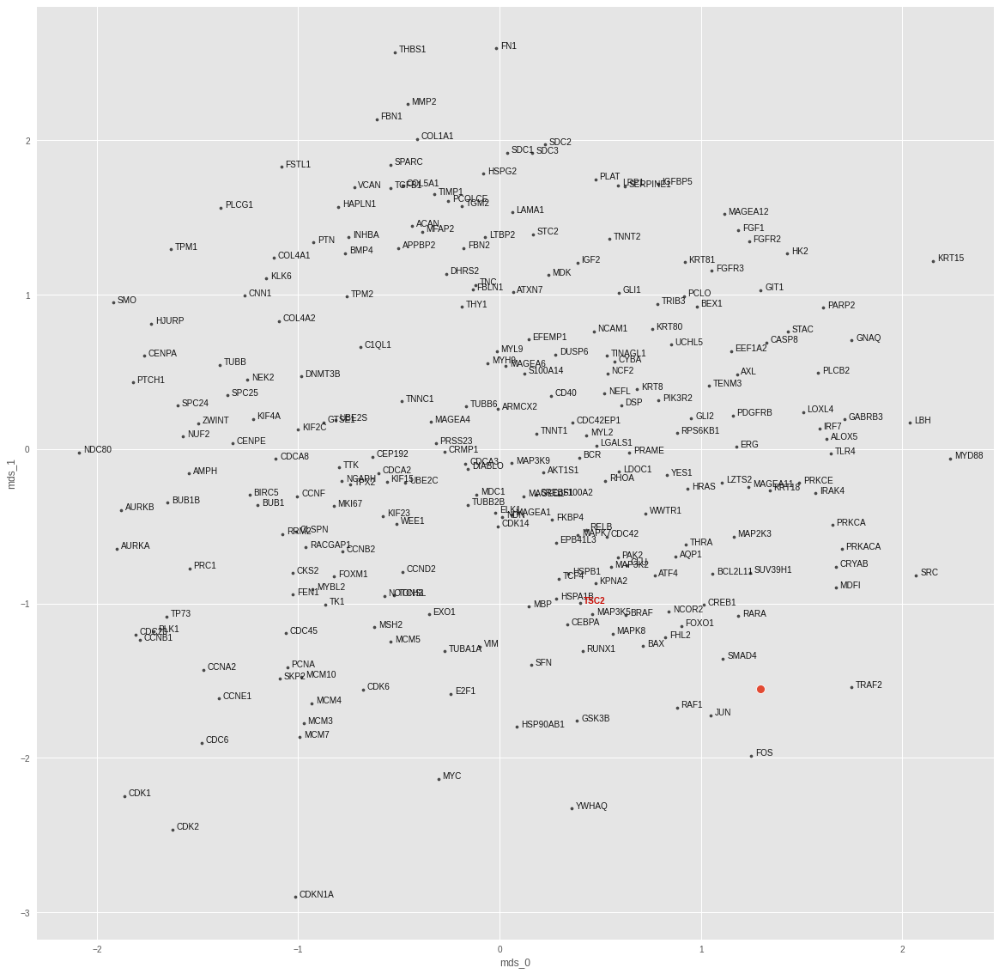

WWTR1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.0310381526323908e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.006245666183531284
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


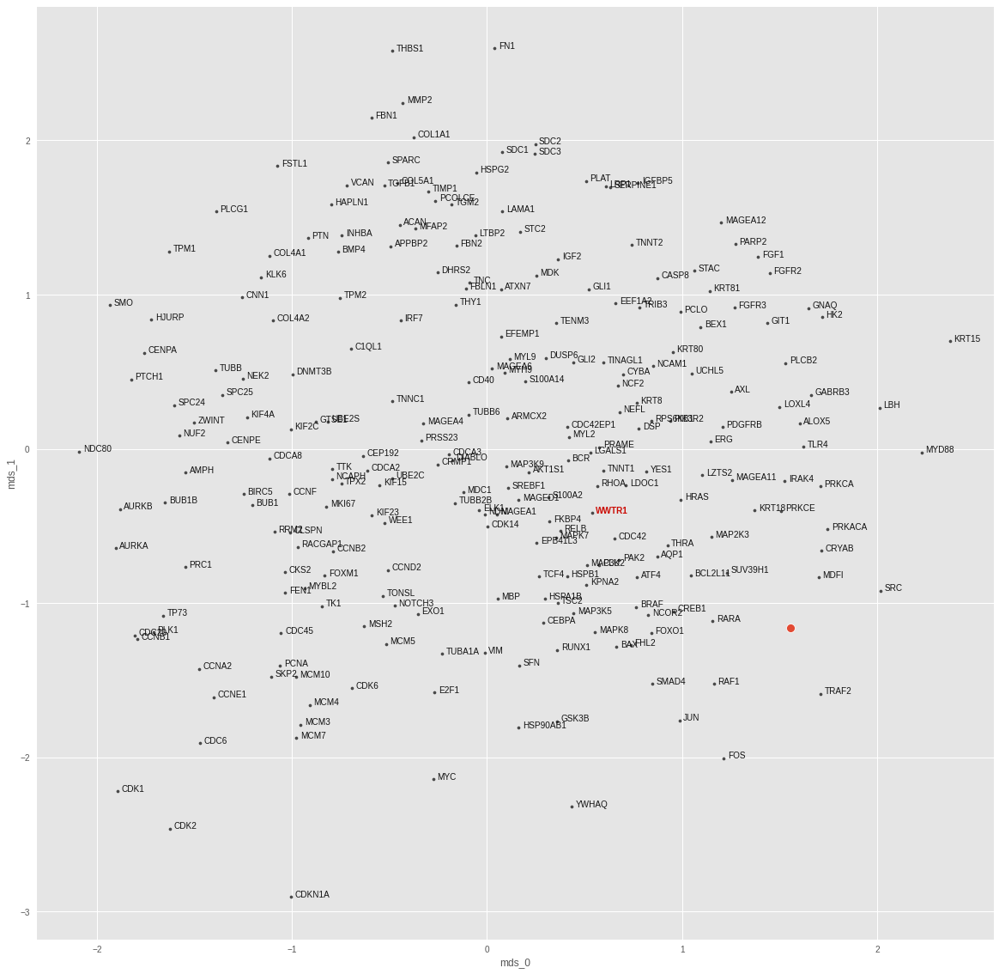

<IPython.core.display.Javascript object>

In [109]:
target_topk_accs = {}
mean_nonlin_nns = {}
for i in tqdm(range(len(data_dicts))):
    data_dict = data_dicts[i]
    model = torch.nn.Sequential(
        torch.nn.Linear(1024, 1024),
        torch.nn.PReLU(),
        torch.nn.Linear(1024, 1024),
    )
    optimizer = Adam(model.parameters(), lr=1e-4)
    criterion = torch.nn.MSELoss()
    target = sorted(list(shared_targets))[i]
    print(target)
    fitted_model, topk_acc, _, mean_knns = train_model_topk_acc(
        model=model,
        data_dict=data_dict,
        optimizer=optimizer,
        criterion=criterion,
        n_epochs=1000,
        early_stopping=1000,
        nn_clf=nn_clf,
        log_epochs=False,
    )
    target_topk_accs[target] = topk_acc
    mean_nonlin_nns[target] = mean_knns[0]
    fig, ax, _ = plot_translation(
        fitted_model.to("cpu"),
        data_dict["test"].dataset,
        node_embs,
        figsize=[20, 20],
        crop=False,
        highlight_target=target,
        pred_size=100,
        reg_size=10,
    )
    ax.get_legend().remove()
    plt.show()
    plt.close()

In [110]:
mean_nonlin_topk_df = pd.DataFrame(target_topk_accs).transpose()
mean_nonlin_topk_df.loc[mean_nonlin_topk_df.loc[:, 50] > 0].sort_values(
    [1, 3, 5, 10, 20, 50], ascending=False
)

,1,3,5,10,20,50
CDC42,1.0,1.0,1.0,1.0,1.0,1.0
BRAF,0.0,1.0,1.0,1.0,1.0,1.0
SREBF1,0.0,1.0,1.0,1.0,1.0,1.0
MAP3K2,0.0,0.0,0.0,1.0,1.0,1.0
AKT1S1,0.0,0.0,0.0,0.0,1.0,1.0
CREB1,0.0,0.0,0.0,0.0,1.0,1.0
JUN,0.0,0.0,0.0,0.0,1.0,1.0
MAPK7,0.0,0.0,0.0,0.0,1.0,1.0
BCL2L11,0.0,0.0,0.0,0.0,0.0,1.0
ELK1,0.0,0.0,0.0,0.0,0.0,1.0


<IPython.core.display.Javascript object>

In [111]:
mean_nonlin_topk_df.describe()

,1,3,5,10,20,50
count,39.000000,39.000000,39.000000,39.000000,39.000000,39.000000
mean,0.025641,0.076923,0.076923,0.102564,0.205128,0.461538
std,0.160128,0.269953,0.269953,0.307355,0.409074,0.505035
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


<IPython.core.display.Javascript object>

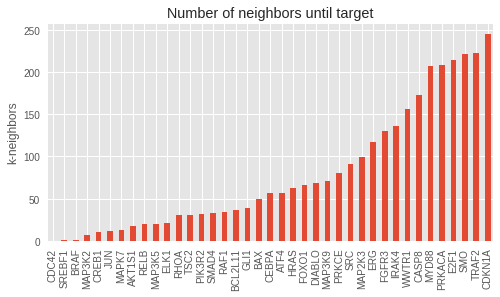

<IPython.core.display.Javascript object>

In [143]:
mpl.style.use("ggplot")
mean_nonlin_khits = get_knn_hit_data(mean_nonlin_nns)
ax = mean_nonlin_khits.knn_hit.sort_values().plot(kind="bar", figsize=[8, 4])
ax.set_ylabel("k-neighbors")
ax.set_title("Number of neighbors until target")
plt.show()

In [149]:
mean_nonlin_nns["SREBF1"]

array(['PRAME', 'SREBF1', 'NDN', 'TENM3', 'RPS6KB1', 'PRSS23', 'AKT1S1',
       'IRF7', 'MAGEA1', 'ELK1', 'TLR4', 'CDCA2', 'FOXO1', 'TUBB2B',
       'MAPK7', 'GLI2', 'RHOA', 'TSC2', 'IRAK4', 'MBP', 'BCR', 'MYL2',
       'PDGFRB', 'GLI1', 'CDK14', 'THRA', 'TNNC1', 'WWTR1', 'MAP3K2',
       'UBE2C', 'RELB', 'NCAPH', 'SMAD4', 'CEP192', 'KIF23', 'MDC1',
       'YES1', 'LGALS1', 'MDK', 'CEBPA', 'DUSP6', 'MAGEA6', 'FHL2',
       'MAP3K9', 'HRAS', 'TPX2', 'NCOR2', 'MAGEA4', 'RARA', 'EPB41L3',
       'KIF15', 'IGF2', 'MAP2K3', 'CREB1', 'DIABLO', 'S100A14', 'CCNF',
       'DHRS2', 'CDCA3', 'CRMP1', 'ARMCX2', 'CCND2', 'AXL', 'MAGEA11',
       'FBLN1', 'GTSE1', 'WEE1', 'UBE2S', 'KIF2C', 'MAP3K5', 'MAGED1',
       'S100A2', 'HSPA1B', 'CCNB2', 'MKI67', 'CDC42EP1', 'PAK2', 'PIK3R2',
       'KRT8', 'ERG', 'CLU', 'TCF4', 'BCL2L11', 'EFEMP1', 'PLCB2', 'MYL9',
       'RRM2', 'MYD88', 'EEF1A2', 'FOXM1', 'PCLO', 'MAPK8', 'ACAN', 'TNC',
       'THY1', 'CD40', 'TUBB6', 'EXO1', 'MYH9', 'TTK', 'ALOX5', 'FKBP4

<IPython.core.display.Javascript object>

---

### 2.4. Structural NN centroid translation

Next, we will move away from representing the structural phenotype induced by a single gene overexpression by the population mean of the cellular embeddings. Instead we have identified four different structural phenotype clusters per condition using 4-means clustering. Using those we aim to establish the translation between the structural and regulatory space.

To this end, we will first identify the one nearest neighbor of each cluster centroid for each target that does not correspond to the same gene overexpression condition. Next, we compute the mean embedding in the regulatory space of the corresponding one-nearest neighbors for each of the four cluster centroids. Finally, we assess the local neighborhood of this latent space location in a similar setting as before.

In [112]:
cl_img_embs_fold0, cl_node_embs_fold0, labels = cl_img_node_embs_dict["fold0"]

<IPython.core.display.Javascript object>

In [113]:
struct_nn_centroid_pred_dict = get_struct_nn_centroid_translation_dict(
    cl_img_embs_fold0, node_embs
)
struct_nn_centroid_topk = get_topk_acc_from_nn_dict(struct_nn_centroid_pred_dict)
struct_nn_centroid_topk.describe()

,top-1,top-3,top-5,top-10,top-20,top-50
count,39.000000,39.000000,39.000000,39.000000,39.000000,39.000000
mean,0.025641,0.025641,0.076923,0.102564,0.256410,0.487179
std,0.160128,0.160128,0.269953,0.307355,0.442359,0.506370
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.500000,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


<IPython.core.display.Javascript object>

---

### 3.5. Linear 3-centroids mapping

In [114]:
cl_img_embs_fold0, cl_node_embs_fold0, labels = cl_img_node_embs_dict["fold0"]
cl_data_dicts = get_logo_data_dicts(
    data=cl_img_embs_fold0,
    labels=cl_node_embs_fold0,
    val_size=0,
    group_labels=np.array(labels),
    batch_size=32 * 4,
    balanced=False,
    scale_x=False,
    scale_y=False,
)

<IPython.core.display.Javascript object>

  0%|          | 0/39 [00:00<?, ?it/s]

AKT1S1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017441636009607464
train top-k accuracies: {1: 0.877193, 3: 0.947368, 5: 0.95614, 10: 0.982456, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.001069362973794341
test top-k accuracies: {1: 0.0, 3: 0.333333, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


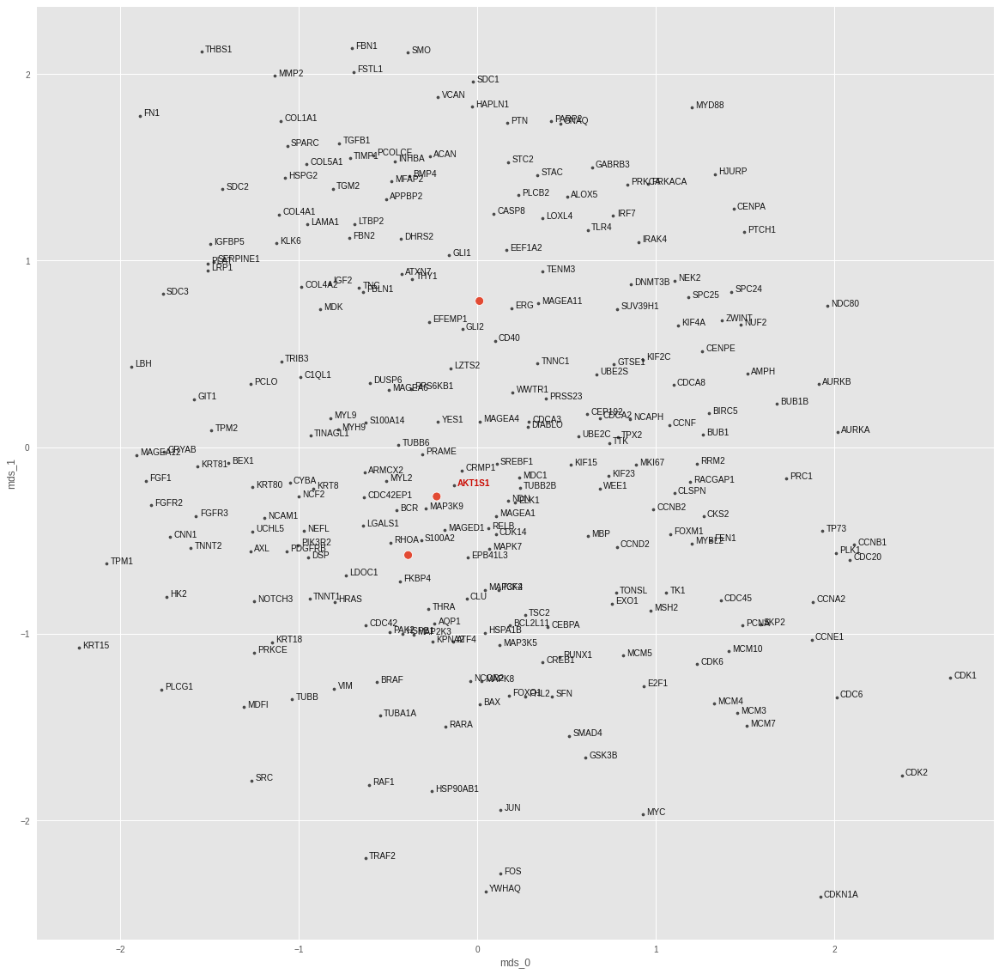

ATF4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017465157725382596
train top-k accuracies: {1: 0.877193, 3: 0.929825, 5: 0.964912, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.001779985032044351
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.333333, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


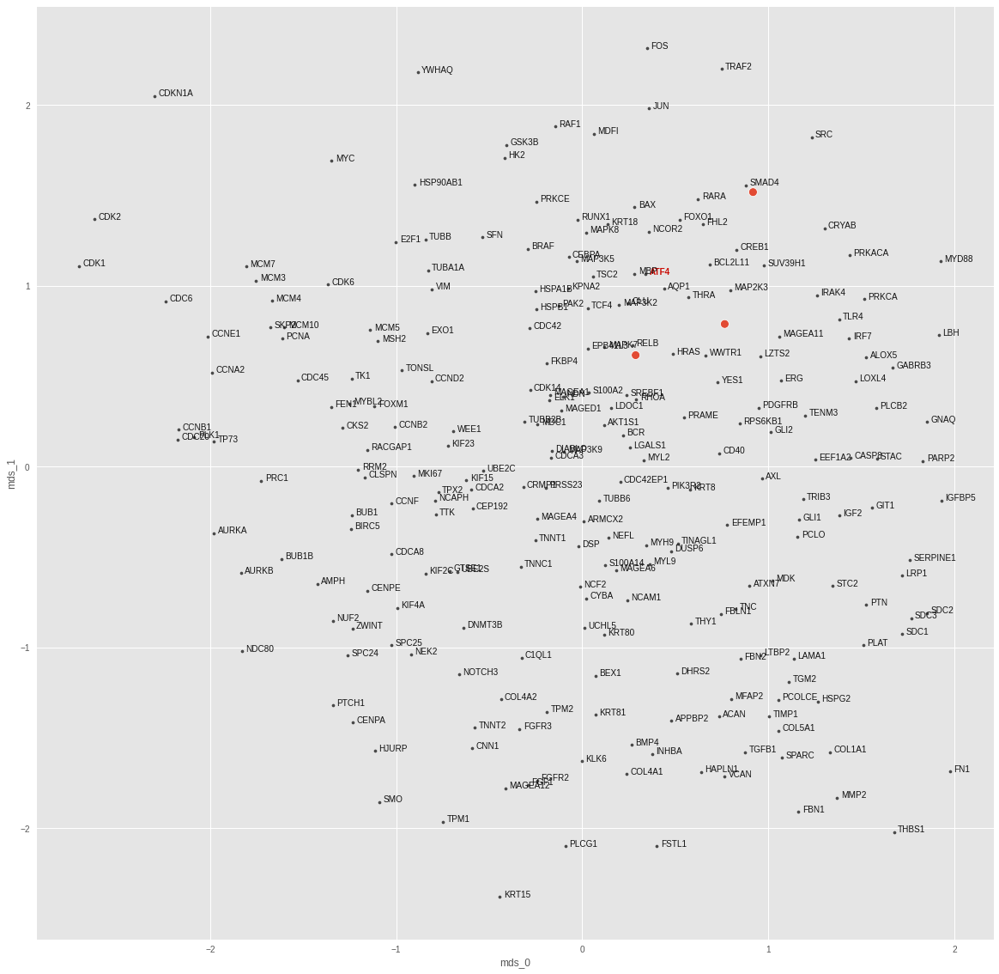

BAX
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0001718778075883165
train top-k accuracies: {1: 0.885965, 3: 0.929825, 5: 0.964912, 10: 0.982456, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0032798778265714645
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


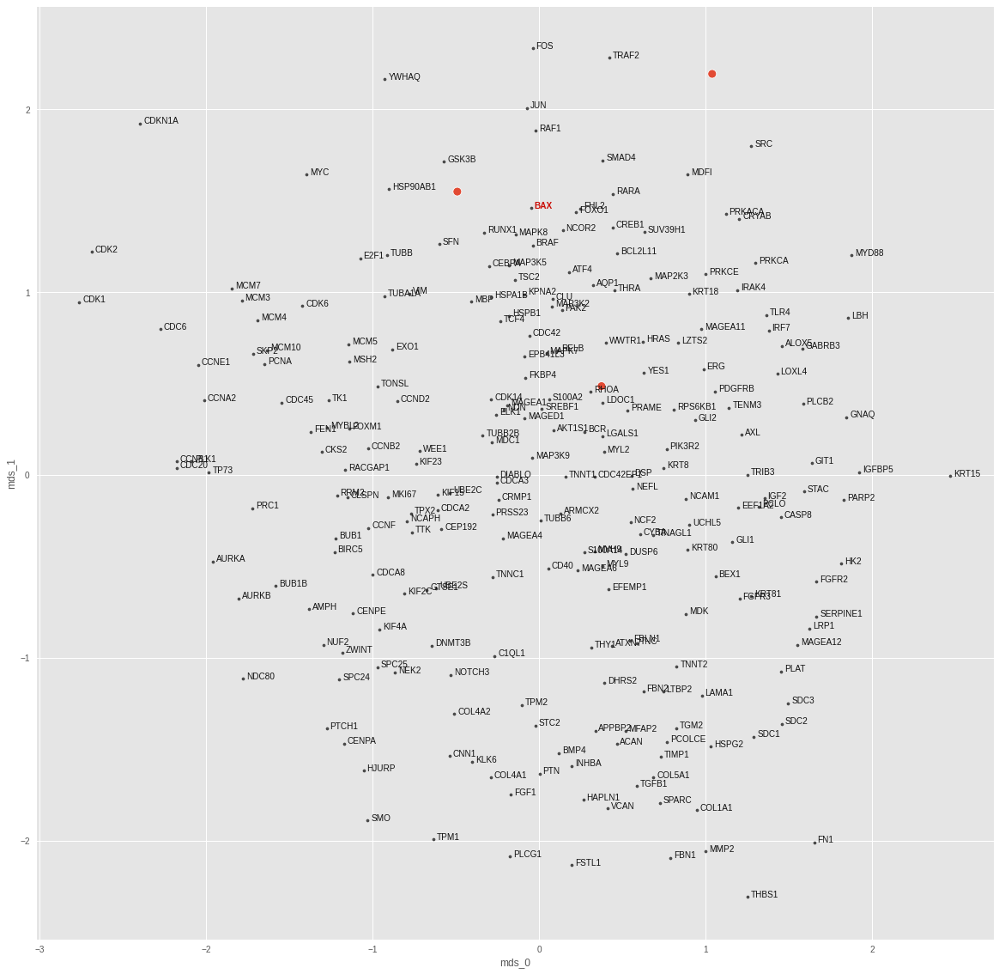

BCL2L11
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017397008195985109
train top-k accuracies: {1: 0.877193, 3: 0.929825, 5: 0.95614, 10: 0.982456, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.005981552414596081
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


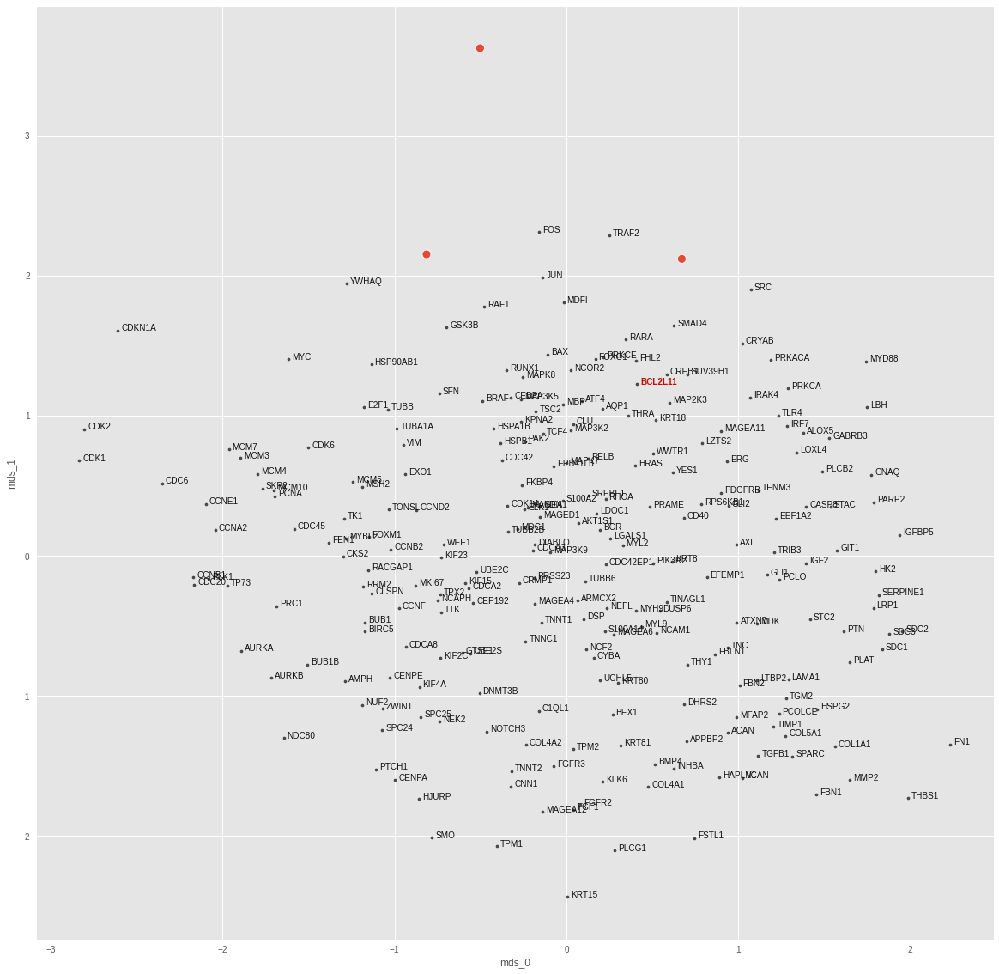

BRAF
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017278561426792294
train top-k accuracies: {1: 0.885965, 3: 0.947368, 5: 0.964912, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0011290705297142267
test top-k accuracies: {1: 0.0, 3: 0.333333, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


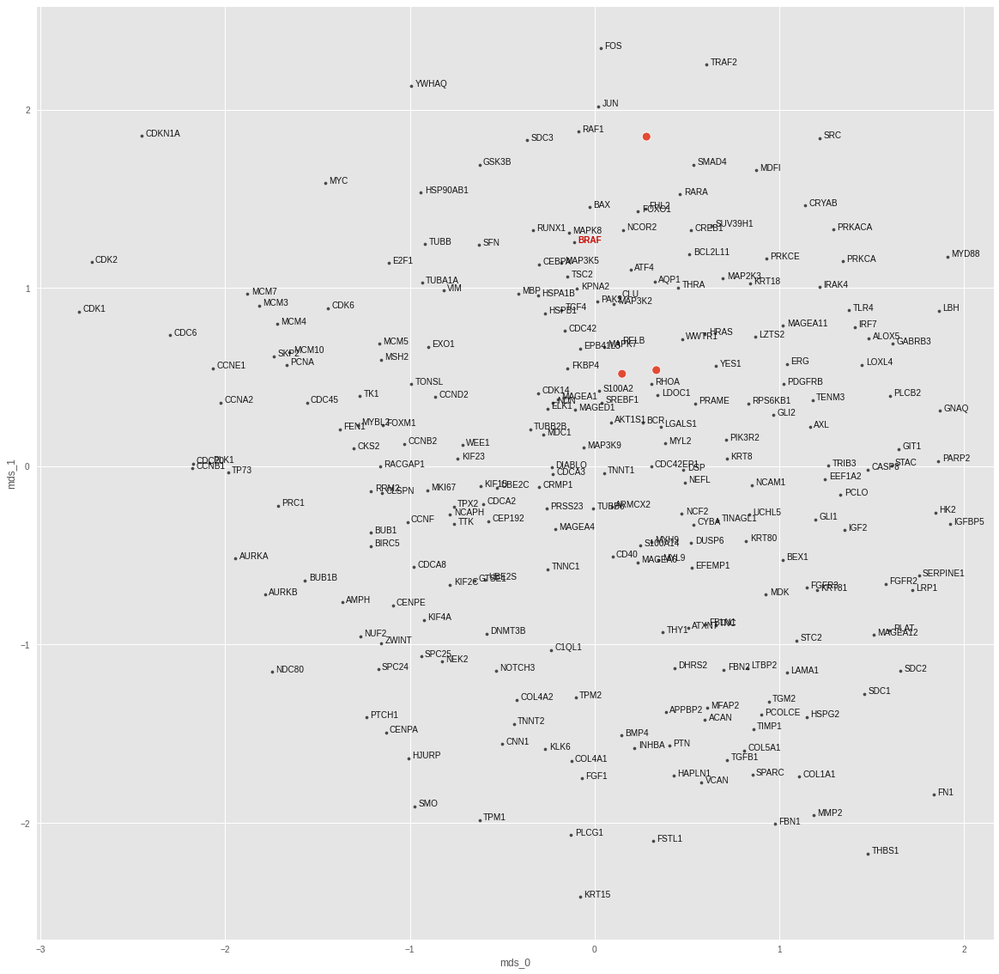

CASP8
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017713489069137722
train top-k accuracies: {1: 0.868421, 3: 0.938596, 5: 0.964912, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.007730095647275448
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


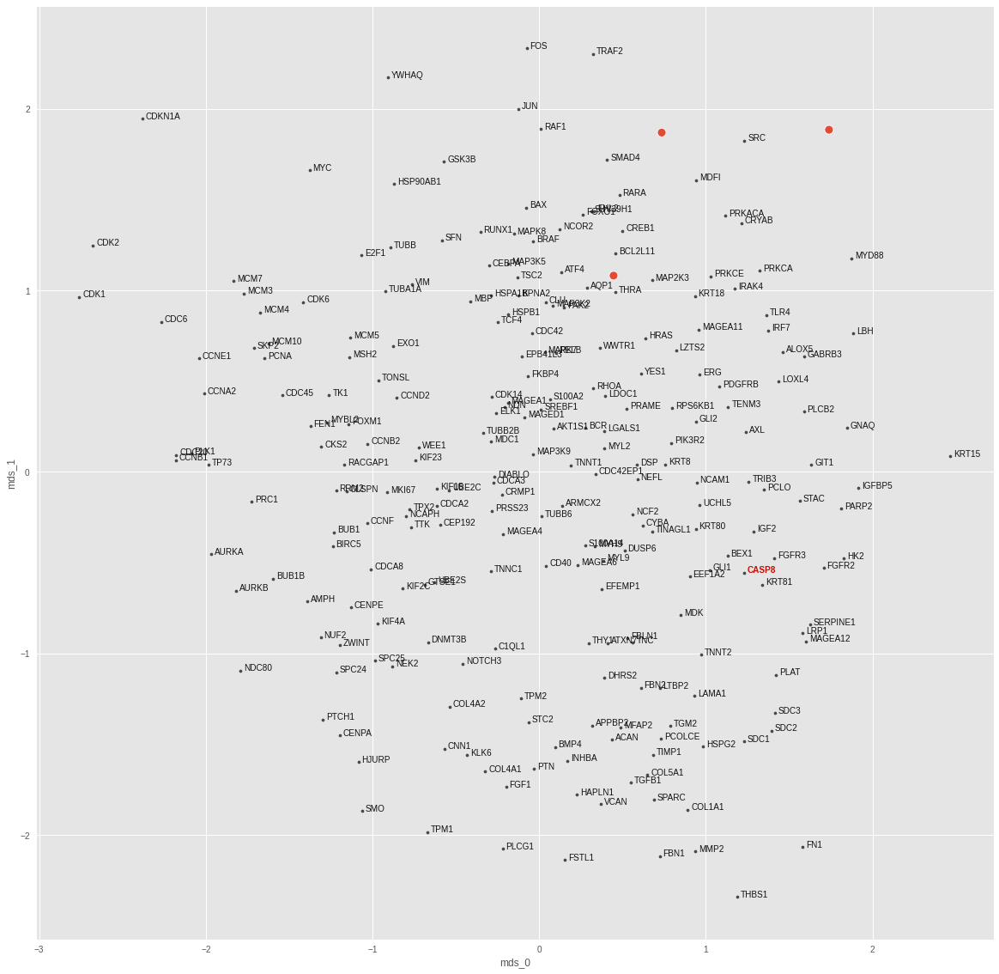

CDC42
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017034582560881972
train top-k accuracies: {1: 0.894737, 3: 0.947368, 5: 0.964912, 10: 0.964912, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004865073598921299
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.333333, 20: 0.333333, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


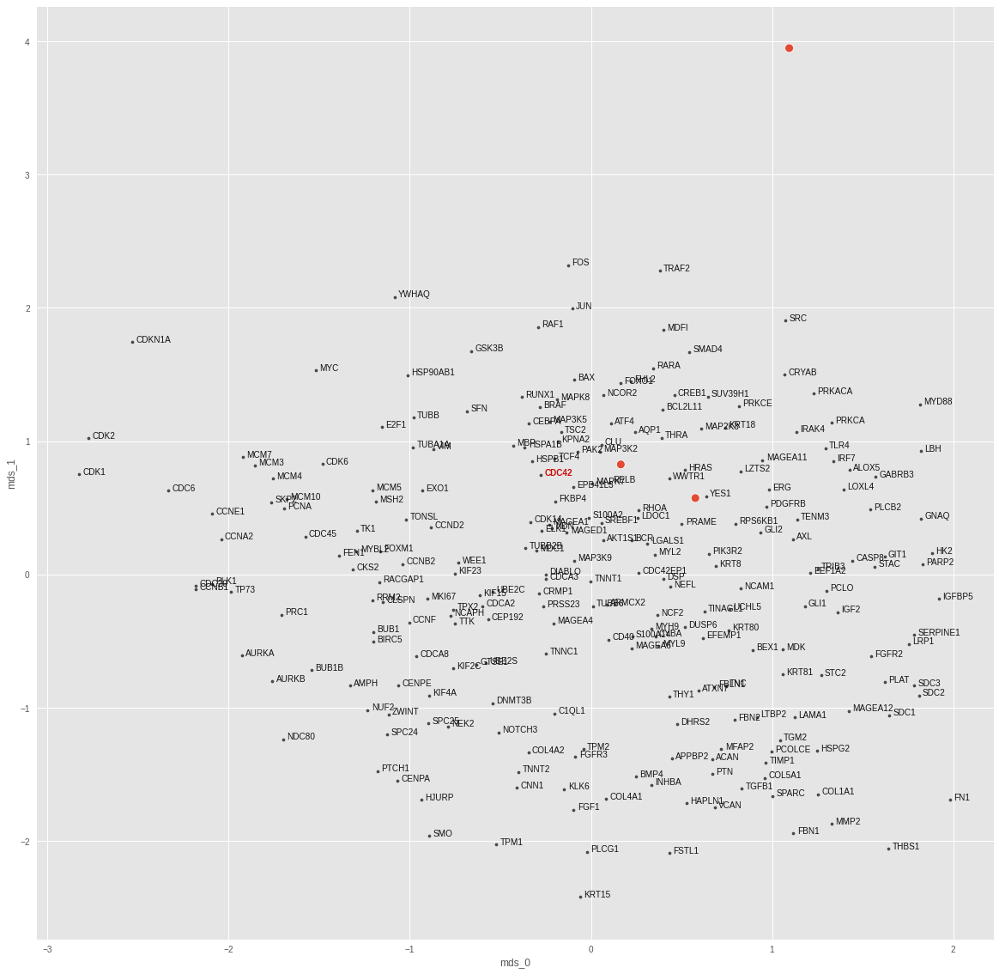

CDKN1A
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017176907567773014
train top-k accuracies: {1: 0.885965, 3: 0.929825, 5: 0.964912, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0076643191277980804
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


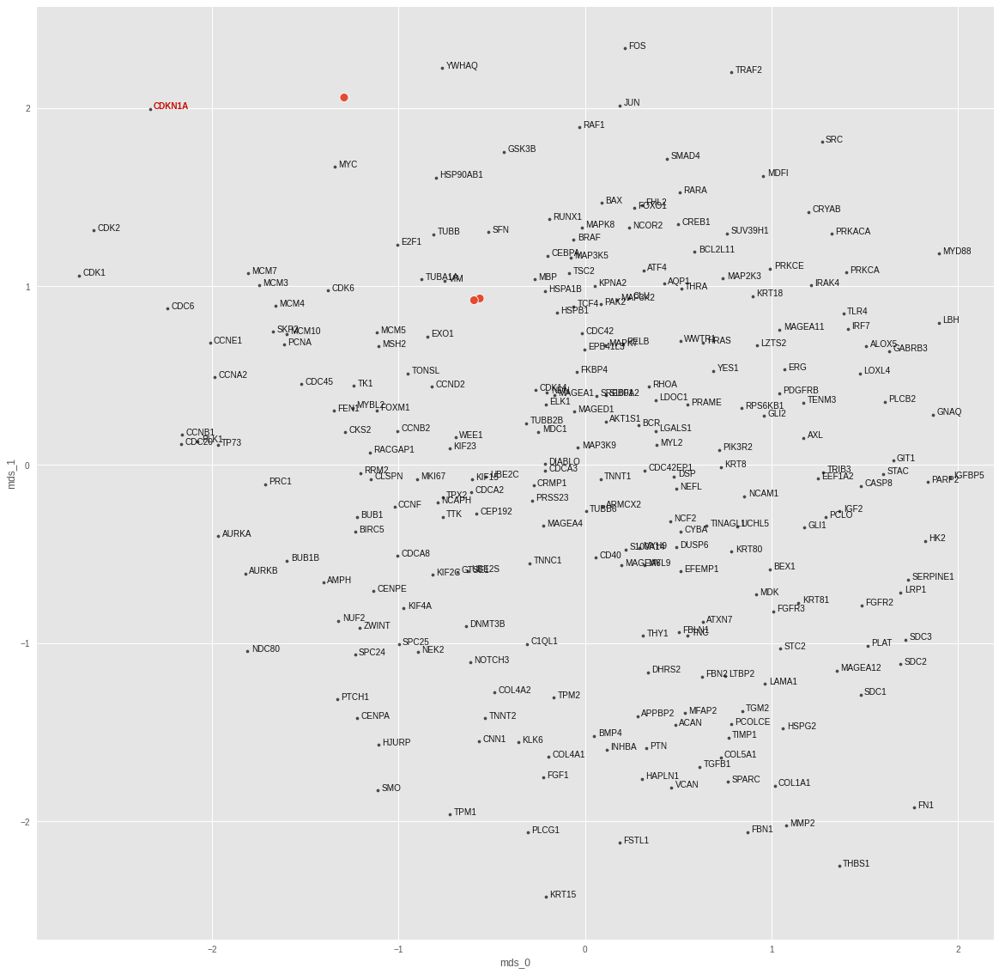

CEBPA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017555541126057506
train top-k accuracies: {1: 0.868421, 3: 0.929825, 5: 0.95614, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0028222091495990753
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


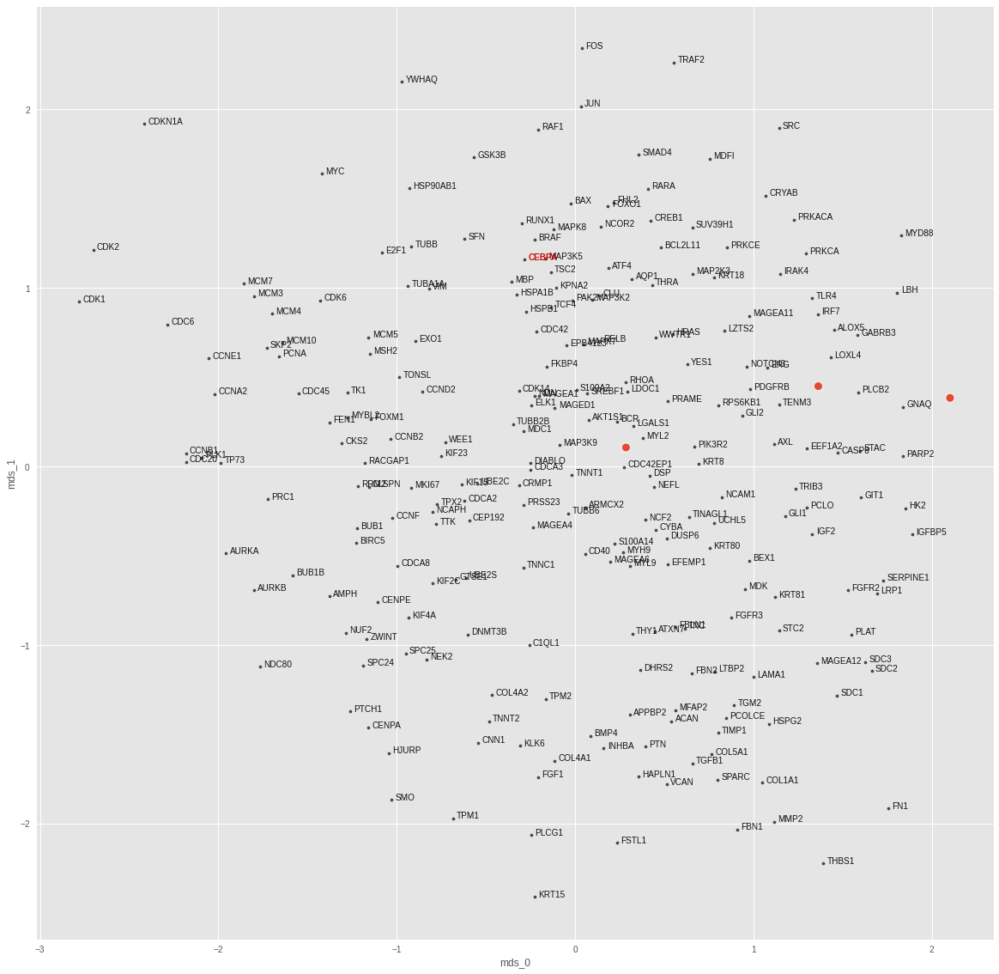

CREB1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0001735172263579443
train top-k accuracies: {1: 0.885965, 3: 0.929825, 5: 0.964912, 10: 0.982456, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.947368, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.003568406915292144
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


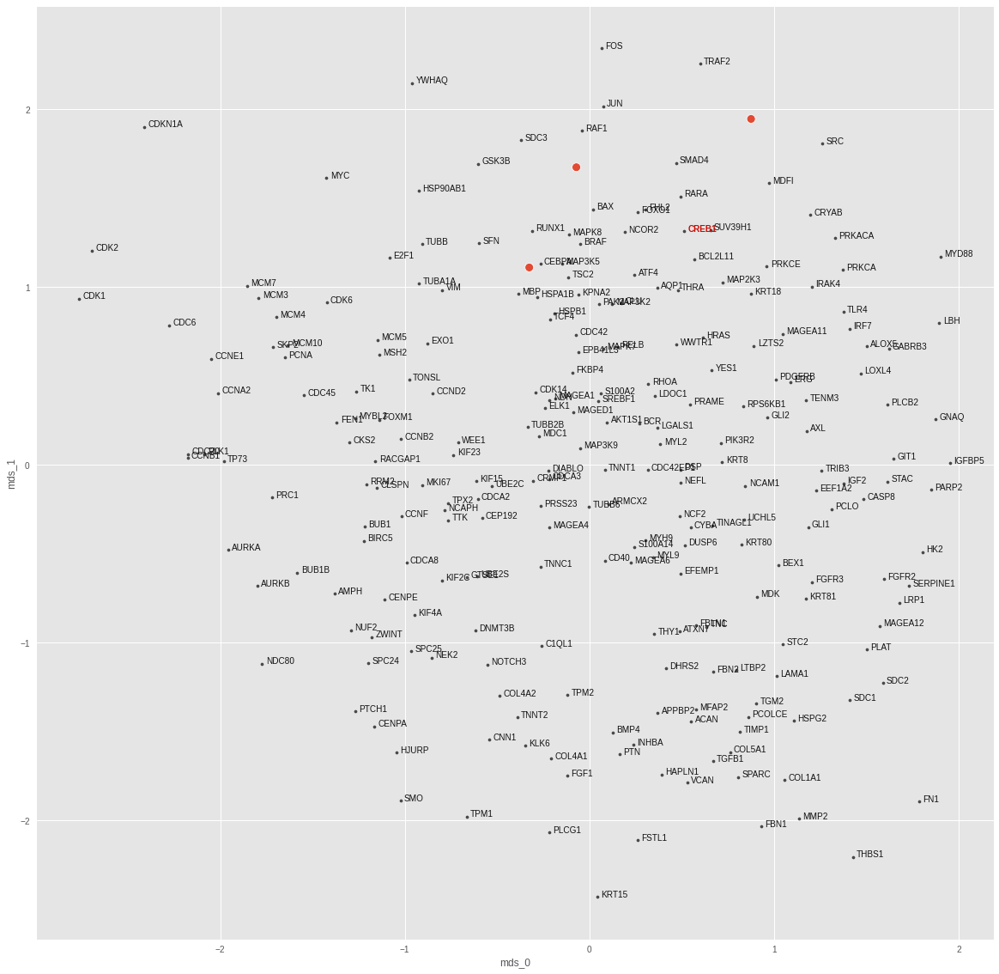

DIABLO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.000177334324689582
train top-k accuracies: {1: 0.885965, 3: 0.938596, 5: 0.973684, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0027435156516730785
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


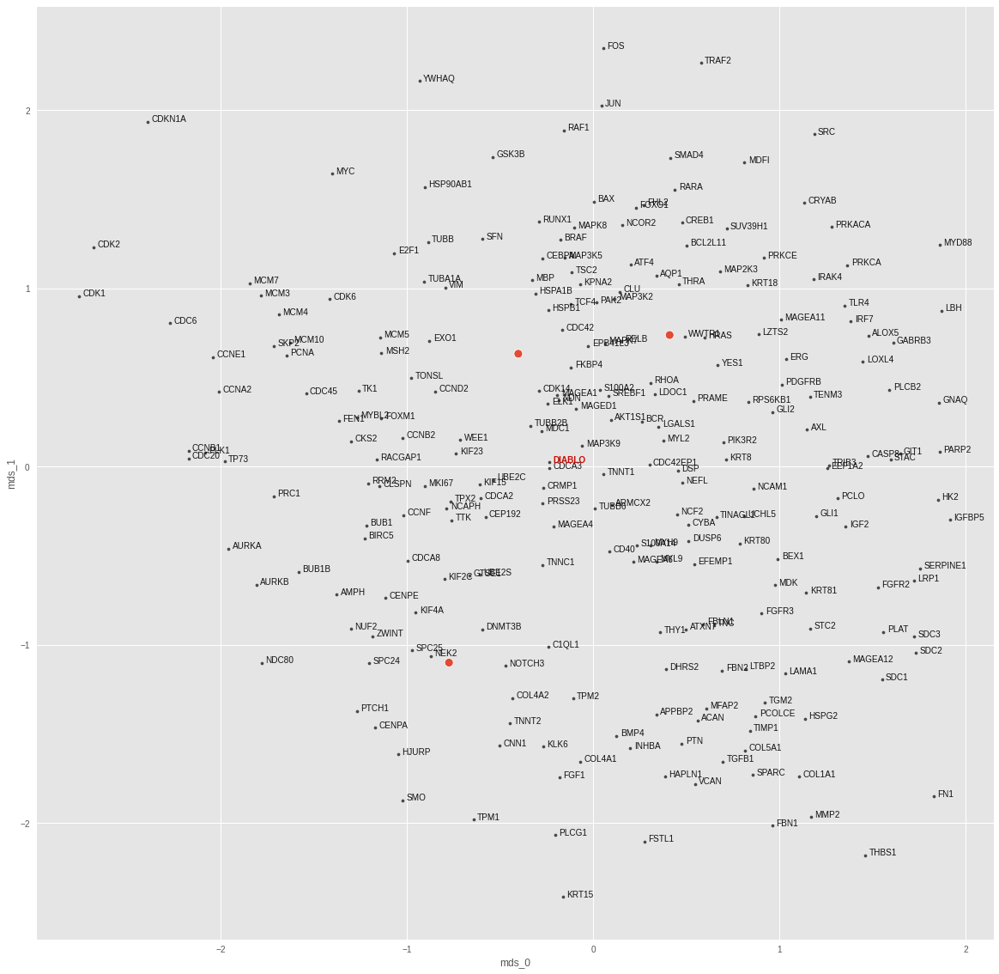

E2F1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017639040015637875
train top-k accuracies: {1: 0.877193, 3: 0.929825, 5: 0.95614, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.006342555396258831
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


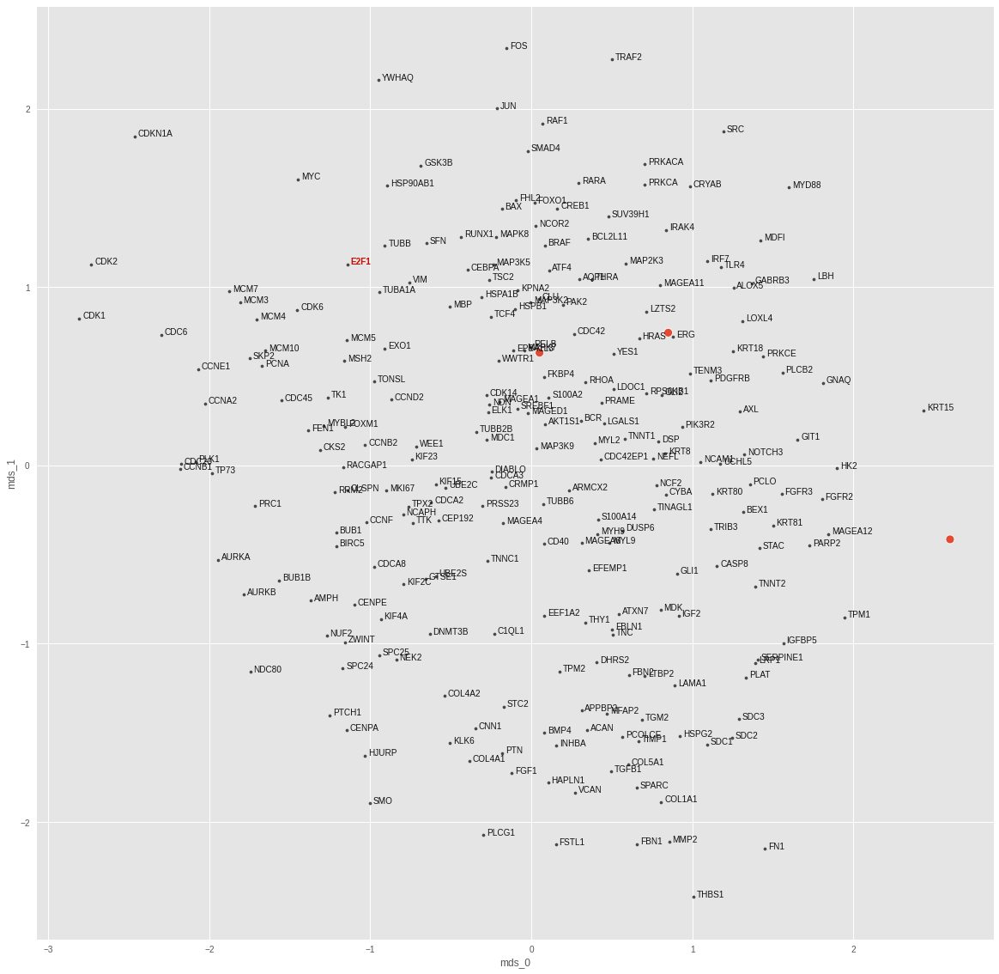

ELK1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017656921409070492
train top-k accuracies: {1: 0.868421, 3: 0.929825, 5: 0.964912, 10: 0.982456, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004709768574684858
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.333333, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


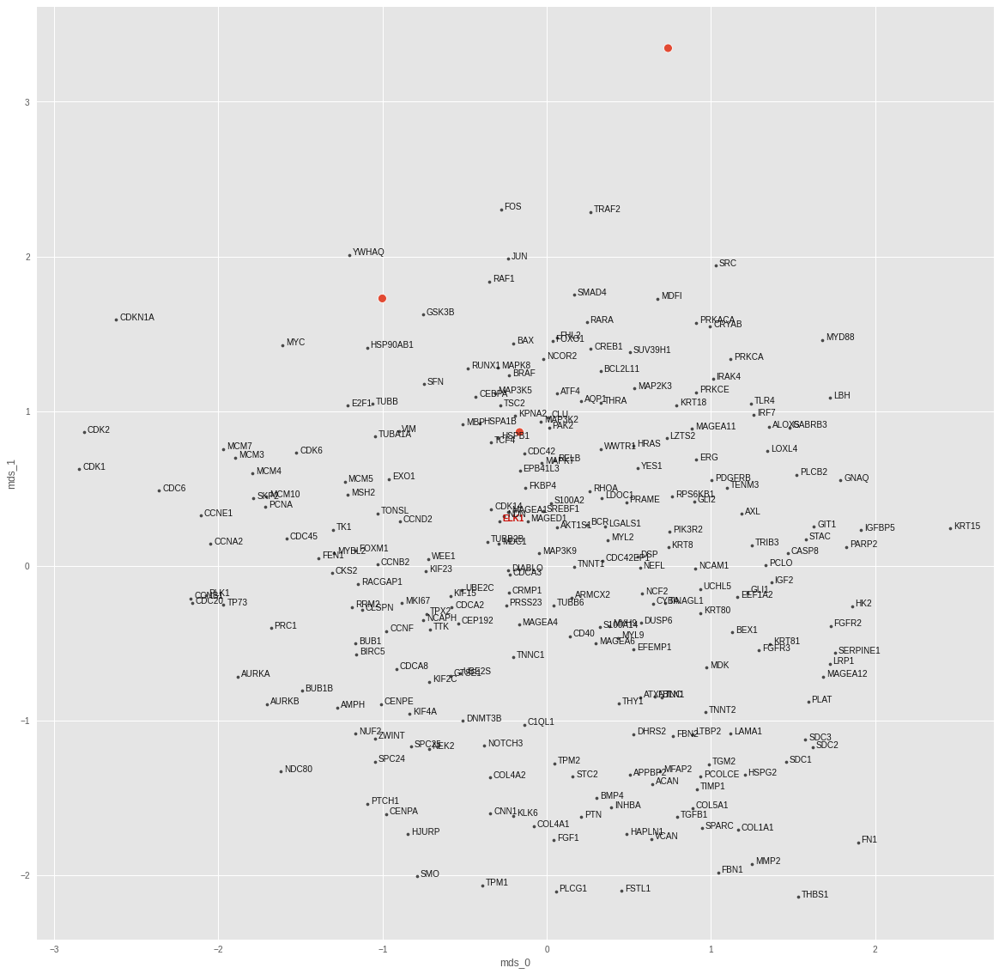

ERG
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0001756710553308949
train top-k accuracies: {1: 0.885965, 3: 0.929825, 5: 0.964912, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0027248915284872055
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


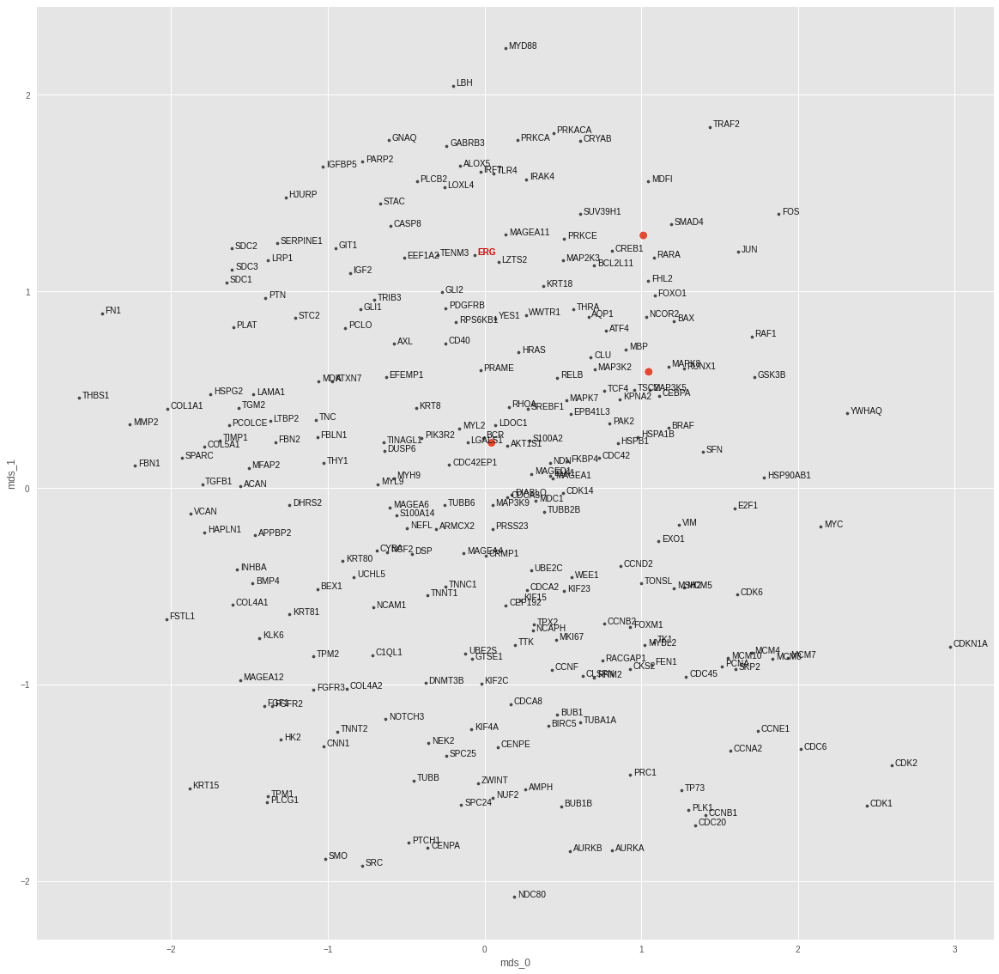

FGFR3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00016790389781817794
train top-k accuracies: {1: 0.894737, 3: 0.938596, 5: 0.964912, 10: 0.964912, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0036093099042773247
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


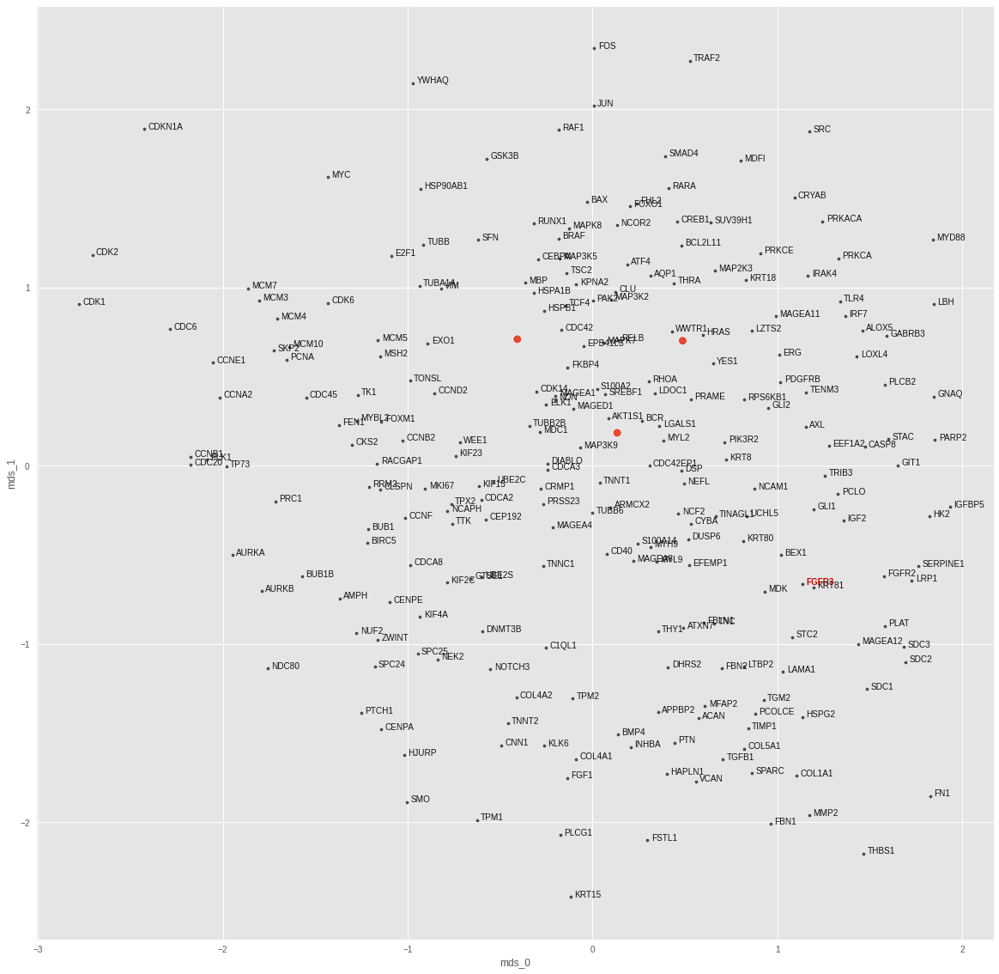

FOXO1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00016990385483950377
train top-k accuracies: {1: 0.877193, 3: 0.929825, 5: 0.947368, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0029593012295663357
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


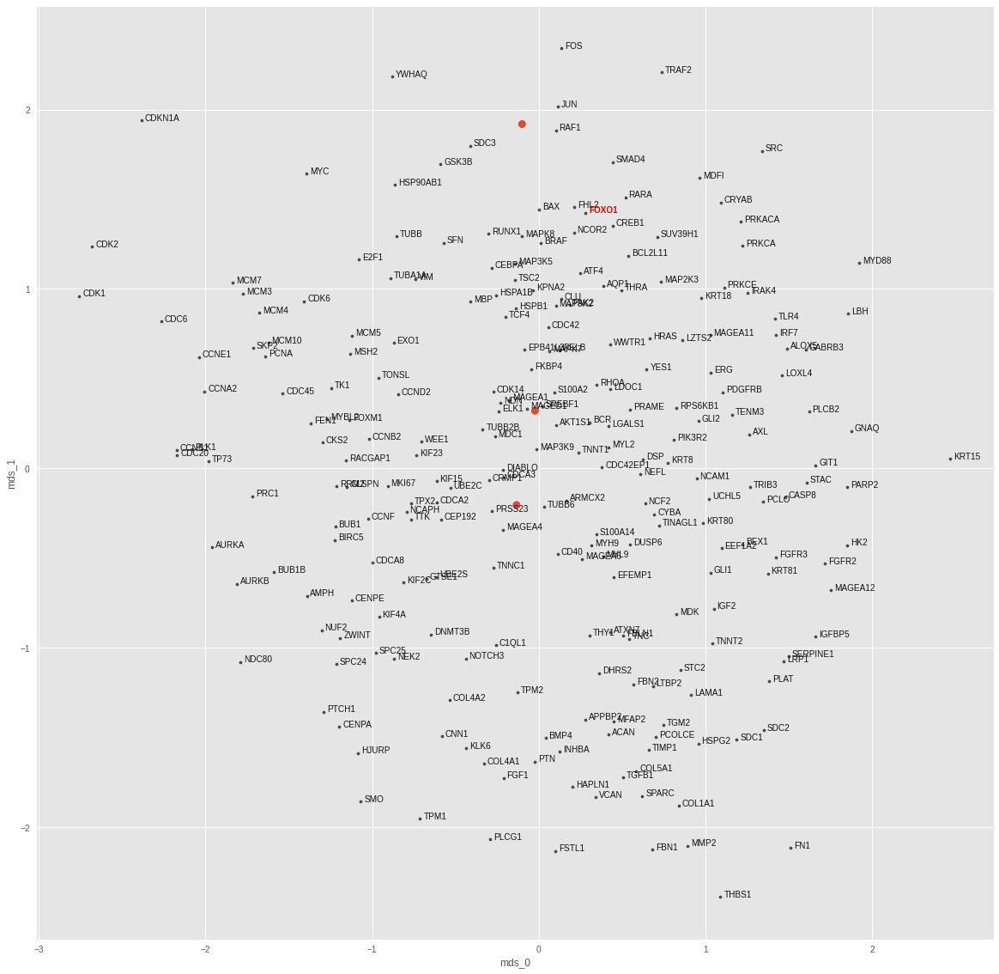

GLI1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017343313083983958
train top-k accuracies: {1: 0.877193, 3: 0.947368, 5: 0.964912, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.002810846781358123
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


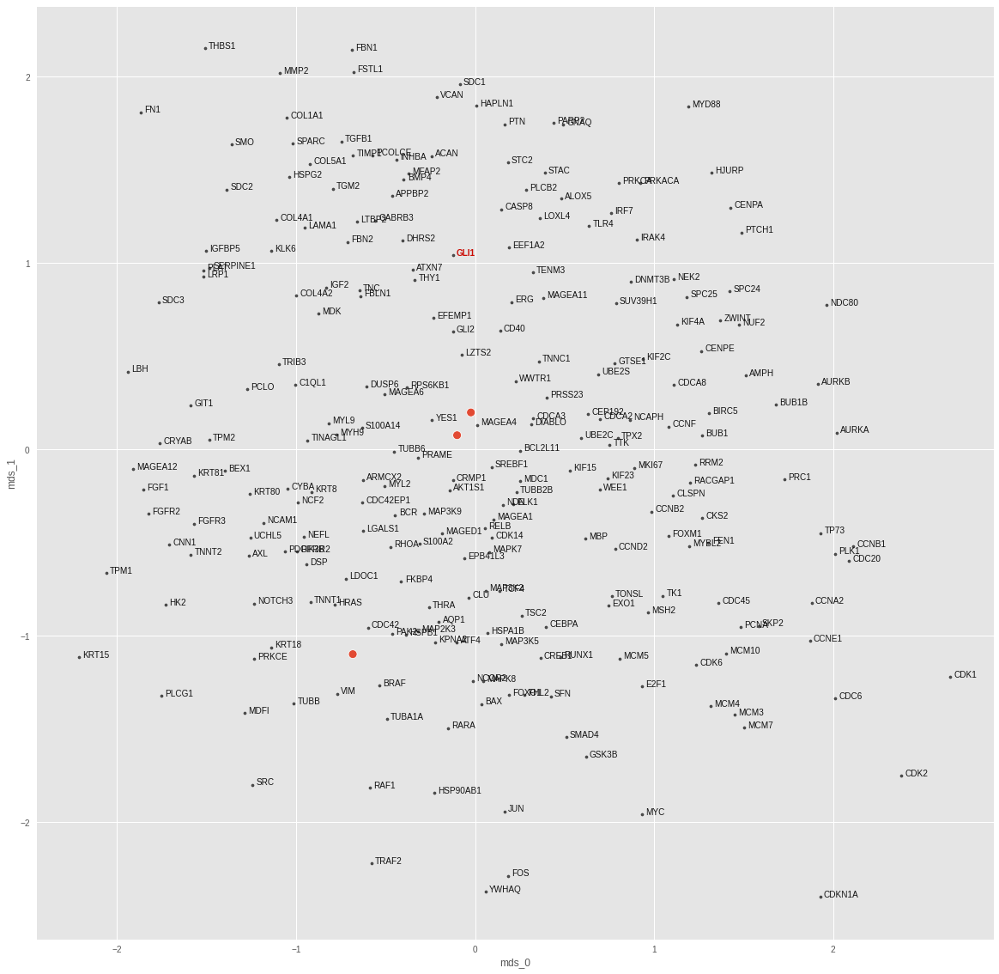

HRAS
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017719369498081505
train top-k accuracies: {1: 0.877193, 3: 0.938596, 5: 0.973684, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.002652290277183056
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


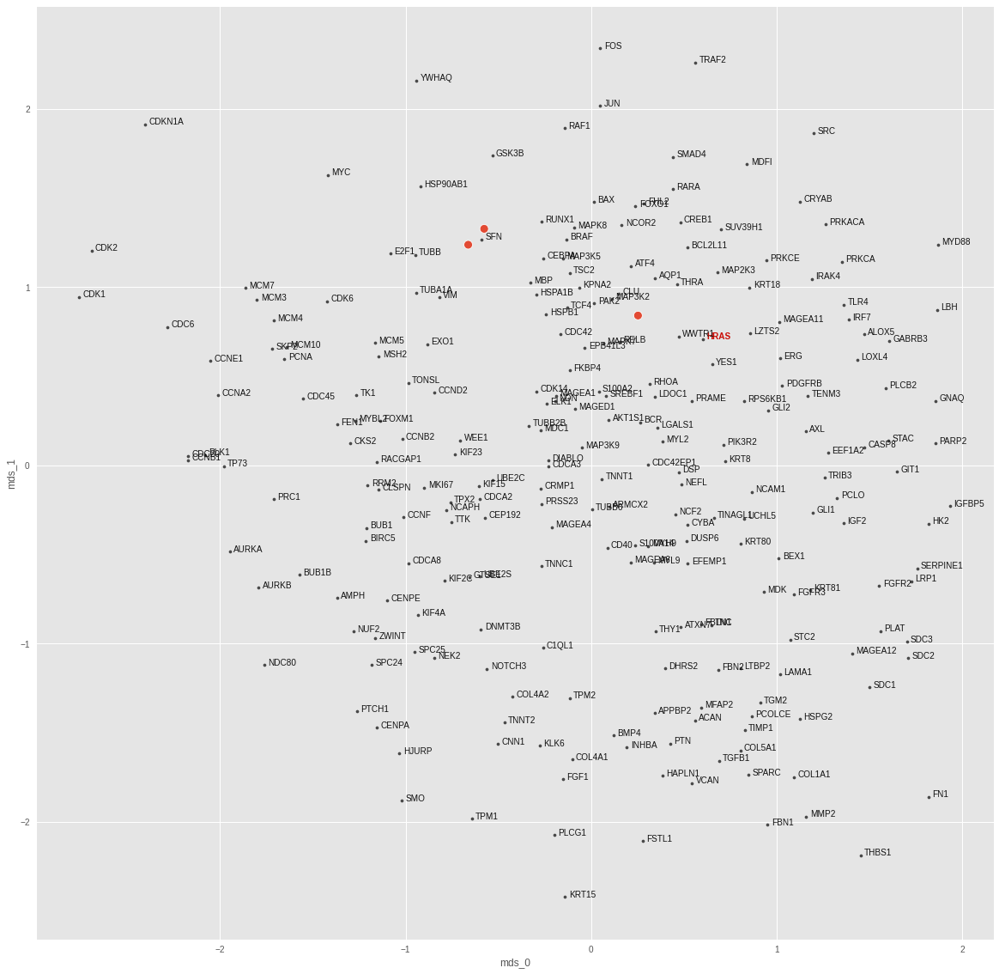

IRAK4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017393779125995934
train top-k accuracies: {1: 0.894737, 3: 0.929825, 5: 0.95614, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0031348667107522488
test top-k accuracies: {1: 0.0, 3: 0.333333, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


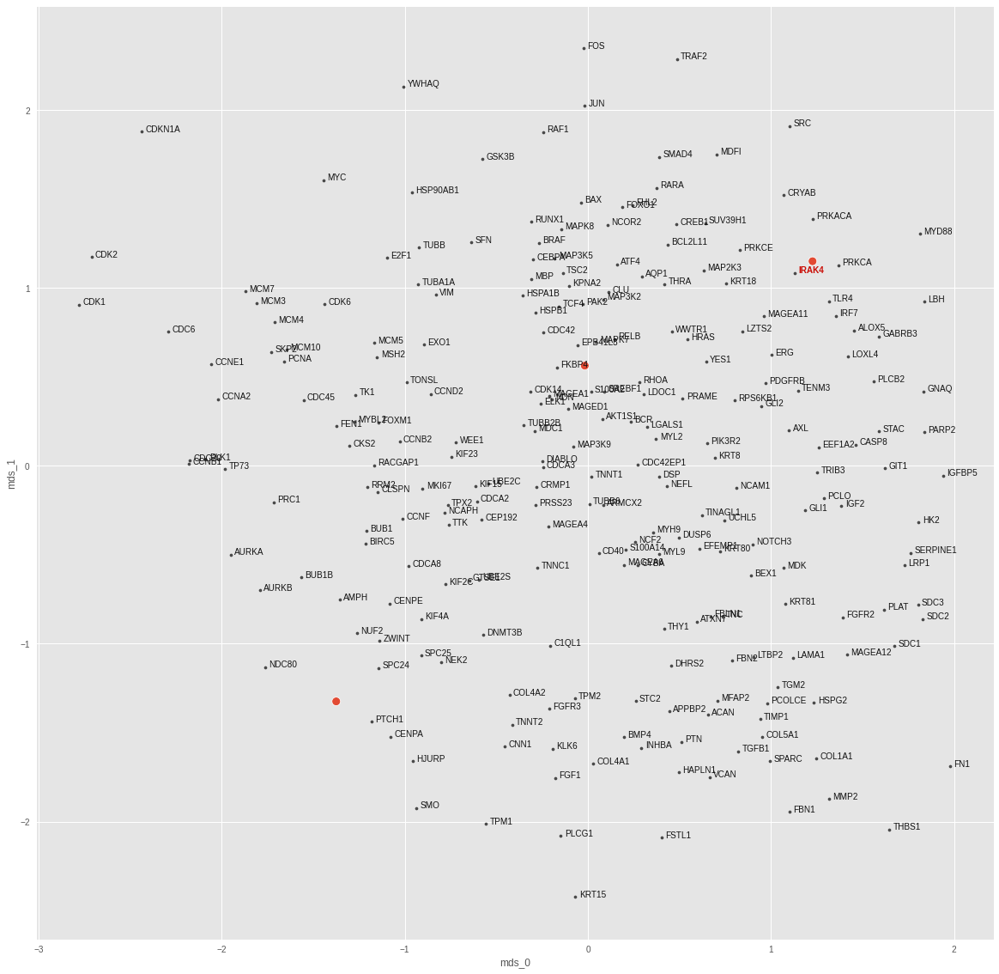

JUN
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0001750893861753866
train top-k accuracies: {1: 0.877193, 3: 0.938596, 5: 0.95614, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 0.947368, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004686469212174416
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


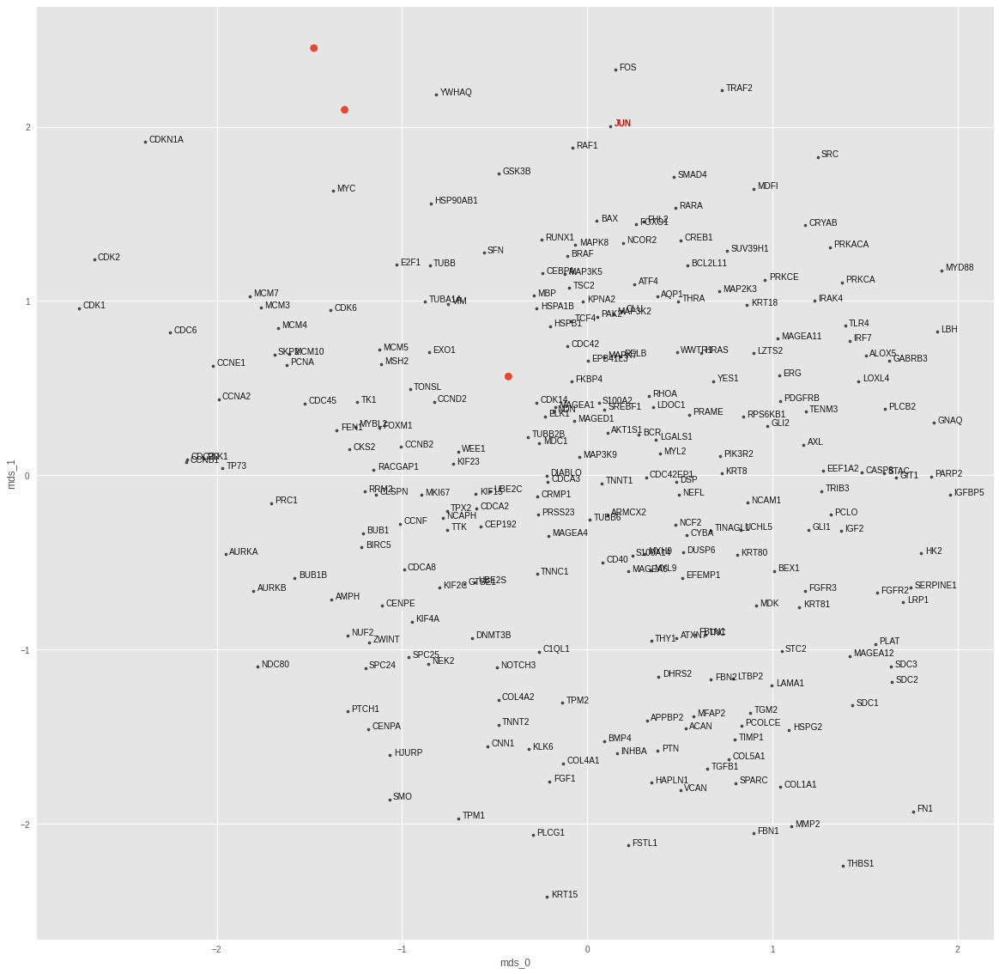

MAP2K3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017221331654582173
train top-k accuracies: {1: 0.877193, 3: 0.938596, 5: 0.964912, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.00325695239007473
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


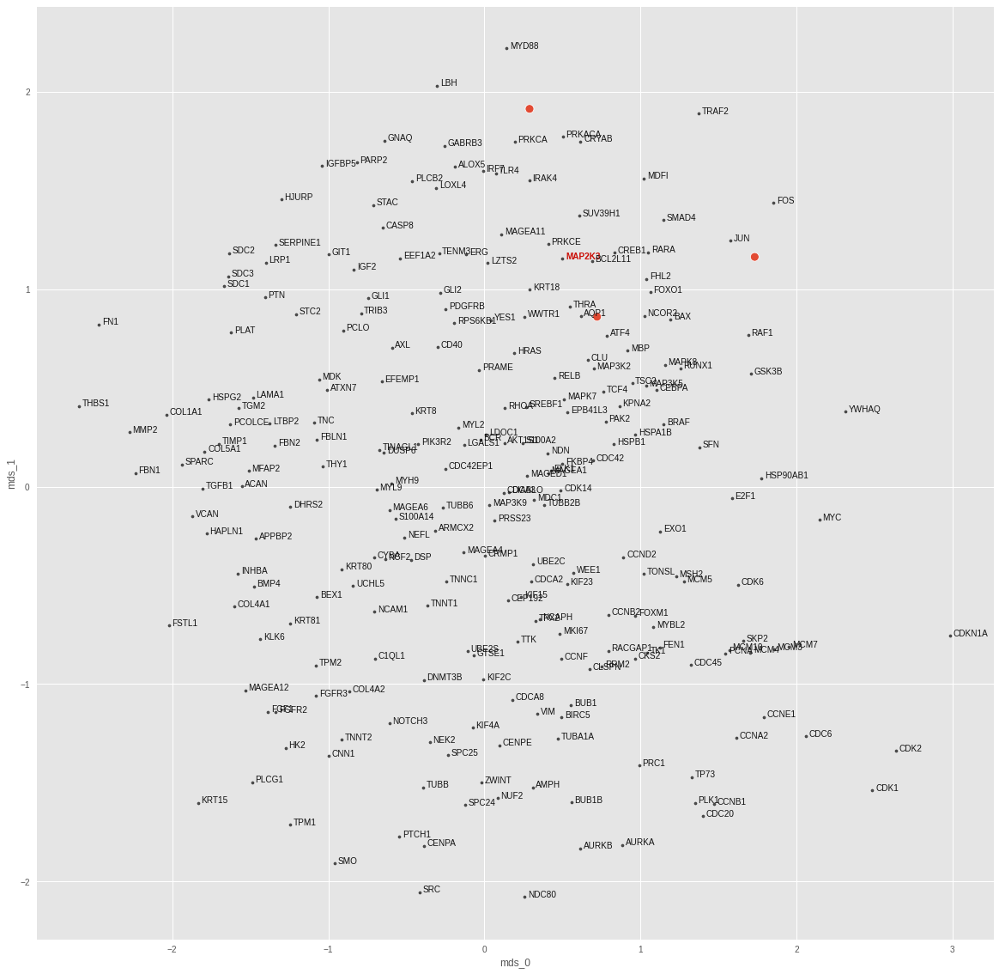

MAP3K2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017568103794474155
train top-k accuracies: {1: 0.885965, 3: 0.929825, 5: 0.964912, 10: 0.982456, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0030737612396478653
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.333333, 20: 0.666667, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


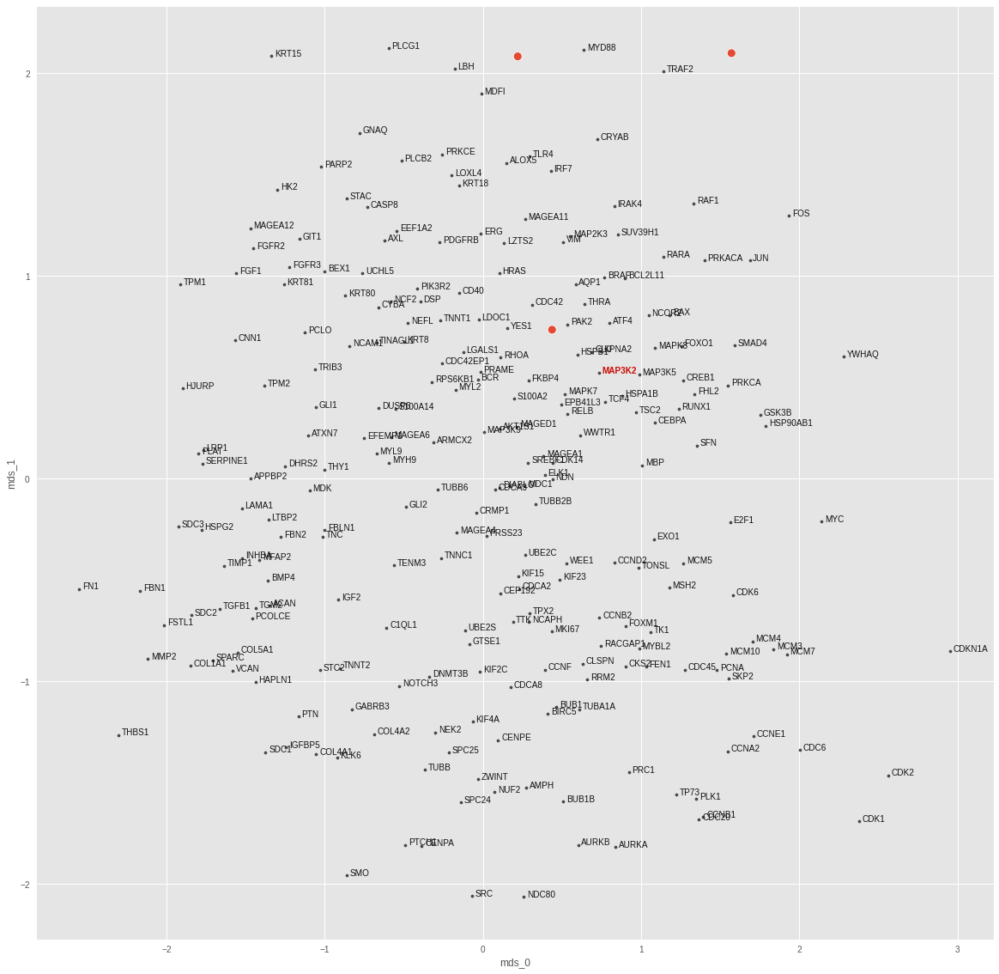

MAP3K5
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017867659335024655
train top-k accuracies: {1: 0.868421, 3: 0.929825, 5: 0.95614, 10: 0.982456, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0009475289843976498
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.666667, 10: 0.666667, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


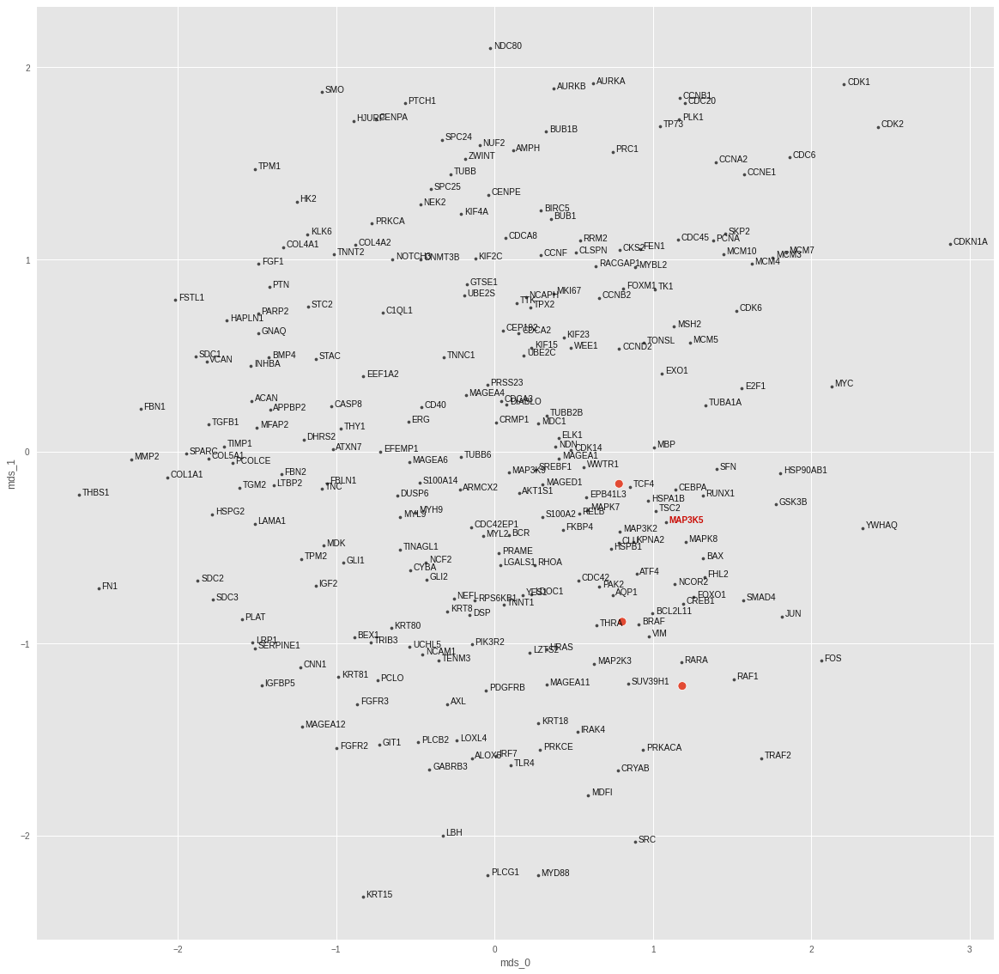

MAP3K9
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0001818429009290412
train top-k accuracies: {1: 0.877193, 3: 0.929825, 5: 0.947368, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0033585955388844013
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


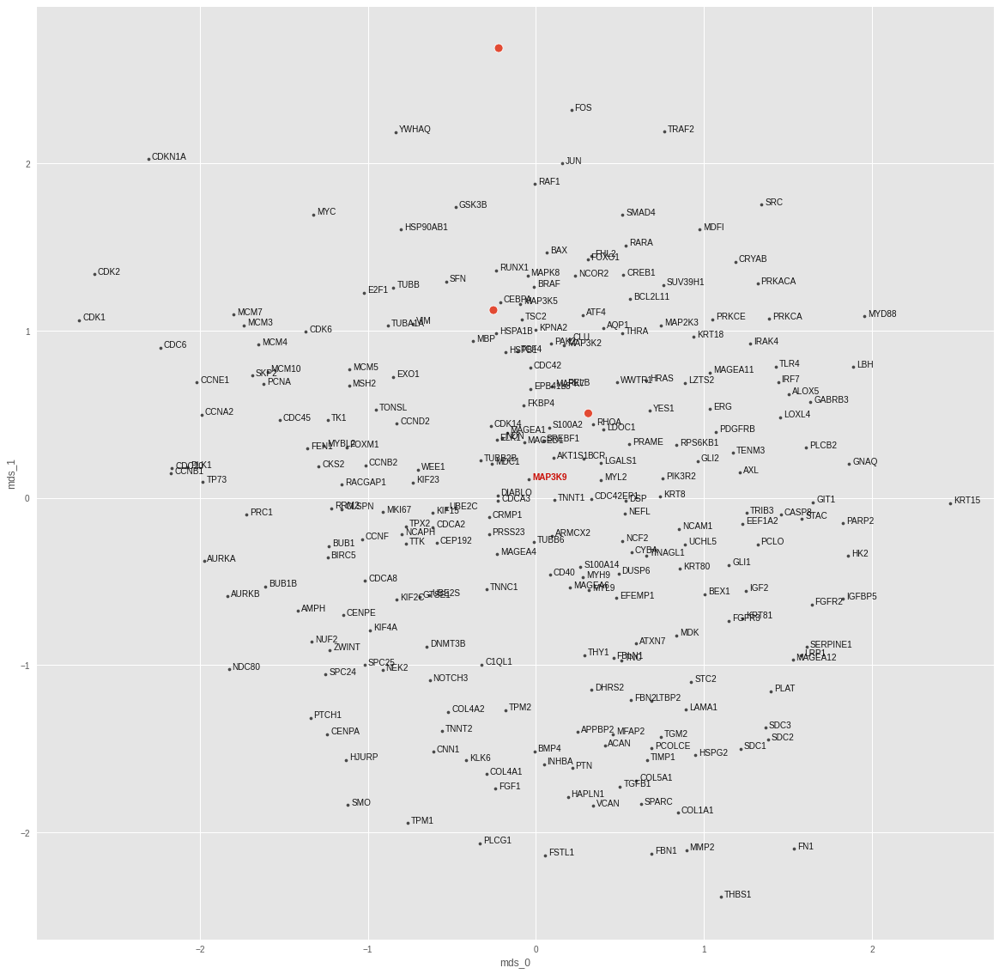

MAPK7
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017859799845609814
train top-k accuracies: {1: 0.877193, 3: 0.938596, 5: 0.964912, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0014699347084388137
test top-k accuracies: {1: 0.0, 3: 0.333333, 5: 0.333333, 10: 0.333333, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


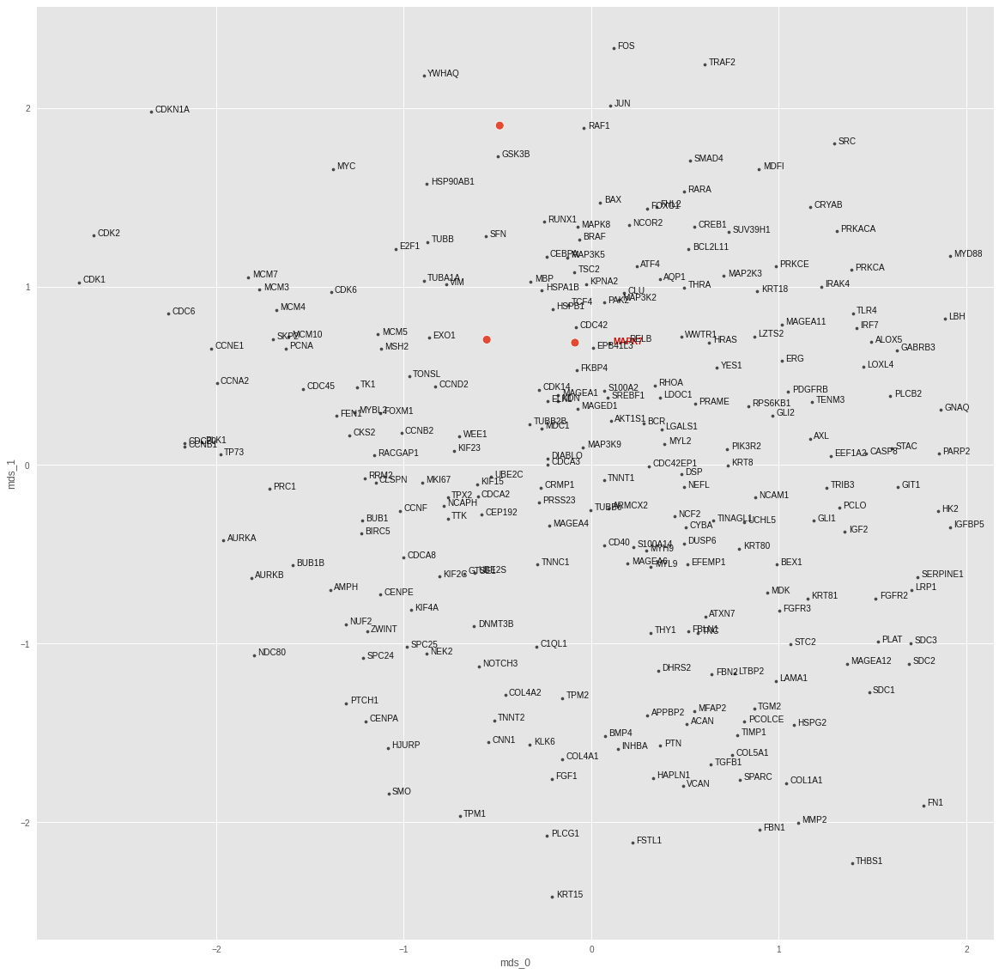

MYD88
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00015710454317741096
train top-k accuracies: {1: 0.894737, 3: 0.964912, 5: 0.964912, 10: 0.973684, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.947368, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.007092497311532497
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


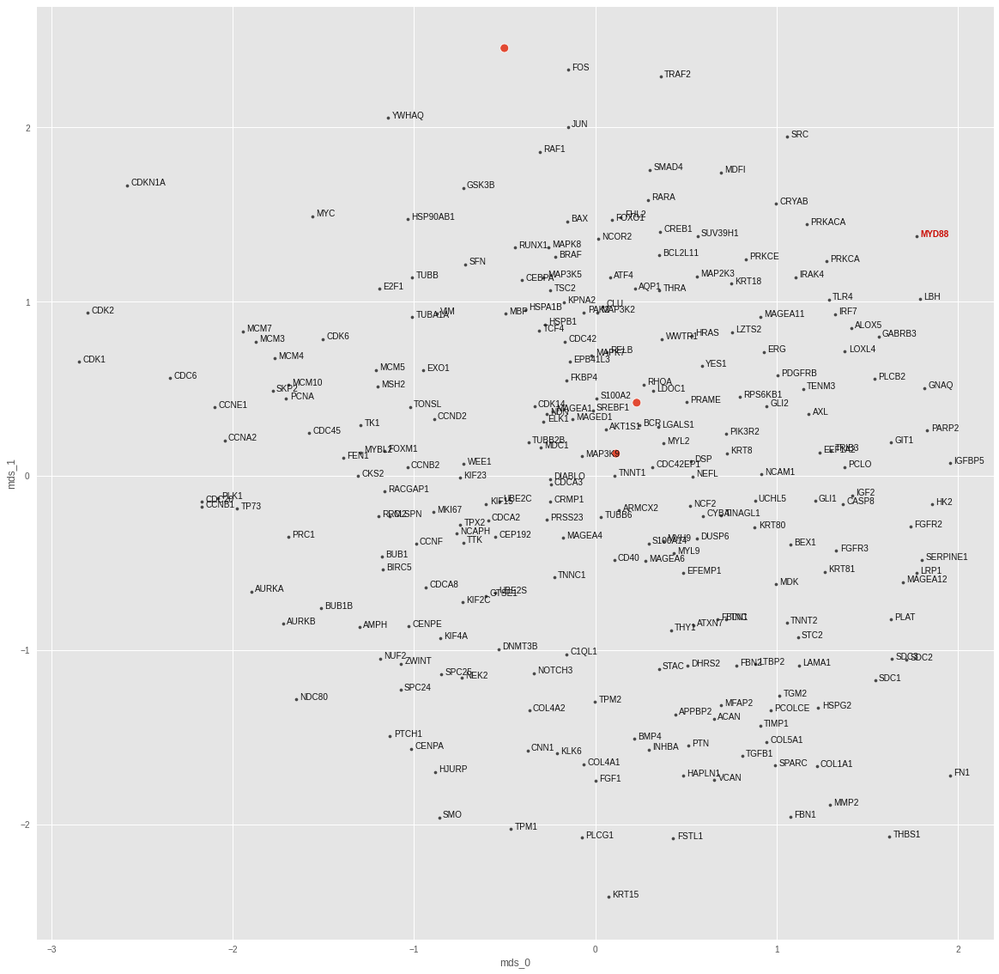

PIK3R2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0001800593890948221
train top-k accuracies: {1: 0.877193, 3: 0.929825, 5: 0.95614, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 0.947368, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0018280015792697668
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.666667, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


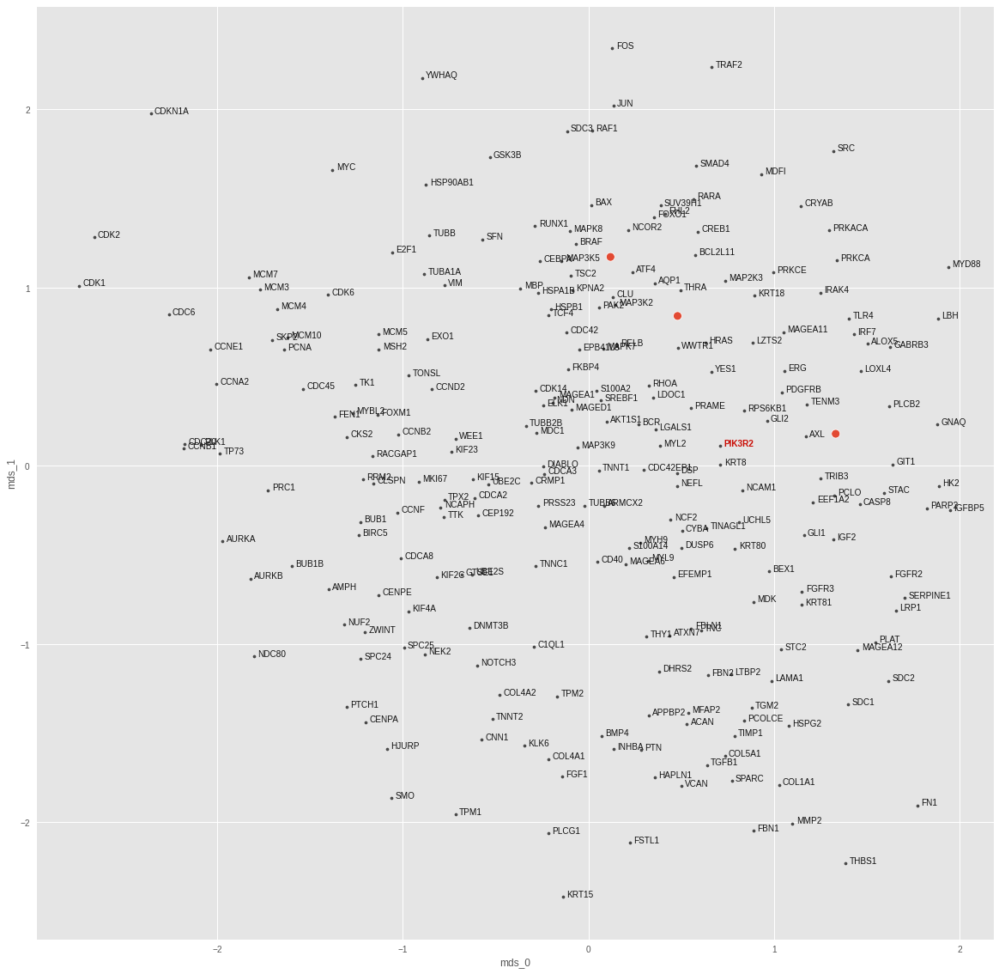

PRKACA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0001737714628688991
train top-k accuracies: {1: 0.868421, 3: 0.929825, 5: 0.947368, 10: 0.982456, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.947368, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.005113955587148666
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


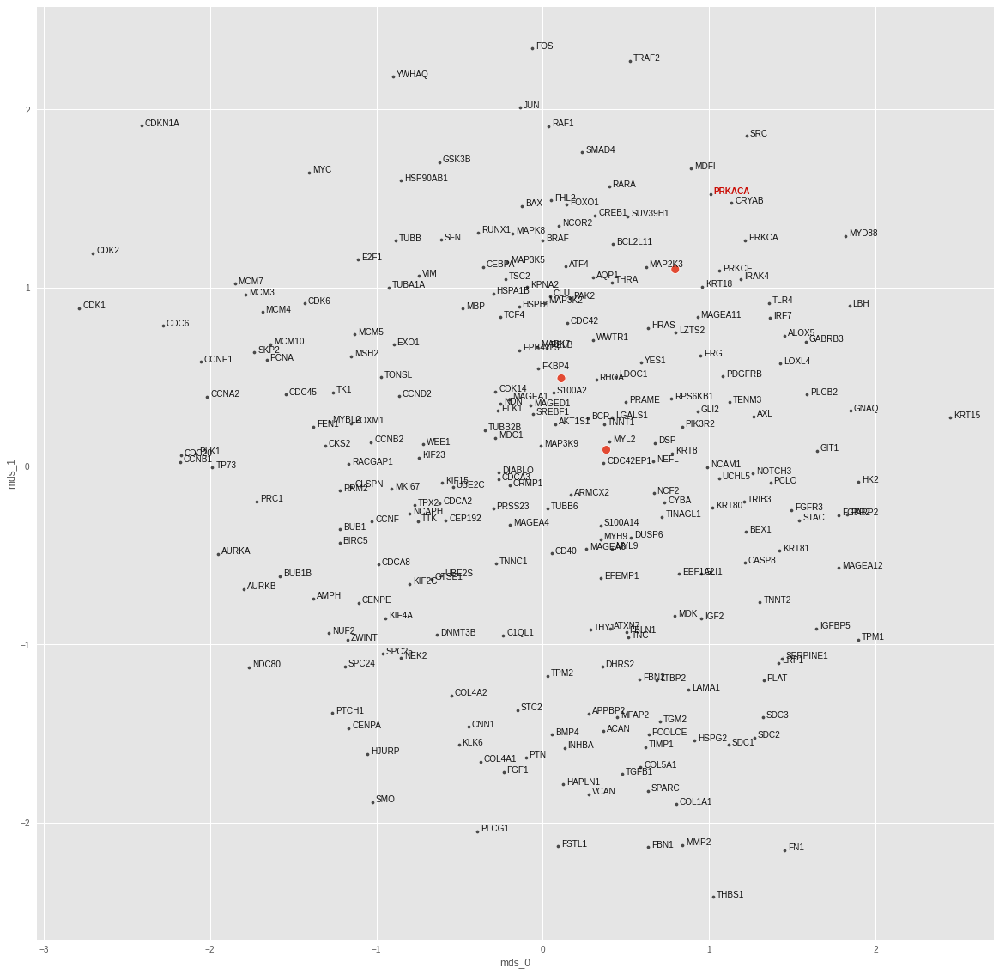

PRKCE
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00015775270003359765
train top-k accuracies: {1: 0.894737, 3: 0.95614, 5: 0.973684, 10: 0.982456, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.947368, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0029938805382698774
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


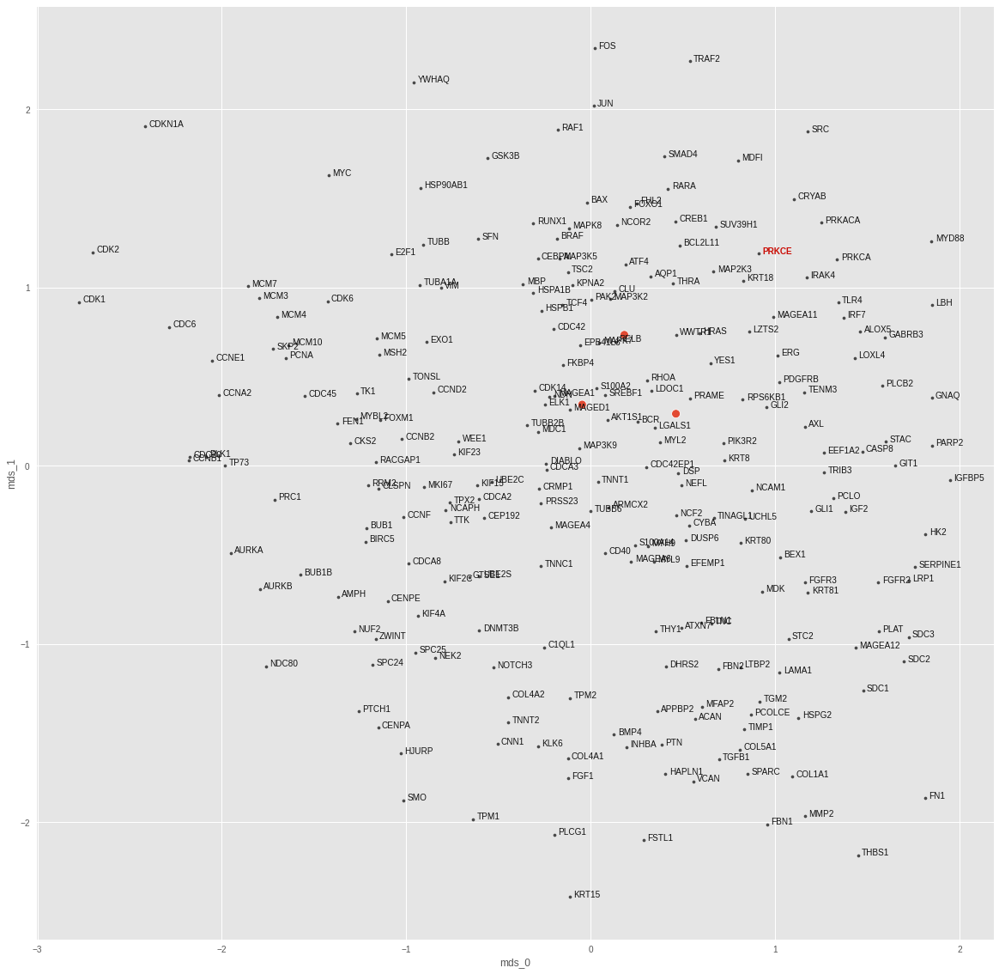

RAF1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00016983639216050506
train top-k accuracies: {1: 0.894737, 3: 0.938596, 5: 0.973684, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 0.947368, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0023056217469274998
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


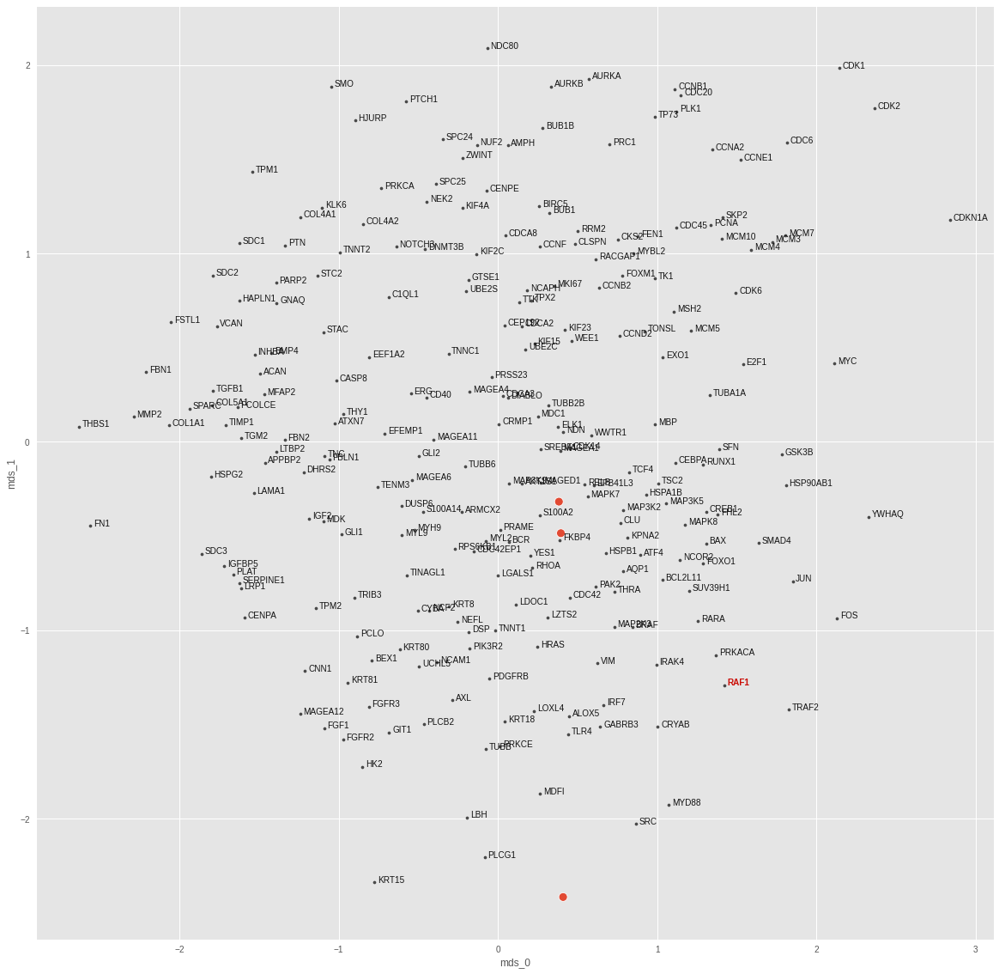

RELB
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017321253835689276
train top-k accuracies: {1: 0.885965, 3: 0.938596, 5: 0.973684, 10: 0.982456, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.947368, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0066651455126702785
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


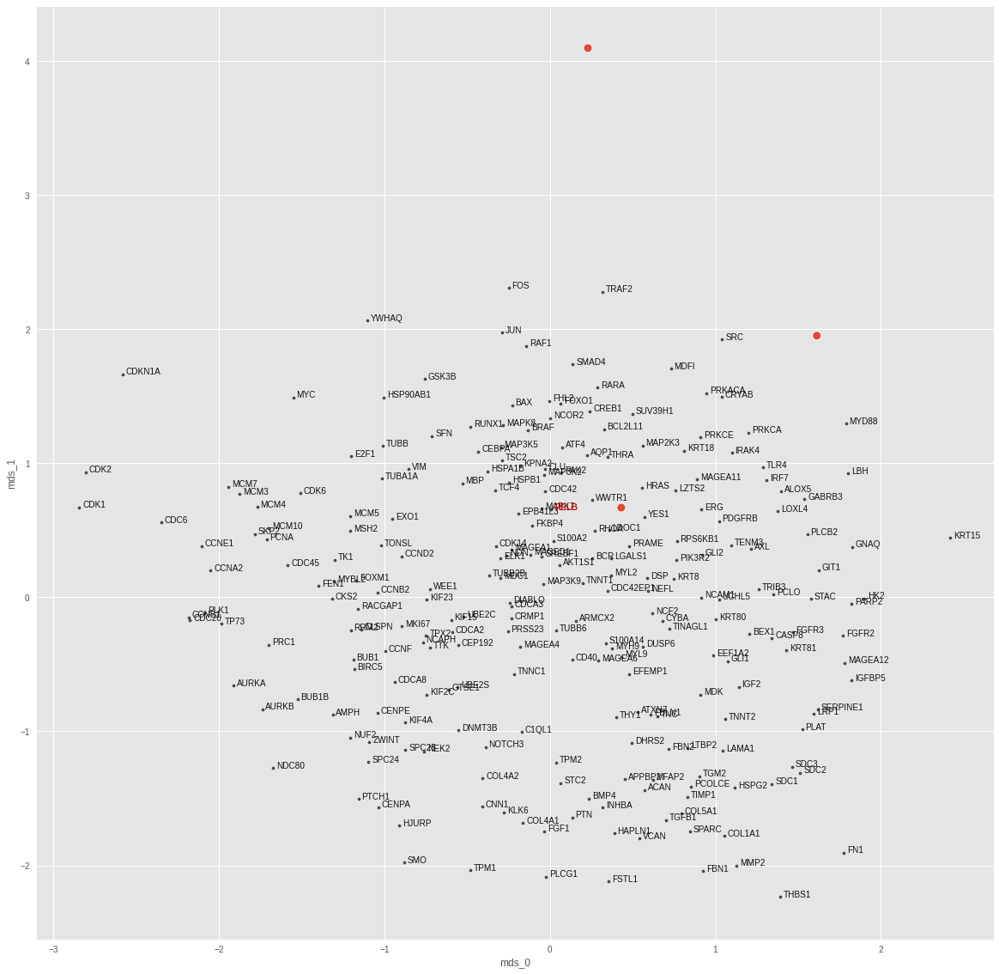

RHOA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0001773252442944795
train top-k accuracies: {1: 0.877193, 3: 0.929825, 5: 0.947368, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0012006856268271804
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.333333, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


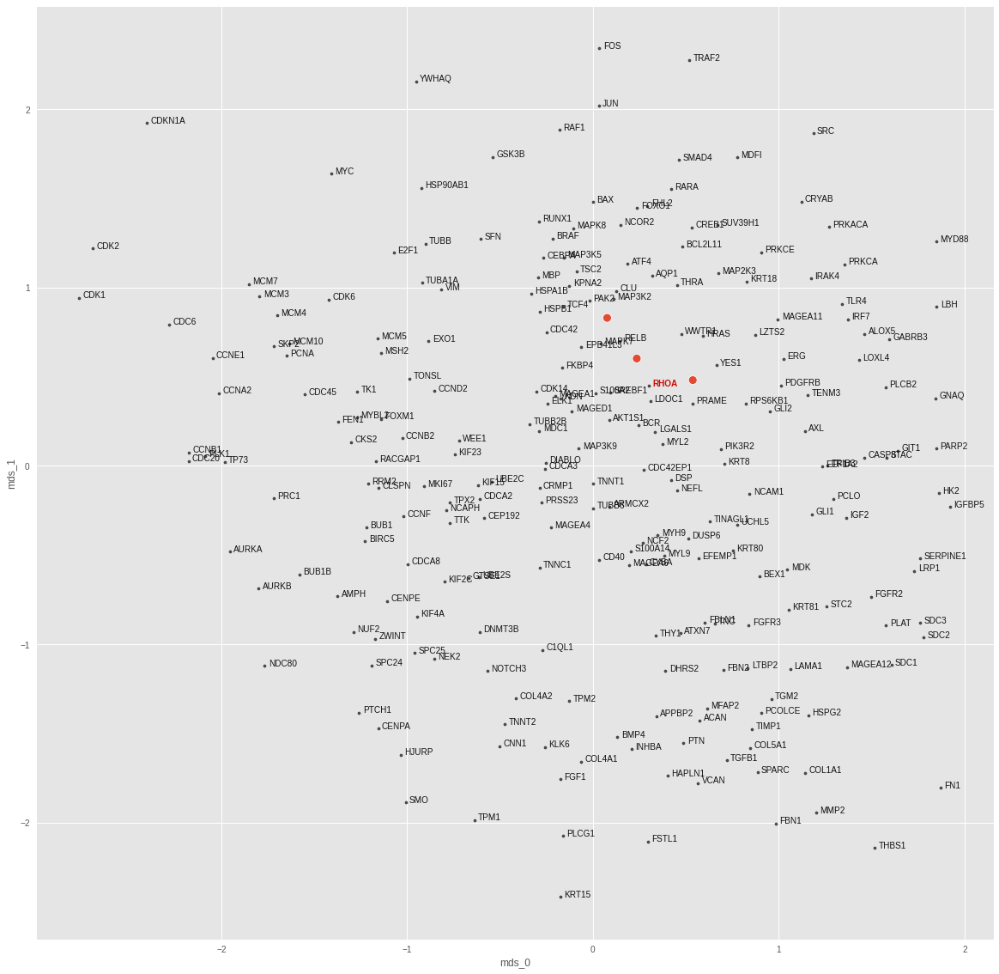

SMAD4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017847545677796006
train top-k accuracies: {1: 0.877193, 3: 0.929825, 5: 0.964912, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0026027876883745193
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


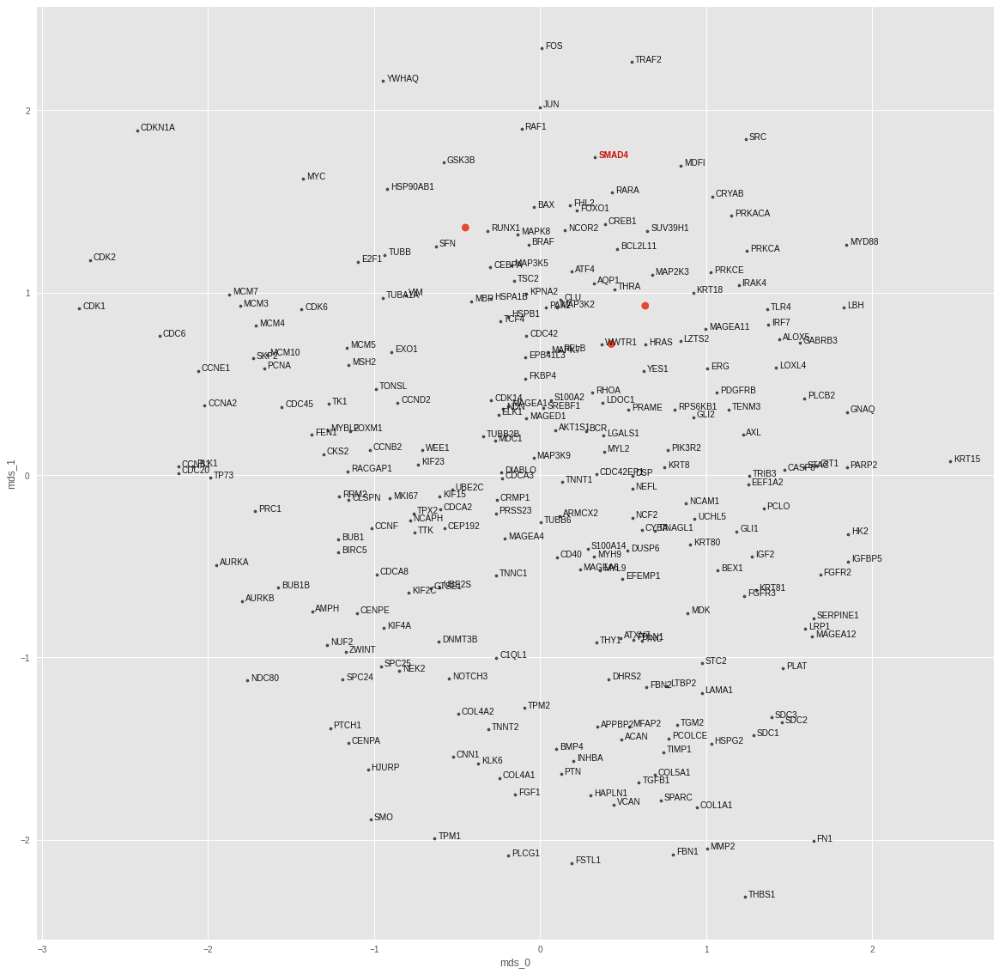

SMO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00015382438141386956
train top-k accuracies: {1: 0.894737, 3: 0.938596, 5: 0.964912, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.947368, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0053459471091628075
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


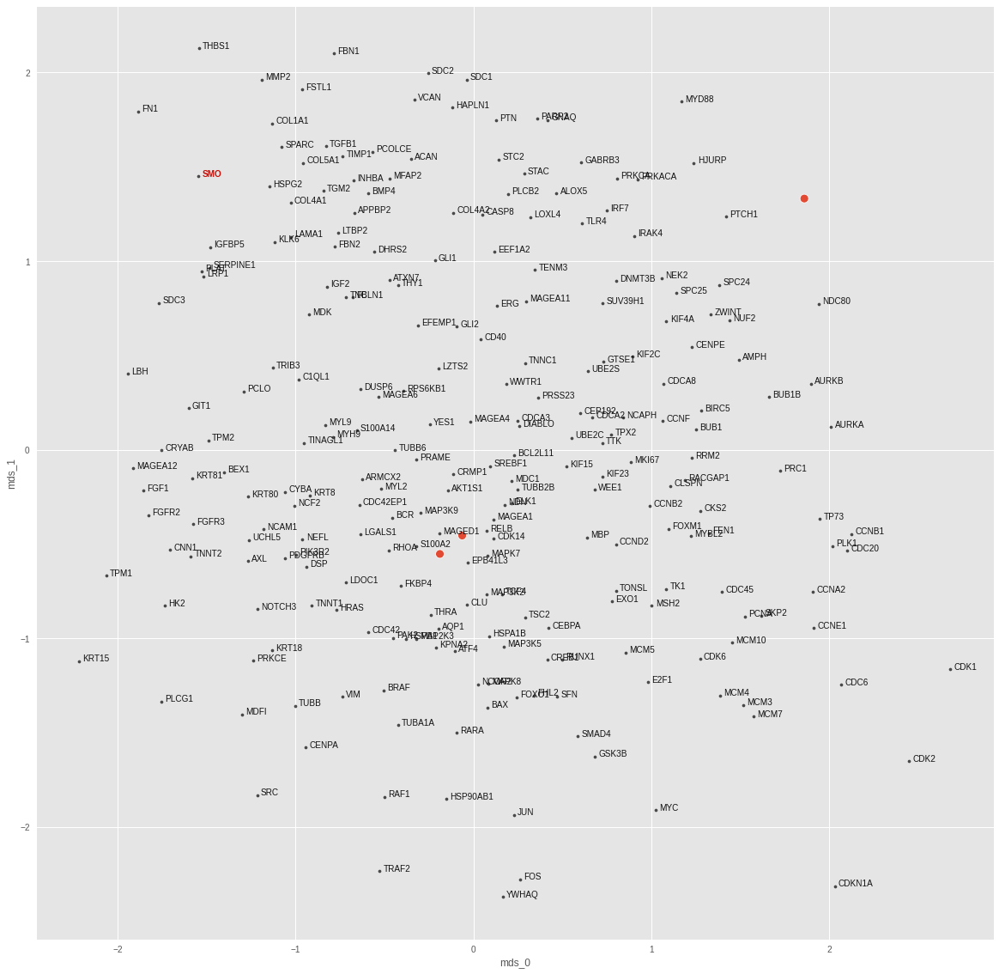

SRC
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017461537208873779
train top-k accuracies: {1: 0.894737, 3: 0.929825, 5: 0.95614, 10: 0.982456, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.002676241099834442
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


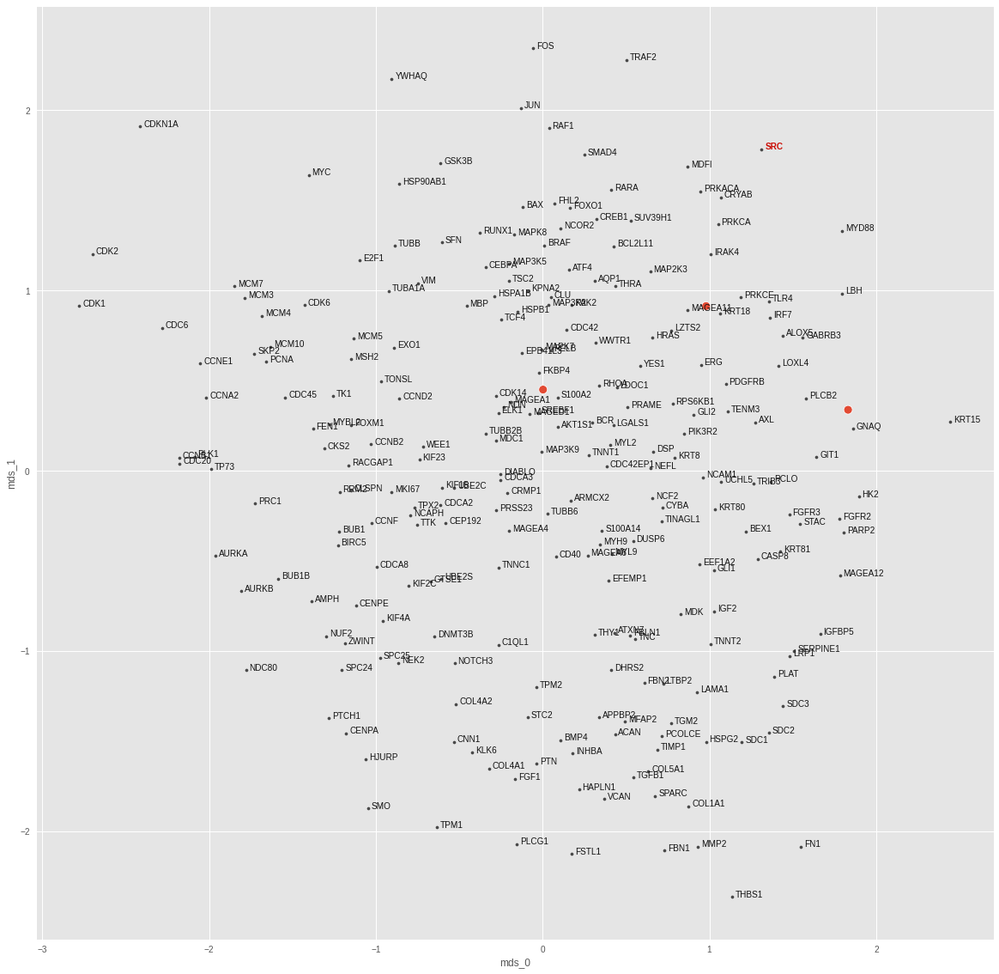

SREBF1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0001768605288816616
train top-k accuracies: {1: 0.877193, 3: 0.929825, 5: 0.947368, 10: 0.964912, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0016870133113116026
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.666667, 10: 0.666667, 20: 0.666667, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


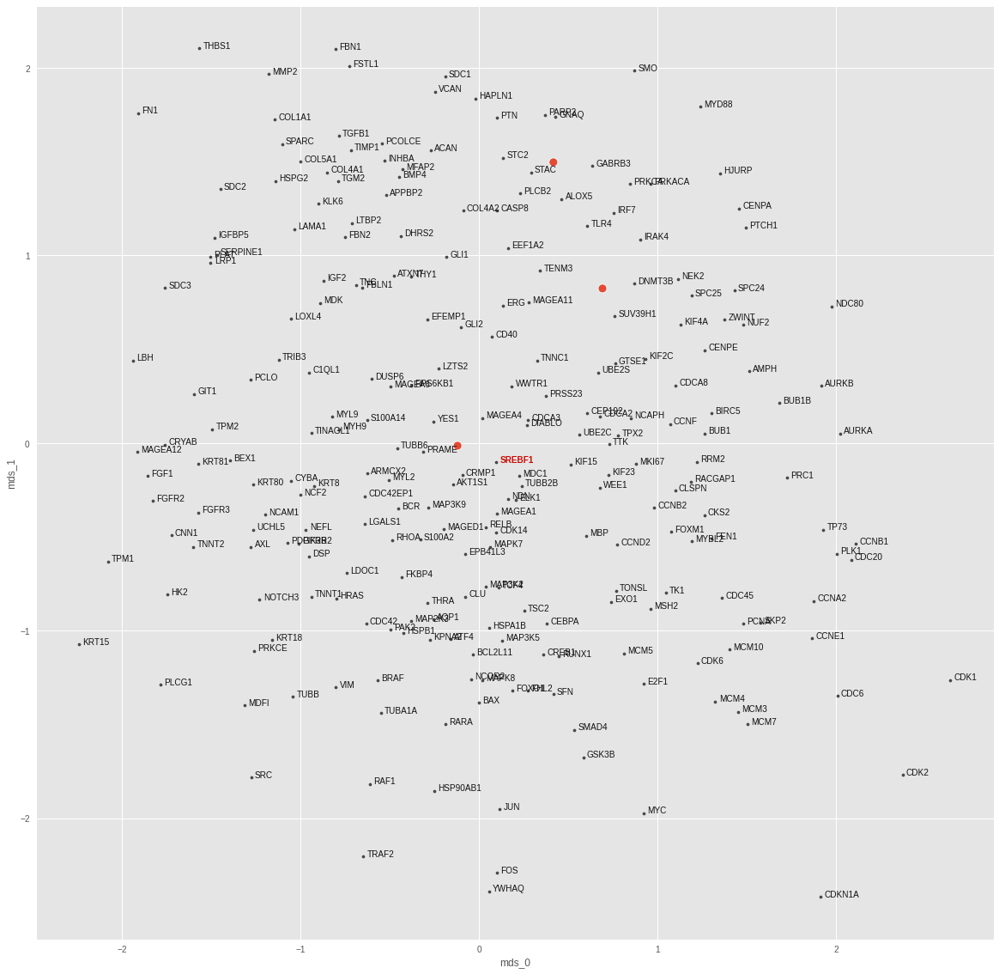

TRAF2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00015848735347390175
train top-k accuracies: {1: 0.894737, 3: 0.947368, 5: 0.973684, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 0.973684, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.006670681294053793
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


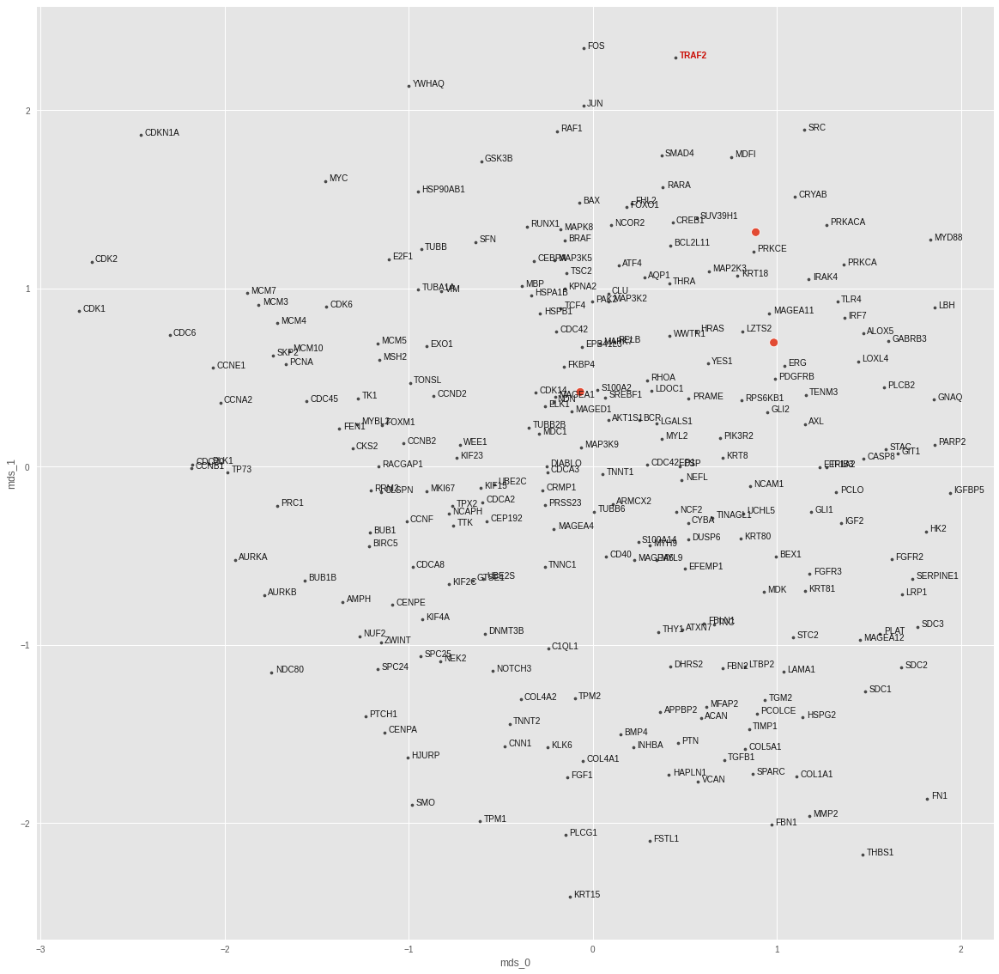

TSC2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017811231373343617
train top-k accuracies: {1: 0.877193, 3: 0.929825, 5: 0.964912, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.006189833395183086
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.333333, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


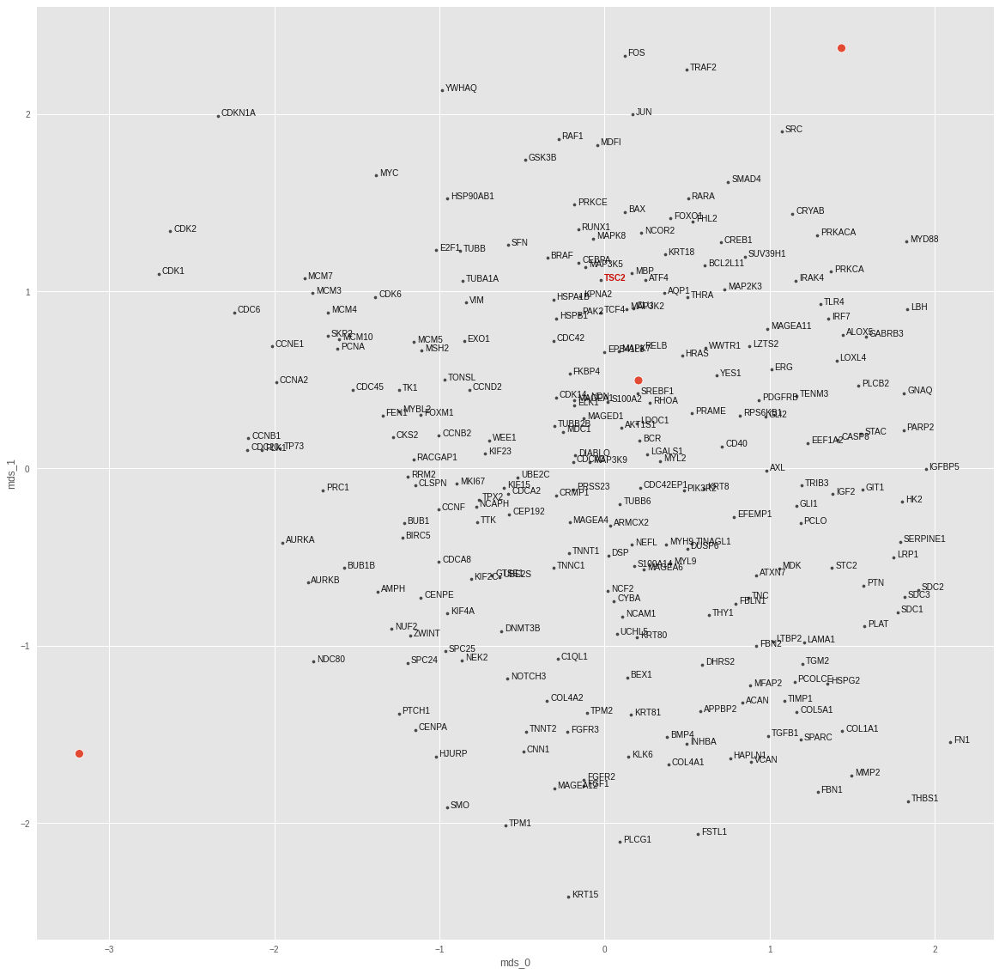

WWTR1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017189327627420425
train top-k accuracies: {1: 0.894737, 3: 0.929825, 5: 0.947368, 10: 0.973684, 20: 0.991228, 50: 1.0}
train mean top-k accuracies: {1: 0.921053, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004624707158654928
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


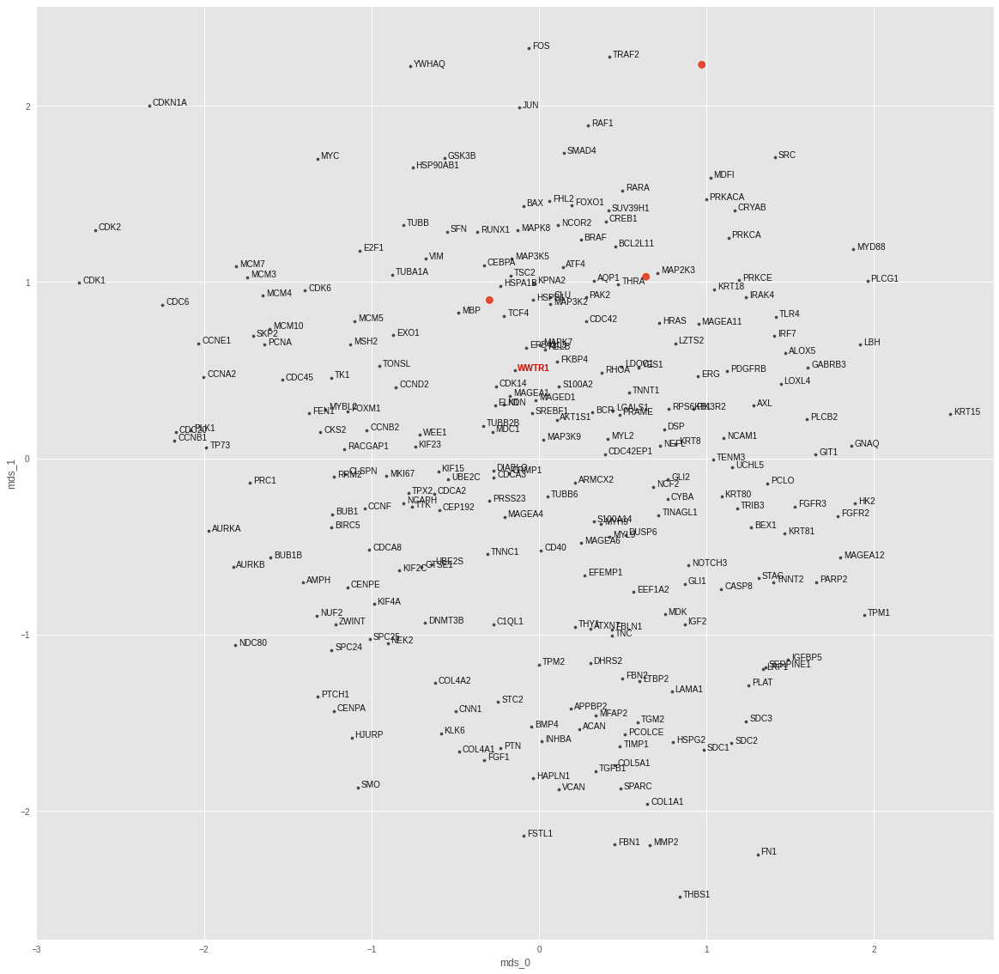

<IPython.core.display.Javascript object>

In [115]:
target_topk_accs = {}
cl_lin_nns_dict = {}
for i in tqdm(range(len(cl_data_dicts))):
    data_dict = cl_data_dicts[i]
    model = torch.nn.Sequential(torch.nn.Linear(1024, 1024))
    optimizer = Adam(model.parameters(), lr=1e-3)
    criterion = torch.nn.MSELoss()
    target = sorted(list(shared_targets))[i]
    print(target)
    fitted_model, _, mean_topk_acc, mean_knns = train_model_topk_acc(
        model=model,
        data_dict=data_dict,
        optimizer=optimizer,
        criterion=criterion,
        n_epochs=1000,
        early_stopping=1000,
        nn_clf=nn_clf,
        log_epochs=False,
    )
    target_topk_accs[target] = mean_topk_acc
    cl_lin_nns_dict[target] = mean_knns[0]
    fig, ax, _ = plot_translation(
        fitted_model.to("cpu"),
        data_dict["test"].dataset,
        node_embs,
        figsize=[20, 20],
        crop=False,
        highlight_target=target,
        pred_size=100,
        reg_size=10,
    )
    ax.get_legend().remove()
    plt.show()
    plt.close()

In [116]:
cl_lin_topk_df = pd.DataFrame(target_topk_accs).transpose()
cl_lin_topk_df.loc[cl_lin_topk_df.loc[:, 50] > 0].sort_values(
    [1, 3, 5, 10, 20, 50], ascending=False
)

,1,3,5,10,20,50
AKT1S1,1.0,1.0,1.0,1.0,1.0,1.0
MAP3K5,0.0,1.0,1.0,1.0,1.0,1.0
SREBF1,0.0,0.0,1.0,1.0,1.0,1.0
BRAF,0.0,0.0,0.0,1.0,1.0,1.0
MAPK7,0.0,0.0,0.0,1.0,1.0,1.0
ATF4,0.0,0.0,0.0,0.0,1.0,1.0
CDC42,0.0,0.0,0.0,0.0,1.0,1.0
MAP3K2,0.0,0.0,0.0,0.0,1.0,1.0
PIK3R2,0.0,0.0,0.0,0.0,1.0,1.0
RHOA,0.0,0.0,0.0,0.0,1.0,1.0


<IPython.core.display.Javascript object>

In [117]:
cl_lin_topk_df.describe()

,1,3,5,10,20,50
count,39.000000,39.000000,39.000000,39.000000,39.000000,39.000000
mean,0.025641,0.051282,0.076923,0.128205,0.256410,0.512821
std,0.160128,0.223456,0.269953,0.338688,0.442359,0.506370
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,0.000000,0.000000,0.000000,0.000000,0.500000,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


<IPython.core.display.Javascript object>

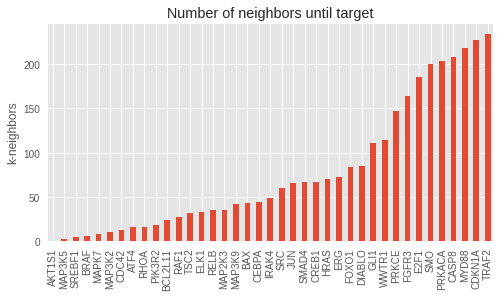

<IPython.core.display.Javascript object>

In [118]:
mpl.style.use("ggplot")
cl_lin_khits = get_knn_hit_data(cl_lin_nns_dict)
ax = cl_lin_khits.knn_hit.sort_values().plot(kind="bar", figsize=[8, 4])
ax.set_ylabel("k-neighbors")
ax.set_title("Number of neighbors until target")
plt.show()

In [119]:
cl_img_embs, _, cl_labels = cl_img_node_embs_dict["fold0"]
centroid_5nn_dict = get_centroid_knn_dict(cl_img_embs, cl_labels, k=5)
centroid_5nn_dict["ELK1"]

['MAP3K9', 'SMAD4', 'E2F1', 'PRKACA', 'ATF4']

<IPython.core.display.Javascript object>

In [120]:
cl_lin_nns_dict["ELK1"][:5]

array(['MAP3K5', 'CEBPA', 'TSC2', 'MBP', 'GSK3B'], dtype='<U8')

<IPython.core.display.Javascript object>

---

### 3.6. Non-linear 3-centroids mapping

  0%|          | 0/39 [00:00<?, ?it/s]

AKT1S1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 3.359226639076951e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.002016332233324647
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.666667, 20: 0.666667, 50: 1.0}
test mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


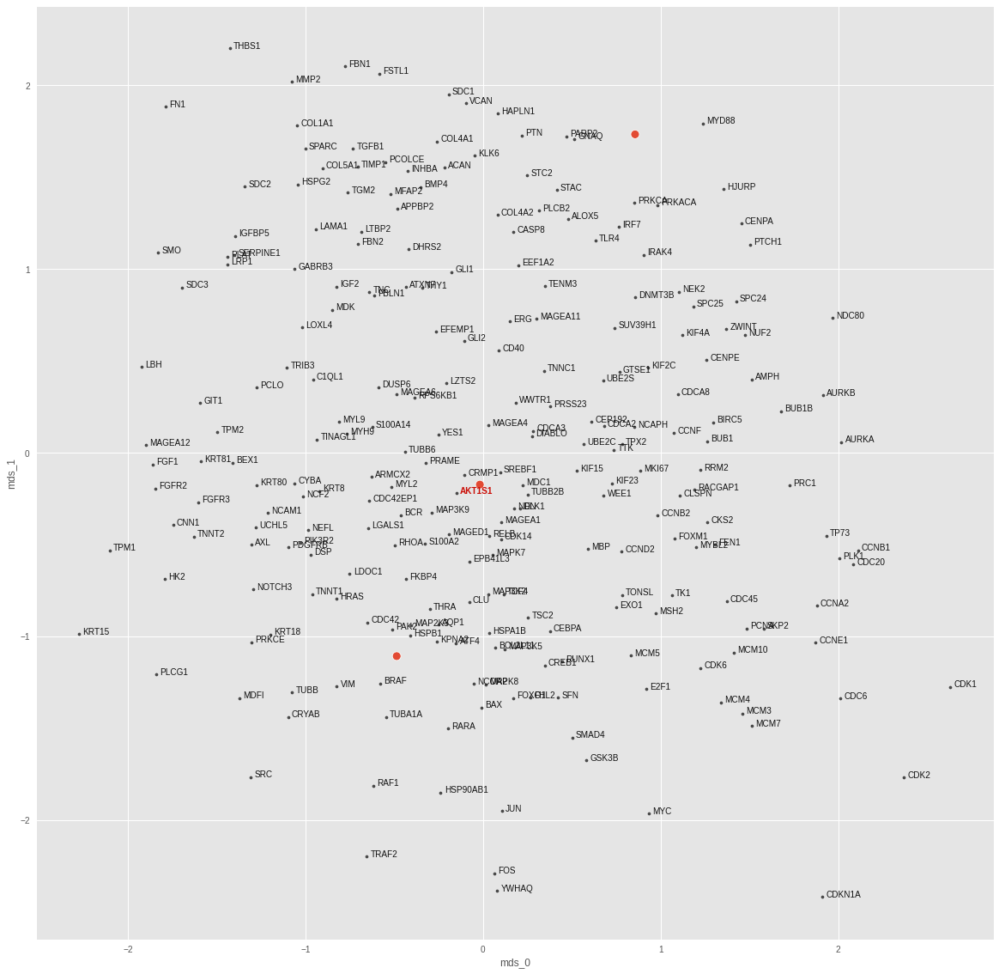

ATF4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.4485620997438673e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0018227091059088707
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


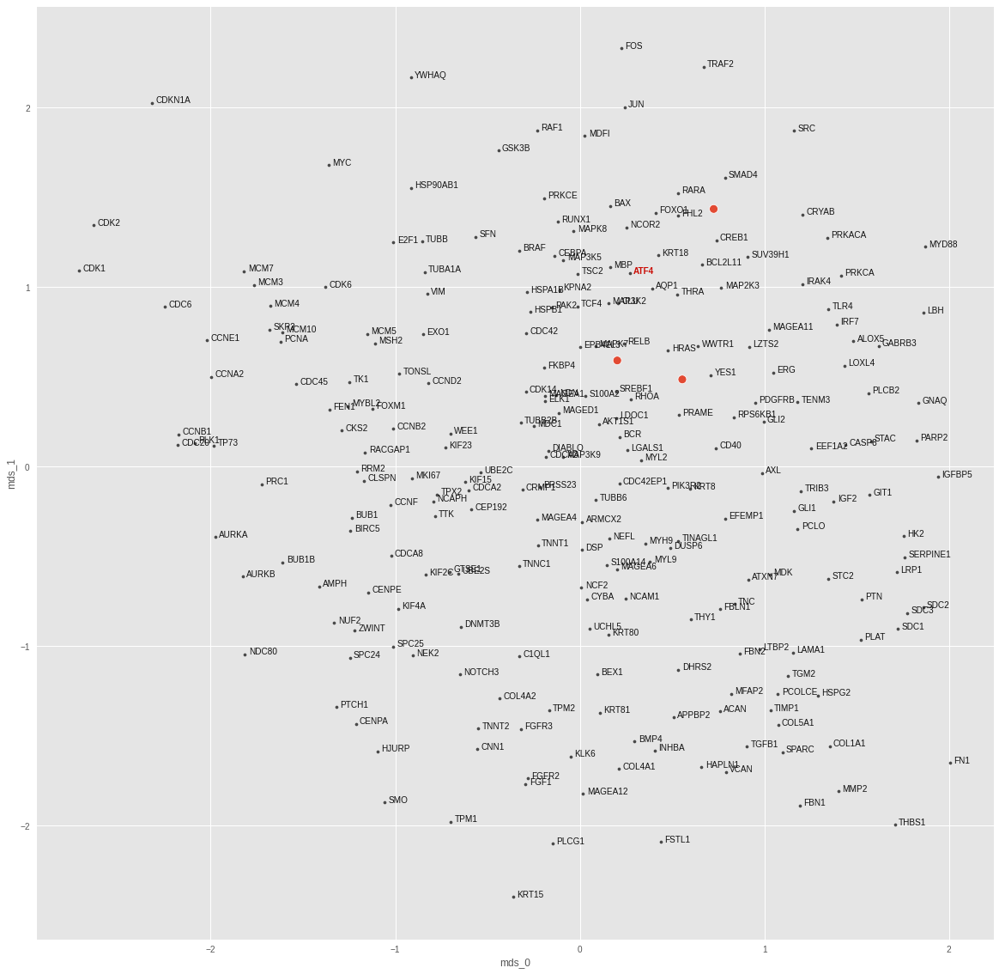

BAX
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.8886497602798045e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0023207850754261017
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


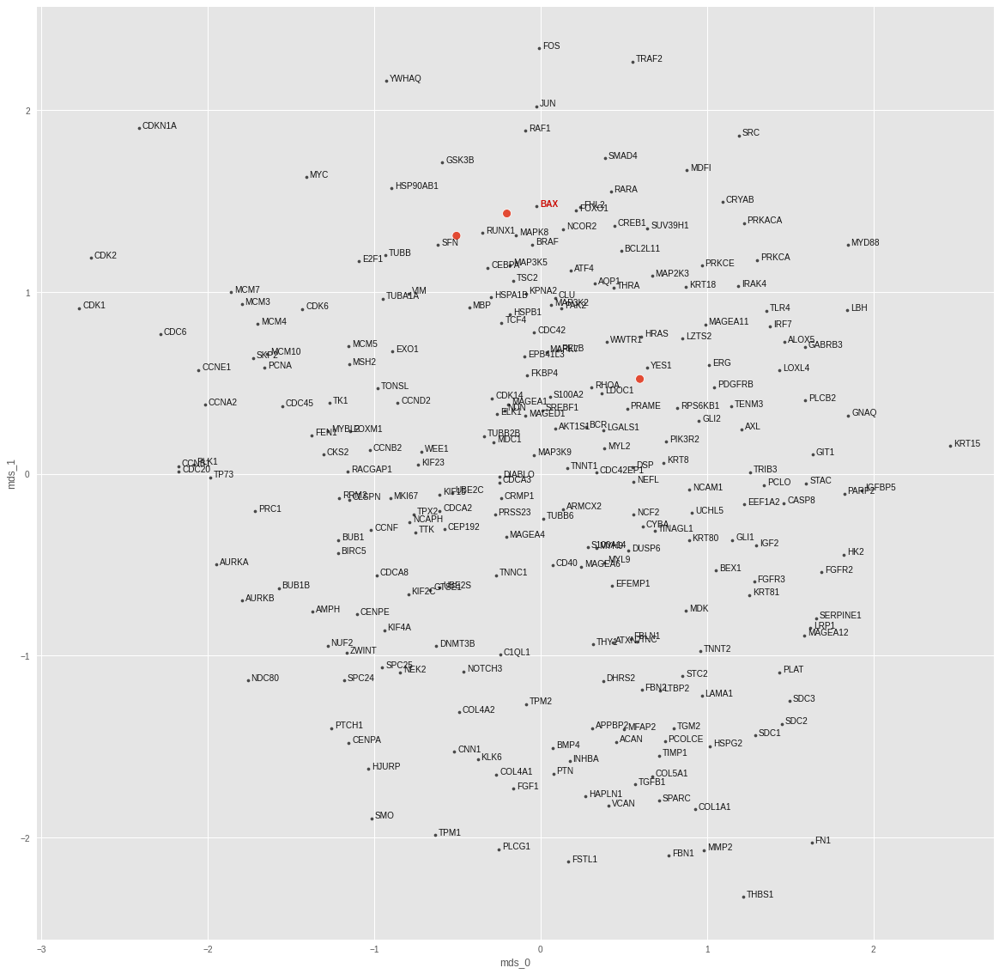

BCL2L11
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.375009898969438e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004734346177428961
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


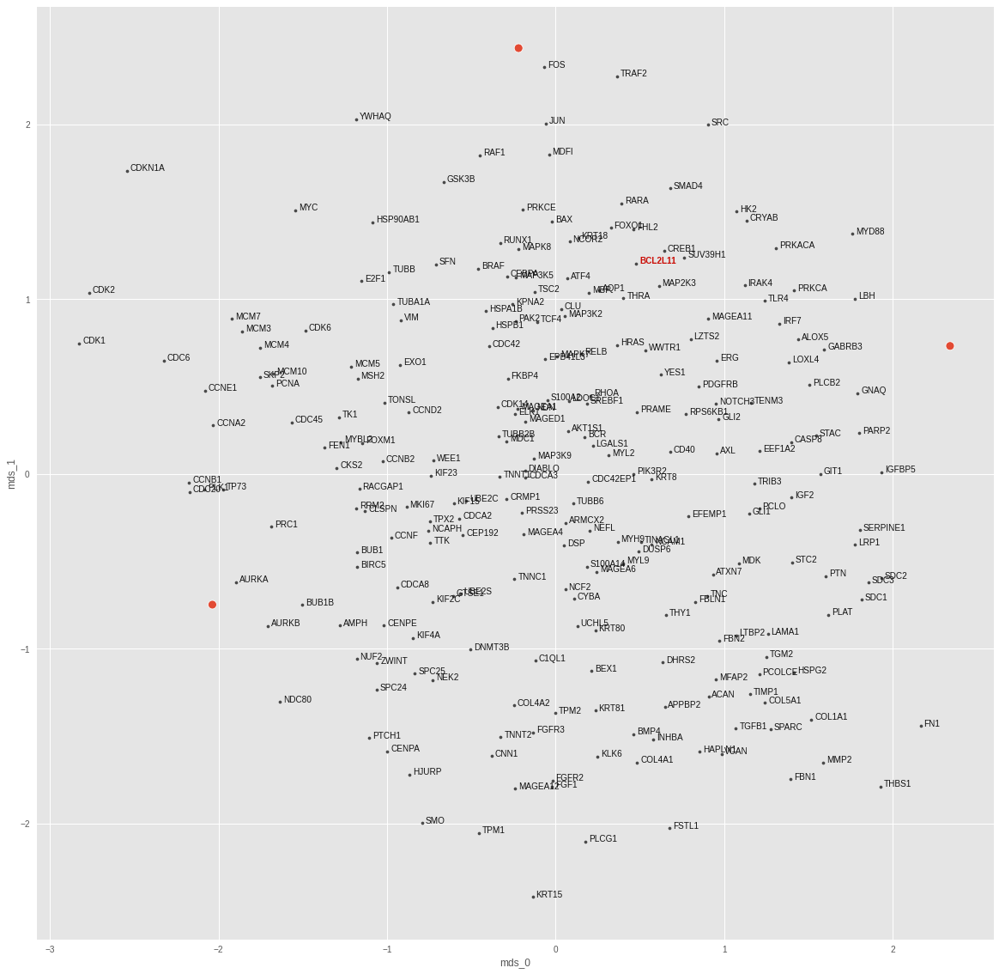

BRAF
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.1011160242778715e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0008305031806230545
test top-k accuracies: {1: 0.0, 3: 0.333333, 5: 0.333333, 10: 0.333333, 20: 0.666667, 50: 1.0}
test mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


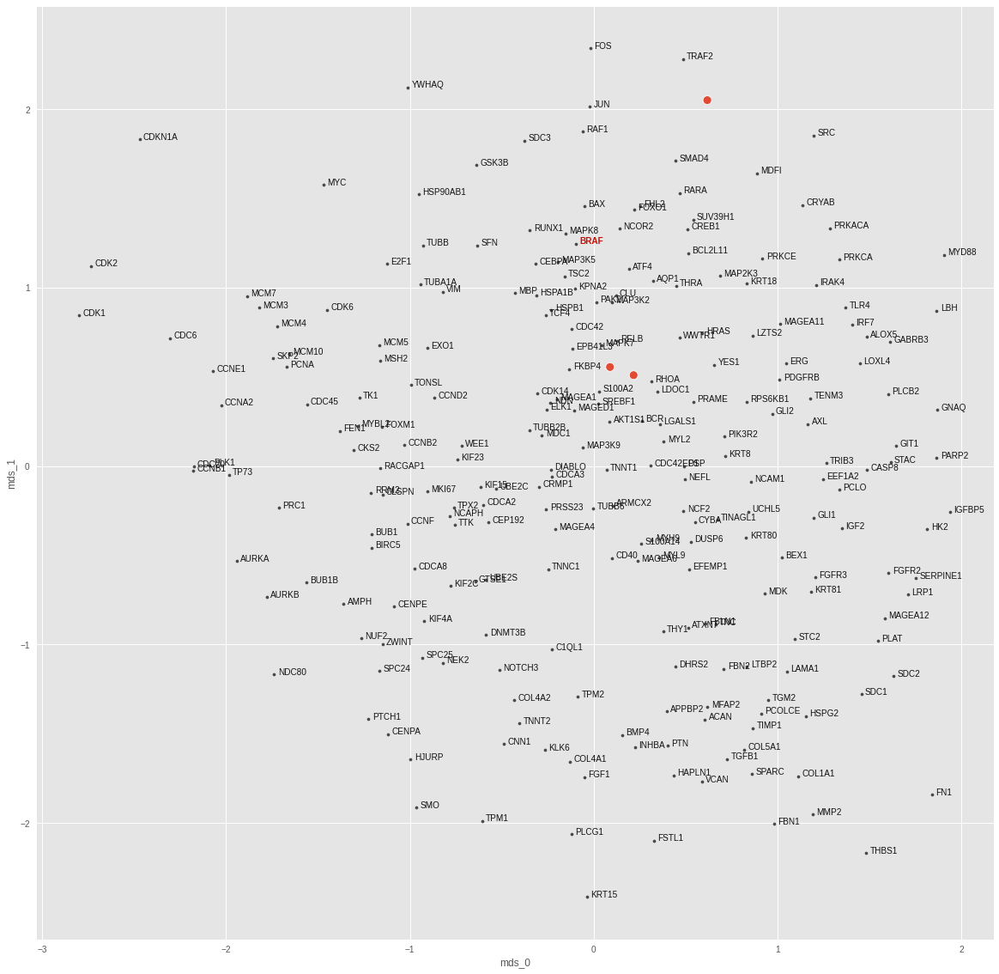

CASP8
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.836875867411436e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.006405341438949108
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


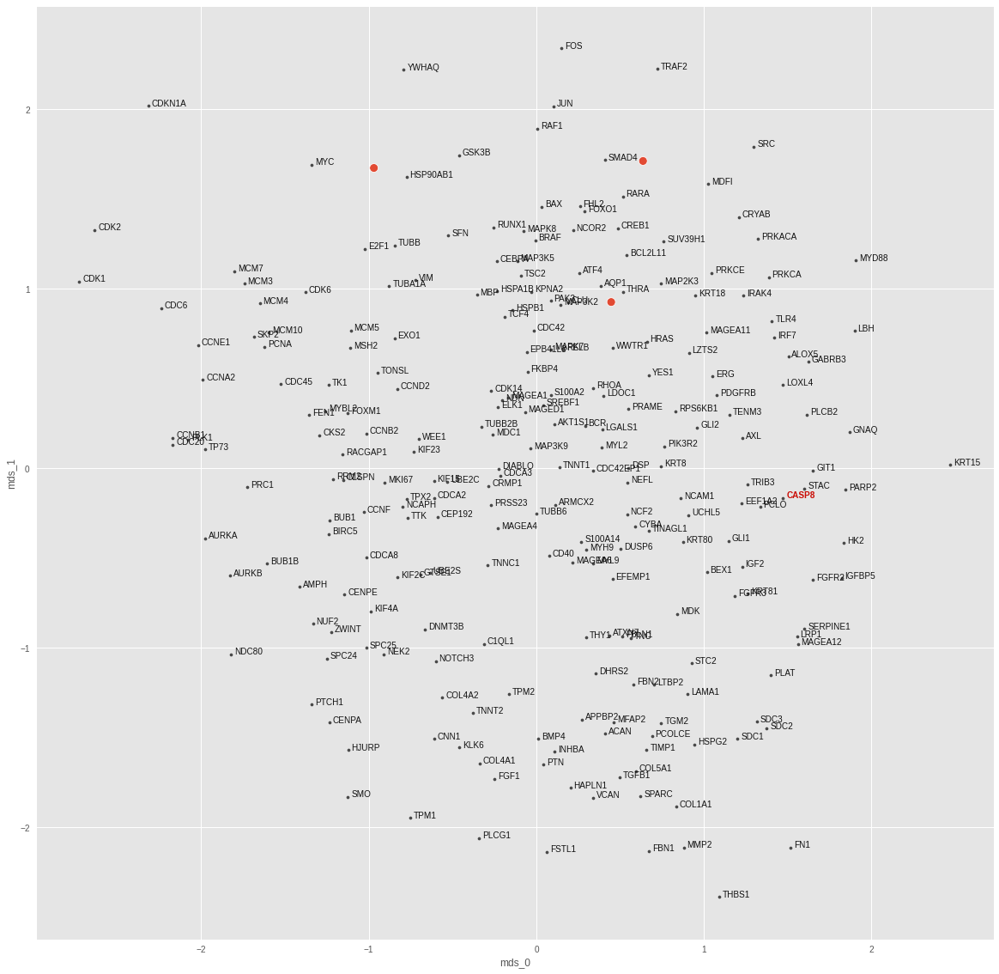

CDC42
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.534764234951581e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004463262390345335
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


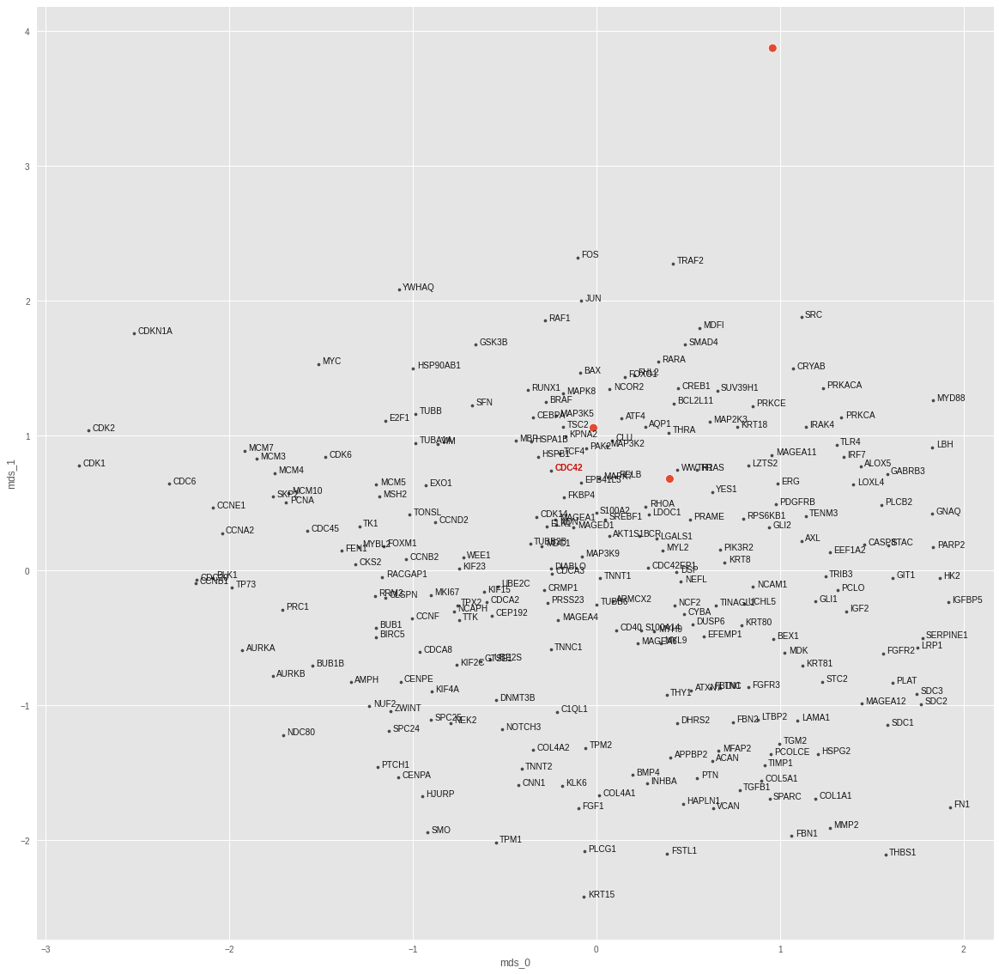

CDKN1A
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.961564976227237e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.00882614403963089
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


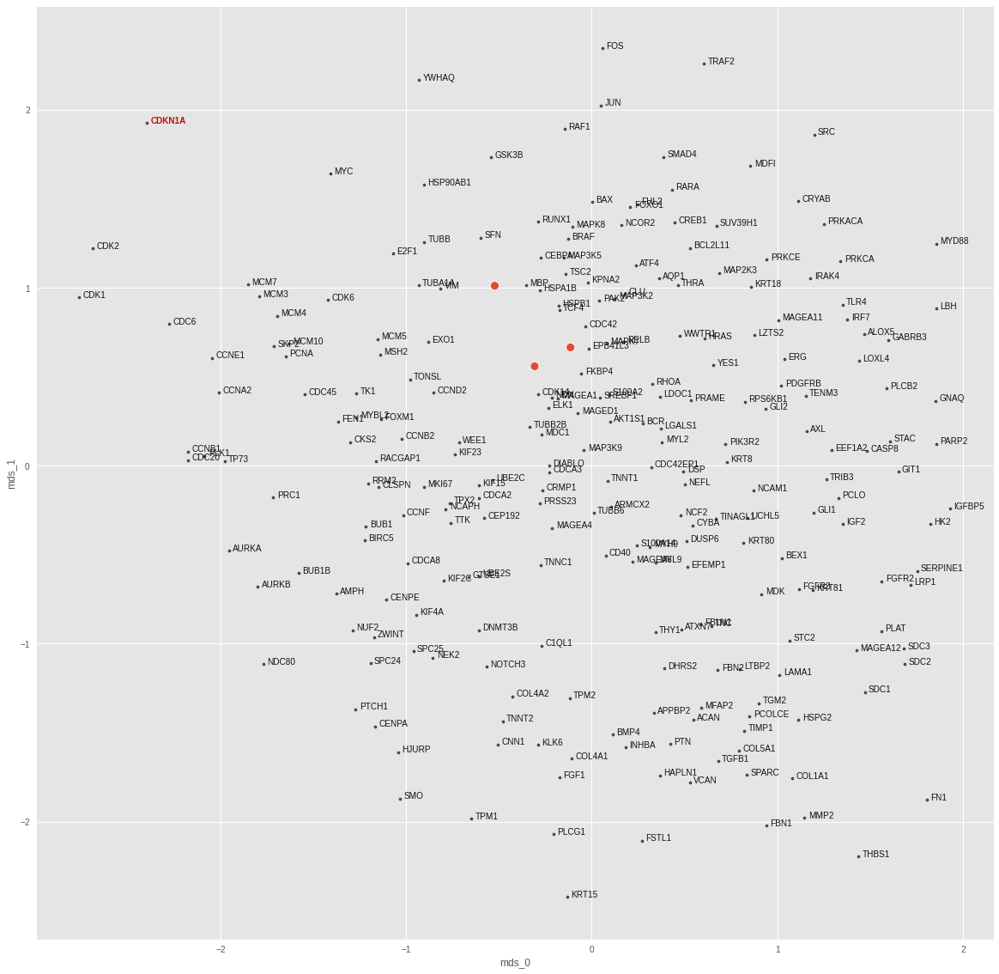

CEBPA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.3384595806419384e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.002386718988418579
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


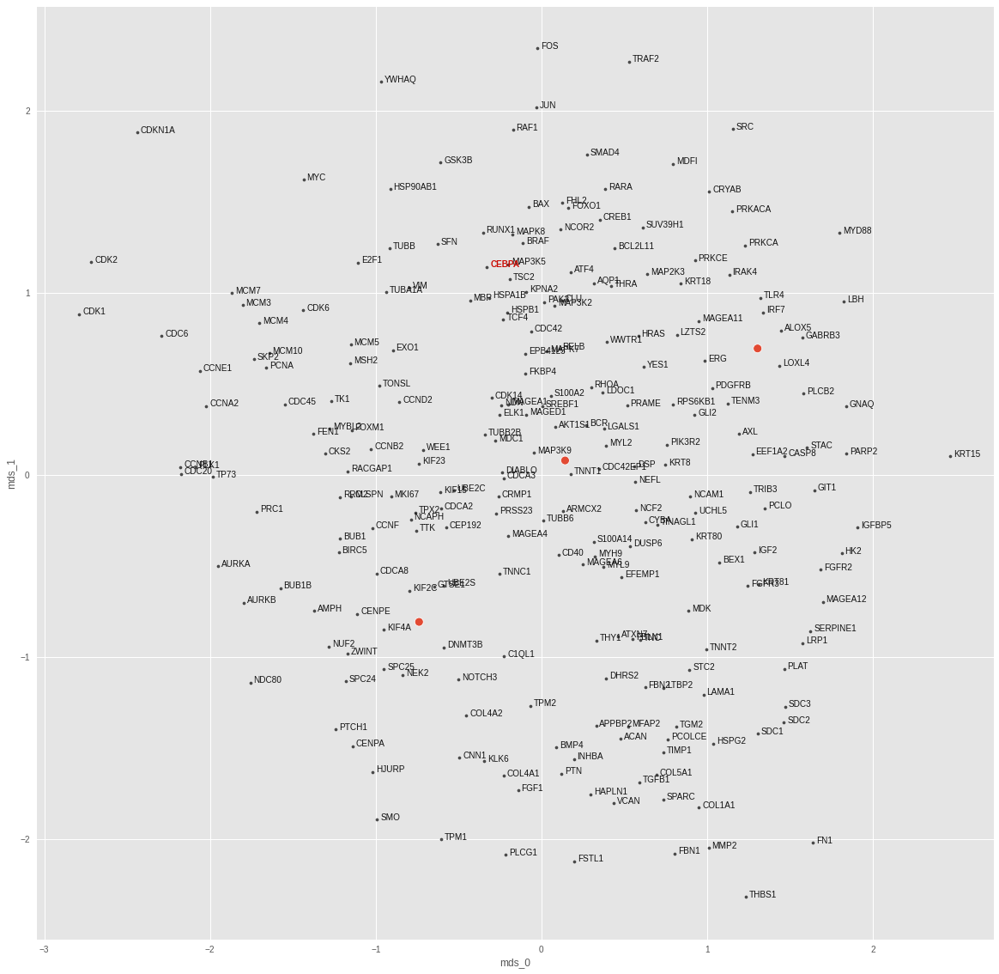

CREB1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.8463799733581254e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0017725214129313827
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.333333, 20: 0.333333, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


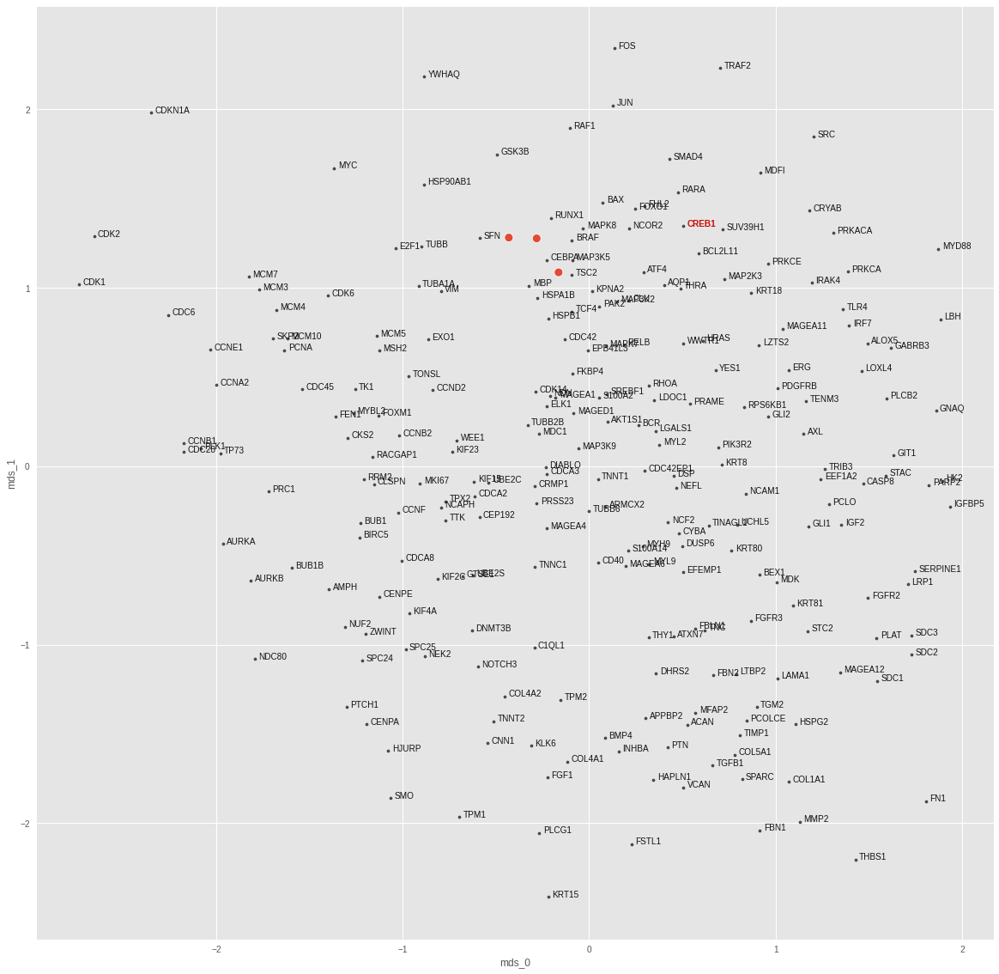

DIABLO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.7873984436155297e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.003337592352181673
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


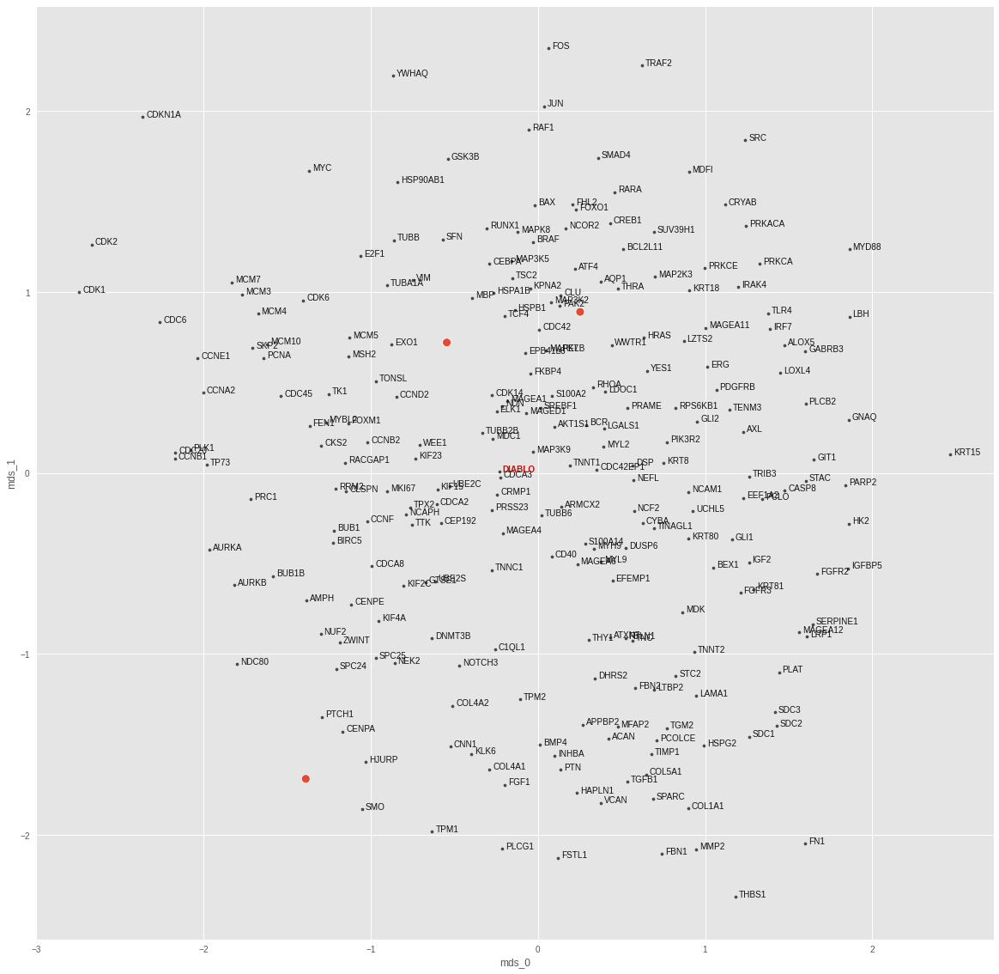

E2F1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.049442855422967e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.00936221331357956
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


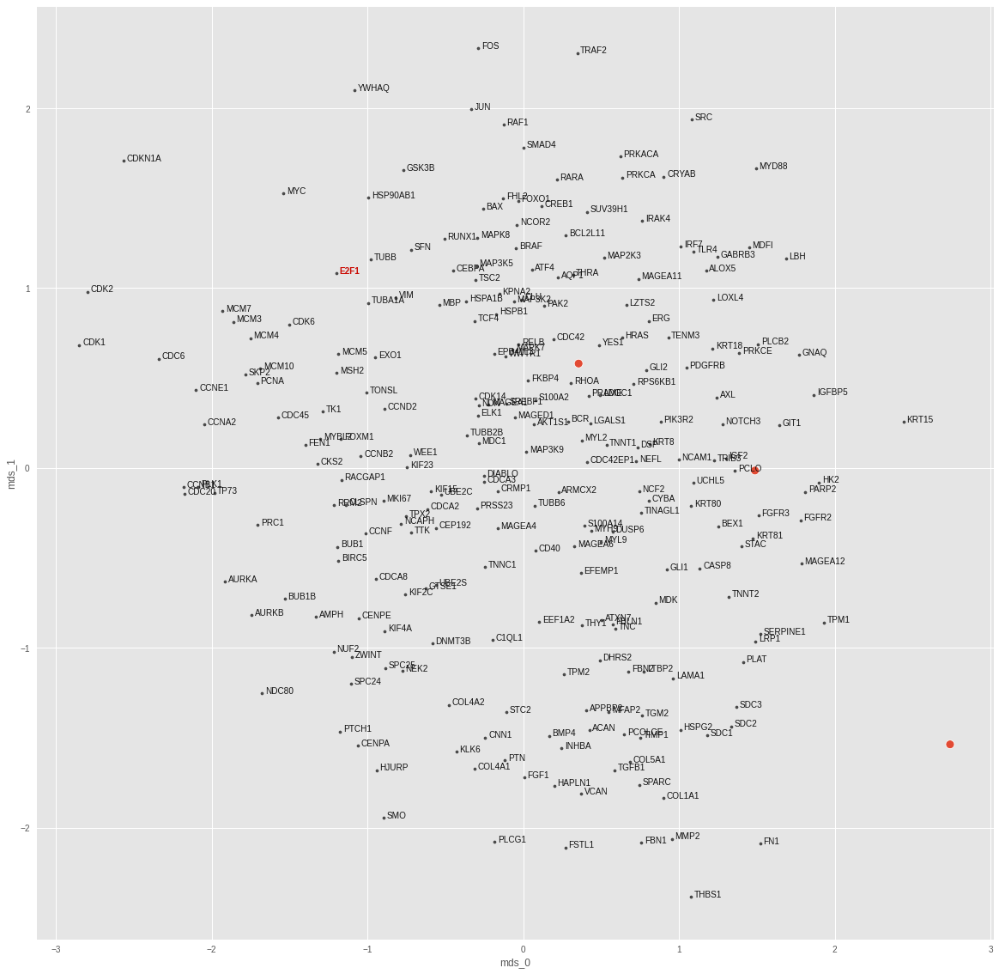

ELK1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.737880777203827e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0024408919271081686
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


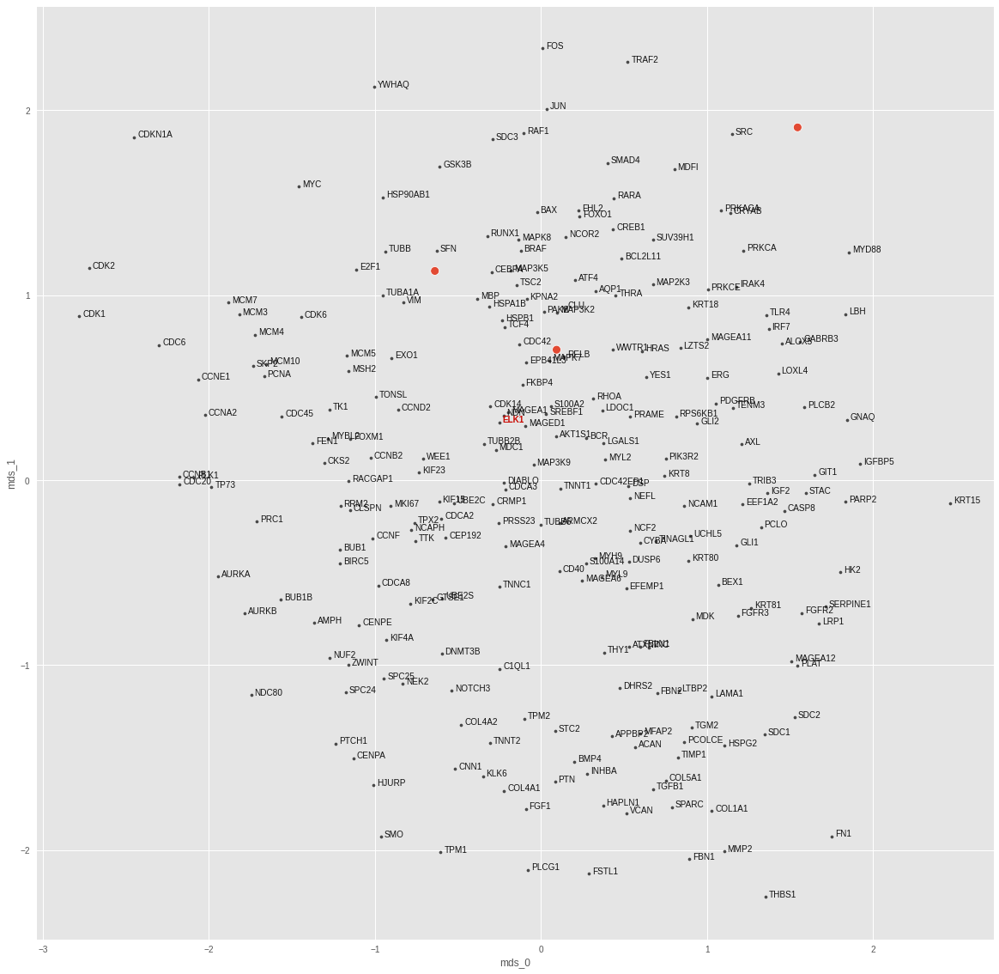

ERG
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.9442707070993492e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0025454768911004066
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


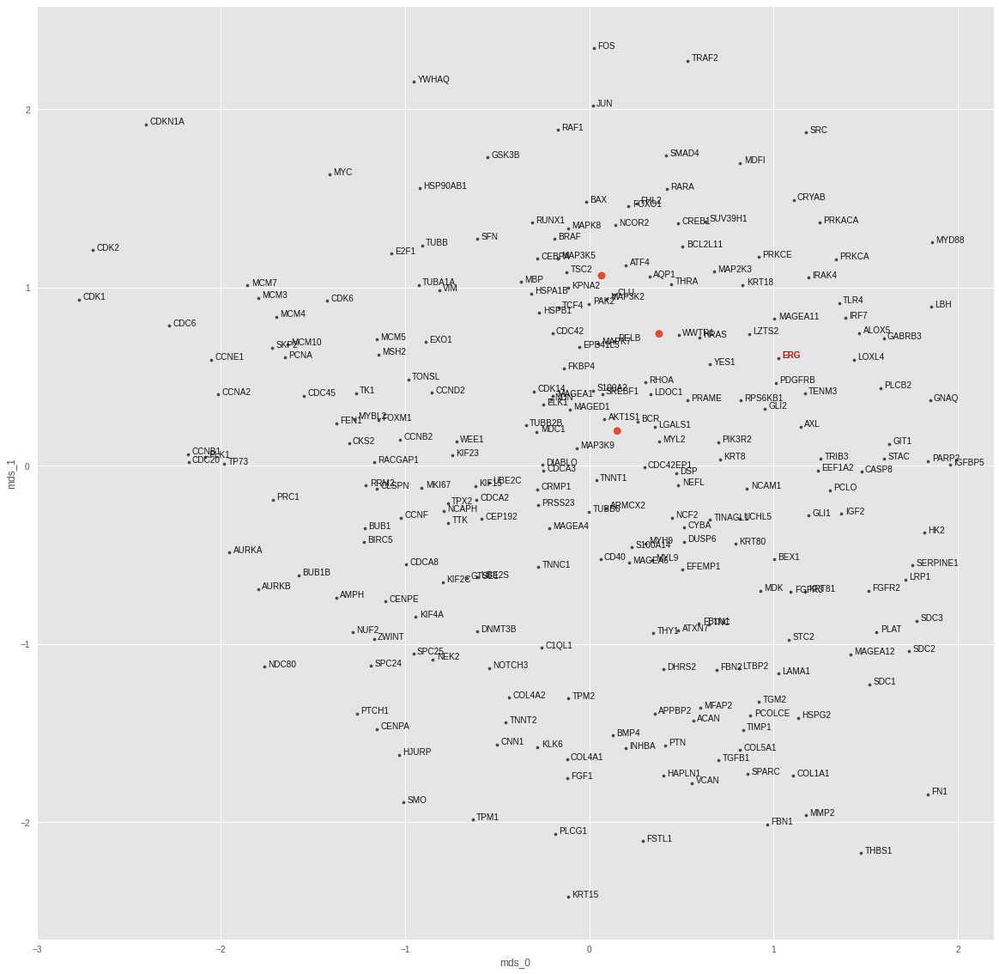

FGFR3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.223002184109646e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.003941143862903118
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


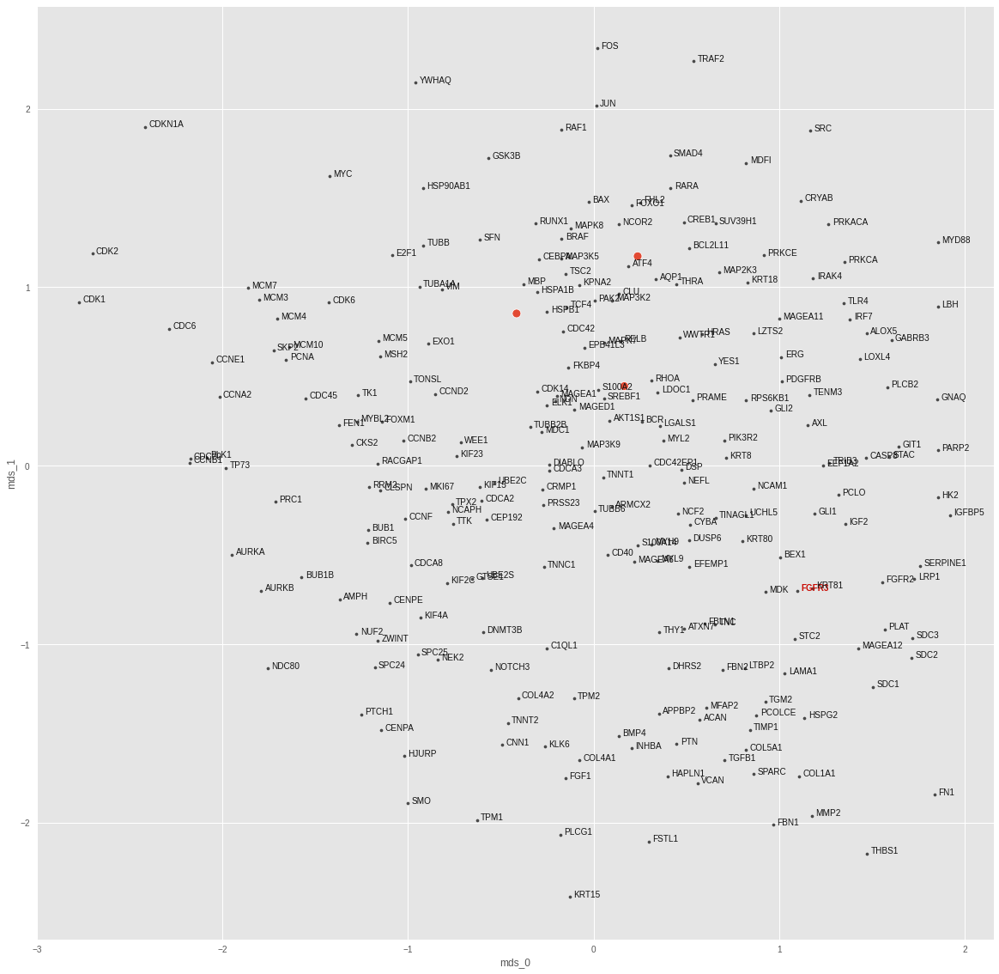

FOXO1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.7398267573298654e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0031835935078561306
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


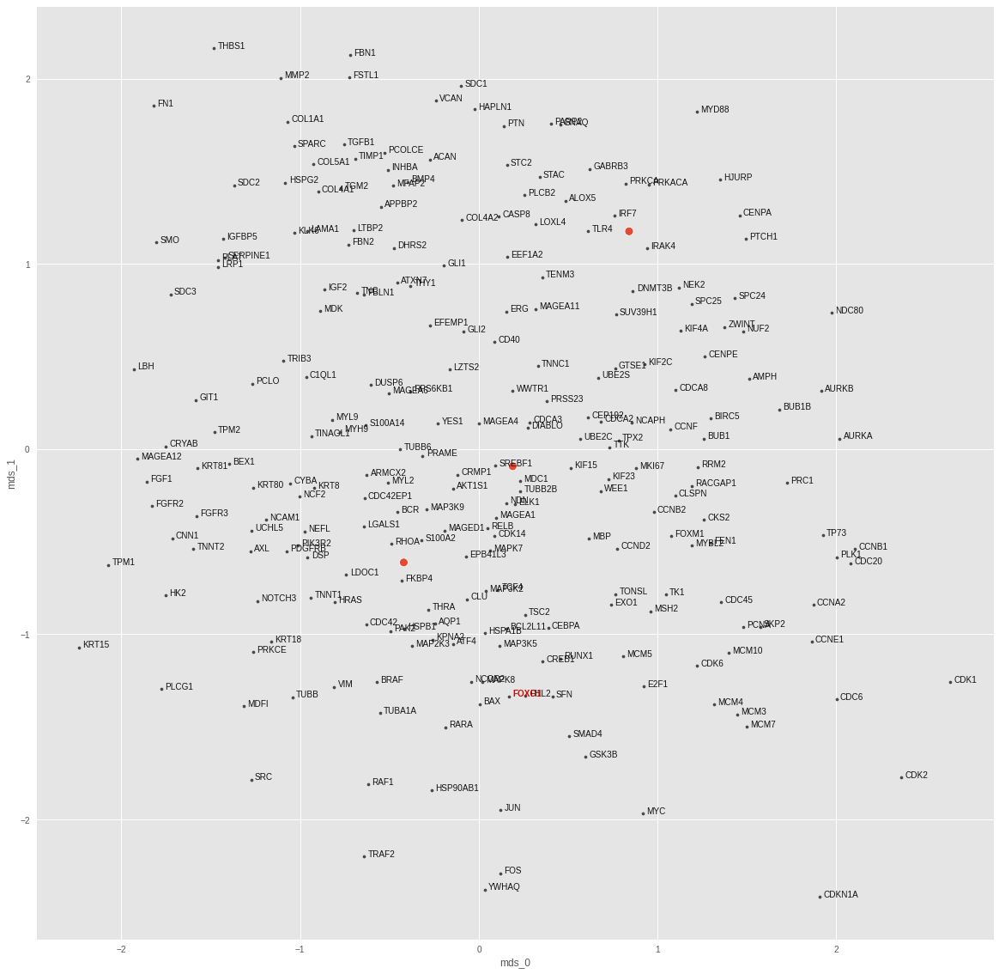

GLI1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.553299054852687e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0030363244004547596
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


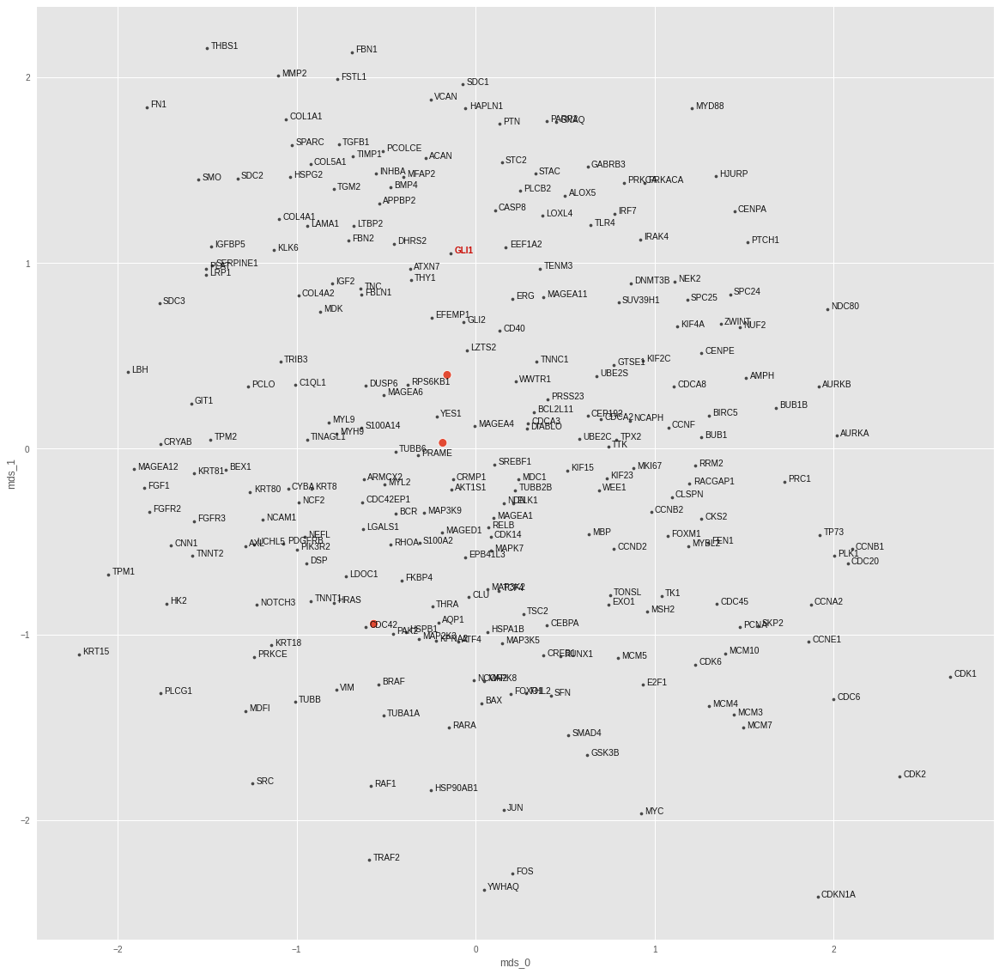

HRAS
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 3.430850938457297e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0022445986978709698
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


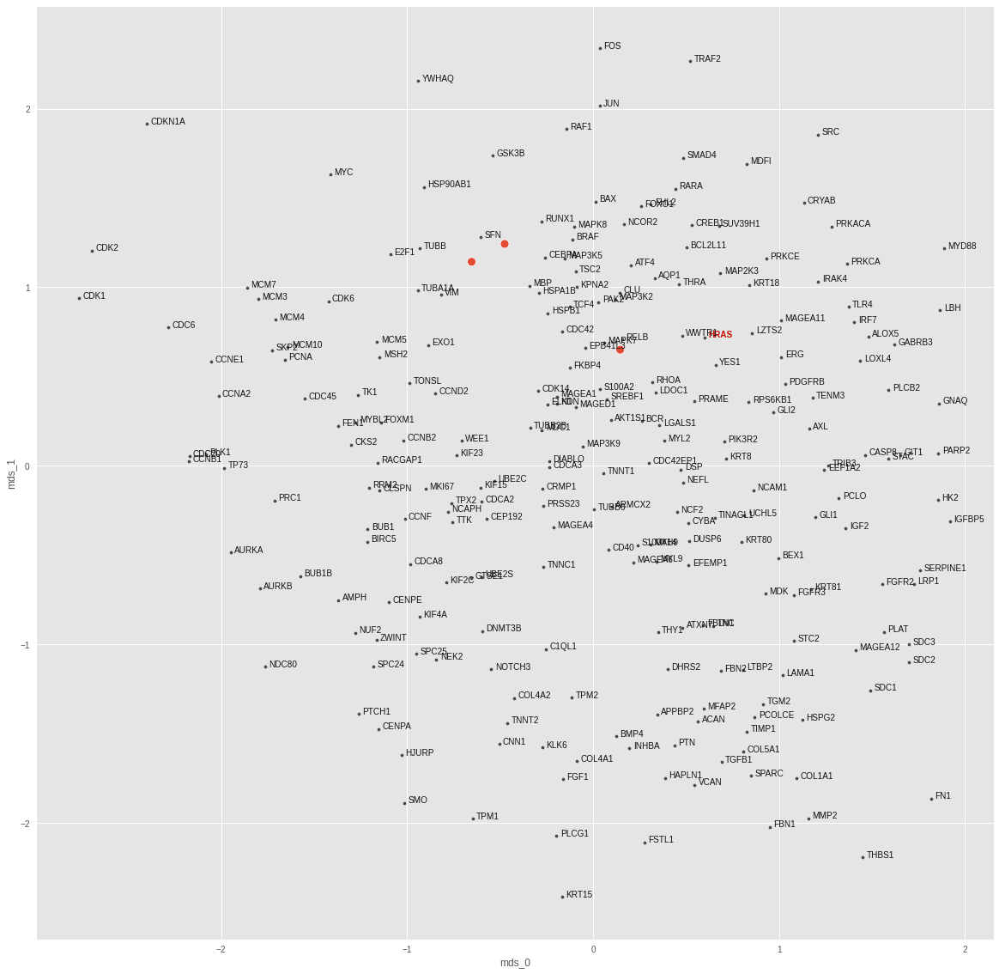

IRAK4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.0624258922907757e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0030114236287772655
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


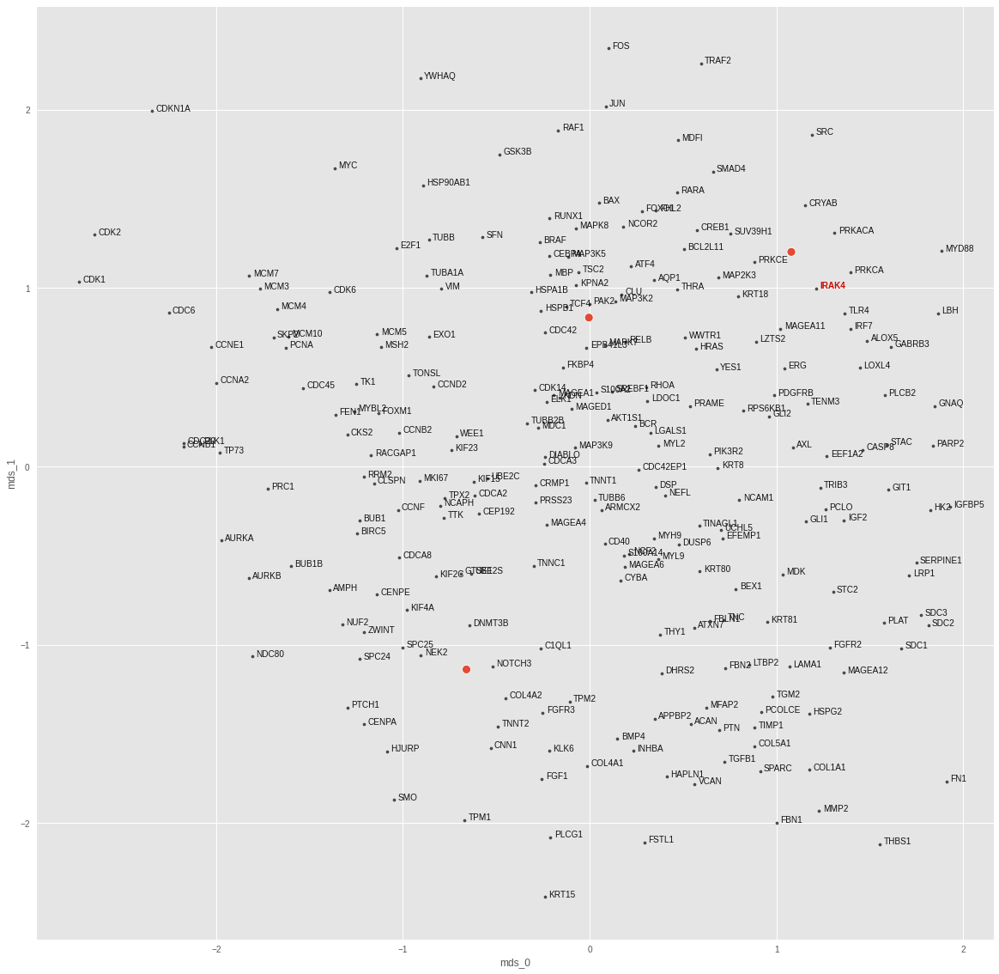

JUN
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.536382680773386e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0034774313680827618
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


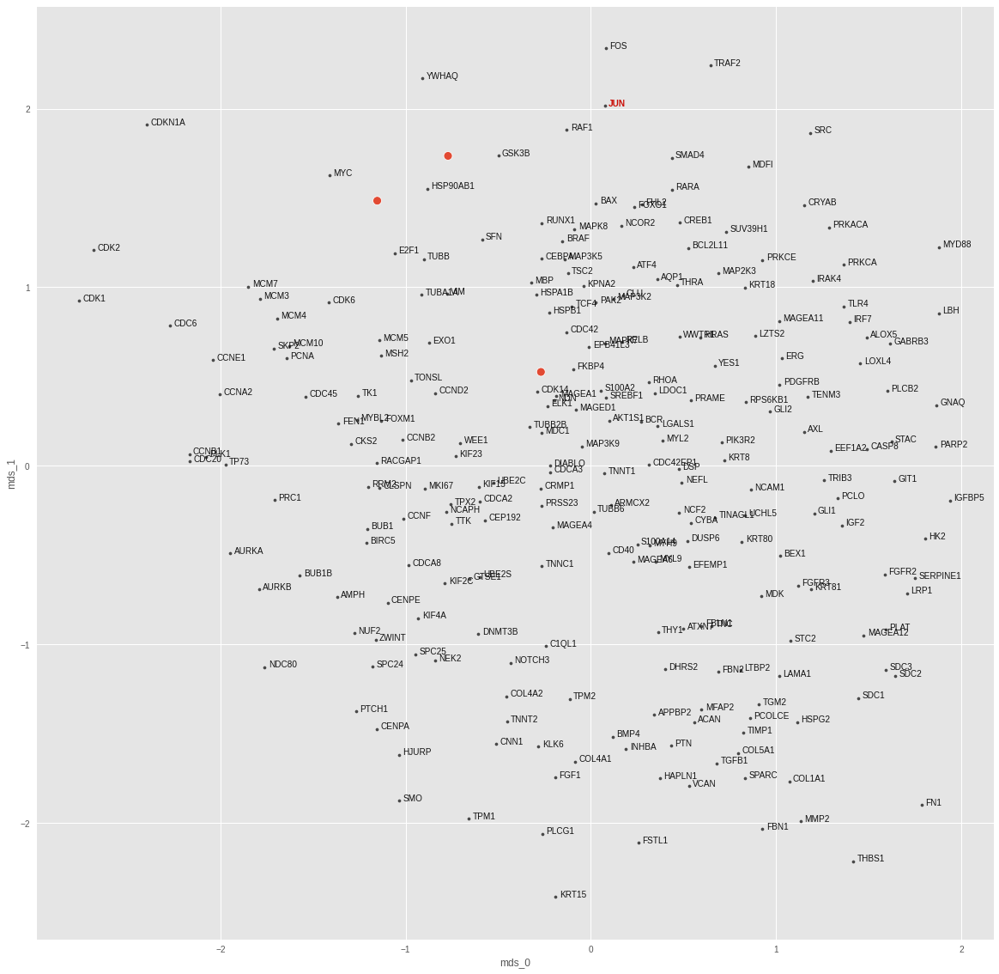

MAP2K3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.073733867291594e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.002172050764784217
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


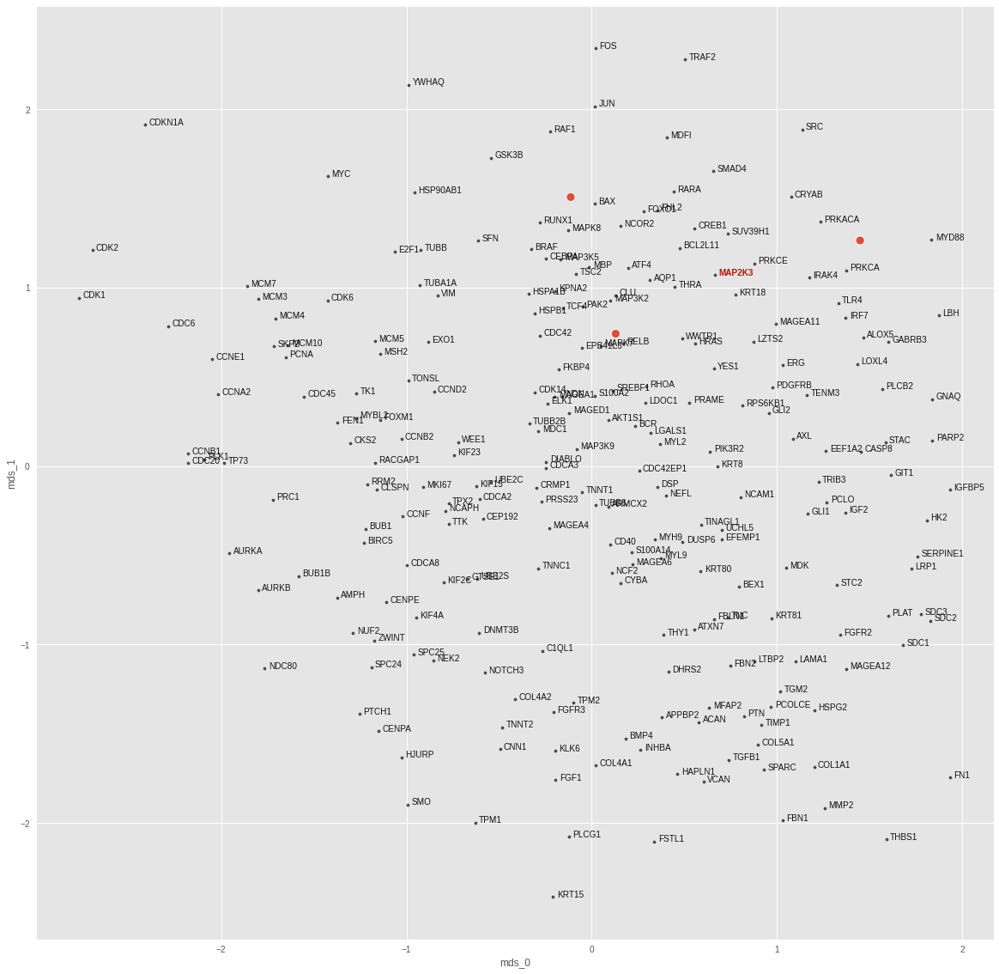

MAP3K2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.07923881134775e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0012255427427589893
test top-k accuracies: {1: 0.0, 3: 0.333333, 5: 0.333333, 10: 0.666667, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


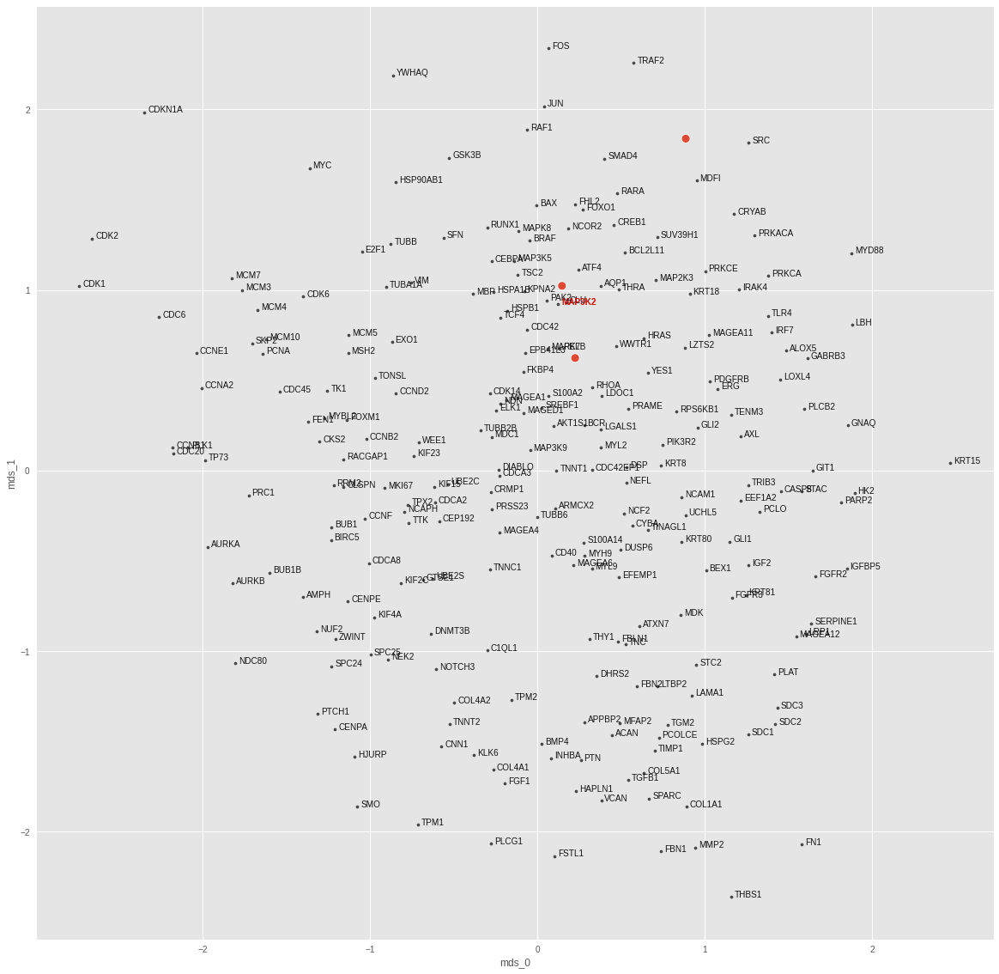

MAP3K5
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.3411564598063705e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0008966063032858074
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.333333, 10: 0.666667, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


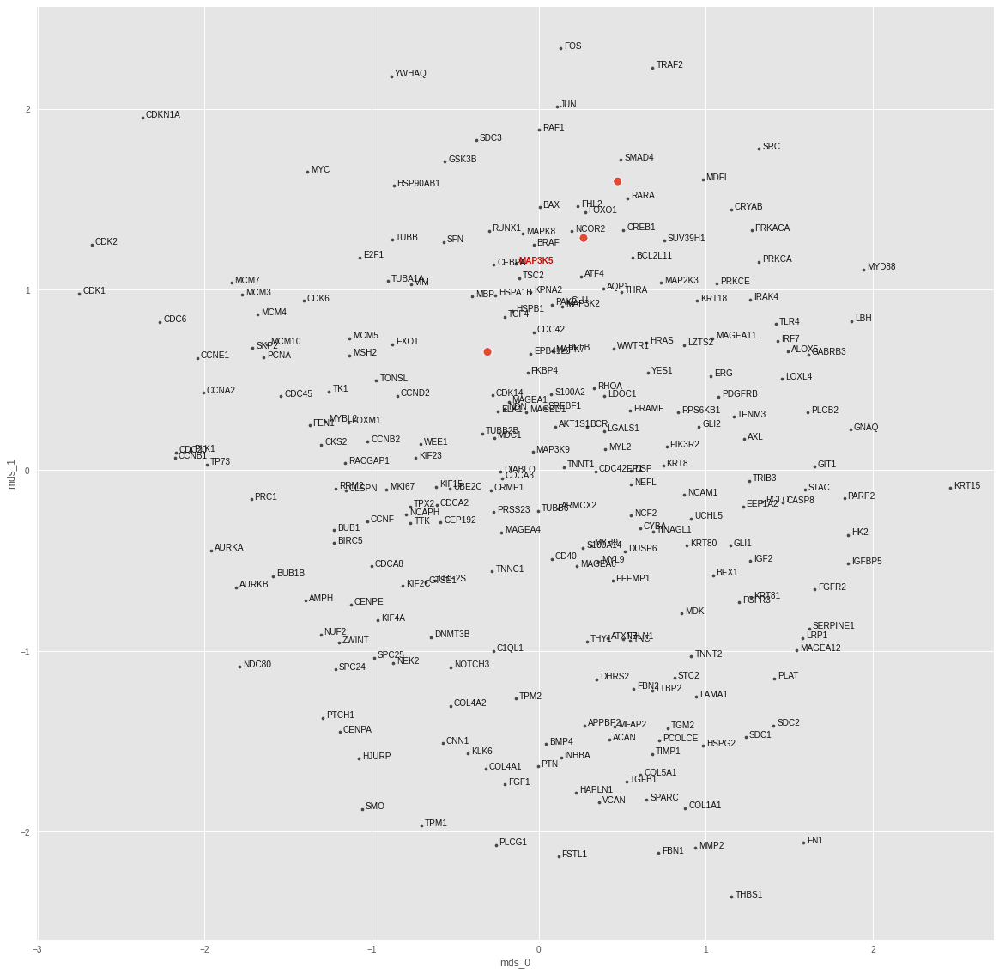

MAP3K9
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.501785274944268e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.00244345935061574
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


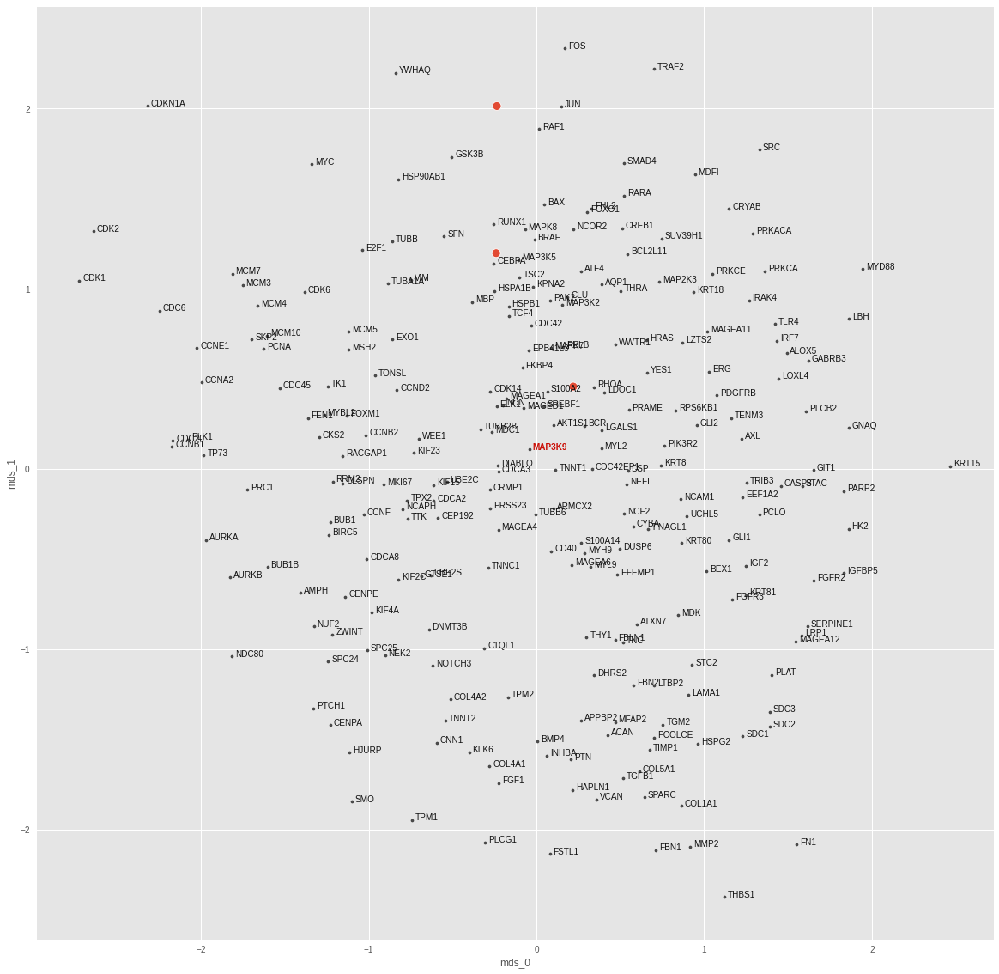

MAPK7
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.6251366307405988e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0010310681536793709
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.333333, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


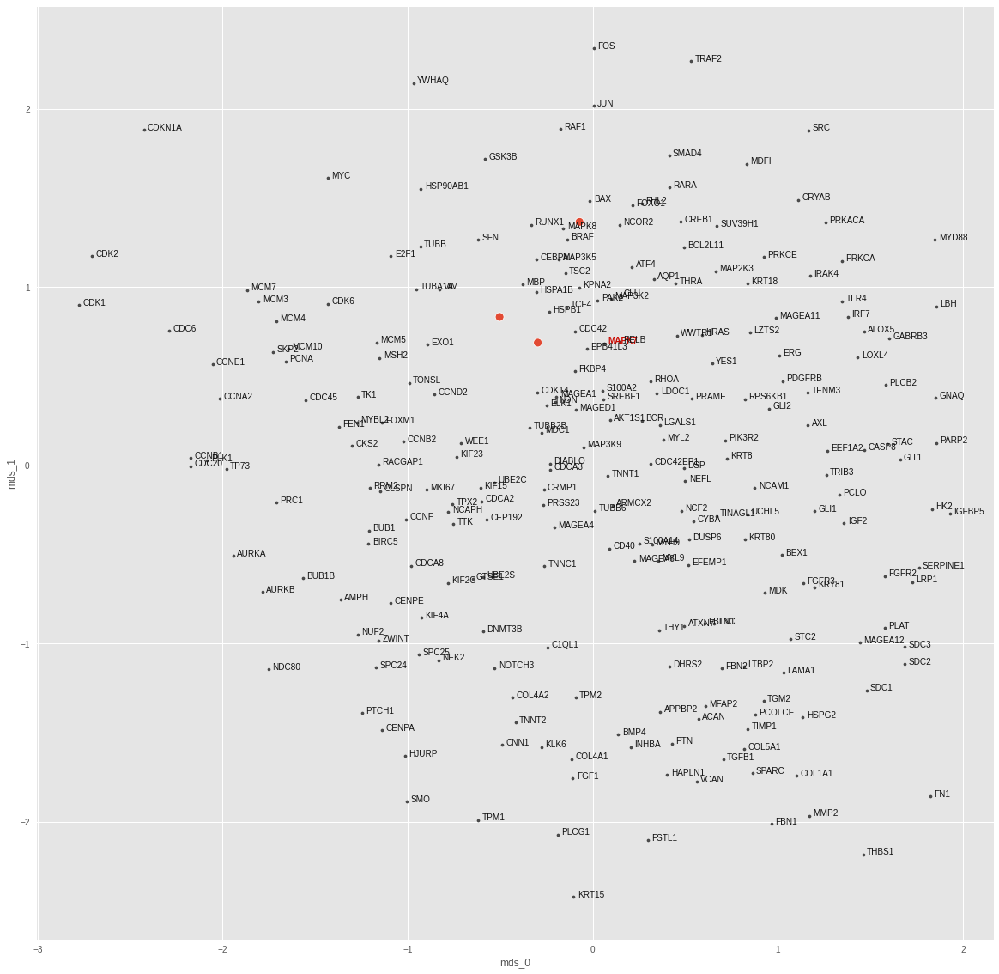

MYD88
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.0824390958296135e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.006785310804843903
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


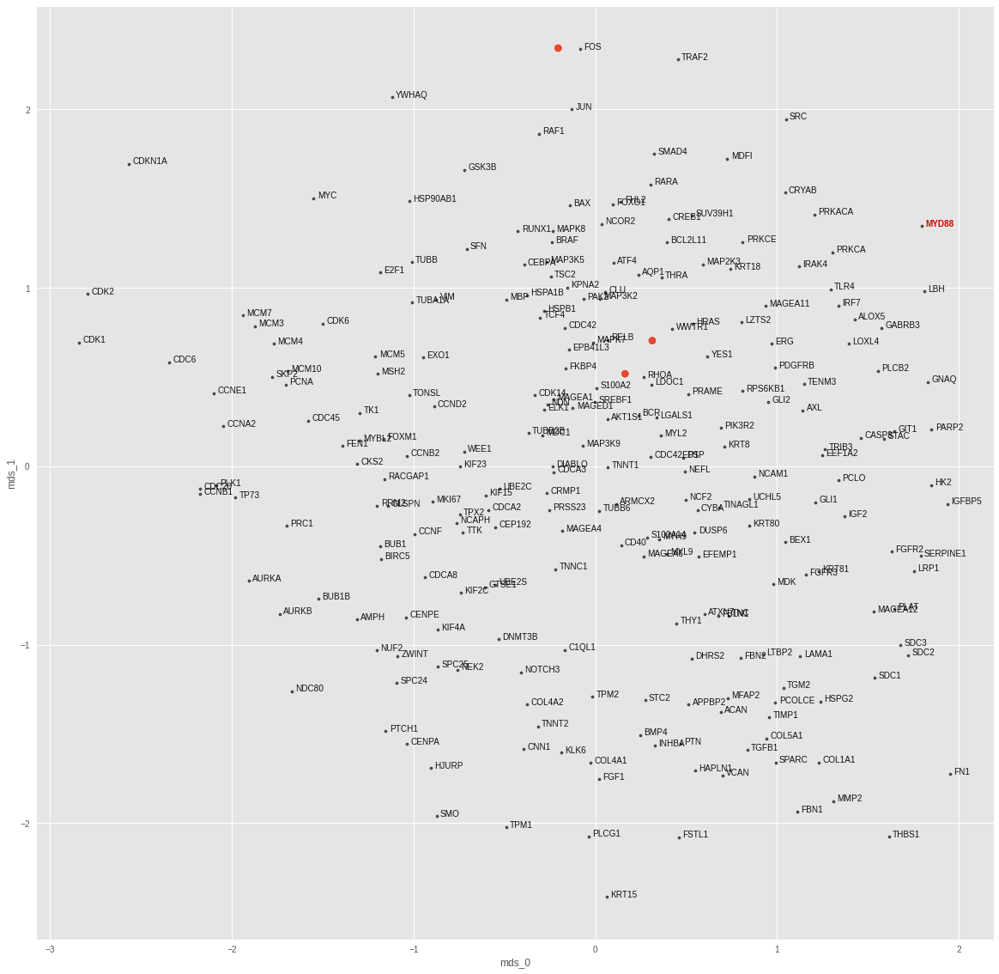

PIK3R2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.4006606054172153e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.002265515737235546
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


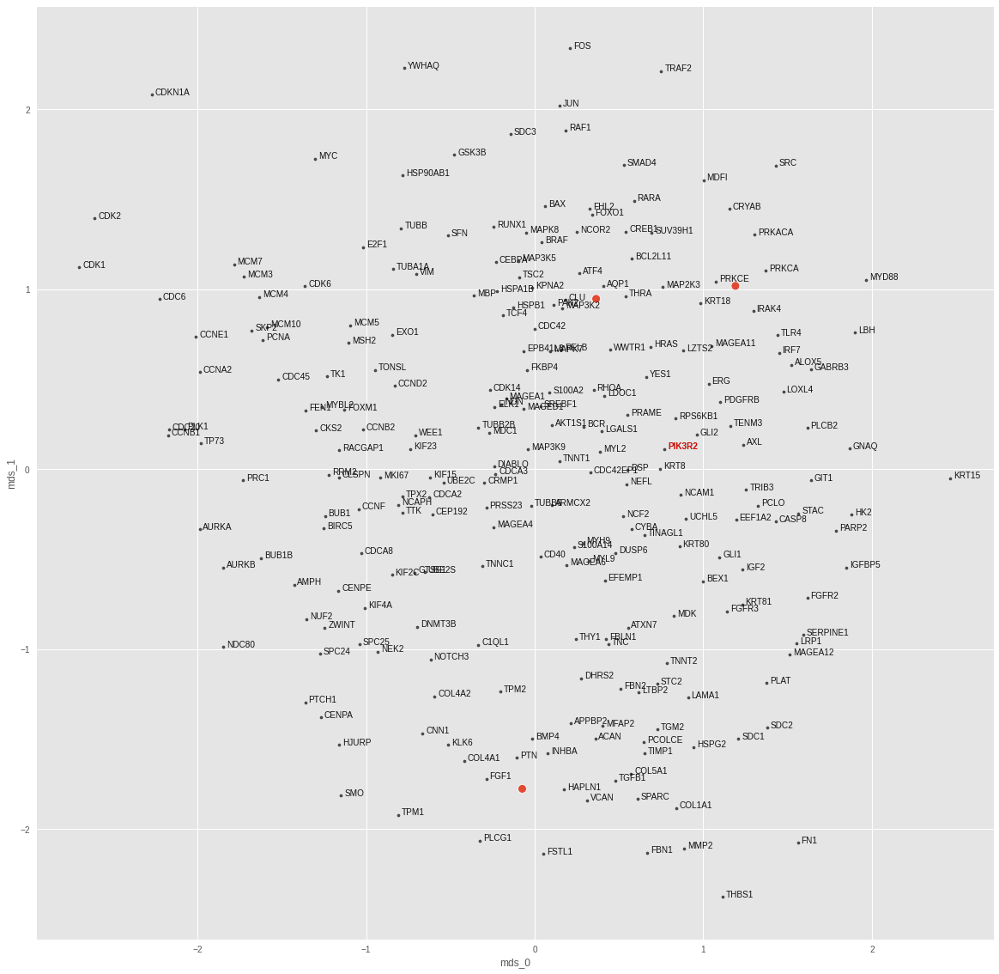

PRKACA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.01735929294955e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.00413275882601738
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


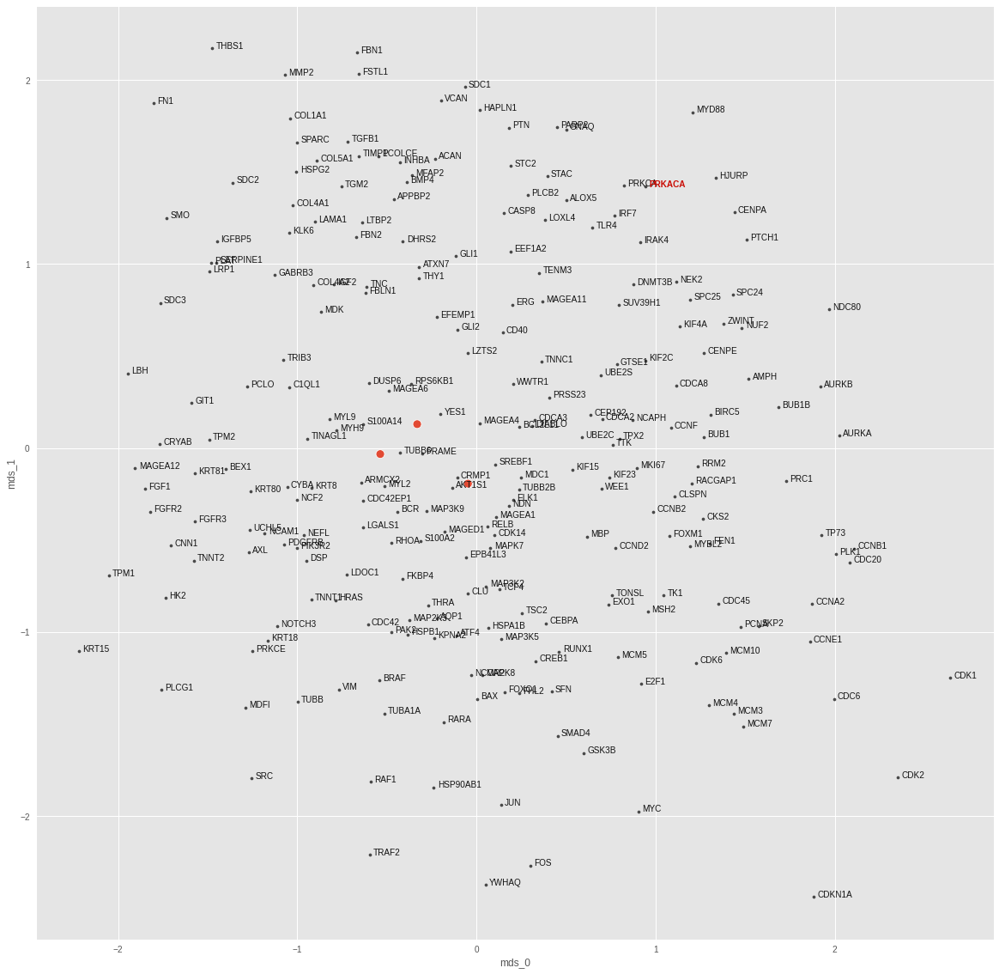

PRKCE
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 3.0183766739355633e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.002523662056773901
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


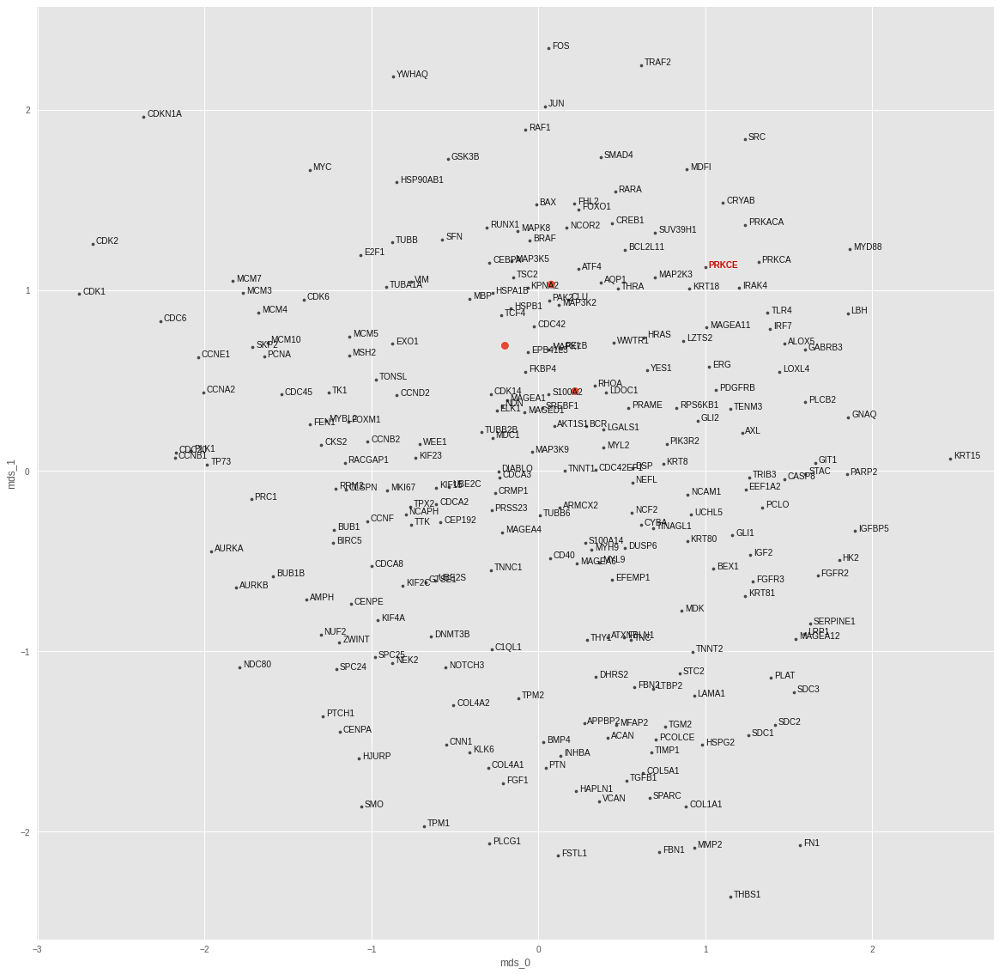

RAF1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.1955538613838144e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0014845712576061487
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


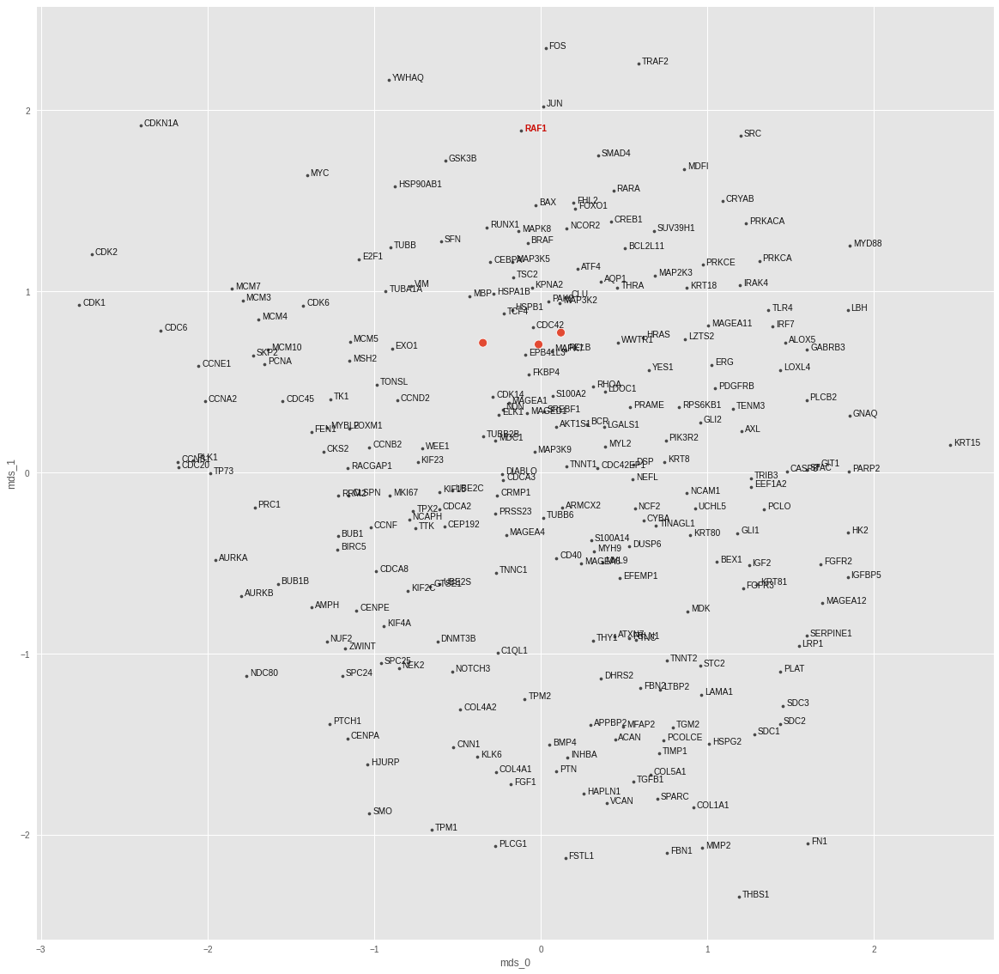

RELB
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.1336268218874466e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0032688211649656296
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


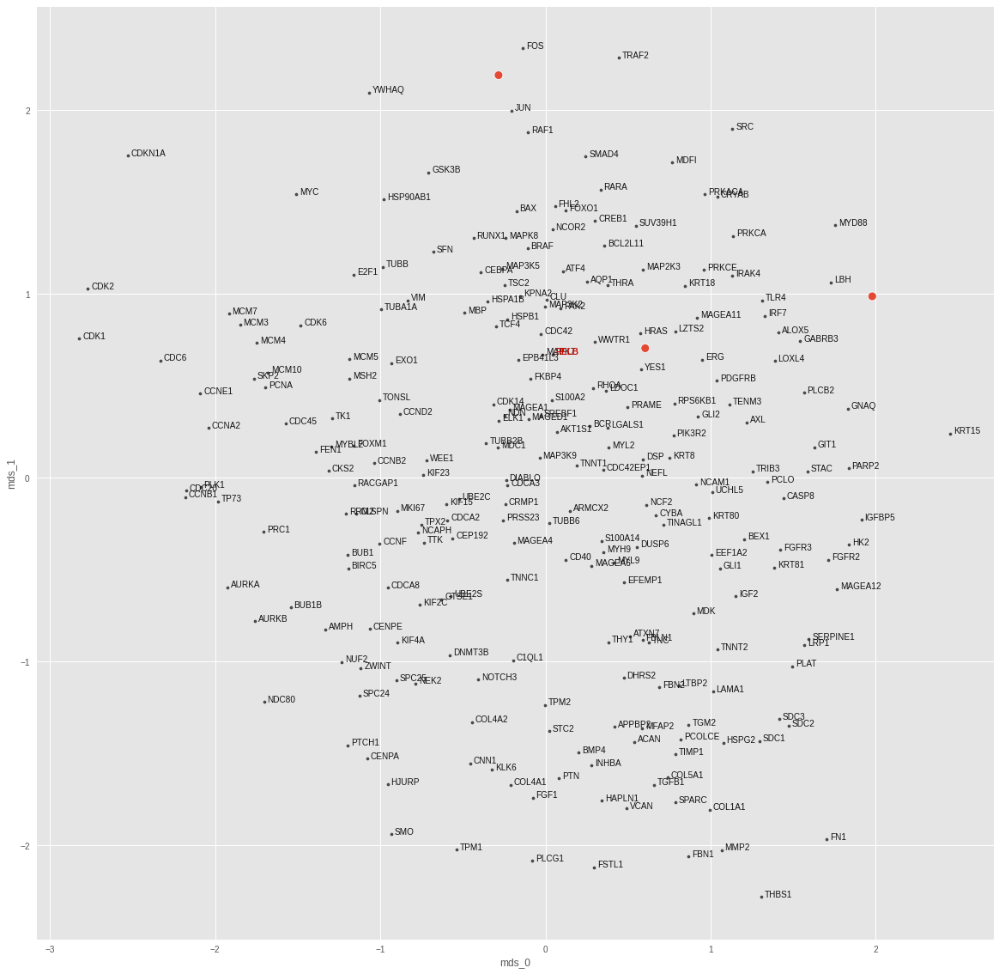

RHOA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.143228130080388e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.001483664265833795
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


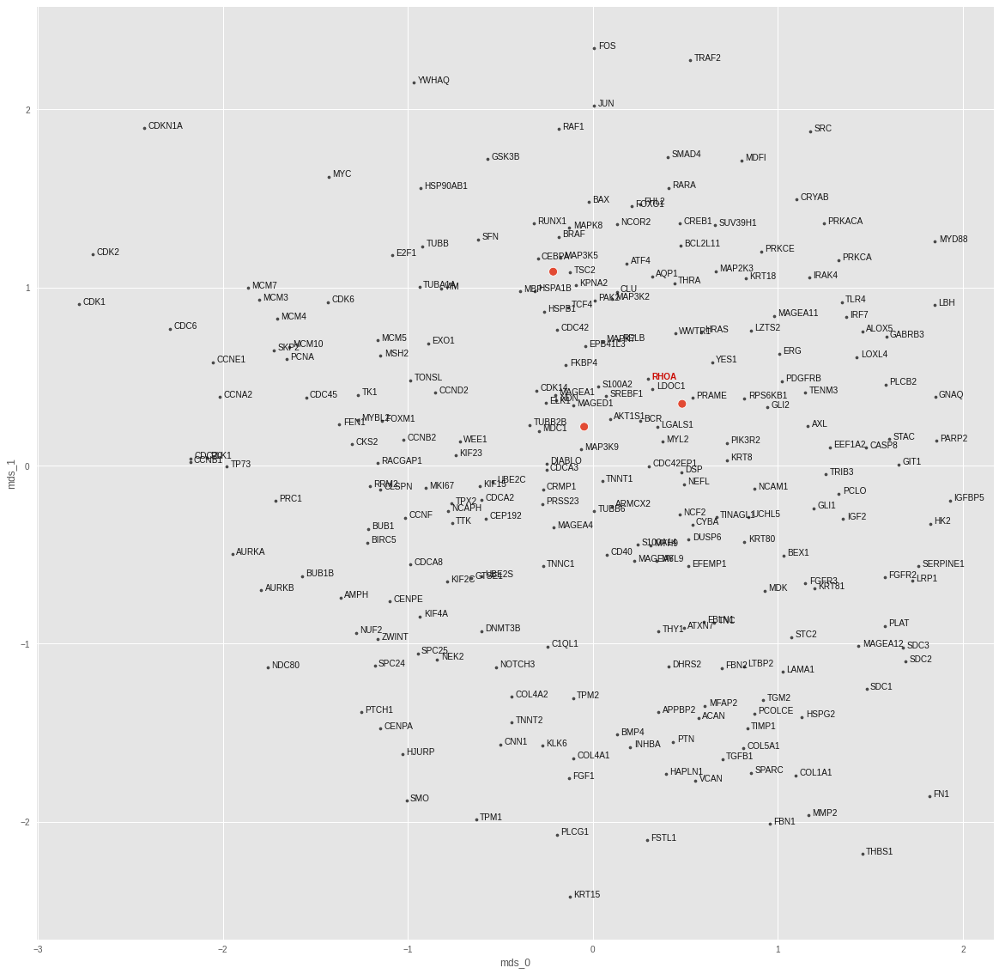

SMAD4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.70603322860552e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0020188072230666876
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


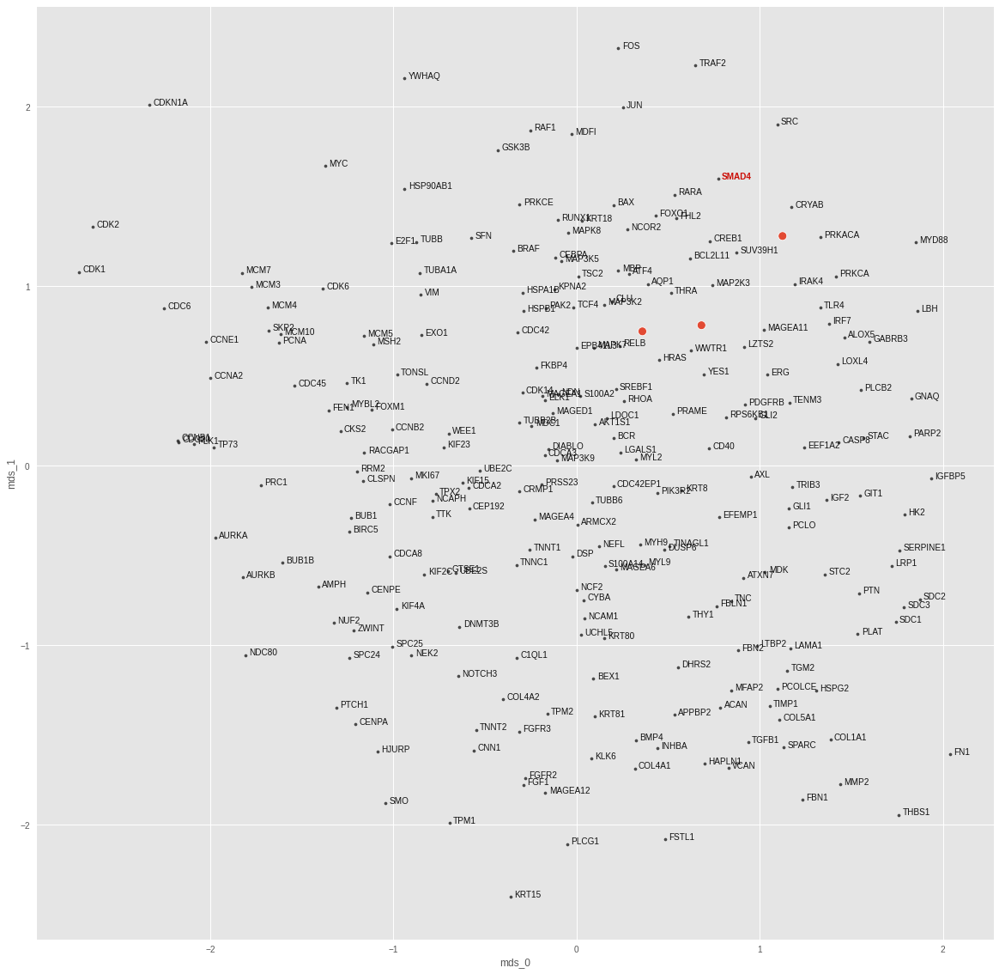

SMO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.9956170237710467e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.005081405863165855
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


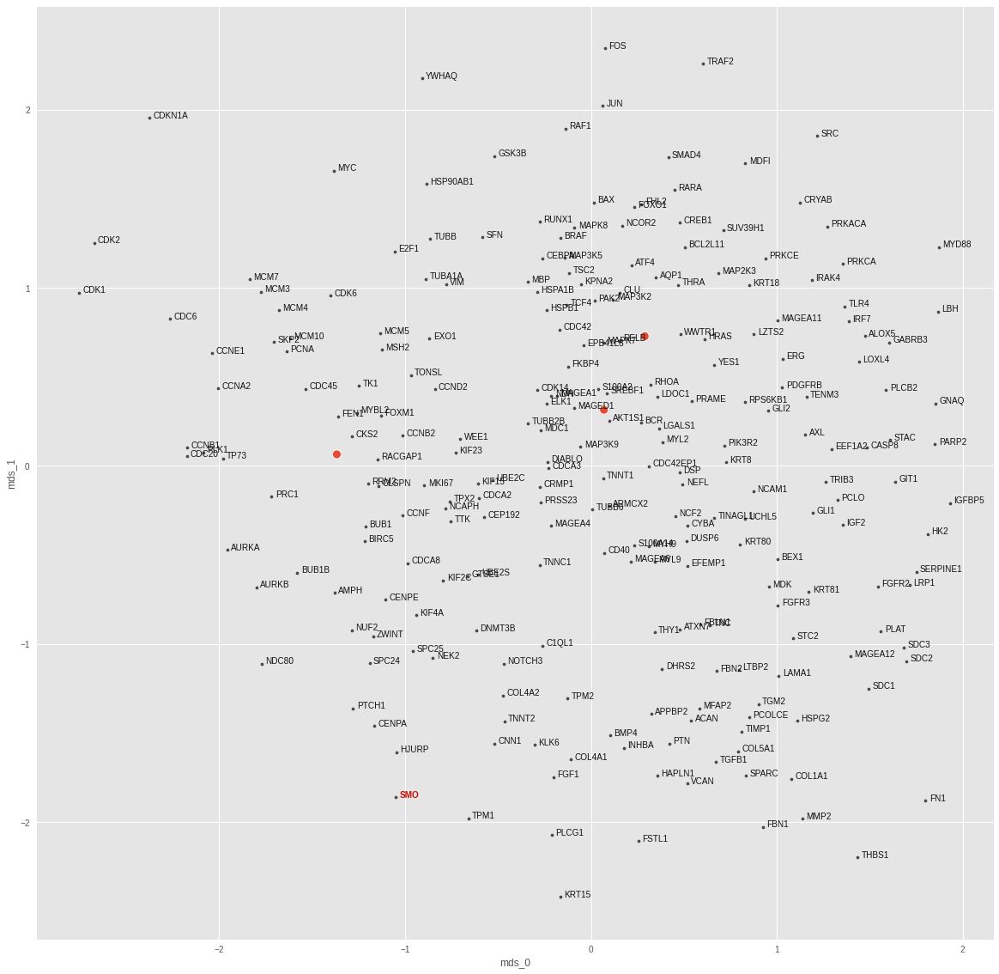

SRC
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.1171053958823904e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0036045126616954803
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


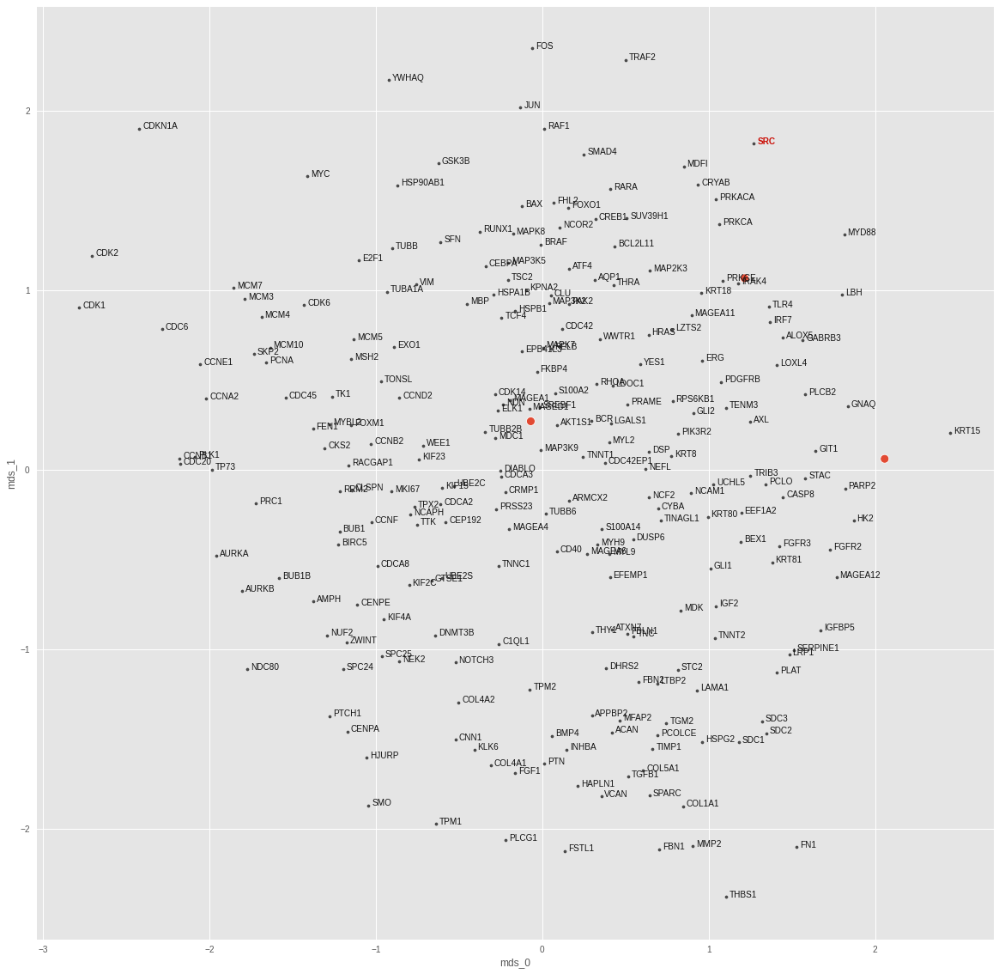

SREBF1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.997765022882959e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0015899669378995895
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


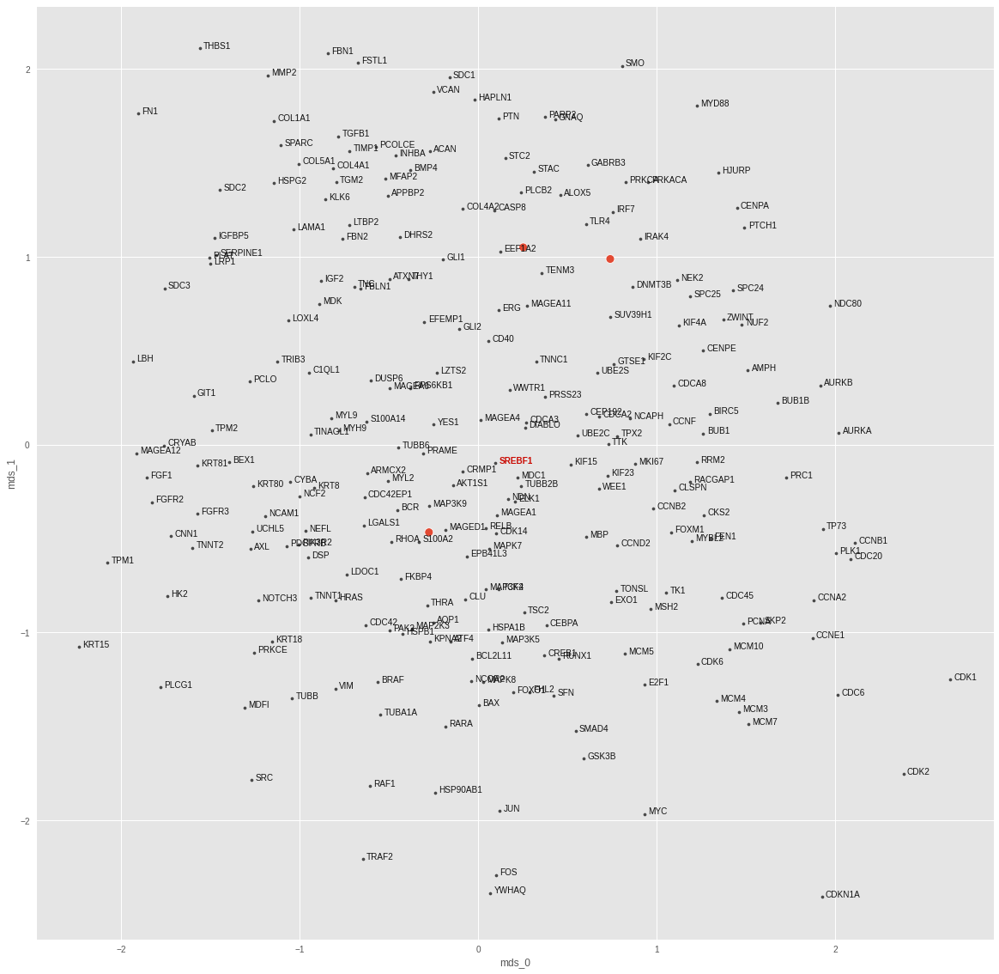

TRAF2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.1805421965837013e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.00724192475900054
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


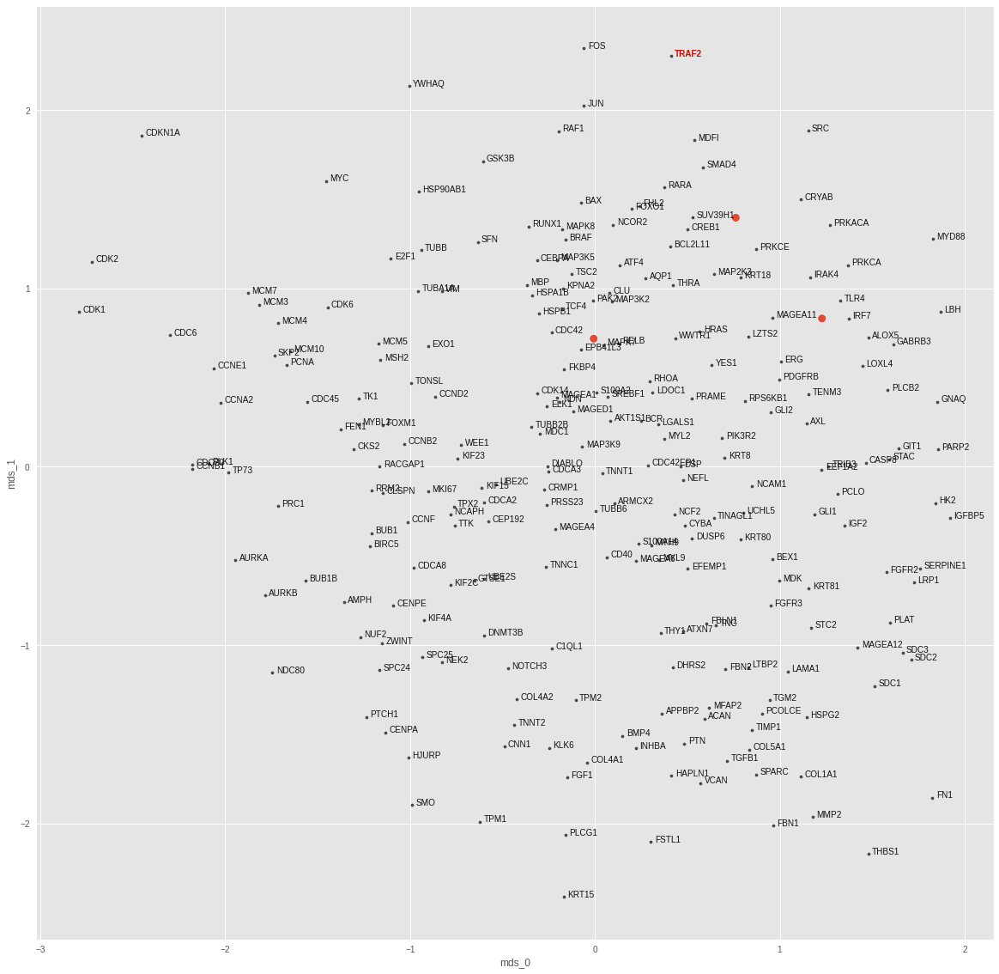

TSC2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.8525831819715677e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.003104106057435274
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.333333, 20: 0.666667, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


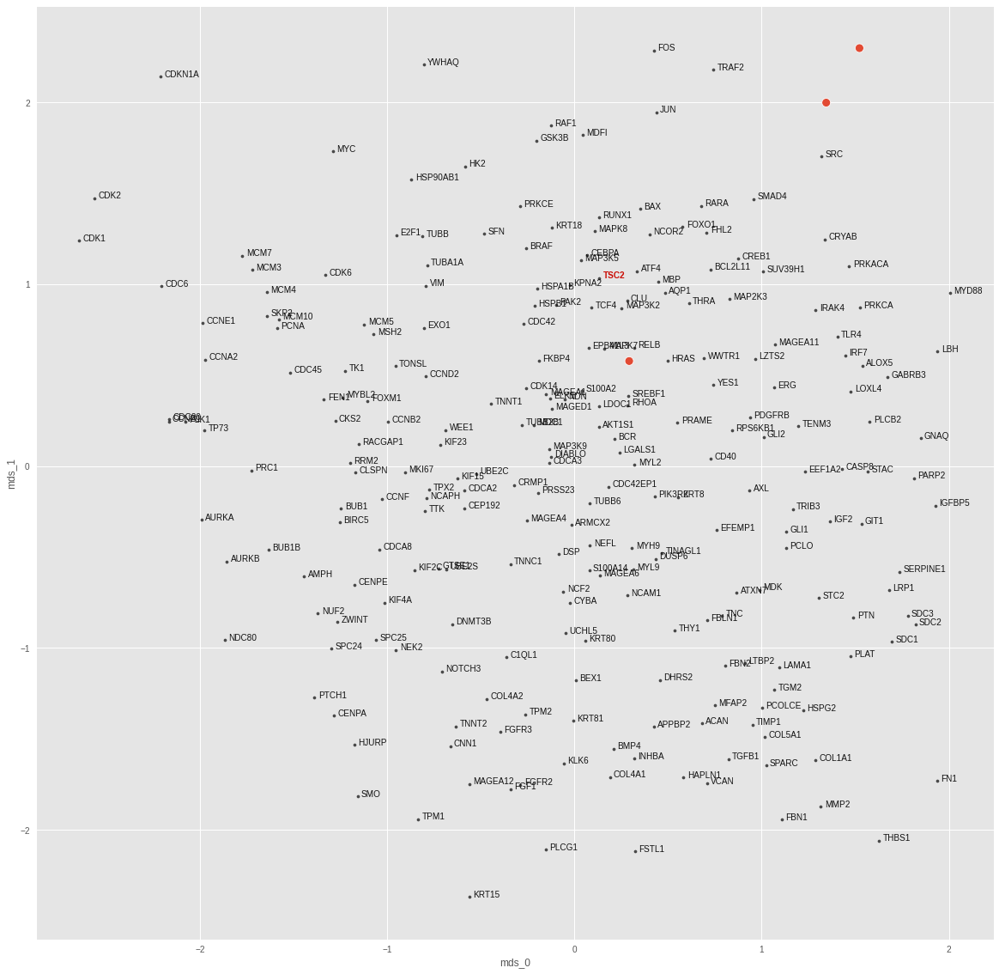

WWTR1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 2.0464010503928876e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004154643043875694
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


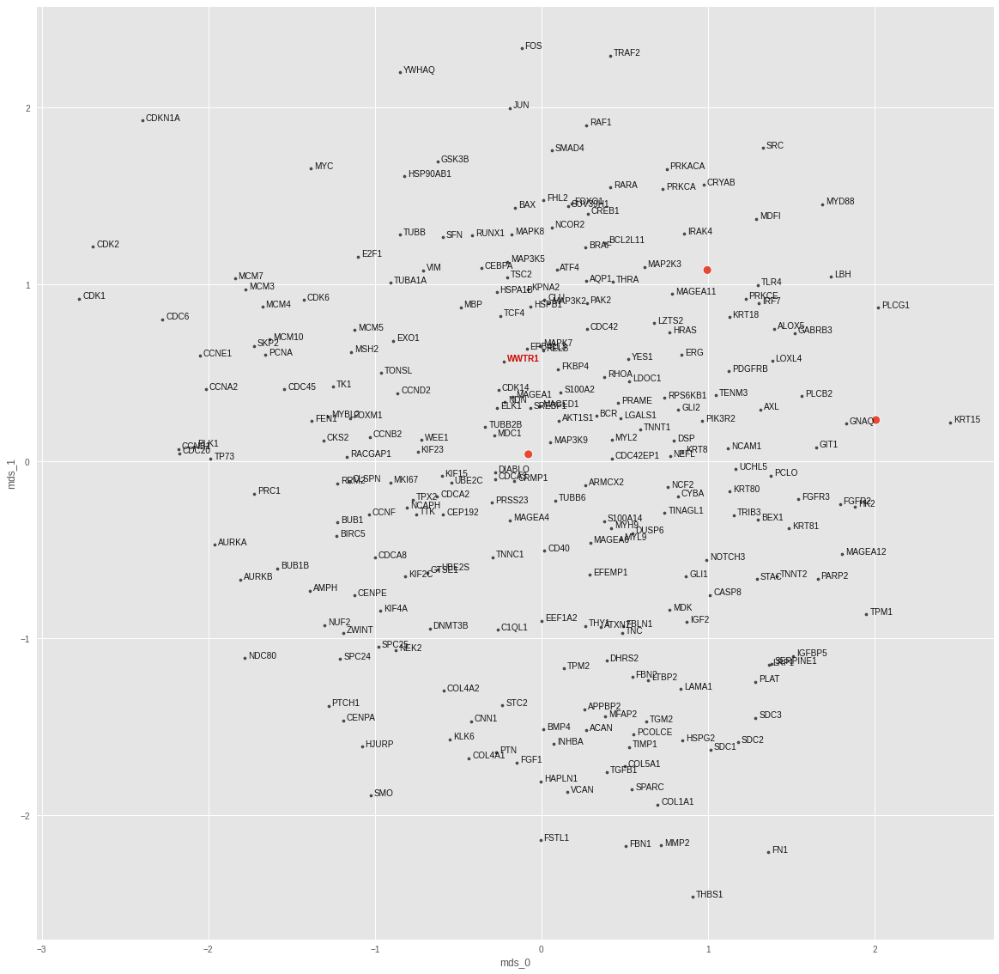

<IPython.core.display.Javascript object>

In [153]:
target_topk_accs = {}
cl_nonlin_nns_dict = {}
for i in tqdm(range(len(cl_data_dicts))):
    data_dict = cl_data_dicts[i]
    model = torch.nn.Sequential(
        torch.nn.Linear(1024, 1024),
        torch.nn.PReLU(),
        torch.nn.Linear(1024, 1024),
    )
    optimizer = Adam(model.parameters(), lr=1e-3)
    criterion = torch.nn.MSELoss()
    target = sorted(list(shared_targets))[i]
    print(target)
    fitted_model, _, mean_topk_acc, mean_knns = train_model_topk_acc(
        model=model,
        data_dict=data_dict,
        optimizer=optimizer,
        criterion=criterion,
        n_epochs=1000,
        early_stopping=1000,
        nn_clf=nn_clf,
        log_epochs=False,
    )
    cl_nonlin_nns_dict[target] = mean_knns[0]
    target_topk_accs[target] = mean_topk_acc
    fig, ax, _ = plot_translation(
        fitted_model.to("cpu"),
        data_dict["test"].dataset,
        node_embs,
        figsize=[20, 20],
        crop=False,
        highlight_target=target,
        pred_size=100,
        reg_size=10,
    )
    ax.get_legend().remove()
    plt.show()
    plt.close()

In [122]:
cl_nonlin_topk_df = pd.DataFrame(target_topk_accs).transpose()
cl_nonlin_topk_df.loc[cl_nonlin_topk_df.loc[:, 50] > 0].sort_values(
    [1, 3, 5, 10, 20, 50], ascending=False
)

,1,3,5,10,20,50
MAP3K2,1.0,1.0,1.0,1.0,1.0,1.0
BRAF,0.0,1.0,1.0,1.0,1.0,1.0
SREBF1,0.0,1.0,1.0,1.0,1.0,1.0
MAP3K5,0.0,0.0,1.0,1.0,1.0,1.0
AKT1S1,0.0,0.0,0.0,1.0,1.0,1.0
MAPK7,0.0,0.0,0.0,1.0,1.0,1.0
PIK3R2,0.0,0.0,0.0,1.0,1.0,1.0
TSC2,0.0,0.0,0.0,1.0,1.0,1.0
CDC42,0.0,0.0,0.0,0.0,1.0,1.0
ELK1,0.0,0.0,0.0,0.0,1.0,1.0


<IPython.core.display.Javascript object>

In [123]:
cl_nonlin_topk_df.describe()

,1,3,5,10,20,50
count,39.000000,39.000000,39.000000,39.000000,39.000000,39.000000
mean,0.025641,0.076923,0.102564,0.205128,0.256410,0.564103
std,0.160128,0.269953,0.307355,0.409074,0.442359,0.502356
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,0.000000,0.000000,0.000000,0.000000,0.500000,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [167]:
n_nns = 20
confined_struct_nns = []
struct_mean_trans = []
lin_mean_trans = []
nonlin_mean_trans = []
struct_cl_trans = []
lin_cl_trans = []
nonlin_cl_trans = []
targets = []

for k in struct_nn_mean_pred_dict.keys():
    targets.append(k)
    struct_mean_trans.append(struct_nn_mean_pred_dict[k][:n_nns])
    lin_mean_trans.append(mean_lin_nns[k][:n_nns])
    nonlin_mean_trans.append(mean_nonlin_nns[k][:n_nns])
    struct_cl_trans.append(struct_nn_centroid_pred_dict[k][:n_nns])
    lin_cl_trans.append(cl_lin_nns_dict[k][:n_nns])
    nonlin_cl_trans.append(cl_nonlin_nns_dict[k][:n_nns])

trans_nns_df = {}
trans_nns_df["struct_mean_trans"] = struct_mean_trans
trans_nns_df["lin_mean_trans"] = lin_mean_trans
trans_nns_df["nonlin_mean_trans"] = nonlin_mean_trans
trans_nns_df["struct_cl_trans"] = struct_cl_trans
trans_nns_df["lin_cl_trans"] = lin_cl_trans
trans_nns_df["nonlin_cl_trans"] = nonlin_cl_trans

trans_nns_df = pd.DataFrame(trans_nns_df, index=targets)
trans_nns_df

,struct_mean_trans,lin_mean_trans,nonlin_mean_trans,struct_cl_trans,lin_cl_trans,nonlin_cl_trans
AKT1S1,"[PRKCE, KRT18, DSP, LDOC1, UCHL5, BRAF, NEFL, ...","[DIABLO, CD40, LZTS2, CDCA3, EFEMP1, CASP8, YE...","[KPNA2, HSPA1B, MAGED1, MAP3K5, S100A2, ATF4, ...","[THRA, TSC2, MAPK7, RHOA, PRAME, NCOR2, HRAS, ...","[AKT1S1, BCR, PRAME, MAGEA1, RHOA, ELK1, MAPK7...","[AKT1S1, ELK1, PRAME, MAGEA1, MAPK7, DIABLO, S..."
ATF4,"[SMAD4, FOXO1, FHL2, TENM3, MBP, TSC2, CREB1, ...","[CDK14, S100A2, FKBP4, HSPA1B, MAGED1, HSPB1, ...","[ELK1, AKT1S1, CDK14, MAGEA1, MAP3K2, SREBF1, ...","[MBP, SREBF1, YES1, TSC2, RELB, CREB1, IRF7, F...","[RELB, MAP3K2, CLU, THRA, MAPK7, MAP3K5, AKT1S...","[RELB, CLU, AKT1S1, MAP3K2, SREBF1, BAX, THRA,..."
BAX,"[TSC2, FOXO1, MAP3K5, CEBPA, MAP3K2, SFN, NCOR...","[RAF1, BRAF, SFN, PAK2, HSPA1B, HSP90AB1, YWHA...","[SFN, TSC2, BRAF, PAK2, CDK14, HSPA1B, RAF1, M...","[YES1, MBP, RELB, SREBF1, ALOX5, MAP3K2, TSC2,...","[TSC2, MAP3K2, THRA, NCOR2, SREBF1, CEBPA, MAG...","[TSC2, HSPA1B, BRAF, SFN, PAK2, CDK14, MAGEA1,..."
BCL2L11,"[CASP8, CD40, EFEMP1, ATXN7, DIABLO, LZTS2, CD...","[TRAF2, CASP8, CD40, DIABLO, LZTS2, EFEMP1, CD...","[CASP8, CD40, DIABLO, TRAF2, CDCA3, EFEMP1, LZ...","[RHOA, HSPA1B, BCR, HRAS, PAK2, BRAF, MAPK7, L...","[TRAF2, JUN, FOS, RUNX1, CLU, MAP3K5, BAX, AQP...","[CD40, TRAF2, DIABLO, LZTS2, CASP8, AQP1, CDCA..."
BRAF,"[RAF1, BRAF, PAK2, HRAS, SFN, HSPA1B, KRT18, S...","[LGALS1, BCR, RHOA, AKT1S1, S100A2, MAGED1, CD...","[HRAS, BRAF, RHOA, LGALS1, PAK2, BCR, KRT18, L...","[RPS6KB1, PRAME, PDGFRB, THRA, RHOA, MAP3K2, A...","[PAK2, HRAS, RHOA, LGALS1, BCR, BRAF, HSPA1B, ...","[BRAF, HRAS, PAK2, RHOA, LGALS1, RAF1, BCR, HS..."
CASP8,"[BCL2L11, MAGEA11, BAX, CLU, MAP3K2, MAPK8, EL...","[TLR4, SMAD4, FOXO1, SRC, FHL2, TENM3, PDGFRB,...","[FOXO1, SMAD4, BCL2L11, FHL2, TSC2, RPS6KB1, S...","[BCR, LGALS1, RHOA, PIK3R2, LDOC1, CDC42, HRAS...","[FOXO1, TSC2, PDGFRB, HRAS, FHL2, NDN, PRAME, ...","[TSC2, MAGEA1, CDK14, NDN, FOXO1, ELK1, MAP3K2..."
CDC42,"[BRAF, PAK2, RAF1, HRAS, KRT18, LDOC1, LGALS1,...","[MDFI, PRKCE, HSP90AB1, KRT18, CDC42, LDOC1, K...","[CDC42, HSPA1B, FKBP4, BRAF, KPNA2, LDOC1, MAG...","[MAP3K5, MAP3K2, NCOR2, HSPA1B, MAPK7, CEBPA, ...","[RAF1, BRAF, PAK2, HRAS, HSPA1B, MAP3K5, THRA,...","[MAP3K5, HSPA1B, MAPK8, CLU, KPNA2, MAP3K2, AQ..."
CDKN1A,"[ATF4, CLU, MAPK7, MDC1, KPNA2, MAPK8, HSPA1B,...","[SMAD4, IRF7, MYD88, IRAK4, TENM3, FOXO1, TLR4...","[SMAD4, FOXO1, RARA, CEBPA, FHL2, NCOR2, MBP, ...","[AKT1S1, BCR, RHOA, CDK14, MAGEA1, MAP3K9, MAP...","[TSC2, E2F1, NDN, FOXO1, SFN, EXO1, MAGEA1, FH...","[NDN, TSC2, MAGEA1, SREBF1, MAPK7, AKT1S1, PRA..."
CEBPA,"[ERG, EEF1A2, WWTR1, CD40, CASP8, DIABLO, AQP1...","[GLI2, SREBF1, WWTR1, IGF2, TENM3, EEF1A2, GAB...","[ERG, EEF1A2, WWTR1, DUSP6, ELK1, MDC1, CD40, ...","[IRAK4, MBP, IRF7, SREBF1, TLR4, NDN, MAGEA1, ...","[ERG, EEF1A2, RPS6KB1, WWTR1, PRAME, ELK1, MAP...","[ERG, EEF1A2, WWTR1, ELK1, MDC1, MAPK7, CD40, ..."
CREB1,"[IRAK4, IRF7, MYD88, MBP, TLR4, TENM3, SMAD4, ...","[SMAD4, TLR4, IRF7, FOXO1, MYD88, IRAK4, FHL2,...","[SMAD4, IRF7, TLR4, FOXO1, TENM3, IRAK4, FHL2,...","[RHOA, BCR, HRAS, LGALS1, AKT1S1, HSPA1B, MAPK...","[BRAF, FOXO1, TSC2, SFN, HRAS, PAK2, MAGEA1, C...","[TSC2, FOXO1, FHL2, MAGEA1, NDN, SFN, CDK14, S..."


<IPython.core.display.Javascript object>

In [168]:
trans_nns_df.to_csv("../../../data/other/translation_nns.csv")

<IPython.core.display.Javascript object>

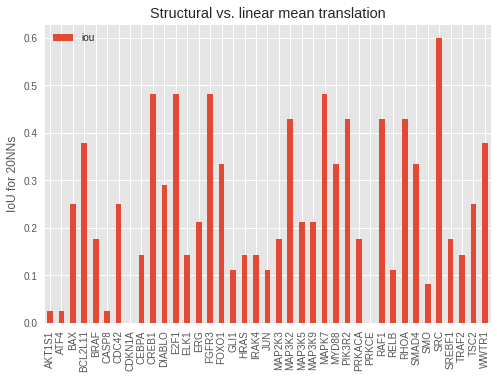

<IPython.core.display.Javascript object>

In [175]:
struct_lin_mean_ious = []
targets = []

for idx in trans_nns_df.index:
    targets.append(idx)
    struct_mean_nns = set(trans_nns_df.loc[idx, "struct_mean_trans"])
    lin_mean_nns = set(trans_nns_df.loc[idx, "lin_mean_trans"])

    struct_lin_mean_iou = len(struct_mean_nns.intersection(lin_mean_nns)) / len(
        struct_mean_nns.union(lin_mean_nns)
    )
    struct_lin_mean_ious.append(struct_lin_mean_iou)
struct_lin_mean_ious_df = pd.DataFrame(
    struct_lin_mean_ious, index=targets, columns=["iou"]
)
ax = struct_lin_mean_ious_df.plot(kind="bar")
ax.set_ylabel("IoU for 20NNs")
ax.set_title("Structural vs. linear mean translation")
plt.show()

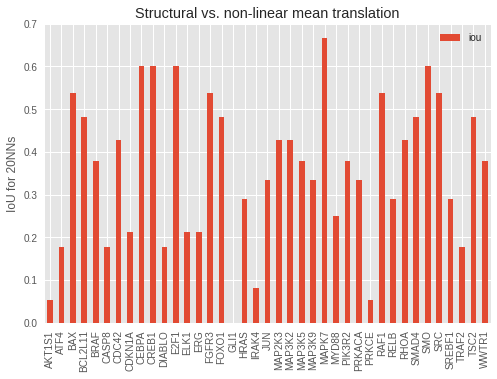

<IPython.core.display.Javascript object>

In [176]:
struct_lin_mean_ious = []
targets = []

for idx in trans_nns_df.index:
    targets.append(idx)
    struct_mean_nns = set(trans_nns_df.loc[idx, "struct_mean_trans"])
    lin_mean_nns = set(trans_nns_df.loc[idx, "nonlin_mean_trans"])

    struct_lin_mean_iou = len(struct_mean_nns.intersection(lin_mean_nns)) / len(
        struct_mean_nns.union(lin_mean_nns)
    )
    struct_lin_mean_ious.append(struct_lin_mean_iou)
struct_lin_mean_ious_df = pd.DataFrame(
    struct_lin_mean_ious, index=targets, columns=["iou"]
)
ax = struct_lin_mean_ious_df.plot(kind="bar")
ax.set_ylabel("IoU for 20NNs")
ax.set_title("Structural vs. non-linear mean translation")
plt.show()

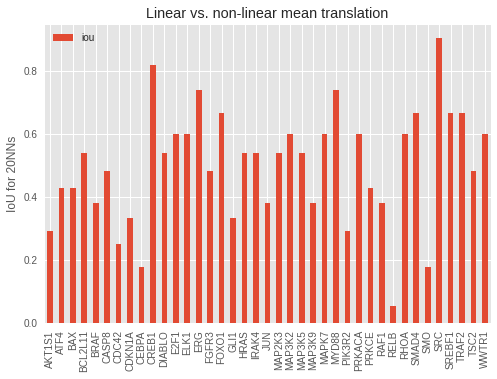

<IPython.core.display.Javascript object>

In [177]:
struct_lin_mean_ious = []
targets = []

for idx in trans_nns_df.index:
    targets.append(idx)
    struct_mean_nns = set(trans_nns_df.loc[idx, "lin_mean_trans"])
    lin_mean_nns = set(trans_nns_df.loc[idx, "nonlin_mean_trans"])

    struct_lin_mean_iou = len(struct_mean_nns.intersection(lin_mean_nns)) / len(
        struct_mean_nns.union(lin_mean_nns)
    )
    struct_lin_mean_ious.append(struct_lin_mean_iou)
struct_lin_mean_ious_df = pd.DataFrame(
    struct_lin_mean_ious, index=targets, columns=["iou"]
)
ax = struct_lin_mean_ious_df.plot(kind="bar")
ax.set_ylabel("IoU for 20NNs")
ax.set_title("Linear vs. non-linear mean translation")
plt.show()

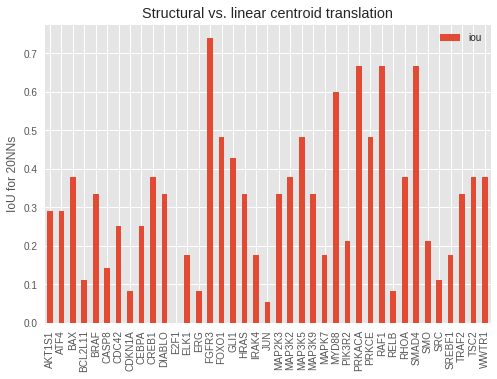

<IPython.core.display.Javascript object>

In [179]:
struct_lin_mean_ious = []
targets = []

for idx in trans_nns_df.index:
    targets.append(idx)
    struct_mean_nns = set(trans_nns_df.loc[idx, "struct_cl_trans"])
    lin_mean_nns = set(trans_nns_df.loc[idx, "lin_cl_trans"])

    struct_lin_mean_iou = len(struct_mean_nns.intersection(lin_mean_nns)) / len(
        struct_mean_nns.union(lin_mean_nns)
    )
    struct_lin_mean_ious.append(struct_lin_mean_iou)
struct_lin_mean_ious_df = pd.DataFrame(
    struct_lin_mean_ious, index=targets, columns=["iou"]
)
ax = struct_lin_mean_ious_df.plot(kind="bar")
ax.set_ylabel("IoU for 20NNs")
ax.set_title("Structural vs. linear centroid translation")
plt.show()

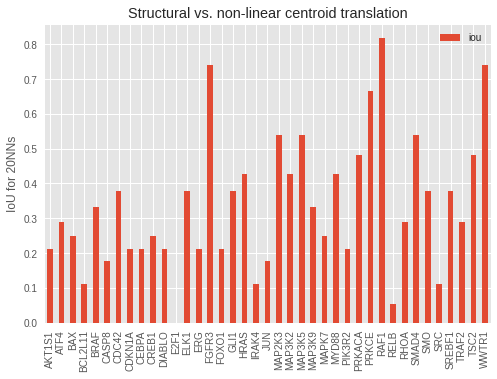

<IPython.core.display.Javascript object>

In [180]:
struct_lin_mean_ious = []
targets = []

for idx in trans_nns_df.index:
    targets.append(idx)
    struct_mean_nns = set(trans_nns_df.loc[idx, "struct_cl_trans"])
    lin_mean_nns = set(trans_nns_df.loc[idx, "nonlin_cl_trans"])

    struct_lin_mean_iou = len(struct_mean_nns.intersection(lin_mean_nns)) / len(
        struct_mean_nns.union(lin_mean_nns)
    )
    struct_lin_mean_ious.append(struct_lin_mean_iou)
struct_lin_mean_ious_df = pd.DataFrame(
    struct_lin_mean_ious, index=targets, columns=["iou"]
)
ax = struct_lin_mean_ious_df.plot(kind="bar")
ax.set_ylabel("IoU for 20NNs")
ax.set_title("Structural vs. non-linear centroid translation")
plt.show()

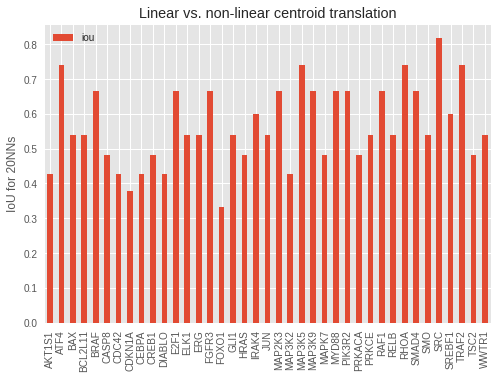

<IPython.core.display.Javascript object>

In [181]:
struct_lin_mean_ious = []
targets = []

for idx in trans_nns_df.index:
    targets.append(idx)
    struct_mean_nns = set(trans_nns_df.loc[idx, "lin_cl_trans"])
    lin_mean_nns = set(trans_nns_df.loc[idx, "nonlin_cl_trans"])

    struct_lin_mean_iou = len(struct_mean_nns.intersection(lin_mean_nns)) / len(
        struct_mean_nns.union(lin_mean_nns)
    )
    struct_lin_mean_ious.append(struct_lin_mean_iou)
struct_lin_mean_ious_df = pd.DataFrame(
    struct_lin_mean_ious, index=targets, columns=["iou"]
)
ax = struct_lin_mean_ious_df.plot(kind="bar")
ax.set_ylabel("IoU for 20NNs")
ax.set_title("Linear vs. non-linear centroid translation")
plt.show()